In [106]:
import modisco
import numpy as np
import h5py
#FRAC_SEQS_TO_USE = 0.02
#NUM_SEQS_TO_USE = int(FRAC_SEQS_TO_USE*len(nanog_profile_wn_contribs))
#print("num seqs to use:", NUM_SEQS_TO_USE)

task_names=["Nanog_profile_wn"]
contrib_scores={'Nanog_profile_wn': np.load("nanog_profile_wn_contribs_fewerseqlets.npy")}
hypothetical_contribs={'Nanog_profile_wn': np.load("nanog_profile_wn_hypimp_fewerseqlets.npy")}
one_hot= np.load("onehot_seq_fewerseqlets.npy")

metacluster_0
activity pattern: [1]
metacluster_0 pattern_0
total seqlets: 876
Task 0 hypothetical scores:


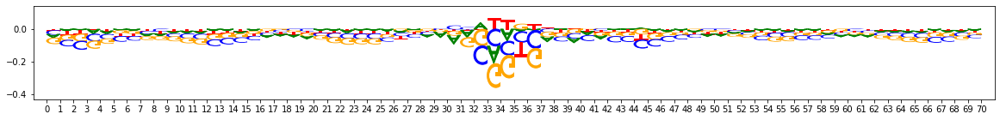

Task 0 actual importance scores:


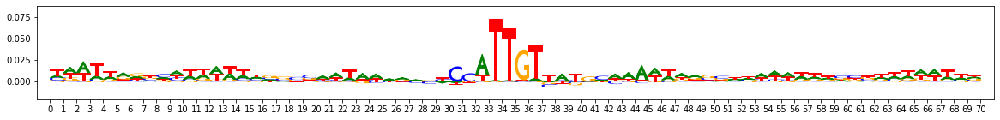

onehot, fwd and rev:


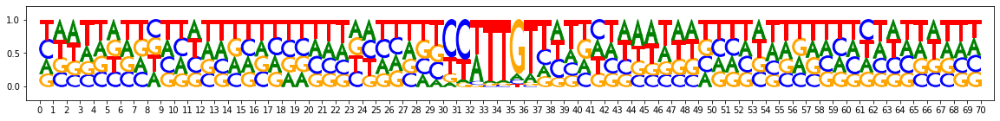

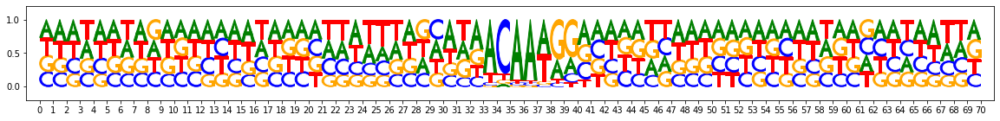

metacluster_0 pattern_1
total seqlets: 838
Task 0 hypothetical scores:


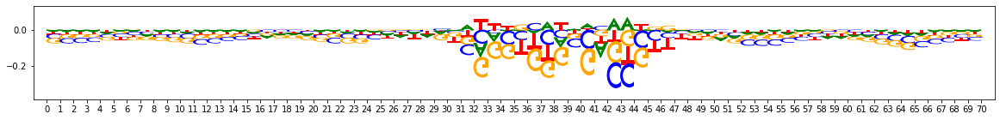

Task 0 actual importance scores:


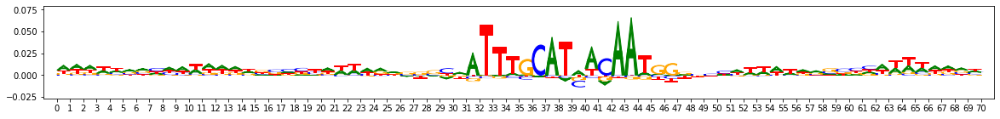

onehot, fwd and rev:


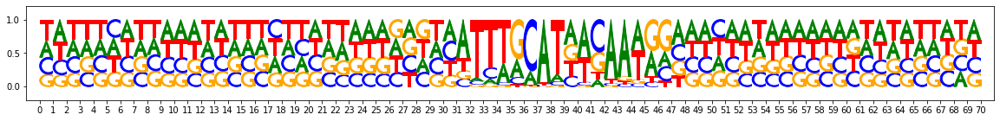

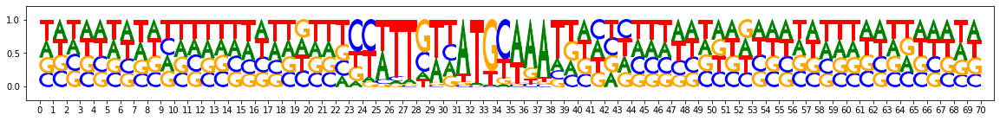

metacluster_0 pattern_2
total seqlets: 400
Task 0 hypothetical scores:


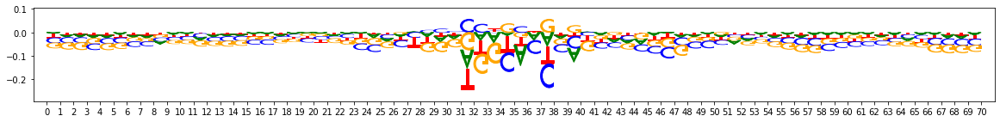

Task 0 actual importance scores:


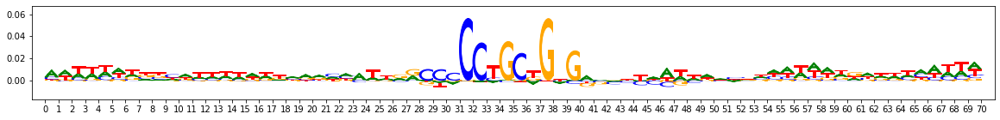

onehot, fwd and rev:


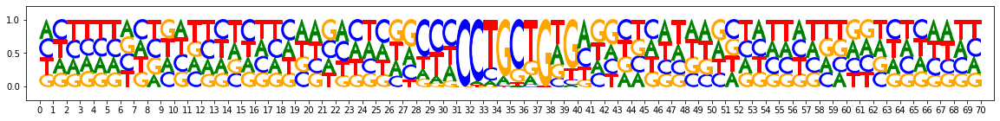

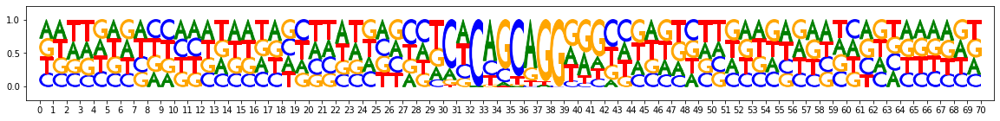

metacluster_0 pattern_3
total seqlets: 349
Task 0 hypothetical scores:


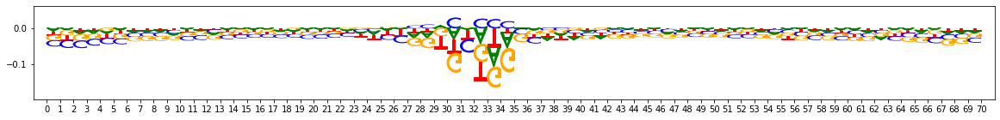

Task 0 actual importance scores:


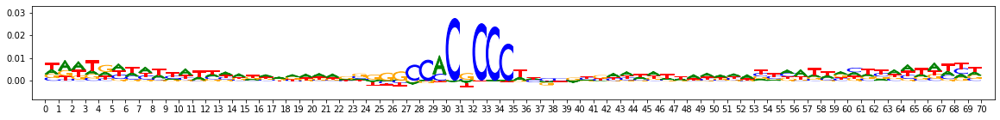

onehot, fwd and rev:


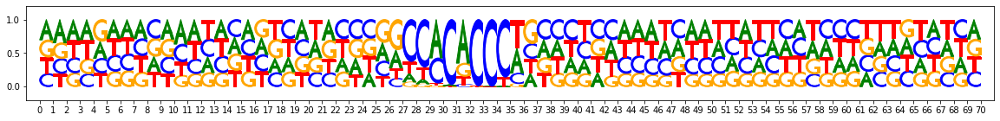

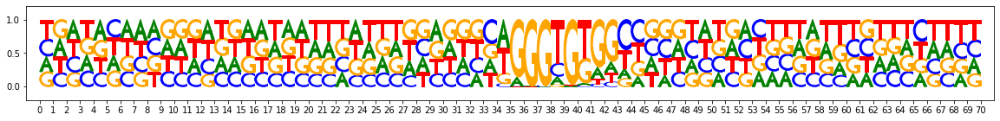

metacluster_0 pattern_4
total seqlets: 334
Task 0 hypothetical scores:


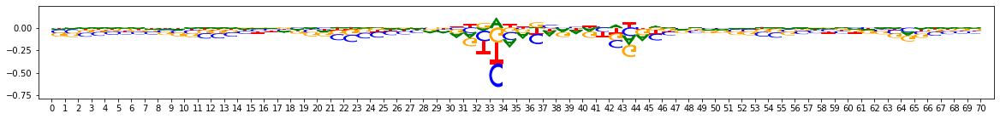

Task 0 actual importance scores:


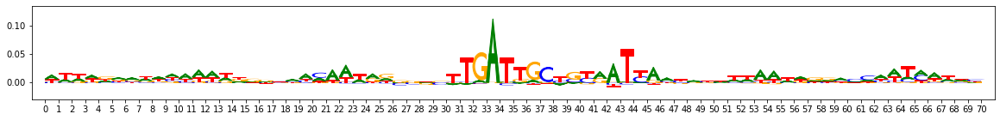

onehot, fwd and rev:


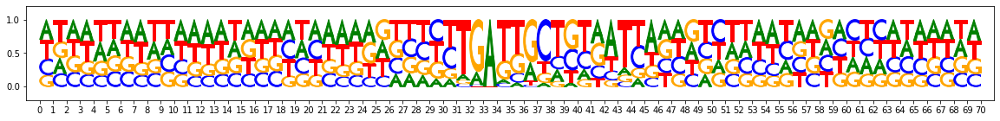

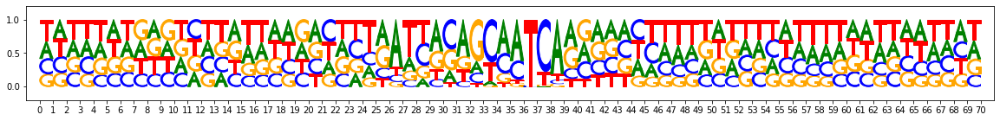

metacluster_0 pattern_5
total seqlets: 330
Task 0 hypothetical scores:


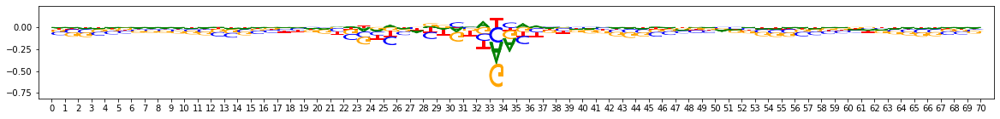

Task 0 actual importance scores:


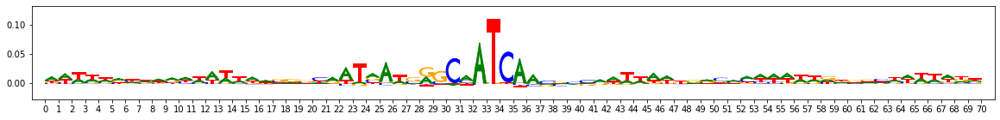

onehot, fwd and rev:


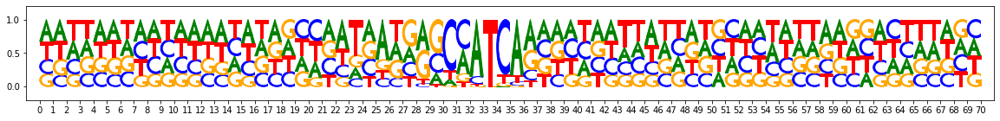

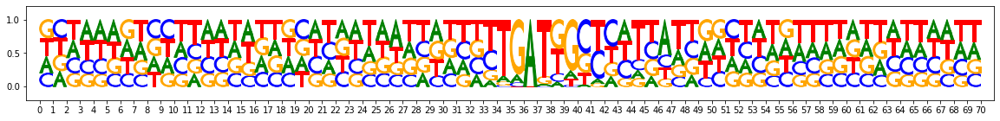

metacluster_0 pattern_6
total seqlets: 272
Task 0 hypothetical scores:


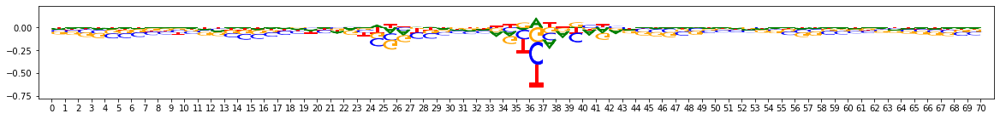

Task 0 actual importance scores:


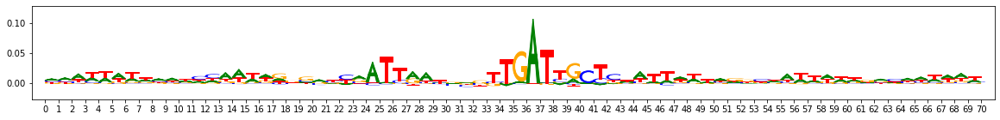

onehot, fwd and rev:


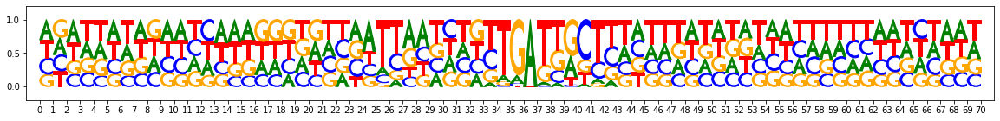

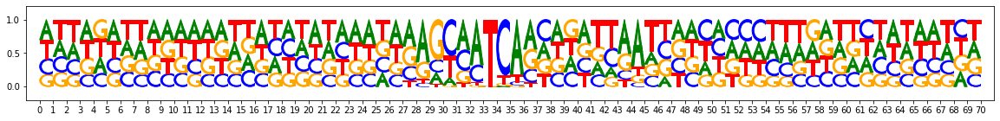

metacluster_0 pattern_7
total seqlets: 249
Task 0 hypothetical scores:


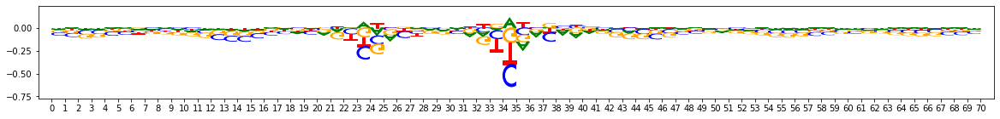

Task 0 actual importance scores:


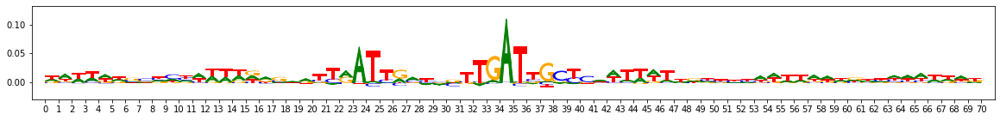

onehot, fwd and rev:


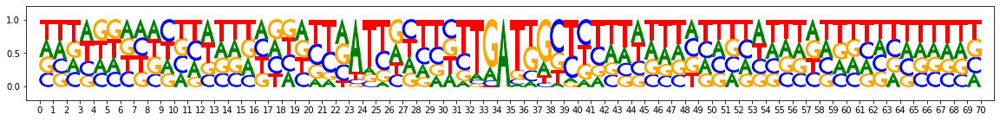

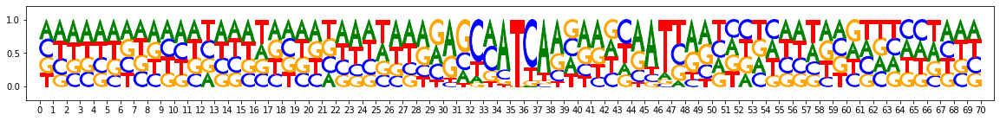

metacluster_0 pattern_8
total seqlets: 174
Task 0 hypothetical scores:


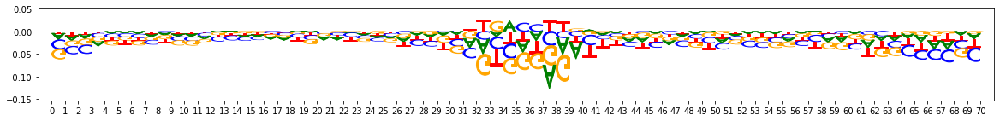

Task 0 actual importance scores:


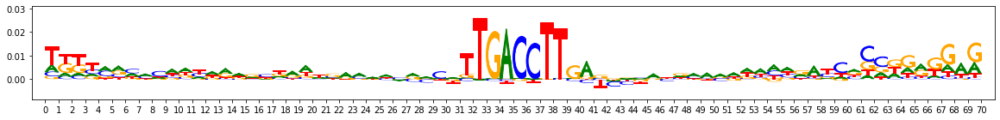

onehot, fwd and rev:


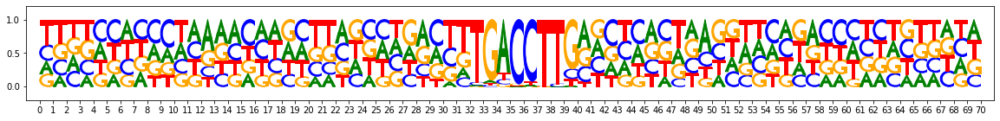

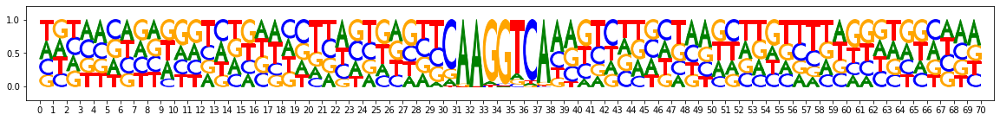

metacluster_0 pattern_9
total seqlets: 170
Task 0 hypothetical scores:


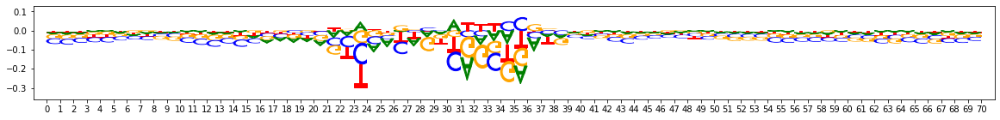

Task 0 actual importance scores:


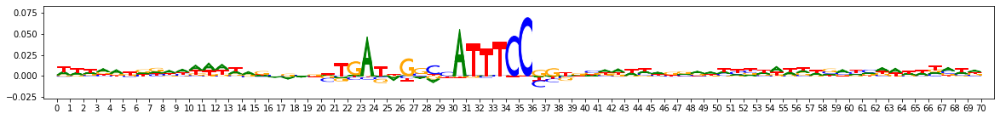

onehot, fwd and rev:


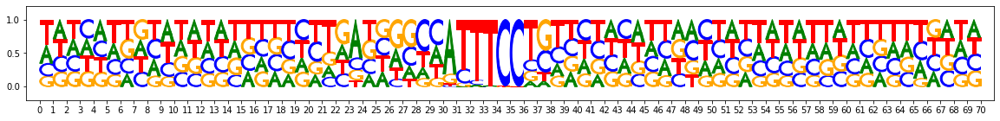

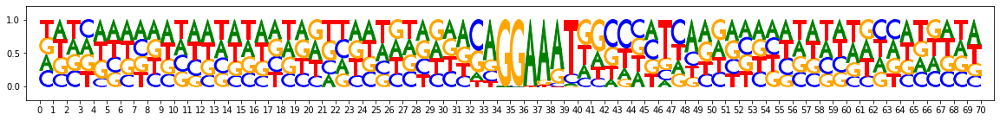

metacluster_0 pattern_10
total seqlets: 122
Task 0 hypothetical scores:


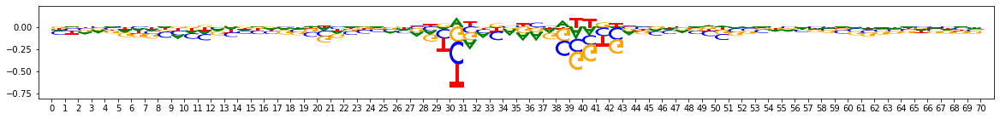

Task 0 actual importance scores:


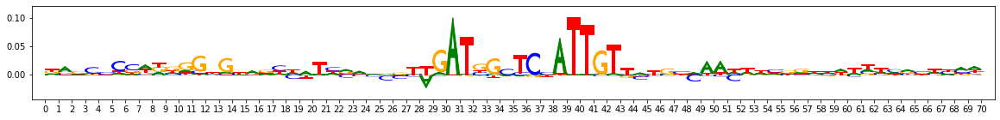

onehot, fwd and rev:


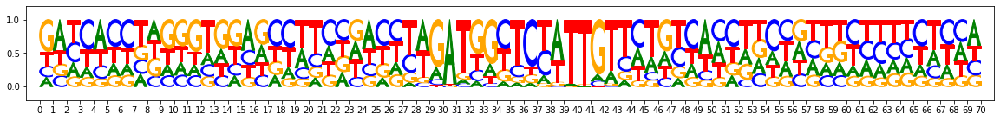

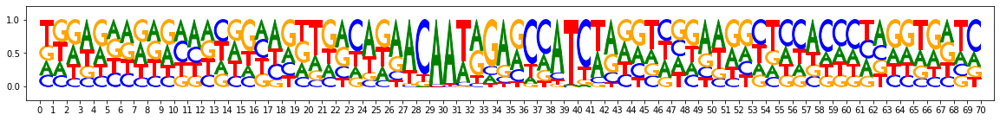

metacluster_0 pattern_11
total seqlets: 97
Task 0 hypothetical scores:


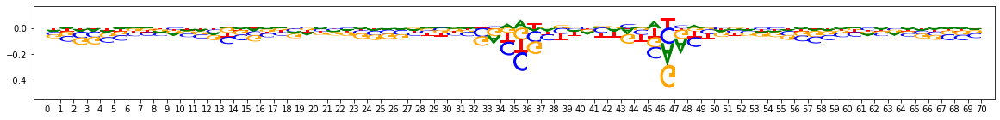

Task 0 actual importance scores:


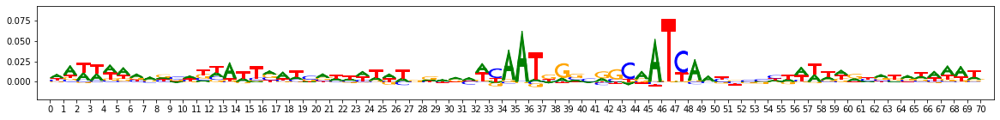

onehot, fwd and rev:


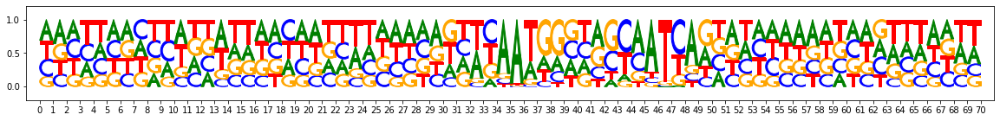

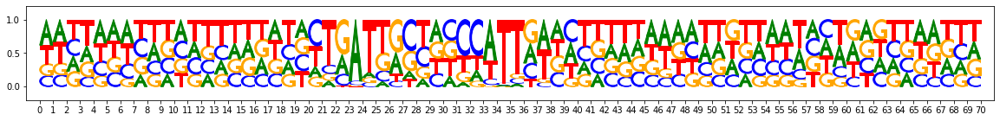

metacluster_0 pattern_12
total seqlets: 95
Task 0 hypothetical scores:


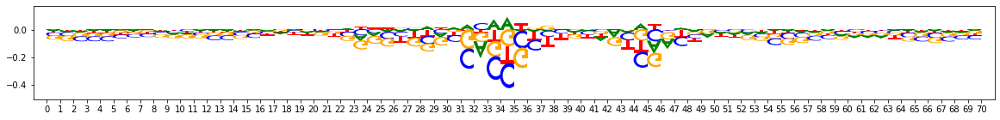

Task 0 actual importance scores:


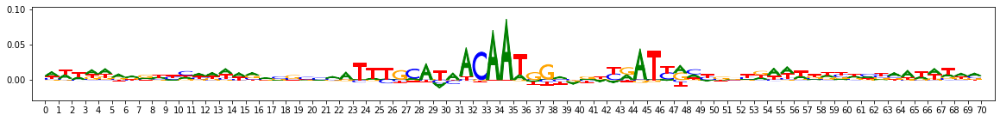

onehot, fwd and rev:


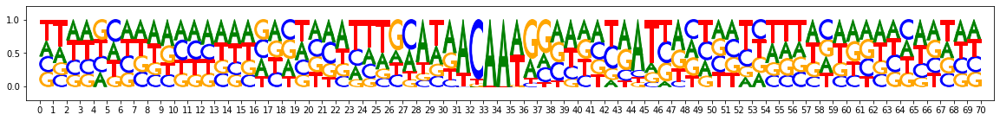

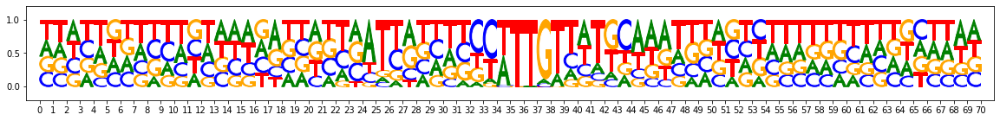

metacluster_0 pattern_13
total seqlets: 101
Task 0 hypothetical scores:


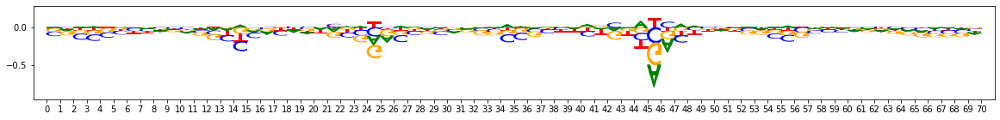

Task 0 actual importance scores:


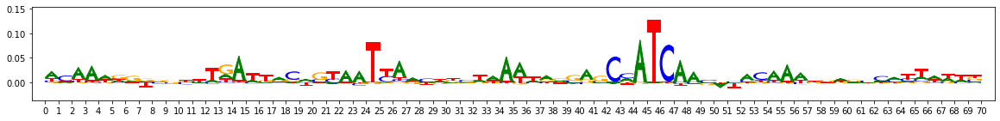

onehot, fwd and rev:


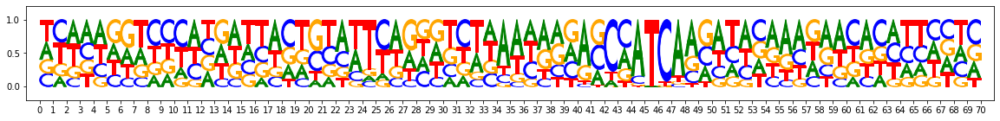

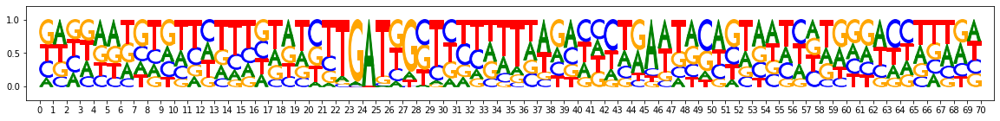

In [107]:
from modisco.visualization import viz_sequence
%matplotlib inline

#Leveraging TryBpNet_AGKM_embeddings_fewerseqlets
file_path = "subset2pc_commit5fe538_agkm_default_results.hdf5"
hdf5_results = h5py.File(file_path,"r")

metacluster_names = [
    x.decode("utf-8") for x in 
    list(hdf5_results["metaclustering_results"]
         ["all_metacluster_names"][:])]

all_patterns = []
background = np.array([0.27, 0.23, 0.23, 0.27])

for metacluster_name in metacluster_names:
    print(metacluster_name)
    metacluster_grp = (hdf5_results["metacluster_idx_to_submetacluster_results"]
                                   [metacluster_name])
    print("activity pattern:",metacluster_grp["activity_pattern"][:])
    all_pattern_names = [x.decode("utf-8") for x in 
                         list(metacluster_grp["seqlets_to_patterns_result"]
                                             ["patterns"]["all_pattern_names"][:])]
    if (len(all_pattern_names)==0):
        print("No motifs found for this activity pattern")
    for pattern_name in all_pattern_names:
        print(metacluster_name, pattern_name)
        all_patterns.append((metacluster_name, pattern_name))
        pattern = metacluster_grp["seqlets_to_patterns_result"]["patterns"][pattern_name]
        print("total seqlets:",len(pattern["seqlets_and_alnmts"]["seqlets"]))
        print("Task 0 hypothetical scores:")
        viz_sequence.plot_weights(pattern["Nanog_profile_wn_hypothetical_contribs"]["fwd"])
        print("Task 0 actual importance scores:")
        viz_sequence.plot_weights(pattern["Nanog_profile_wn_contrib_scores"]["fwd"])
        print("onehot, fwd and rev:")
        viz_sequence.plot_weights(np.array(pattern["sequence"]["fwd"])) 
        viz_sequence.plot_weights(np.array(pattern["sequence"]["rev"])) 
        
hdf5_results.close()

In [108]:
#get seqlets for all the coordinates
import modisco
from importlib import reload

track_set = modisco.tfmodisco_workflow.workflow.prep_track_set(
    task_names=task_names, contrib_scores=contrib_scores,
    hypothetical_contribs=hypothetical_contribs,
    one_hot=one_hot
)

grp = h5py.File("subset2pc_commit5fe538_agkm_default_results.hdf5","r")
results = modisco.tfmodisco_workflow.workflow.TfModiscoResults.from_hdf5(
            grp, track_set=track_set)
grp.close()

In [109]:
patterns = (results.metacluster_idx_to_submetacluster_results["metacluster_0"]
            .seqlets_to_patterns_result.patterns)

Removed 1 duplicate seqlets
Getting the exemplar motifs
Numseqles: 876


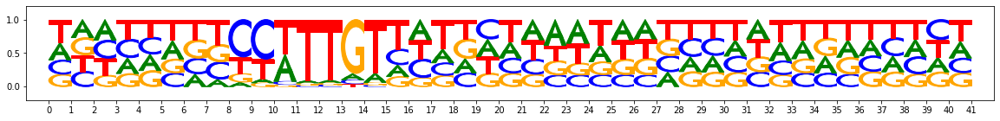

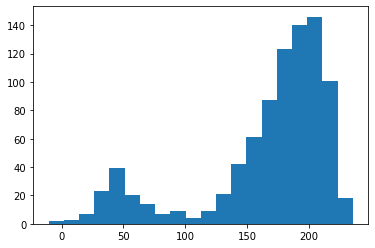

After filtering: numseqlets 750


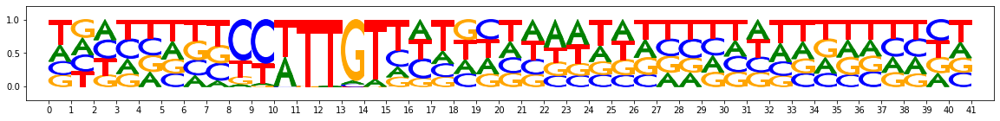

Numseqles: 838


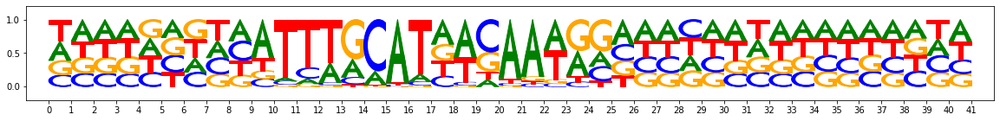

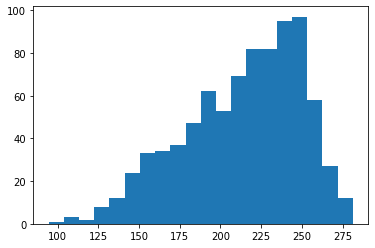

After filtering: numseqlets 821


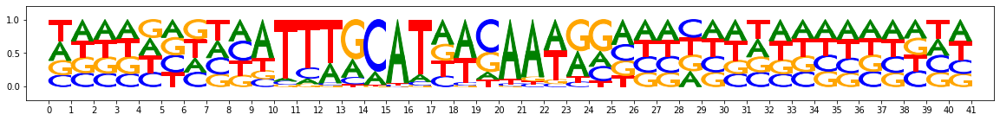

Numseqles: 400


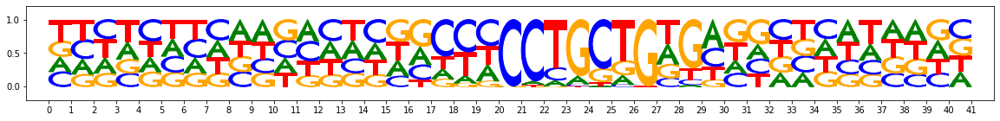

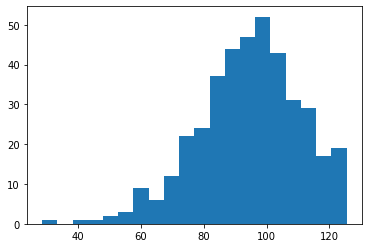

After filtering: numseqlets 392


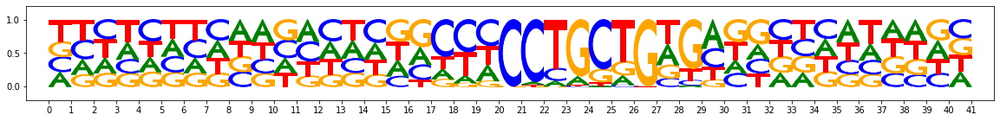

Numseqles: 349


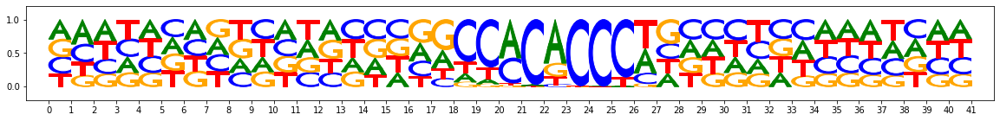

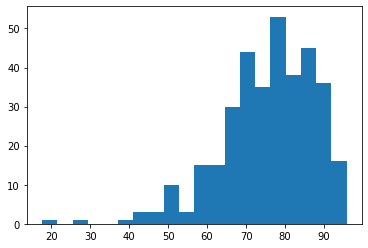

After filtering: numseqlets 342


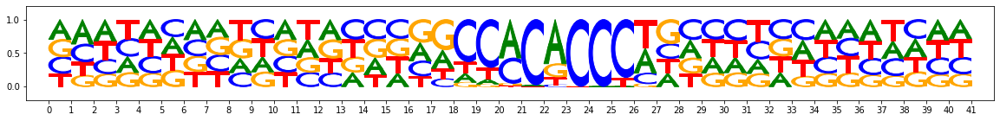

Numseqles: 334


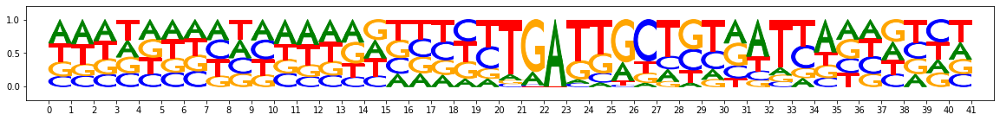

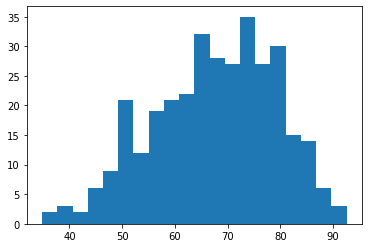

After filtering: numseqlets 328


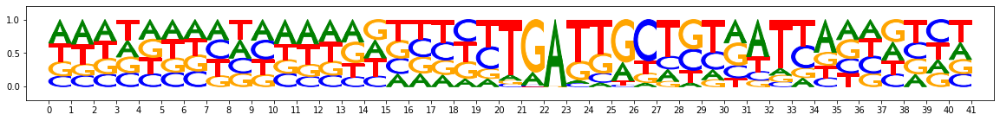

Numseqles: 330


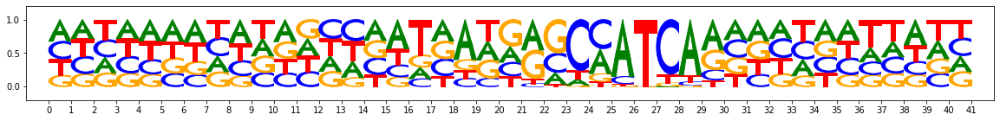

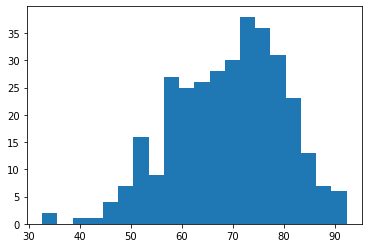

After filtering: numseqlets 326


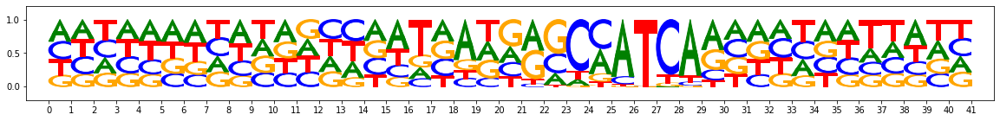

Numseqles: 272


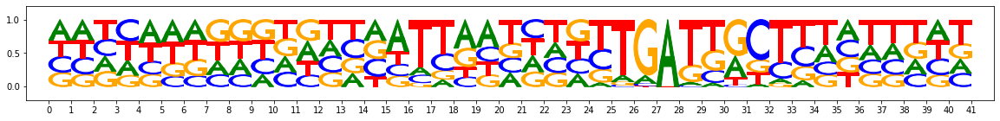

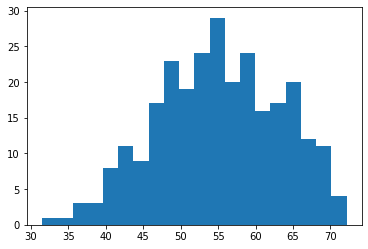

After filtering: numseqlets 271


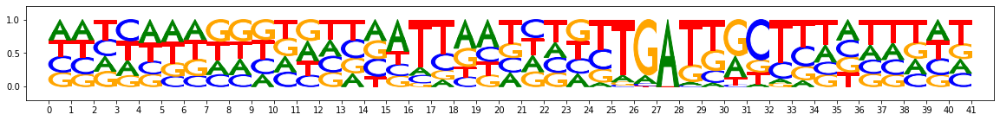

Numseqles: 248


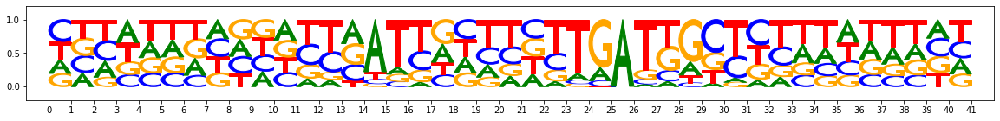

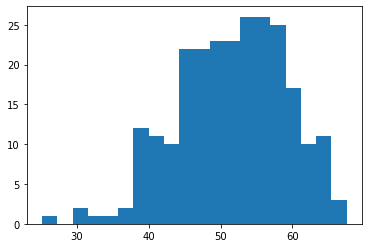

After filtering: numseqlets 245


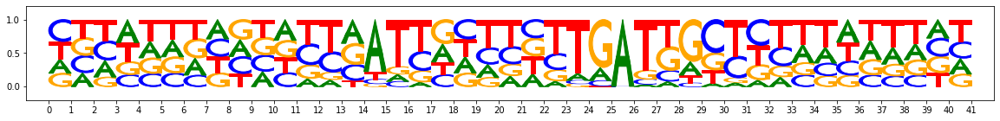

Numseqles: 174


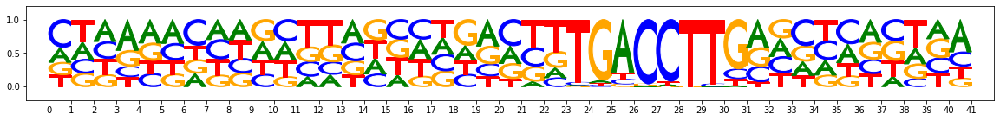

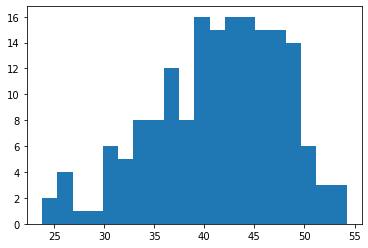

After filtering: numseqlets 172


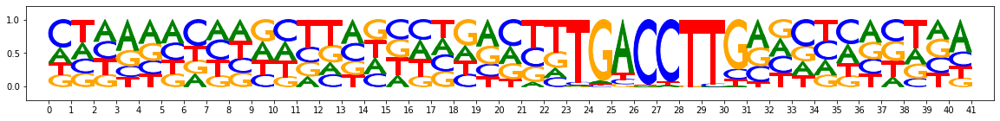

Numseqles: 170


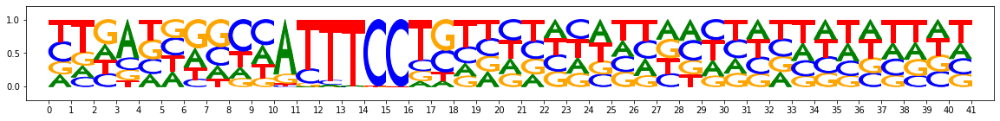

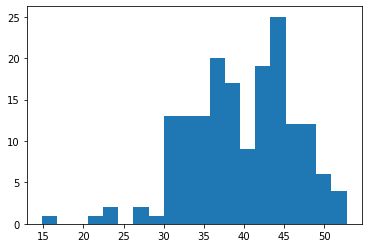

After filtering: numseqlets 167


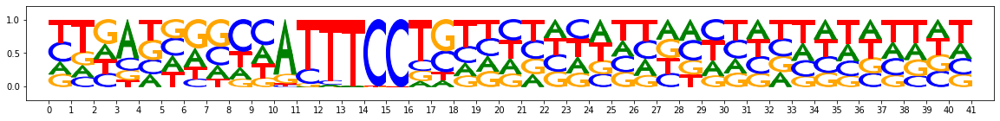

Numseqles: 122


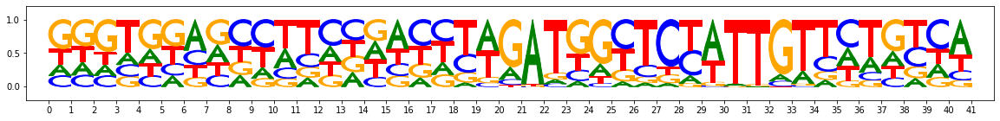

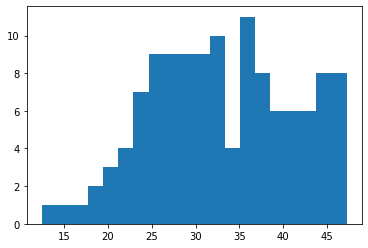

After filtering: numseqlets 118


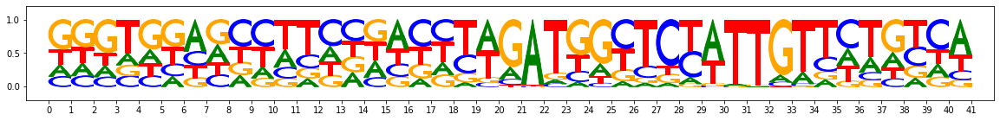

Numseqles: 97


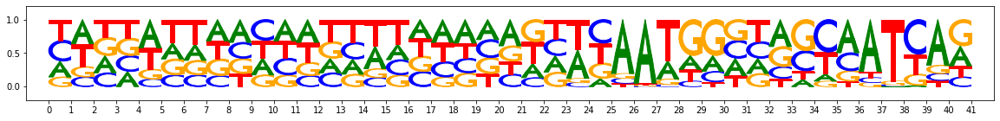

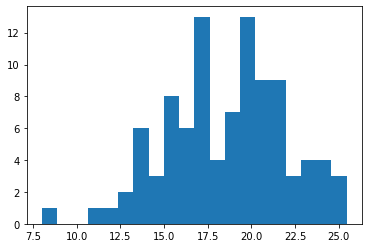

After filtering: numseqlets 95


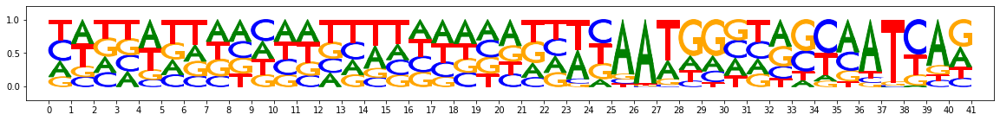

Numseqles: 95


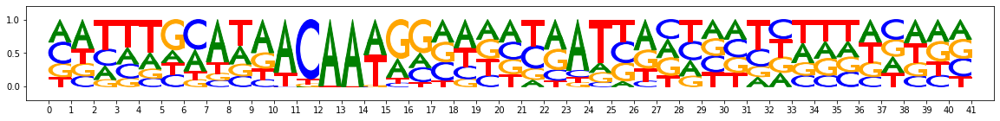

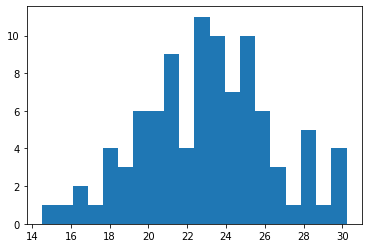

After filtering: numseqlets 95


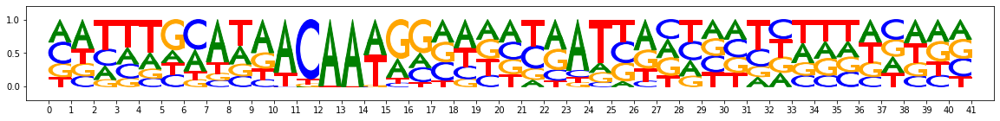

Numseqles: 101


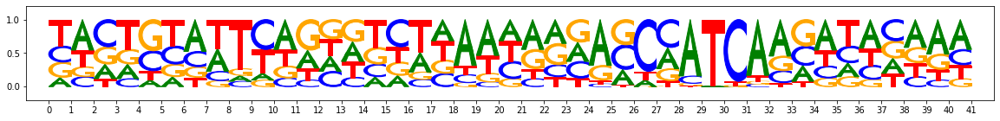

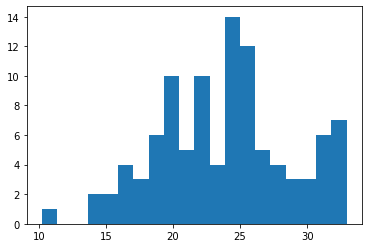

After filtering: numseqlets 99


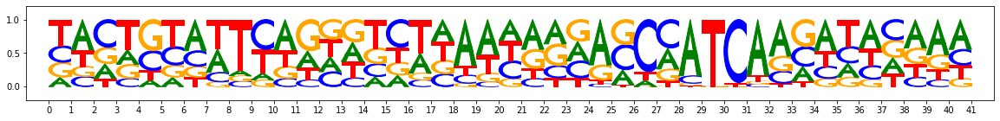

In [135]:
from collections import defaultdict



def flatten_seqlet_impscore_features(seqlet_impscores):
    return np.reshape(seqlet_impscores, (len(seqlet_impscores), -1))


def facility_locator(distmat, num_exemplars):
    exemplars = [] 
    current_bestrep = np.inf*np.ones(distmat.shape[0])
    for i in range(min(num_exemplars, len(distmat))):
        candidate_newbestrep = np.minimum(distmat, current_bestrep[None,:])  
        candidate_objective = np.sum(candidate_newbestrep, axis=-1) 
        next_best_exemplar = np.argmin(candidate_objective) 
        exemplars.append(next_best_exemplar)
        current_bestrep = candidate_newbestrep[next_best_exemplar]
    return exemplars


def compute_continjacc_sims_1vmany(vec1, vecs2, vecs2_weighting):
    sign_vec1, signs_vecs2 = np.sign(vec1), np.sign(vecs2)
    abs_vec1, abs_vecs2 = np.abs(vec1), np.abs(vecs2)
    intersection = np.sum((np.minimum(abs_vec1[None,:], abs_vecs2[:,:])
                           *sign_vec1[None,:]*signs_vecs2[:,:])*vecs2_weighting, axis=-1)
    union = np.sum(np.maximum(abs_vec1[None,:], abs_vecs2[:,:])*vecs2_weighting, axis=-1)
    return intersection/union


def compute_pairwise_continjacc_sims(vecs1, vecs2, vecs2_weighting=None):
    #normalize vecs2_weighting to sum to 1
    if (vecs2_weighting is None):
        vecs2_weighting = np.ones_like(vecs2)
    assert np.min(vecs2_weighting) >= 0
    return np.array([compute_continjacc_sims_1vmany(
                         vec1=vec1, vecs2=vecs2,
                         vecs2_weighting=vecs2_weighting)
                     for vec1 in vecs1])
    #compute the pairwise continjacc sims between the vecs
    #signs_vecs1, signs_vecs2 = np.sign(vecs1), np.sign(vecs2)
    #absvals_vecs1, absvals_vecs2 = np.abs(vecs1), np.abs(vecs2)
    #intersection = np.sum(np.minimum(absvals_vecs1[:,None,:], absvals_vecs2[None,:,:])
    #                      *signs_vecs1[:,None,:]*signs_vecs2[None,:,:], axis=-1)
    #union = np.sum(np.maximum(absvals_vecs1[:,None,:], absvals_vecs2[None,:,:]), axis=-1)
    #return intersection/union
  

def make_aggregated_seqlet(seqlets):
    seqletsandalignments = modisco.core.SeqletsAndAlignments()
    [seqletsandalignments.append(modisco.core.SeqletAndAlignment(
        seqlet=seqlet,
        alnmt=0)) for seqlet in seqlets if seqlet not in seqletsandalignments]
    reconstructed_motif = modisco.core.AggregatedSeqlet(seqletsandalignments)
    return reconstructed_motif

    
def get_exemplar_aggseqlets(seqlets, pattern_comparison_settings,
                            seqlets_per_exemplar, max_exemplars,
                            affmat_min_frac_of_median):
    print("Numseqles:", len(seqlets))
    #seqlets should already be aligned relative to each other
    #extract the features
    fwd_seqlet_data, _ = modisco.core.get_2d_data_from_patterns(
        patterns=seqlets,
        track_names=pattern_comparison_settings.track_names,
        track_transformer=
         pattern_comparison_settings.track_transformer)
    #flatten the fwd_seqlet_data
    fwd_seqlet_data_vectors = flatten_seqlet_impscore_features(fwd_seqlet_data)
    #compute the affinity matrix
    orig_affmat = compute_pairwise_continjacc_sims(vecs1=fwd_seqlet_data_vectors,
                                              vecs2=fwd_seqlet_data_vectors)
    #Let's kick out seqlets for which the sum of the affmat across all
    # neighbors is less than affmat_min_frac_of_median
    sum_orig_affmat = np.sum(orig_affmat, axis=-1)
    median_sum_affmat = np.median(sum_orig_affmat)
    passing_mask = (sum_orig_affmat > affmat_min_frac_of_median*median_sum_affmat)
    
    #get a new affmat and seqlets that are subsetted
    affmat = orig_affmat[passing_mask,:][:,passing_mask]
    seqlets = [seqlet for seqlet,is_passing in zip(seqlets, passing_mask)
               if is_passing]
    filtered_orig_motif = make_aggregated_seqlet(seqlets)
    
    
    #convert to distance matrix
    distmat = 1/( np.maximum(affmat,1e-7) )
    #get exemplars
    seqlet_exemplar_indices = facility_locator(
        distmat=distmat,
        num_exemplars=min(max_exemplars, int(np.ceil(len(seqlets)/seqlets_per_exemplar)) ))
    #aggregate over the similar ones, return the aggseqlets
    representive_exemplars = np.argmax(affmat[:, seqlet_exemplar_indices],
                                         axis=-1)
    exemplar_to_seqletsandalignments =\
        defaultdict(lambda: modisco.core.SeqletsAndAlignments())
    for seqlet, representive_exemplar in zip(seqlets, representive_exemplars):
        exemplar_to_seqletsandalignments[representive_exemplar].append(
            modisco.core.SeqletAndAlignment(seqlet=seqlet, alnmt=0) )
    exemplar_to_motif = dict([
        (exemplar, modisco.core.AggregatedSeqlet(seqletsandalignments))
        for exemplar,seqletsandalignments in exemplar_to_seqletsandalignments.items()])
    motifs = [exemplar_to_motif[i] for i in sorted(exemplar_to_motif.keys())]
    
    return motifs, affmat, filtered_orig_motif, sum_orig_affmat
    

#for building the classifiers:
PATTERN_COMPARISON_SETTINGS =\
            modisco.affinitymat.core.PatternComparisonSettings(                         
                track_names=["Nanog_profile_wn_hypothetical_contribs",
                             "Nanog_profile_wn_contrib_scores"],                      
                track_transformer=modisco.affinitymat.L1Normalizer(),                   
                min_overlap=0.7)

BG_FREQ = np.mean(one_hot, axis=(0,1))
AFFMAT_MIN_FRAC_OF_MEDIAN = 0.6

#start by trimming the patterns to the lengths of the original seqlets
prefilt_trimmed_patterns = modisco.aggregator.TrimToBestWindowByIC(                                    
                    window_size=41,                           
                    onehot_track_name="sequence",                            
                    bg_freq=BG_FREQ)(patterns)

print("Getting the exemplar motifs")
#Take each pattern
#Identify some number of exemplars and aggregate around them
exemplarmotifs_foreach_pattern = []
withinpattern_affmats = []
trimmed_patterns = []
for pattern in prefilt_trimmed_patterns:
    exemplarmotifs, patternaffmat, filtered_orig_motif, sum_orig_affmat = get_exemplar_aggseqlets(
      seqlets=pattern.seqlets,
      pattern_comparison_settings=PATTERN_COMPARISON_SETTINGS,
      seqlets_per_exemplar=30,
      max_exemplars=10,
      affmat_min_frac_of_median = AFFMAT_MIN_FRAC_OF_MEDIAN)
    exemplarmotifs_foreach_pattern.append(exemplarmotifs)
    withinpattern_affmats.append(patternaffmat)
    trimmed_patterns.append(filtered_orig_motif)
    
    viz_sequence.plot_weights(pattern["sequence"].fwd)
    plt.hist(sum_orig_affmat, bins=20)
    plt.show()
    print("After filtering: numseqlets", len(filtered_orig_motif.seqlets))
    viz_sequence.plot_weights(filtered_orig_motif["sequence"].fwd)
    

#Trim to the width used for seqlets
# Positive set: seqlets correctly centered.
# Negative set: seqlets in other motifs + unaligned seqlets
#Score with ALL seqlets & train SVM

Numseqles: 876


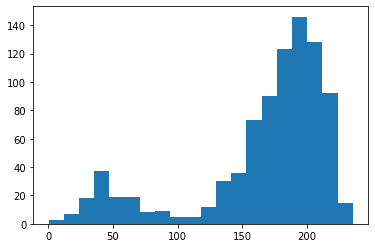

Original


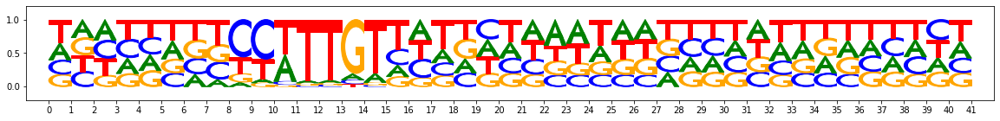

Retaining only the second mode


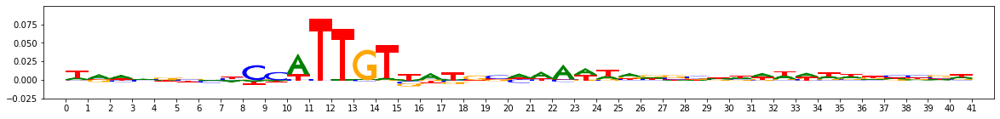

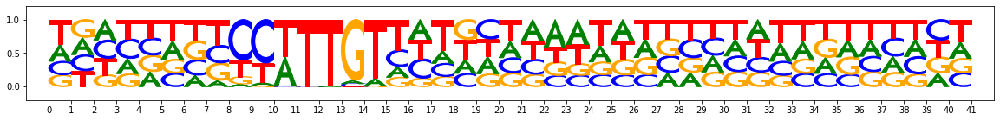

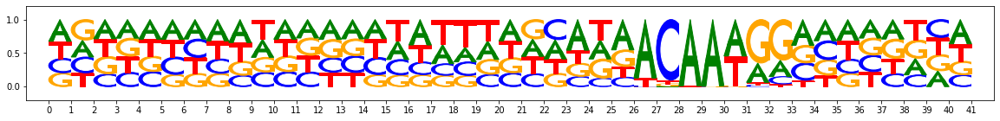

In [112]:
#Let's take a deeper dive into one of the poorer-quality patterns
poor_quality_pattern = prefilt_trimmed_patterns[0]
poor_quality_pattern_exemplars, poor_quality_pattern_affmat, _, _ = get_exemplar_aggseqlets(
      seqlets=poor_quality_pattern.seqlets,
      pattern_comparison_settings=PATTERN_COMPARISON_SETTINGS,
      seqlets_per_exemplar=30,
      max_exemplars=10,
      affmat_min_frac_of_median=0)

#sum the affmat, find crappy aligning seqlets
poorquality_sumaffmat = np.sum(poor_quality_pattern_affmat, axis=1)
from matplotlib import pyplot as plt
plt.hist(poorquality_sumaffmat, bins=20)
plt.show()

from modisco.visualization import viz_sequence


print("Original")
viz_sequence.plot_weights(poor_quality_pattern["sequence"].fwd)
#Let's make a new aggregated seqlet for all the ones where the similarity is > 100
cleaner_motif = make_aggregated_seqlet(
        [seqlet for seqlet, sumaff in zip(poor_quality_pattern.seqlets, poorquality_sumaffmat)
         if sumaff > 100])

print("Retaining only the second mode")
viz_sequence.plot_weights(cleaner_motif["Nanog_profile_wn_contrib_scores"].fwd)
viz_sequence.plot_weights(cleaner_motif["sequence"].fwd)
viz_sequence.plot_weights(cleaner_motif["sequence"].rev)

123
The poorly-aligning seqlets:


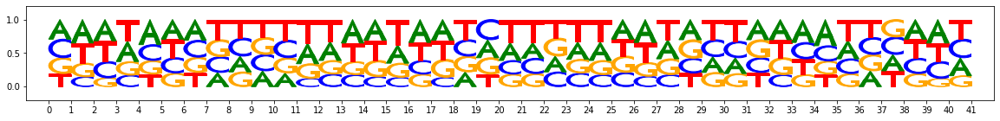

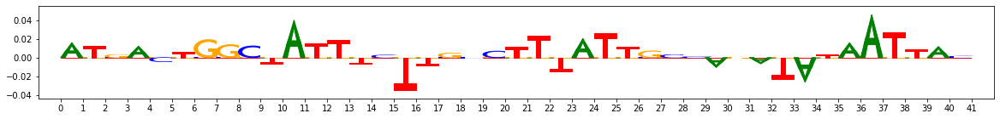

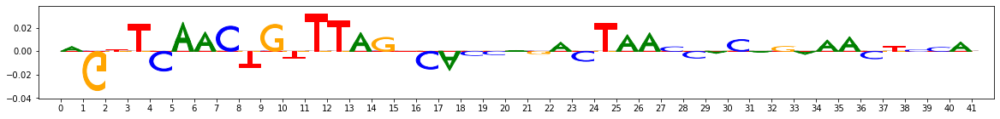

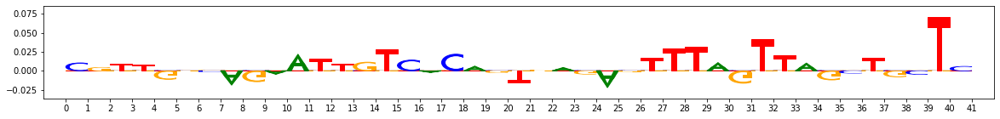

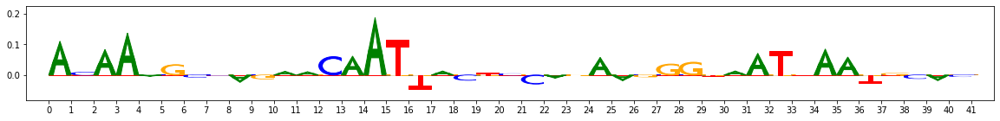

...

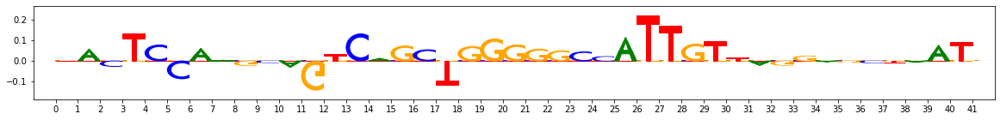

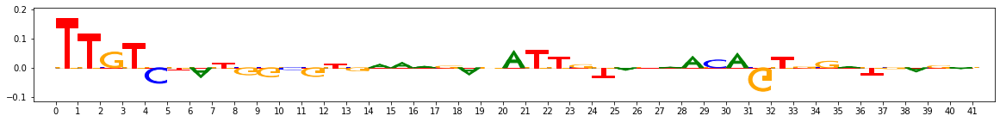

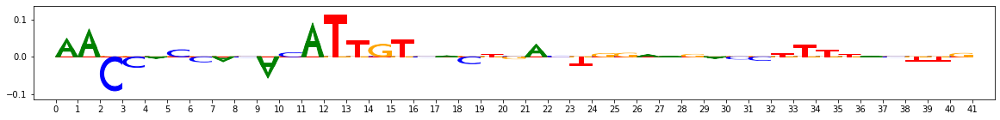

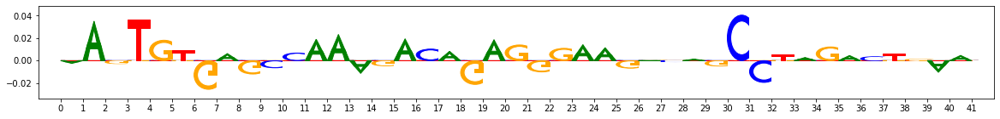

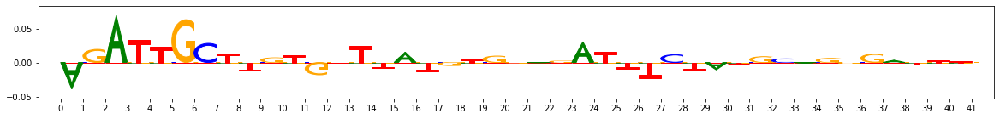

In [113]:
#What's going on with the first mode? Visualize some seqlets
poorly_aligning_seqlets = [seqlet for seqlet, sumaff in zip(poor_quality_pattern.seqlets, poorquality_sumaffmat)
                           if sumaff <= 100]
print(len(poorly_aligning_seqlets))
pooralignseqlets_motif = make_aggregated_seqlet(
        [seqlet for seqlet, sumaff in zip(poor_quality_pattern.seqlets, poorquality_sumaffmat)
         if sumaff <= 100])
print("The poorly-aligning seqlets:")
viz_sequence.plot_weights(pooralignseqlets_motif["sequence"].fwd)

#Visualize them individually
for seqlet in poorly_aligning_seqlets[:10]:
    viz_sequence.plot_weights(seqlet["Nanog_profile_wn_contrib_scores"].fwd)

In [114]:
#gets the shifts of the provided coordinate - everything except 0
def get_shifts(seqlet_coordinate, shift_fraction, max_seq_len):
    shift_size_in_bp = int((seqlet_coordinate.end-
                            seqlet_coordinate.start)*shift_fraction)
    coordinates_to_return = []
    for shift_size in range(-shift_size_in_bp,shift_size_in_bp+1):
        new_start = seqlet_coordinate.start + shift_size
        new_end = seqlet_coordinate.end + shift_size
        if (new_start >= 0 and new_end <= max_seq_len):
            coordinates_to_return.append(modisco.core.SeqletCoordinates(
                example_idx=seqlet_coordinate.example_idx,
                start=new_start,
                end=new_end,
                is_revcomp=seqlet_coordinate.is_revcomp))
    return coordinates_to_return

print("Getting labels")
all_coordinates = [
    coor
    for pattern in trimmed_patterns
    for seqlet in pattern.seqlets
    for coor in get_shifts(seqlet_coordinate=seqlet.coor, shift_fraction=0.3,
                           max_seq_len=len(one_hot[seqlet.coor.example_idx]))
]
patternidx_to_positivecoordinates = dict([
    (patternidx, set(str(seqlet.coor) for seqlet in trimmed_patterns[patternidx].seqlets))
    for patternidx in range(len(trimmed_patterns))
])
#get the labels for the coordinates depending on the patterns
labels = np.zeros((len(all_coordinates), len(trimmed_patterns)))
for patternidx in range(len(trimmed_patterns)):
    labels[:,patternidx] = np.array([
        1 if str(coor) in patternidx_to_positivecoordinates[patternidx] else 0
        for coor in all_coordinates ])

print("Creating seqlets")
all_coordinates_seqlets = track_set.create_seqlets(coords=all_coordinates)
all_exemplarmotifs = []
pattern_to_exemplarmotifsidxs = [0]
for patternidx in range(len(trimmed_patterns)):
    all_exemplarmotifs.extend(exemplarmotifs_foreach_pattern[patternidx])
    pattern_to_exemplarmotifsidxs.append(
        pattern_to_exemplarmotifsidxs[-1]+
        len(exemplarmotifs_foreach_pattern[patternidx]))

all_exemplarmotifs = [exemplarmotif
    for patternidx in range(len(trimmed_patterns)) 
    for exemplarmotif in exemplarmotifs_foreach_pattern[patternidx]]

print("Getting impscores data")
#get features for each pattern based on similarity to exemplars.
#first get the importance scores and such
allcoordinatesseqlet_impscoresdata_fwd, _ =\
    modisco.core.get_2d_data_from_patterns(
        patterns=all_coordinates_seqlets,
        track_names=PATTERN_COMPARISON_SETTINGS.track_names,
        track_transformer=PATTERN_COMPARISON_SETTINGS.track_transformer)
allexemplarmotifs_impscoresdata_fwd, allexemplarmotifs_impscoresdata_rev =\
    modisco.core.get_2d_data_from_patterns(
        patterns=all_exemplarmotifs,
        track_names=PATTERN_COMPARISON_SETTINGS.track_names,
        track_transformer=PATTERN_COMPARISON_SETTINGS.track_transformer)

allcoordinatesseqlet_impscoresdata_fwd = (
    flatten_seqlet_impscore_features(allcoordinatesseqlet_impscoresdata_fwd))
allexemplarmotifs_impscoresdata_fwd =(
    flatten_seqlet_impscore_features(allexemplarmotifs_impscoresdata_fwd))
allexemplarmotifs_impscoresdata_rev =(
    flatten_seqlet_impscore_features(allexemplarmotifs_impscoresdata_rev))

allexemplarmotifs_sequence_fwd, allexemplarmotifs_sequence_rev =\
    modisco.core.get_2d_data_from_patterns(
        patterns=all_exemplarmotifs,
        track_names=["sequence"],
        track_transformer=lambda x: x)
#compute the per-position IC, then tile and flatten to
# get it into vector form.
per_position_ic_allexemplarmotifs_fwd =\
    np.maximum(flatten_seqlet_impscore_features(np.array([
        np.tile(modisco.util.compute_per_position_ic(
            ppm=x,
            background=background,
            pseudocount=0.001)[:,None],
          (1,4*len(PATTERN_COMPARISON_SETTINGS.track_names)))
        for x in allexemplarmotifs_sequence_fwd])),0)
per_position_ic_allexemplarmotifs_rev =\
    np.maximum(flatten_seqlet_impscore_features(np.array([
        np.tile(modisco.util.compute_per_position_ic(
            ppm=x,
            background=background,
            pseudocount=0.001)[:,None],
         (1,4*len(PATTERN_COMPARISON_SETTINGS.track_names)))
        for x in allexemplarmotifs_sequence_rev])),0)

import time
start = time.time()
print("Computing fwd sims")
features_matrix_fwd = compute_pairwise_continjacc_sims(
    vecs1=allcoordinatesseqlet_impscoresdata_fwd,
    vecs2=allexemplarmotifs_impscoresdata_fwd,
    vecs2_weighting=per_position_ic_allexemplarmotifs_fwd)
print("Took",time.time()-start,"s")
start = time.time()
features_matrix = features_matrix_fwd
#We ignore the rc because we want to annotate seqlets as
# matches *for a specific orientation*
#print("Computing rev sims")
#features_matrix_rev = compute_pairwise_continjacc_sims(
#    vecs1=allcoordinatesseqlet_impscoresdata_fwd,
#    vecs2=allexemplarmotifs_impscoresdata_rev,
#    vecs2_weighting=per_position_ic_allexemplarmotifs_rev)
#print("Took",time.time()-start,"s")
#print("Features matrix")
#features_matrix = np.maximum(features_matrix_fwd,
#                             features_matrix_rev)

Getting labels
Creating seqlets
Getting impscores data
Computing fwd sims
Took 88.81620645523071 s
Computing rev sims
Took 87.93107390403748 s
Features matrix


In [127]:
import umap
embedding = umap.UMAP(verbose=True, random_state=1234).fit_transform(features_matrix)

UMAP(random_state=1234, verbose=True)
Construct fuzzy simplicial set
Thu Sep 17 18:45:43 2020 Finding Nearest Neighbors
Thu Sep 17 18:45:43 2020 Building RP forest with 21 trees
Thu Sep 17 18:45:45 2020 NN descent for 17 iterations
	 0  /  17
	 1  /  17
	 2  /  17
	 3  /  17
Thu Sep 17 18:45:57 2020 Finished Nearest Neighbor Search
Thu Sep 17 18:45:58 2020 Construct embedding
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Thu Sep 17 18:48:40 2020 Finished embedding


In [128]:
import sklearn

multiclass_labels = (
    (np.argmax(labels,axis=-1)+1)*(np.max(labels, axis=-1) > 0))

#pattern_to_exemplarmotifsidxs[0]:pattern_to_exemplarmotifsidxs[1]
cls = sklearn.linear_model.LogisticRegression(
        class_weight='balanced',
        multi_class='multinomial',
        verbose=5,
        random_state=1234,
        n_jobs=10,
        max_iter=3000).fit(
            features_matrix[:], multiclass_labels)


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done   1 out of   1 | elapsed:   39.4s finished


In [129]:
preds = cls.predict(features_matrix)
preds_proba = cls.predict_proba(features_matrix)

In [130]:
sklearn.metrics.confusion_matrix(
    y_true=multiclass_labels, y_pred=preds)

array([[90068,   340,   381,   261,   613,  1452,   729,  1301,  1385,
          151,   185,   688,  1829,  1022,   815],
       [    0,   756,     1,     0,     0,     1,     0,     0,     0,
            0,     0,     0,     0,     0,     0],
       [    1,     0,   827,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0],
       [    1,     0,     0,   393,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0],
       [    1,     0,     0,     0,   343,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0],
       [    1,     0,     0,     0,     0,   329,     0,     0,     0,
            0,     0,     0,     0,     0,     0],
       [    0,     0,     0,     0,     0,     0,   328,     0,     1,
            0,     0,     0,     0,     0,     0],
       [    0,     0,     0,     0,     0,     0,     0,   286,     0,
            0,     0,     0,     0,     0,     0],
       [    0,     0,   

In [131]:
features_matrix.shape

(105525, 107)

In [132]:
preds_proba.shape

(105525, 15)

-------------------------------------------------------
PATTERNIDX 0 numseqlets 750


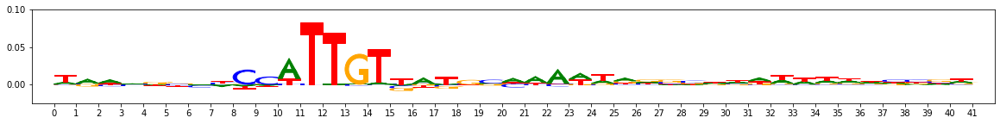

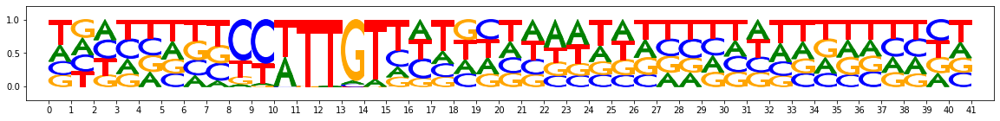

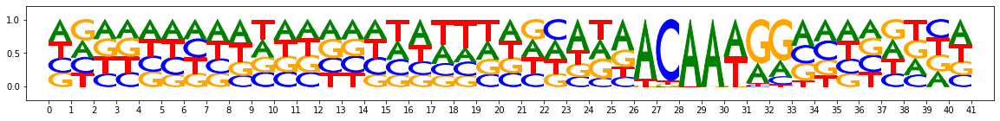

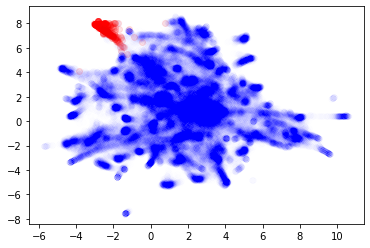

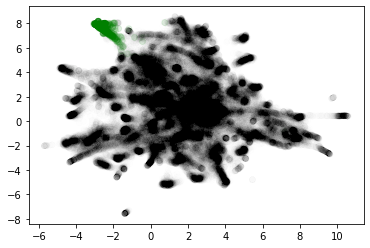

Chosen threshold: 0.9557377785010427 Precision: 0.9006289308176101 Recall: 0.9445910290237467


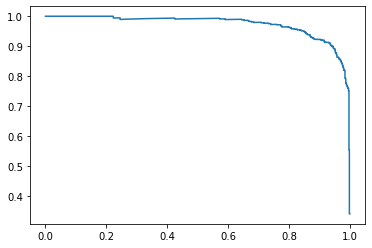

AuPRC: 0.9733681105722899
Reconstructed motif using threshold - numseqlets 788


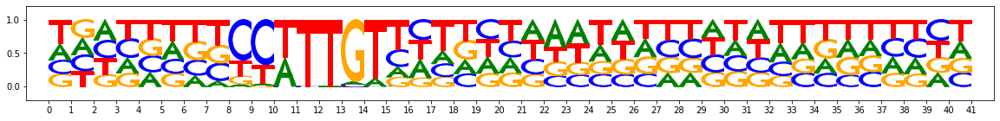

Reconstructed motif using argmax - numseqlets 1088


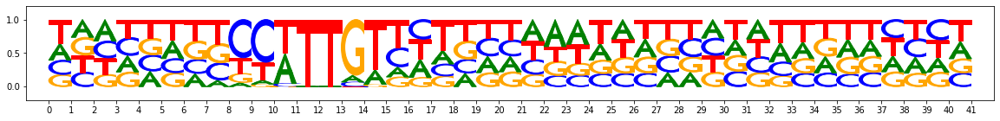

Sample false positive seqlets:
index 2428 example:115,start:424,end:465,rc:True
Features: [ 3.38703124e-01  3.64797497e-01  3.20562664e-01  2.95672140e-01
  2.81722102e-01  3.41949878e-01  4.06817662e-01  3.07638996e-01
  3.70103890e-01  3.00976628e-01  1.24001935e-01  6.85809824e-02
  1.28468505e-01  1.14276502e-01  6.15693378e-02  1.05405250e-01
  1.25296257e-01  1.03614288e-01  1.60656981e-01  9.30782382e-02
  2.40231302e-02  3.43540824e-02  4.00137668e-02  2.12452338e-02
  4.18802770e-02  2.02959391e-02  6.59843258e-02  3.71809905e-02
  1.91998132e-02  3.91487641e-02  1.12792264e-02  2.79741816e-02
  1.70773505e-02  1.92686885e-02  4.06927175e-02  6.30752724e-02
  3.17694696e-02  3.84530073e-02  1.11298922e-02  3.62624874e-02
  1.08880161e-01  9.56660090e-02  1.03572696e-01  1.20546277e-01
  4.13415540e-02  1.40134635e-01  4.99535826e-02  2.32479156e-01
  9.52705766e-02  9.15121841e-02 -3.49644781e-02 -3.19702961e-02
 -2.02302239e-02 -3.01210148e-02 -4.42937357e-02  3.23827329e-02


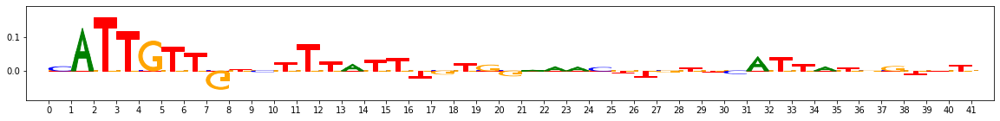

index 31739 example:27,start:415,end:456,rc:True
Features: [0.37778243 0.35048344 0.32430516 0.32331535 0.28627738 0.36344621
 0.40141445 0.31565429 0.39751908 0.39812209 0.13835443 0.11637828
 0.17857614 0.12327563 0.10848885 0.14160696 0.16196364 0.17824096
 0.13426277 0.14492878 0.06539642 0.06923077 0.05907079 0.06594009
 0.08689783 0.05569161 0.08059035 0.07083771 0.09009975 0.08291768
 0.03100268 0.05451518 0.06959797 0.01664172 0.05424788 0.10155802
 0.06907619 0.05878704 0.03627361 0.06695615 0.10256694 0.10455221
 0.12313804 0.08530091 0.0822959  0.13374115 0.10252138 0.12003221
 0.14078825 0.11445088 0.01594377 0.0248517  0.01916898 0.00531217
 0.0087282  0.03718631 0.00710925 0.00925687 0.05094162 0.01735878
 0.14693868 0.13815222 0.14724878 0.09139419 0.12971842 0.13612709
 0.14132838 0.14176718 0.16168482 0.15730139 0.04411422 0.1274818
 0.03929972 0.10269451 0.07327942 0.06406932 0.06025534 0.02720471
 0.05196503 0.16911622 0.16343727 0.13089647 0.17176307 0.09408941
 0.1

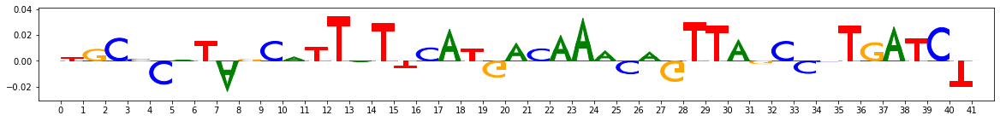

index 60645 example:408,start:494,end:535,rc:False
Features: [ 0.29867158  0.31369095  0.26741542  0.27209019  0.25891608  0.30474017
  0.31550941  0.28349221  0.33313396  0.37495082  0.07416776  0.04690886
  0.11730482  0.08603449  0.02295714  0.07579493  0.12455601  0.13451801
  0.0903265   0.06368669  0.02238128  0.03852207  0.02994383  0.04537285
  0.04027258  0.01857896  0.04694533  0.02169775  0.03208316  0.04691117
  0.10144544  0.11202795  0.09908261  0.09116121  0.09039027  0.13225133
  0.09167871  0.09731751  0.07747574  0.11643026  0.0237882   0.03496287
  0.00590542  0.0524209   0.0253129   0.0243143   0.02123596  0.03455919
  0.02247523 -0.00510076 -0.00868882 -0.00243849 -0.00969094 -0.0052352
 -0.00766448  0.00447521  0.03215934 -0.00916042  0.01430112 -0.00485049
  0.04336002  0.02538498  0.0305739   0.05761206  0.11265203  0.04335323
  0.02582876  0.03580966  0.07065463  0.02884455  0.15879606  0.34235259
  0.08641246  0.10292024  0.15755116  0.20142063  0.14293794  0.

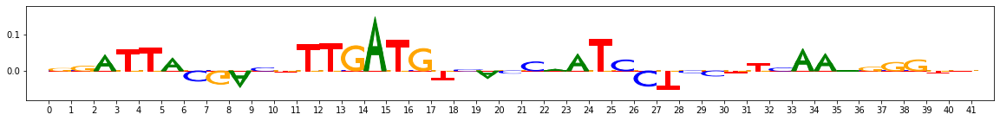

index 76304 example:739,start:354,end:395,rc:True
Features: [ 3.45969329e-01  3.02096958e-01  3.85204423e-01  2.86091248e-01
  2.49965955e-01  3.55555222e-01  3.32246130e-01  3.39879037e-01
  4.18761855e-01  3.54356057e-01  7.74369050e-02  2.68589215e-02
  6.14197142e-02  9.05517860e-02  2.93515220e-02  2.80651611e-02
  6.98040356e-02  9.66233386e-02  1.19858697e-01  1.20918255e-02
  4.07909623e-02  6.76380502e-02  5.63388141e-02  3.82377679e-02
  3.49639004e-02  5.22061571e-02  7.08778815e-02  5.59234796e-02
  7.05951928e-02  5.96392581e-02  6.52518953e-02  8.26092020e-02
  7.75255455e-02  6.34771834e-02  7.87404993e-02  1.36761643e-01
  5.87862719e-02  9.01475924e-02  6.12794473e-02  8.95466632e-02
  8.70862363e-02  1.42418323e-01  1.03564703e-01  4.40030410e-02
  1.04037722e-01  7.54811011e-02  7.55397104e-02  7.14382982e-02
  1.51742255e-01  1.16641900e-01  8.91935992e-03  6.33099083e-03
 -1.52785524e-03  7.46693238e-05  2.09629237e-02  2.18579643e-03
  1.90261362e-03  1.26468446e-

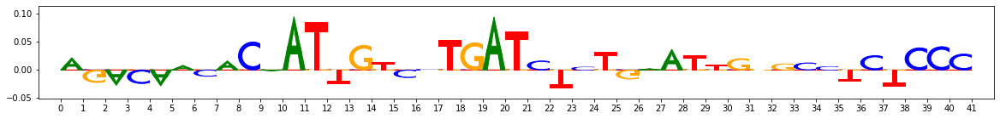

index 87126 example:863,start:528,end:569,rc:True
Features: [ 0.36884448  0.35843575  0.31931413  0.34593272  0.30046273  0.37889527
  0.42031449  0.33739128  0.41277875  0.34662583  0.13972102  0.07614695
  0.14935639  0.12022222  0.05853116  0.12221519  0.17876654  0.17989725
  0.14451163  0.10382472  0.05147482  0.09610924  0.05165931  0.04903537
  0.09717585  0.05440396  0.09342748  0.06449036  0.07159624  0.07841595
  0.03995393  0.04605579  0.03910101  0.03751775  0.06828706  0.07425542
  0.04090278  0.05111187  0.03773941  0.04960777  0.04619227  0.05987694
  0.06368296  0.0636616   0.03507002  0.06115865  0.04341563  0.06356306
  0.0797746   0.04217848  0.04054616  0.05218904  0.05565582  0.05528233
  0.0416401   0.06845118  0.07223786  0.03529053  0.04589889  0.06364056
  0.01568189  0.03476534 -0.00727074  0.04994239 -0.03459389 -0.00764355
  0.00215725 -0.0034619  -0.01832837 -0.01149166  0.16193272  0.27833825
  0.1028038   0.11071589  0.18890381  0.23831323  0.17590927  0.

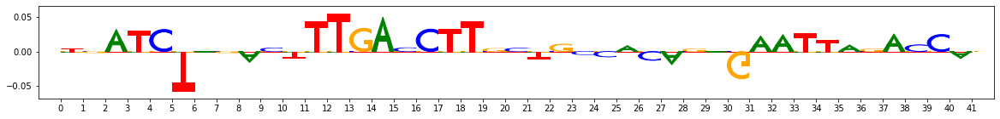

Sample false negative seqlets:
index 12 example:75,start:461,end:502,rc:True
Features: [ 4.77432842e-01  3.69414284e-01  3.97733244e-01  3.87473707e-01
  2.96448708e-01  4.18108973e-01  4.05692949e-01  3.69235417e-01
  4.96526081e-01  3.76307534e-01  1.44832505e-01  1.30966191e-01
  1.80722864e-01  1.03507604e-01  1.11223481e-01  1.14378805e-01
  1.78963517e-01  1.26055264e-01  1.52503021e-01  1.77693886e-01
  1.20729879e-02  3.11586497e-02  9.00369844e-03  6.04117036e-03
  1.86408609e-02  1.79450037e-04  5.32051163e-02  7.94150826e-03
  3.83009690e-03  1.75573020e-02 -1.14685701e-02  3.50642366e-03
  1.47443867e-02 -1.71738722e-02  6.20610383e-03  7.08749358e-02
  1.07007054e-02  2.28502819e-03 -5.58922333e-03  1.94263914e-02
  3.16136080e-01  2.84335328e-01  3.64919423e-01  3.40292204e-01
  2.63152267e-01  2.96883157e-01  3.52165156e-01  3.01793625e-01
  4.16958530e-01  3.26069296e-01  2.73063309e-02  1.79097102e-02
  3.69876694e-02  1.90730397e-02  2.35019881e-02  3.52628767e-03
  2

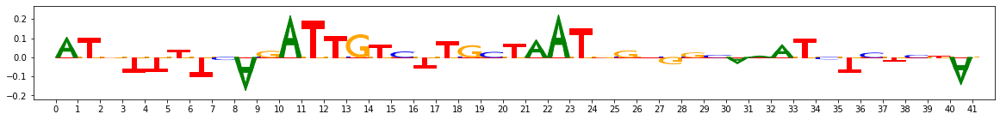

index 3787 example:465,start:510,end:551,rc:True
Features: [0.50750017 0.51259484 0.46175085 0.44347458 0.42635164 0.53667632
 0.59781223 0.44981813 0.55050479 0.44097628 0.13681139 0.09155631
 0.18691395 0.12570344 0.07600207 0.1320406  0.1829811  0.17046781
 0.16555358 0.11650197 0.01346851 0.04229149 0.01242733 0.00810743
 0.02760689 0.00438078 0.05447099 0.01128736 0.01969883 0.0158465
 0.01938604 0.05138791 0.03601088 0.03124174 0.03338428 0.07002716
 0.0275187  0.0341128  0.01628147 0.02926297 0.23243349 0.19740272
 0.2156904  0.2405937  0.11565979 0.23493687 0.13322703 0.25796614
 0.19369741 0.23139914 0.10355153 0.11204575 0.12080645 0.08846845
 0.09044533 0.15842725 0.10915163 0.07870017 0.07868403 0.1288895
 0.04070675 0.02571683 0.025706   0.04500944 0.03243404 0.04084308
 0.00792587 0.07924492 0.03812589 0.04672072 0.20336878 0.29591832
 0.1878475  0.11492397 0.22934546 0.2603936  0.24255326 0.16711094
 0.18989173 0.13317094 0.11416231 0.1256154  0.15842624 0.10554922
 0.10

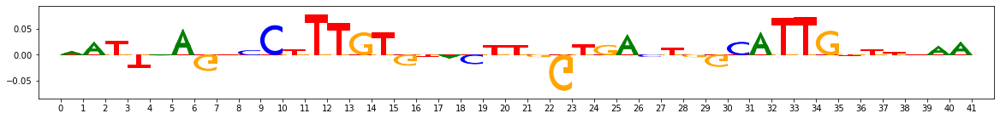

index 7587 example:698,start:452,end:493,rc:True
Features: [ 6.00489639e-01  6.68365031e-01  5.70715132e-01  5.60019368e-01
  5.61799710e-01  6.24904851e-01  6.39945390e-01  5.80428883e-01
  6.31380104e-01  5.17276687e-01  1.60273407e-01  9.52643151e-02
  1.83050004e-01  1.55480819e-01  9.56649732e-02  1.39058434e-01
  1.81893049e-01  1.55375048e-01  1.84627690e-01  1.11217718e-01
  3.70367009e-02  3.20032779e-02  3.44595936e-02  3.25746903e-02
  6.29101590e-02  2.74359704e-02  5.48802819e-02  4.47749880e-02
  3.30600805e-02  5.19418480e-02  3.11317391e-02  4.63155478e-02
  3.13136959e-02  3.57921866e-02  6.96410040e-02  6.65516809e-02
  3.82542642e-02  5.55801153e-02  2.38228174e-02  3.95859427e-02
  2.54423893e-02  7.33050361e-02  2.41695609e-02  3.72680428e-02
  3.61147784e-02  1.32607606e-02  1.67218510e-02  6.49819832e-02
  4.99139859e-02  3.43498844e-02  5.67086592e-03  3.07146150e-03
  2.37621150e-02  6.13170497e-03  4.17574403e-04  4.69544770e-02
  1.94233925e-02 -4.44040969e-0

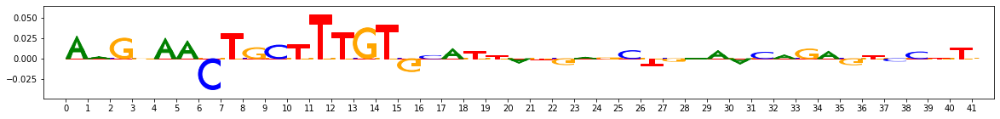

index 11362 example:117,start:328,end:369,rc:False
Features: [ 0.40475363  0.42591963  0.37410711  0.34815881  0.35941198  0.43797325
  0.48709076  0.37361056  0.40742685  0.33309749  0.15961458  0.10191585
  0.17114087  0.15690545  0.09534519  0.11858543  0.17739255  0.18489465
  0.18030354  0.10377879  0.01873453  0.01199037  0.01772638  0.01379729
  0.02980693  0.01880869  0.03795863  0.02170028  0.02413841  0.03922734
  0.03737442  0.03641333  0.04808977  0.02283764  0.01981834  0.06043337
  0.02542295  0.03438538  0.01438649  0.04907208  0.01865824  0.04577609
  0.0295682   0.03058887  0.02315305  0.02785098  0.02158119  0.02740223
  0.03576245  0.03690155  0.13413086  0.13059865  0.13187105  0.09300223
  0.13091499  0.12201054  0.15297081  0.11911538  0.12491478  0.09515663
  0.05452672  0.02240651  0.03239893  0.02108324 -0.00132867  0.03686075
  0.03494022  0.04558035  0.0275462   0.02827529  0.18334258  0.23067389
  0.17333441  0.15352141  0.19458837  0.21219414  0.16415318  0

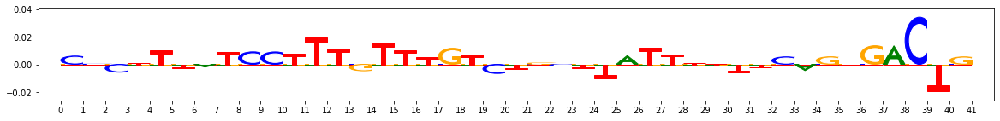

index 15162 example:731,start:541,end:582,rc:True
Features: [0.45276277 0.41497116 0.39372819 0.36277206 0.33194786 0.44007366
 0.47873165 0.40057352 0.47126545 0.43157997 0.11543359 0.07301996
 0.14951293 0.1114756  0.06294558 0.10584314 0.1406648  0.14920032
 0.15050249 0.09275698 0.04827791 0.06398603 0.05155714 0.04516631
 0.05448554 0.04182064 0.06803882 0.05571863 0.0553949  0.06875902
 0.04388598 0.08342804 0.07374848 0.04859586 0.06763481 0.1350165
 0.05788312 0.07793409 0.03921567 0.07779984 0.08913353 0.13675297
 0.10690411 0.07421575 0.09630381 0.09702568 0.10117935 0.11061031
 0.1439808  0.12096308 0.04580421 0.04437935 0.03806583 0.05002406
 0.0420296  0.05409867 0.0522629  0.04631616 0.03841031 0.07229316
 0.07989014 0.0666017  0.05512039 0.05625409 0.05978311 0.04945057
 0.04736438 0.03366464 0.05719261 0.03457789 0.04566197 0.11772772
 0.03423636 0.02325398 0.08262018 0.11563801 0.06115689 0.02591972
 0.03826702 0.06175573 0.0534816  0.06298986 0.06462338 0.082164
 0.04

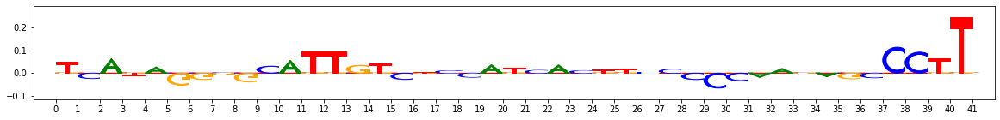

index 99282 example:228,start:389,end:430,rc:False
Features: [ 0.49511466  0.50084197  0.43538134  0.43441284  0.40150705  0.50524369
  0.52391082  0.4512717   0.54328624  0.40679001  0.19336385  0.16558233
  0.23631682  0.14234483  0.13339193  0.16850303  0.25070137  0.14950361
  0.19692452  0.20271562  0.01136611  0.01561948  0.0013551   0.00081274
  0.01197367  0.00488427  0.04037652 -0.00296244  0.00954979  0.00863597
 -0.00171592  0.00251607  0.01048478  0.00367858  0.00640052  0.03540441
  0.00328946  0.00826631  0.00218803  0.00175356  0.0839572   0.08822149
  0.17239645  0.10769168  0.03540119  0.27301782  0.050178    0.15260816
  0.08518467  0.08725144  0.08895297  0.08157758  0.09862164  0.07951756
  0.0744498   0.06046674  0.08582688  0.07657757  0.09134566  0.1011455
  0.04847203  0.08480932  0.03362963  0.01746142  0.05928858  0.04096857
  0.04659014  0.10405452  0.02741895  0.08175997  0.0799759   0.16950929
  0.07553625  0.02684022  0.08904872  0.10189304  0.08418633  0.

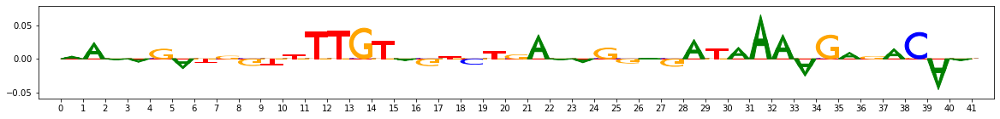

-------------------------------------------------------
PATTERNIDX 1 numseqlets 821


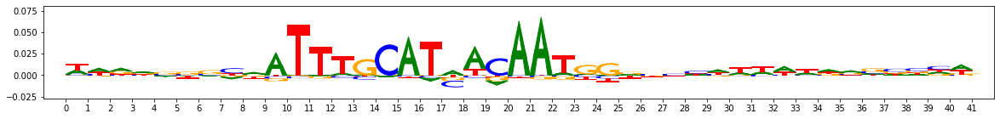

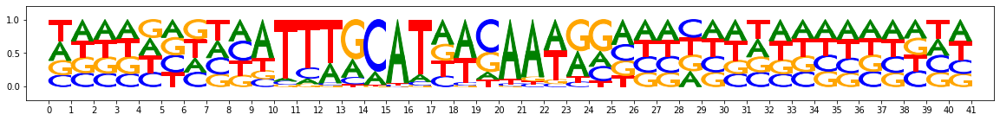

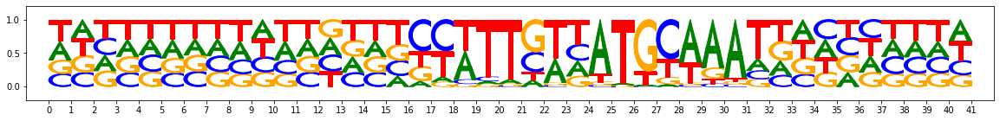

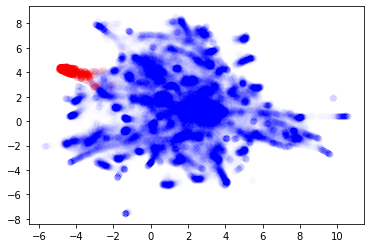

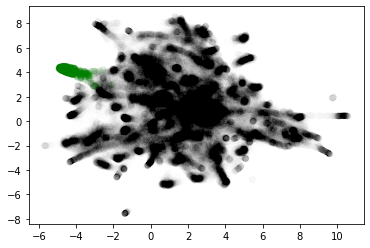

Chosen threshold: 0.9702947754433658 Precision: 0.9007009345794392 Recall: 0.9311594202898551


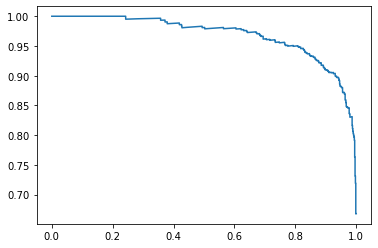

AuPRC: 0.9684613866536835
Reconstructed motif using threshold - numseqlets 849


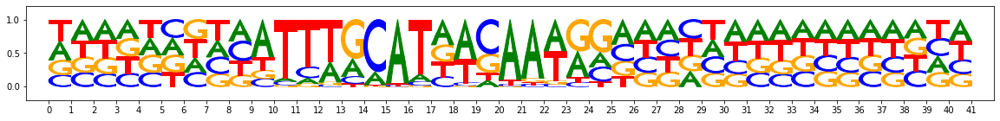

Reconstructed motif using argmax - numseqlets 1200


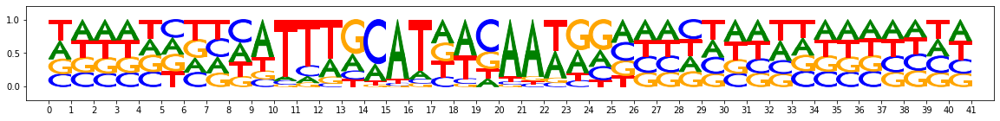

Sample false positive seqlets:
index 11 example:75,start:460,end:501,rc:True
Features: [ 0.10221073  0.11377482  0.09528196  0.0972702   0.09381262  0.10212234
  0.13822205  0.10293785  0.13119957  0.08316205  0.41397634  0.40298868
  0.39993976  0.36421299  0.40077951  0.34439397  0.36733463  0.26147882
  0.41395408  0.34159636  0.0276041   0.01404093  0.0492878   0.02830317
  0.01289623  0.0086372   0.03834266  0.01735268  0.00357872  0.03307256
  0.03934167  0.03125971  0.03416205  0.02143813  0.02745812  0.05383075
  0.03903906  0.04368419  0.03009686  0.04321999  0.10253337  0.0688369
  0.11668034  0.1074149   0.04326668  0.14544542  0.06391998  0.10134446
  0.09982913  0.10184154  0.03718842  0.06903008  0.03275038  0.00791656
  0.06990988  0.04780188  0.01894402  0.08291201  0.02656604  0.008979
  0.05140154  0.07365911  0.05619833  0.0637748   0.06652936  0.01547705
  0.06101782  0.07924002  0.06416814  0.06305914  0.0101267   0.03218587
  0.02999906  0.02109351  0.01634592  0.

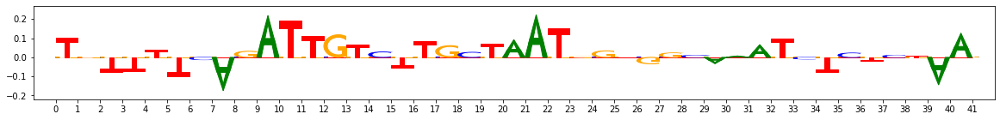

index 14086 example:579,start:493,end:534,rc:False
Features: [0.18574286 0.16520421 0.15029887 0.16894025 0.13329876 0.17382481
 0.18845085 0.16637225 0.18761703 0.1686168  0.31401801 0.37865847
 0.37244841 0.2301676  0.4017886  0.32454411 0.37765233 0.23024404
 0.24664254 0.44944997 0.05697978 0.06045718 0.14436515 0.06300769
 0.0819293  0.04340376 0.07373026 0.06750603 0.06286618 0.07471441
 0.0361321  0.07377347 0.07886009 0.03606285 0.07938091 0.08355675
 0.08466039 0.05682383 0.05541417 0.06804284 0.09433665 0.16278671
 0.09219785 0.11319891 0.09797692 0.09910758 0.11011526 0.10640166
 0.13701112 0.11373163 0.06682057 0.10381721 0.04921018 0.02379412
 0.06783182 0.09182926 0.03191911 0.06993036 0.09914472 0.0377857
 0.09522101 0.03953143 0.11462137 0.09083308 0.04448342 0.05144011
 0.04631589 0.0383393  0.03976405 0.04225098 0.0593975  0.09377389
 0.06758694 0.12098239 0.06783708 0.11304415 0.07072837 0.06325323
 0.07111165 0.04768943 0.03455358 0.07242358 0.04663398 0.07804259
 0

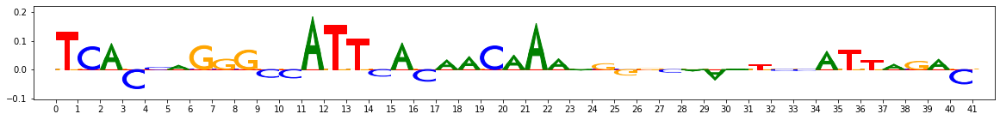

index 30201 example:1034,start:349,end:390,rc:False
Features: [0.12884312 0.1477727  0.12425571 0.1253585  0.10502929 0.14580984
 0.16622911 0.13556136 0.15761559 0.12042001 0.34344635 0.26019292
 0.29884763 0.30397089 0.28236513 0.29601912 0.26344094 0.21860709
 0.34527896 0.254965   0.05479752 0.08032965 0.06336729 0.04608853
 0.06059313 0.03438325 0.08189497 0.04919235 0.04124149 0.09162002
 0.06116554 0.06135865 0.05888069 0.06385769 0.05173351 0.07844795
 0.05537324 0.06775504 0.06092381 0.04661981 0.05902001 0.08314672
 0.19240758 0.13387271 0.06304966 0.17527132 0.07343905 0.08686968
 0.13637801 0.06852731 0.05612694 0.06841346 0.0492157  0.04821343
 0.05676967 0.06426225 0.06801138 0.05223122 0.06105645 0.08146874
 0.04448261 0.04798439 0.05620575 0.07808407 0.05419357 0.05505049
 0.03847102 0.0682481  0.04063085 0.04916892 0.15136605 0.15289522
 0.13186688 0.0770006  0.18154959 0.18675771 0.17204155 0.16920647
 0.13185071 0.16408958 0.15877779 0.15251331 0.18147784 0.18413352


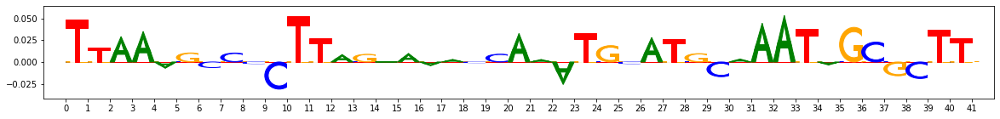

index 73783 example:889,start:470,end:511,rc:False
Features: [0.07892223 0.09018002 0.07623032 0.08504329 0.07395466 0.08711271
 0.08627254 0.06532911 0.10115509 0.06237059 0.50188188 0.59660068
 0.54246162 0.38472388 0.57662177 0.54927577 0.49627135 0.25796858
 0.42008093 0.60077598 0.07218854 0.07092445 0.07885059 0.07748949
 0.09438502 0.05809489 0.08628363 0.06291835 0.06056214 0.08620368
 0.02591891 0.02659511 0.04034502 0.02168203 0.03147056 0.03005443
 0.03337777 0.04161224 0.0332508  0.02350237 0.05213916 0.05210562
 0.06039251 0.05347473 0.07844851 0.04193271 0.0939243  0.0624448
 0.06941526 0.05795999 0.14603056 0.15359262 0.13054183 0.10496429
 0.18418816 0.11843731 0.16266499 0.14683882 0.1629897  0.11651703
 0.07056634 0.04140897 0.09783531 0.03872497 0.02706583 0.02536287
 0.06349633 0.03353906 0.04793638 0.03472448 0.11404135 0.12763675
 0.13513676 0.11529436 0.14456524 0.15184482 0.1336205  0.16775488
 0.16413932 0.11396757 0.09790468 0.17039016 0.13539004 0.10581794
 0

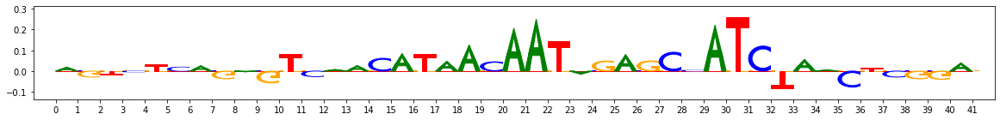

index 101154 example:221,start:468,end:509,rc:False
Features: [ 0.12812796  0.1307142   0.11737031  0.11458973  0.11430402  0.1214448
  0.16283028  0.11810955  0.14576461  0.10433858  0.5232974   0.6874843
  0.57095667  0.4198153   0.6350508   0.50681357  0.53327806  0.24869681
  0.45048807  0.78483624  0.05439111  0.0590583   0.05155317  0.06349306
  0.06331714  0.0508985   0.06020774  0.05911648  0.0589135   0.07351086
  0.04217613  0.04520192  0.06103941  0.03681535  0.06532731  0.05811265
  0.07579198  0.0622572   0.06251383  0.04439762  0.09508269  0.10025355
  0.1556945   0.10923987  0.07357825  0.21305851  0.08888246  0.11866598
  0.11305928  0.09142073  0.03000006  0.05564336  0.01787075 -0.01721027
  0.08781589  0.03339841 -0.01013856  0.05050896  0.10965667 -0.00595756
  0.07759917  0.06284848  0.11304247  0.03161287  0.07839942  0.03745876
  0.06992769  0.07535708  0.05472957  0.06239377  0.05487004  0.08833079
  0.10069559  0.05678462  0.06444555  0.08823102  0.0920865   0.

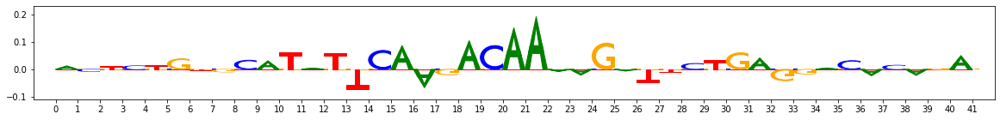

index 104629 example:162,start:340,end:381,rc:False
Features: [ 2.52241965e-01  2.62676836e-01  2.32992597e-01  2.26228569e-01
  2.21758209e-01  2.52589056e-01  2.61651949e-01  2.46271399e-01
  2.71576566e-01  2.12022558e-01  4.21542464e-01  2.87768607e-01
  3.60792256e-01  4.71176761e-01  3.63844866e-01  3.22184524e-01
  3.40905186e-01  3.07742059e-01  5.68707030e-01  2.29541776e-01
  3.86516826e-02  3.07545064e-02  4.94005157e-02  3.16527927e-02
  7.47486958e-02  3.08069848e-02  5.16940222e-02  3.31923421e-02
  4.13941463e-02  6.03622351e-02  2.22894432e-02  1.73078554e-02
  1.25627347e-02  2.11384372e-02  1.93180198e-02  4.07873230e-02
  2.20943476e-02  1.87938282e-02  1.96600280e-02  2.08897363e-02
  9.07529168e-03  2.43162320e-02  1.69056397e-02  9.68940014e-03
 -2.51930911e-05  2.07590100e-02  1.97256882e-02  4.62643906e-02
  3.93279353e-02  6.69341746e-03  7.87531783e-02  1.12024460e-01
  4.63798977e-02  5.29122838e-02  9.75127905e-02  8.05185667e-02
  5.79228428e-02  1.20134138

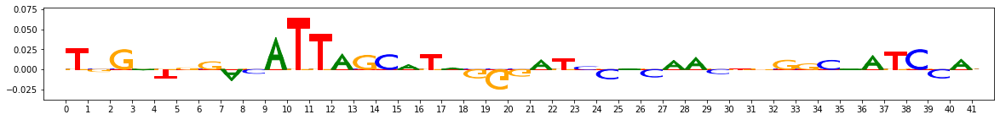

Sample false negative seqlets:
index 4616 example:1076,start:499,end:540,rc:False
Features: [0.15964141 0.1680676  0.15316632 0.15688316 0.13962641 0.16286433
 0.19085705 0.13881369 0.19038532 0.1509988  0.43972577 0.35121518
 0.38229104 0.36843535 0.36749712 0.34312825 0.36640376 0.20570626
 0.42117737 0.3215184  0.01768837 0.03431512 0.03679878 0.01054348
 0.0726134  0.01522835 0.04643954 0.01168324 0.03950206 0.02649728
 0.03036657 0.04646557 0.06087287 0.0308758  0.04034688 0.07529278
 0.05924439 0.05301181 0.04339002 0.0361025  0.04354746 0.05364525
 0.0410465  0.04156597 0.03647289 0.05307577 0.04242514 0.10523121
 0.05850771 0.05256811 0.03640423 0.06166995 0.0397192  0.02120485
 0.03491474 0.10999079 0.02964467 0.05501502 0.04242802 0.04175511
 0.13573938 0.15091268 0.14017823 0.11930999 0.14683403 0.12670347
 0.14143304 0.15536244 0.16282951 0.11345874 0.07761813 0.09545233
 0.06084912 0.06711768 0.12787295 0.10437056 0.08383964 0.09428849
 0.10800855 0.02283216 0.01763652 0.0

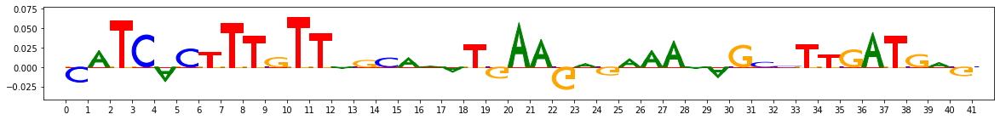

index 22862 example:102,start:374,end:415,rc:False
Features: [1.41115003e-01 1.42649604e-01 1.22165833e-01 1.34252596e-01
 1.15077369e-01 1.43699790e-01 1.67686816e-01 1.21771117e-01
 1.66019192e-01 1.26187948e-01 5.89391733e-01 6.97754733e-01
 6.27944679e-01 4.93475751e-01 7.02017648e-01 6.29097075e-01
 5.97128856e-01 3.17088213e-01 5.08175092e-01 7.40221884e-01
 6.38771094e-02 6.21254041e-02 6.50885172e-02 7.78589047e-02
 6.89952879e-02 5.03442111e-02 6.53647446e-02 5.17533366e-02
 5.22545950e-02 7.09936558e-02 5.23854172e-02 5.97129306e-02
 8.20774168e-02 3.85944171e-02 6.04914103e-02 6.98205151e-02
 7.69741699e-02 5.98834233e-02 6.45221578e-02 5.28219856e-02
 8.92485117e-02 9.14334550e-02 6.89621344e-02 8.44850690e-02
 8.71574656e-02 5.43354258e-02 1.00130111e-01 7.81513513e-02
 9.05314247e-02 9.36592695e-02 1.00247032e-01 1.20758590e-01
 9.15215698e-02 5.87335299e-02 1.43887814e-01 9.43641803e-02
 8.34365194e-02 1.00925652e-01 1.59567551e-01 5.97259615e-02
 5.13335685e-02 1.156111

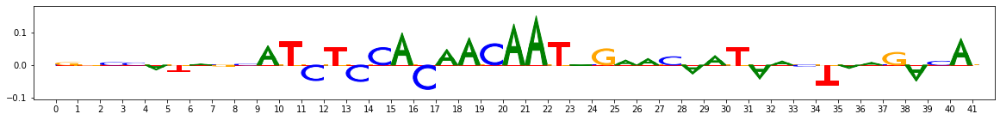

index 26987 example:1028,start:361,end:402,rc:True
Features: [0.17630431 0.18650331 0.17160491 0.1571092  0.14616454 0.17818183
 0.19945286 0.17048564 0.19369148 0.15941455 0.67832992 0.72324774
 0.65084075 0.63663918 0.68474637 0.5338474  0.6377645  0.34442384
 0.65179049 0.63805285 0.05572744 0.06226587 0.05724581 0.07206301
 0.07718846 0.05422338 0.06134305 0.04652401 0.05427303 0.08010662
 0.03385482 0.03616534 0.05824995 0.03304041 0.03817528 0.06144026
 0.0427294  0.05084936 0.04930336 0.03106935 0.06449174 0.03963838
 0.06342922 0.04910345 0.05185982 0.06958285 0.06096006 0.06246828
 0.07189886 0.05649197 0.07659308 0.11982282 0.05239117 0.03379596
 0.12599941 0.05181397 0.04571746 0.15393623 0.08206753 0.06070649
 0.08039858 0.06766176 0.1299391  0.02053874 0.0573389  0.01317891
 0.07974046 0.04386868 0.05637678 0.04631715 0.04658422 0.0943393
 0.07425307 0.04998392 0.06261741 0.07428647 0.06081132 0.0642328
 0.12859071 0.06762207 0.06176134 0.08986829 0.06942134 0.10982087
 0.

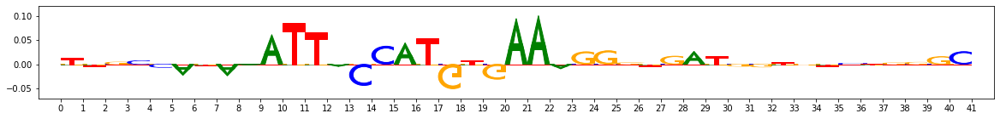

index 31112 example:529,start:164,end:205,rc:False
Features: [ 0.18687609  0.18481453  0.16467528  0.16960462  0.15682056  0.18425756
  0.21108444  0.16881641  0.20637734  0.15244726  0.63023235  0.68082701
  0.64645322  0.55362443  0.6001441   0.54222348  0.6634101   0.30162652
  0.57447485  0.64003168  0.0823965   0.08799603  0.08622836  0.09563852
  0.10998888  0.08752173  0.08006327  0.0778812   0.08295735  0.10066156
  0.0369028   0.03391296  0.05352574  0.03280579  0.03879033  0.04863813
  0.05181688  0.03386235  0.05170119  0.03954409  0.09389283  0.0840514
  0.08497816  0.07800299  0.08316388  0.08797794  0.09474208  0.08550584
  0.07672762  0.07444761  0.03492932  0.08601351  0.00784517 -0.00207485
  0.07561719  0.04455163 -0.01586125  0.09612428  0.00968308  0.0007403
  0.02856204 -0.01744688  0.07886242  0.00985062 -0.03256074 -0.03684049
  0.00589676 -0.01916904 -0.01802765  0.00993677  0.04754096  0.08762413
  0.10076353  0.05766139  0.05181102  0.06862811  0.07860354  0.0

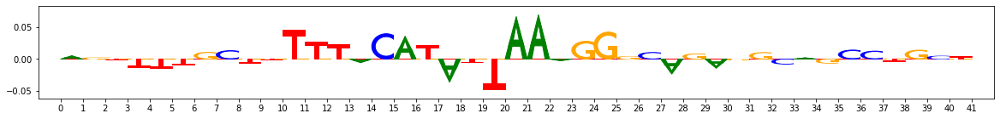

index 35237 example:1033,start:85,end:126,rc:False
Features: [0.21669166 0.22588642 0.20823048 0.1851237  0.18792575 0.23357036
 0.26841896 0.20139364 0.24396316 0.19084594 0.58925905 0.63623703
 0.62086932 0.48329043 0.59117751 0.52376783 0.59342248 0.34016615
 0.55062005 0.65996074 0.04153836 0.06884229 0.03456199 0.04823091
 0.04774173 0.03303559 0.0743407  0.02268663 0.04245931 0.04249189
 0.0422899  0.05043505 0.07079805 0.04212721 0.07078504 0.06889352
 0.07978291 0.05523173 0.06250276 0.05667802 0.08786505 0.07773558
 0.06528845 0.08563262 0.07337989 0.07477038 0.08090655 0.10518708
 0.08849018 0.08137037 0.08204394 0.11242951 0.07111018 0.04613017
 0.09971255 0.09871995 0.05373443 0.10016205 0.08801817 0.05856172
 0.03905106 0.01335172 0.07349559 0.0189143  0.00130975 0.01664279
 0.00081918 0.0016829  0.00327807 0.02239107 0.11623704 0.14659408
 0.12536054 0.08332781 0.13759655 0.14401802 0.12754215 0.16991973
 0.13943438 0.07843354 0.04156609 0.12810336 0.08837329 0.09917088
 

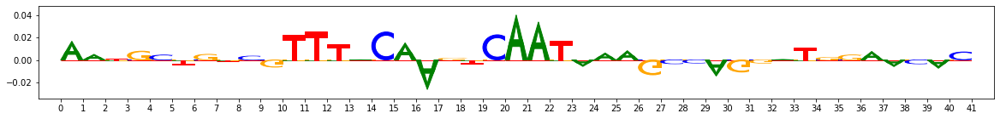

index 101929 example:154,start:560,end:601,rc:False
Features: [0.16070315 0.15398791 0.1327459  0.15055434 0.13077644 0.14985018
 0.18336989 0.13967336 0.1738233  0.15202415 0.61436368 0.63677338
 0.66554314 0.6065832  0.69859774 0.56113617 0.65562155 0.36578099
 0.54593855 0.61429055 0.0606174  0.09992365 0.07053004 0.06996453
 0.09002081 0.06851873 0.15248666 0.06780901 0.06527488 0.08067605
 0.026937   0.05417824 0.08402366 0.01898374 0.06188046 0.07970944
 0.07412799 0.05238883 0.05117087 0.04933914 0.08922249 0.09646012
 0.090931   0.11026073 0.0825156  0.10919786 0.10332595 0.10411709
 0.12326009 0.09415342 0.08541698 0.12629159 0.04795083 0.01567673
 0.16819074 0.08612321 0.02095513 0.14908251 0.12576704 0.02844274
 0.1018869  0.03356899 0.16500175 0.08898416 0.04830589 0.08979311
 0.08786604 0.01211264 0.06510517 0.03980568 0.05605594 0.11563953
 0.07987595 0.03127276 0.0733938  0.10961821 0.07551166 0.06520104
 0.14708823 0.03090473 0.02054396 0.06693515 0.04652243 0.09523489


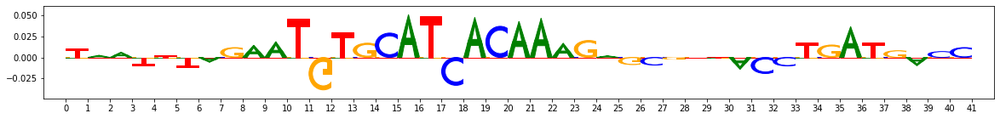

-------------------------------------------------------
PATTERNIDX 2 numseqlets 392


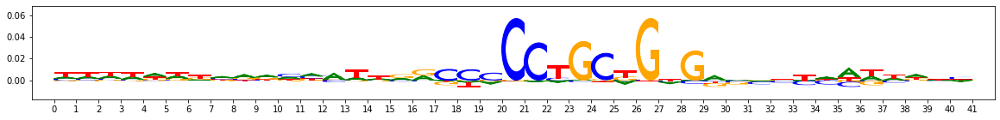

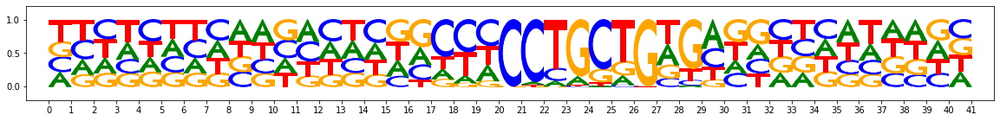

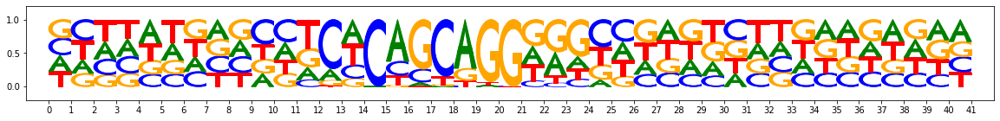

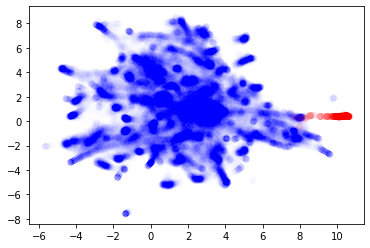

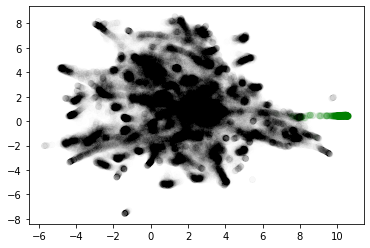

Chosen threshold: 0.989223771502813 Precision: 0.9007263922518159 Recall: 0.9441624365482234


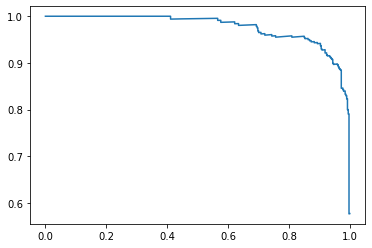

AuPRC: 0.9763135373267203
Reconstructed motif using threshold - numseqlets 411


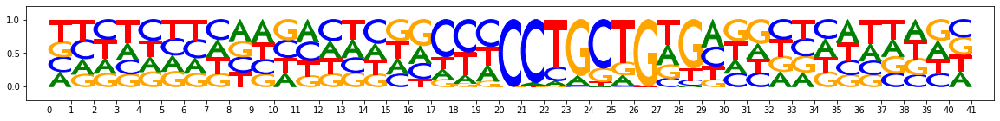

Reconstructed motif using argmax - numseqlets 652


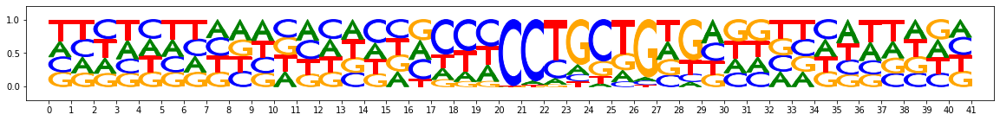

Sample false positive seqlets:
index 1129 example:734,start:511,end:552,rc:True
Features: [ 8.37468170e-02  1.07168152e-01  9.18934010e-02  8.33198834e-02
  7.13309151e-02  9.85043868e-02  9.69584381e-02  8.97775993e-02
  1.16596489e-01  8.47651609e-02  1.92438199e-02  1.26514734e-02
 -1.31468303e-03  1.43031614e-02  9.05259459e-03  2.30623938e-02
 -7.60133390e-03  5.36548897e-02  1.57550270e-02  7.94599465e-03
  2.25359240e-01  2.93421747e-01  2.46960319e-01  2.38111469e-01
  3.34116852e-01  2.39334675e-01  3.00532756e-01  2.71462357e-01
  2.80048087e-01  2.71875450e-01  9.27516025e-02  8.50746589e-02
  6.95193710e-02  1.28058003e-01  1.38331252e-01  9.28443875e-02
  8.53770988e-02  1.33261773e-01  9.42945555e-02  1.10690287e-01
 -1.77168813e-02 -3.20753274e-02 -1.73766011e-02 -3.92471907e-02
 -6.40561677e-03 -6.18355563e-03 -2.05399806e-02 -2.13375569e-02
 -7.82782388e-03 -3.35178388e-02  2.40344907e-03 -3.16632560e-03
 -1.00194481e-04  4.93698484e-03 -1.54466955e-02  4.73980442e-02


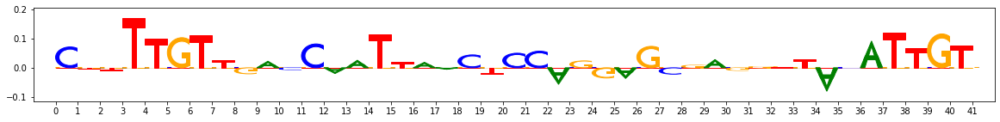

index 46935 example:1025,start:375,end:416,rc:False
Features: [ 0.02038966  0.02701886  0.01687182  0.01727475  0.01268754  0.0262761
  0.0197831   0.01952306  0.02283342  0.0298046   0.04530264  0.03112479
  0.05227611  0.04508942  0.05596823  0.05649617  0.05394219  0.05062487
  0.04494094  0.03207013  0.23896008  0.30204577  0.37269383  0.24706237
  0.28253507  0.26776478  0.27435918  0.28969155  0.26949508  0.3072847
  0.11056114  0.1164539   0.08005158  0.12786828  0.13799479  0.1015986
  0.08590799  0.12176907  0.08934401  0.11338096  0.09491664  0.08265792
  0.07502857  0.056245    0.06813434  0.11074521  0.06525538  0.06582029
  0.09115817  0.05511346  0.06795452  0.06634765  0.05123315  0.06498947
  0.07729708  0.07033483  0.04370559  0.06184246  0.07763361  0.04537427
  0.15698507  0.18760381  0.12339056  0.11515623  0.18589625  0.15122518
  0.2075155   0.20223939  0.16691783  0.2054753   0.03773268  0.02800576
  0.03553727  0.0598842   0.03797054  0.01966176  0.04425245  0.0

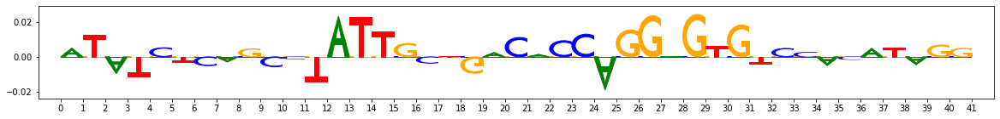

index 51890 example:231,start:388,end:429,rc:False
Features: [-9.44594238e-04  4.21493404e-03  1.15463297e-02  3.62049663e-03
  1.12438226e-02  5.99325872e-03  2.34302358e-02 -3.74004863e-04
  1.52866844e-02  3.53501869e-02  4.97616142e-02  4.00023583e-02
  3.29894780e-02  3.55746826e-02  3.49527037e-02  4.72120422e-02
  3.35102665e-02  5.62681961e-02  2.93741388e-02  3.24928645e-02
  3.81923286e-01  4.25919409e-01  3.18478854e-01  3.67388515e-01
  3.02659909e-01  4.30915342e-01  3.11138854e-01  4.50716255e-01
  4.31849473e-01  3.74074806e-01  1.57423060e-01  1.39348553e-01
  1.67647525e-01  1.71598728e-01  2.48127148e-01  1.56030958e-01
  1.73961039e-01  2.15264142e-01  1.78222357e-01  1.98018882e-01
  5.44679827e-02  5.18512425e-02  6.04224035e-02  6.76571486e-02
  3.04877043e-02  8.12102725e-02  4.21270523e-02  5.34632512e-02
  5.76827473e-02  3.66462412e-02  1.75385152e-02  1.92485491e-02
  8.75766068e-03  9.65327286e-03  2.30424124e-02  1.57661263e-02
  1.33075306e-02  3.93624349e

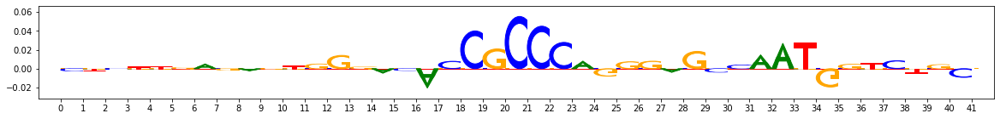

index 54665 example:337,start:764,end:805,rc:False
Features: [-0.03033739 -0.02404939 -0.02302503 -0.01778183 -0.00824423 -0.02635592
 -0.0256387  -0.01011253 -0.01027151  0.00940299  0.01008429  0.01526069
  0.01032474  0.00518101  0.00794513  0.02511683  0.0058246   0.05208562
  0.00268504  0.01309745  0.32849087  0.4171308   0.3274768   0.33952174
  0.34488891  0.35920532  0.34307109  0.43908638  0.38665794  0.42169303
  0.10550499  0.09636521  0.10498328  0.12541424  0.22449766  0.12638629
  0.12442142  0.16564932  0.12259404  0.1541317   0.02250061  0.04944614
  0.03689329  0.03946908  0.01374764  0.03666561  0.02044838  0.0241576
  0.05844404  0.0234729   0.01059397 -0.00483175  0.01486896  0.00246222
  0.01823853  0.00663149  0.02559135  0.01124229  0.03483936  0.00620409
  0.05560406  0.06672233  0.04963086  0.08116054  0.07720037  0.09176734
  0.08412541  0.09614088  0.08823558  0.09120692  0.0524417   0.04177666
  0.04568056  0.07591775  0.07055262  0.05267498  0.05248613  0.

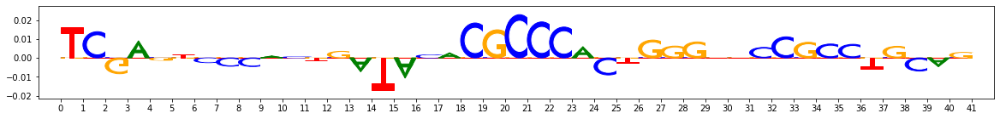

index 72702 example:938,start:539,end:580,rc:False
Features: [0.10958424 0.13062397 0.10607328 0.11581038 0.11038974 0.11703816
 0.1339144  0.0990087  0.13319491 0.10966095 0.15814497 0.1219572
 0.09645317 0.15420247 0.14470697 0.12884808 0.07146033 0.14442425
 0.19643608 0.10841996 0.26755194 0.34393963 0.30720247 0.3041806
 0.35838188 0.28040445 0.37341849 0.29383993 0.2674471  0.33342664
 0.03810878 0.07017588 0.04342478 0.06376137 0.08907389 0.06443295
 0.03951672 0.06112158 0.03763574 0.05275956 0.0618793  0.06711872
 0.06024605 0.06941677 0.08822651 0.07395667 0.06026822 0.09405148
 0.08107846 0.06239337 0.06182495 0.05067596 0.04886666 0.04975552
 0.02828018 0.06597045 0.05525862 0.0369574  0.04265491 0.08102488
 0.08405208 0.04163075 0.05482414 0.12724519 0.0383674  0.0977768
 0.06095011 0.06889642 0.04986318 0.07052987 0.07134456 0.08765285
 0.06730174 0.0610516  0.10556113 0.12260827 0.08616796 0.11663275
 0.09367235 0.04831902 0.02933927 0.08462196 0.07906218 0.13669212
 0.0

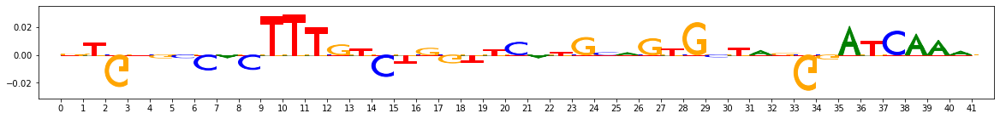

index 102438 example:85,start:359,end:400,rc:False
Features: [0.00817336 0.0090623  0.00749996 0.01233753 0.00491309 0.00838913
 0.00438511 0.00800125 0.01085489 0.02374293 0.06375747 0.03807031
 0.03558493 0.07300734 0.06357601 0.04156809 0.03453703 0.09987611
 0.08390518 0.04604063 0.25825174 0.27265229 0.30281721 0.28986574
 0.32852181 0.29728011 0.23375277 0.27584746 0.29408373 0.31155011
 0.091261   0.08779758 0.07404942 0.08709572 0.07526346 0.09343769
 0.08248026 0.07625242 0.06344947 0.09401561 0.0305621  0.08308066
 0.05427235 0.03540414 0.08055637 0.04045498 0.05803564 0.06098005
 0.06769819 0.04670615 0.01992429 0.02068708 0.01794104 0.01466342
 0.01320026 0.03810557 0.02441399 0.00972407 0.02346369 0.01252177
 0.06608058 0.05173682 0.04565226 0.07548047 0.03169741 0.07798313
 0.09102835 0.07285597 0.05926476 0.10725576 0.05836003 0.05200155
 0.07916446 0.0840838  0.06032004 0.09783342 0.10033442 0.06246395
 0.07391382 0.06244132 0.06818047 0.09663782 0.05509726 0.04006833
 

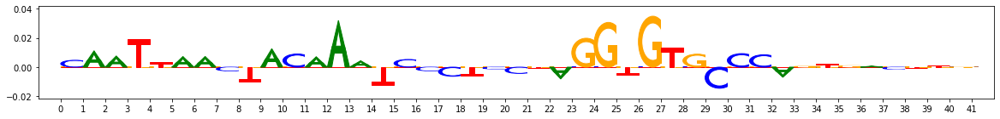

Sample false negative seqlets:
index 28375 example:762,start:513,end:554,rc:True
Features: [0.02712548 0.03821054 0.03018801 0.04530833 0.03811419 0.03129099
 0.04649788 0.02512993 0.04445224 0.04575705 0.09986876 0.0782866
 0.05907112 0.09455016 0.12128958 0.05780473 0.06168389 0.1112499
 0.10490832 0.09635569 0.36258554 0.49556444 0.38864479 0.38984794
 0.53174628 0.40090236 0.45144332 0.41771439 0.43277913 0.49160518
 0.11539246 0.13271318 0.12664337 0.14193908 0.21197516 0.16104945
 0.13555893 0.1858943  0.12952464 0.17363062 0.05686636 0.06835008
 0.06642874 0.04791772 0.07548664 0.06839044 0.07981531 0.04446135
 0.05680228 0.05779714 0.04865599 0.03689296 0.0415371  0.03600045
 0.0320751  0.08498167 0.04731268 0.0419292  0.02897027 0.04772877
 0.10373335 0.08816062 0.07990796 0.14451582 0.05115671 0.12718817
 0.12375664 0.09977745 0.10976394 0.12449782 0.09604978 0.08501505
 0.10406016 0.11344719 0.12211809 0.10771696 0.13335042 0.13098682
 0.1127983  0.09659672 0.08643743 0.1300

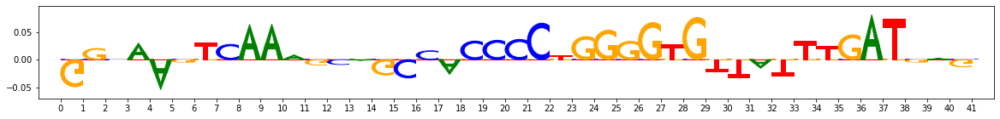

index 41212 example:453,start:525,end:566,rc:True
Features: [ 0.1250113   0.12972584  0.12767324  0.11115748  0.09593998  0.11935068
  0.11889546  0.11633389  0.17049016  0.13872527  0.06507035  0.06328237
  0.05863483  0.07767068  0.07943054  0.06364096  0.04669773  0.09869094
  0.09428151  0.06527567  0.48946831  0.60285129  0.57265914  0.53751096
  0.58141393  0.51719458  0.57250735  0.56803935  0.54464426  0.59926864
  0.16284561  0.18162939  0.15108264  0.1898188   0.22417416  0.21151382
  0.15023177  0.21128126  0.14682842  0.20307626  0.00483782  0.05164128
  0.00414129 -0.00264063  0.03693229  0.01068958  0.02518179  0.026777
  0.03221214  0.02433582 -0.00982522 -0.01277553 -0.0253458  -0.01235962
 -0.01974247 -0.01085044 -0.03079659  0.00247672  0.00442453 -0.00926318
  0.13966016  0.09313897  0.11502367  0.11092322  0.06520341  0.13607837
  0.14696154  0.10443101  0.11844856  0.13478225 -0.00549025  0.02256613
 -0.00800017  0.0204385   0.02429787  0.02476065  0.01794409  0.02

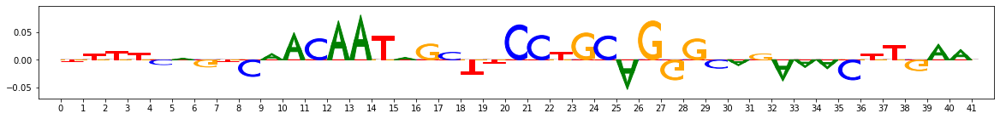

index 43162 example:430,start:396,end:437,rc:False
Features: [ 0.02105347  0.03034584  0.02628998  0.03047665  0.02767158  0.02791151
  0.03667856  0.0296086   0.04007057  0.03661566  0.03315392  0.05464653
  0.03413065  0.01729383  0.04498242  0.03251394  0.02985512  0.08975882
  0.02998941  0.05664101  0.6463296   0.68337596  0.56397632  0.77432168
  0.56702436  0.70550051  0.53186383  0.62334579  0.62990556  0.66660539
  0.13548431  0.14352182  0.13149578  0.15329383  0.22593856  0.16273533
  0.14924202  0.19396722  0.13542731  0.18818609  0.04355585  0.05049846
  0.02758805  0.03828262  0.05518029  0.03669888  0.05169141  0.03103607
  0.04811986  0.0431719  -0.00445396 -0.00862399 -0.00228114 -0.00884748
 -0.02173217  0.016627   -0.0010729  -0.01159432  0.00653547  0.01202538
  0.14044225  0.10584643  0.09342451  0.09317895  0.06004464  0.14689999
  0.14629876  0.10717365  0.11601185  0.14873268  0.02602733  0.04412932
  0.01316449  0.04420633  0.02975935  0.04115697  0.05375391  0

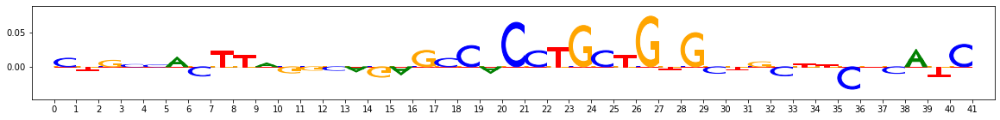

index 45137 example:271,start:391,end:432,rc:True
Features: [0.01042101 0.01316426 0.0143188  0.01415414 0.00978318 0.01702506
 0.01946523 0.00959281 0.02822141 0.03269189 0.07235283 0.0696721
 0.06293688 0.0693613  0.08154814 0.06993607 0.07108981 0.0686029
 0.07510076 0.08026911 0.52132002 0.68473867 0.67118491 0.54850559
 0.59312648 0.58579961 0.61676226 0.62219213 0.63866197 0.62044092
 0.12128305 0.14814155 0.13811835 0.16897554 0.23038493 0.17393958
 0.13902027 0.21090625 0.13939642 0.18727328 0.05866348 0.0814562
 0.03244426 0.05520059 0.06594913 0.05747017 0.05236171 0.07389035
 0.05582299 0.05063061 0.03783704 0.0537951  0.03043245 0.02992343
 0.0278184  0.07406103 0.03197823 0.0543887  0.04318998 0.0408591
 0.14714135 0.07925659 0.10762378 0.1422003  0.0546009  0.15530194
 0.14021824 0.08373767 0.10048861 0.14907214 0.03737388 0.02356838
 0.02073934 0.0623635  0.05193883 0.03456401 0.05126351 0.0780195
 0.05182482 0.03428783 0.02900793 0.07332312 0.04280619 0.0660514
 0.03642

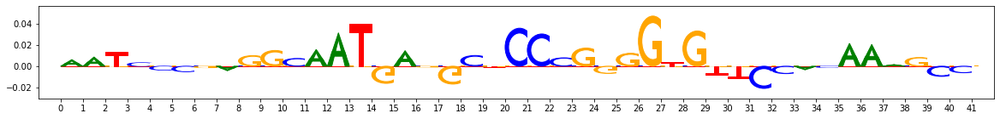

index 47087 example:976,start:358,end:399,rc:False
Features: [ 0.01559776  0.02087502  0.01978378  0.03077627  0.02414835  0.02258647
  0.00924388  0.02688357  0.04623481  0.03862619  0.04338451  0.07734105
  0.0444476   0.04018914  0.07586619  0.06156335  0.0468925   0.08578309
  0.04811396  0.085391    0.51817138  0.60179463  0.53990392  0.57341925
  0.60691613  0.54317511  0.51593214  0.55346406  0.57619992  0.65543746
  0.11602832  0.12023883  0.111189    0.13250366  0.19283012  0.12794531
  0.12415936  0.16026292  0.1200425   0.15393572  0.09717323  0.07384341
  0.05943192  0.06921681  0.08421391  0.07637567  0.10539289  0.069481
  0.06451621  0.05658156  0.02590997  0.01509932  0.02090813  0.01977241
  0.01171756  0.02398034  0.03265165  0.03106679  0.02418387  0.03222408
  0.10358723  0.07981252  0.07140247  0.08060397  0.05822825  0.09399878
  0.11882323  0.0960709   0.08029749  0.13584204  0.0423575   0.04507252
  0.05323917  0.05194123  0.04771458  0.0521957   0.0615051   0.0

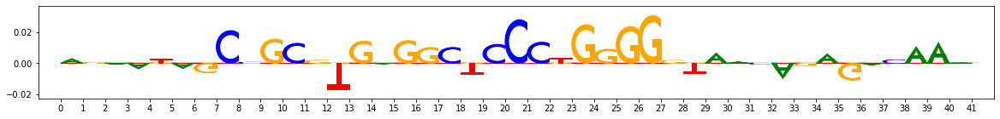

index 49037 example:561,start:420,end:461,rc:False
Features: [ 4.21783373e-02  4.95064321e-02  4.21242890e-02  3.89097688e-02
  3.73666414e-02  4.69659853e-02  5.08989167e-02  4.35632022e-02
  7.31358166e-02  6.09947554e-02  5.55821118e-03  1.79841829e-02
  4.93917680e-03  3.85530303e-03  1.39781243e-02  1.98333621e-02
  3.63050440e-03  3.93425821e-02  4.37712639e-03  2.46839026e-02
  3.66631587e-01  4.14790229e-01  4.00022340e-01  4.17961297e-01
  4.97056008e-01  4.29143217e-01  4.10424140e-01  4.50852309e-01
  4.67319400e-01  4.50744722e-01  1.67320508e-01  1.71024507e-01
  1.67965424e-01  1.76264251e-01  2.12570429e-01  2.03980726e-01
  1.58213783e-01  2.22597331e-01  1.49603612e-01  2.06275607e-01
  2.55004407e-03  5.11562086e-02  1.06014472e-02  2.11869586e-04
  3.02552585e-02  2.71530615e-02  5.02902208e-03  3.04683221e-02
  3.15357611e-02  2.82836158e-02 -1.71093479e-02 -8.11997694e-03
  5.18180708e-03 -2.23710622e-02 -2.07806427e-02  7.13984957e-02
 -1.65138725e-02 -1.49109402e

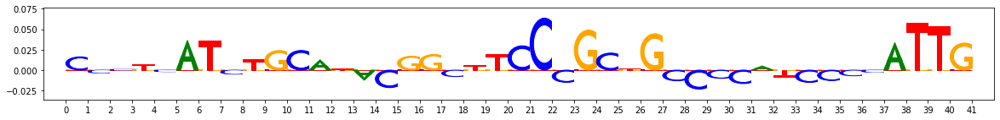

-------------------------------------------------------
PATTERNIDX 3 numseqlets 342


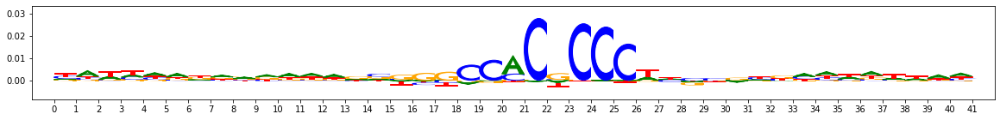

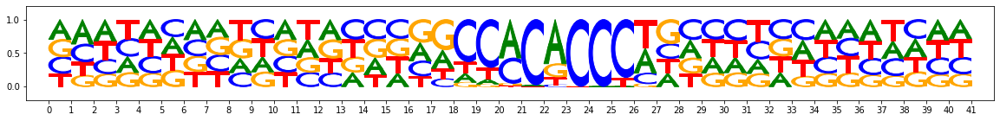

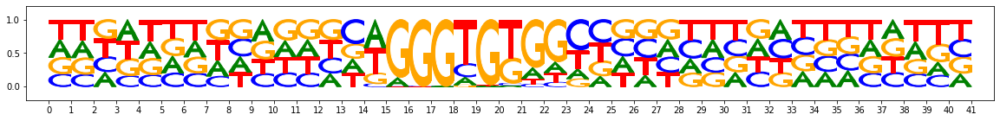

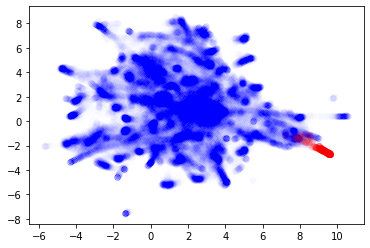

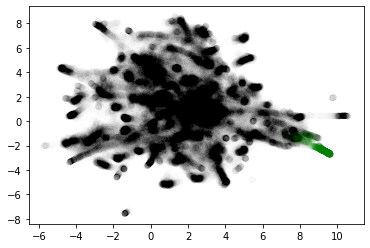

Chosen threshold: 0.9917338690841062 Precision: 0.9 Recall: 0.8895348837209303


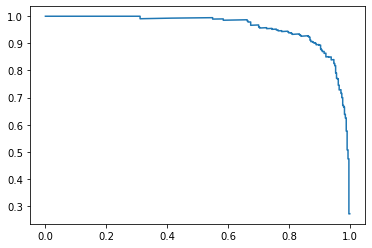

AuPRC: 0.9591327421095538
Reconstructed motif using threshold - numseqlets 339


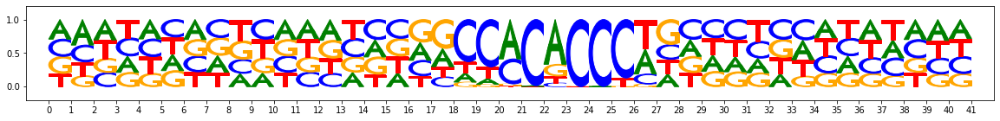

Reconstructed motif using argmax - numseqlets 954


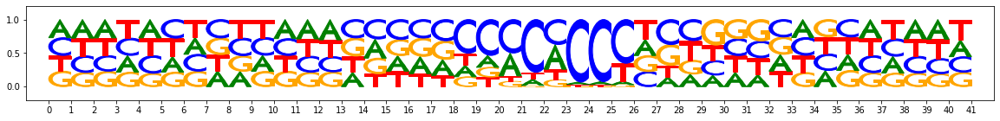

Sample false positive seqlets:
index 5994 example:942,start:525,end:566,rc:False
Features: [0.0780811  0.06682933 0.06351431 0.08369823 0.07132429 0.06927949
 0.08629471 0.05710841 0.08098855 0.08531852 0.05644266 0.05042971
 0.06292294 0.04591083 0.06167242 0.0624451  0.05591024 0.07807394
 0.05369252 0.06569488 0.10399513 0.14669565 0.13544241 0.10901023
 0.11215703 0.10652051 0.16235128 0.17223079 0.13377002 0.1647321
 0.2764233  0.35449291 0.3000223  0.29377648 0.34760526 0.38516949
 0.26325842 0.36487411 0.26368045 0.38117709 0.02933512 0.11404301
 0.04396297 0.03828227 0.04602427 0.03575792 0.03319787 0.03320787
 0.078352   0.06554793 0.07519408 0.07966074 0.04956069 0.09384376
 0.06158429 0.05946289 0.11843436 0.04211542 0.06908318 0.08290334
 0.07861753 0.05529077 0.06232322 0.08981089 0.09125604 0.08167165
 0.06211278 0.0752212  0.06949748 0.04099639 0.0318164  0.03696246
 0.03114692 0.08296787 0.09666956 0.04291533 0.01872719 0.03700981
 0.02768174 0.02899757 0.01794062 0.052

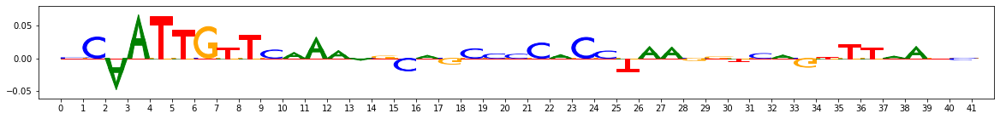

index 42916 example:951,start:515,end:556,rc:True
Features: [0.0208701  0.02434265 0.02605779 0.02584568 0.01825351 0.0338466
 0.0215013  0.02530143 0.03179483 0.03637139 0.0223688  0.02350682
 0.0261456  0.02310297 0.02108934 0.04206811 0.01991057 0.05345582
 0.02122964 0.02719857 0.13636376 0.14822918 0.12990292 0.1295618
 0.10692569 0.13738372 0.15030601 0.15017493 0.14271456 0.14847393
 0.44714794 0.4674711  0.43742445 0.51747397 0.40121966 0.39798058
 0.35315967 0.45963831 0.4470818  0.42343109 0.03531235 0.04503423
 0.0354447  0.02861591 0.03852313 0.07367356 0.02116205 0.04257914
 0.04164448 0.05086526 0.08998188 0.0902777  0.07726538 0.07493374
 0.08076579 0.09285291 0.07778211 0.06688012 0.10321739 0.10213073
 0.06123259 0.0640117  0.06224843 0.09730074 0.07629855 0.06058979
 0.0667157  0.0853057  0.07643334 0.06369527 0.08541009 0.05644357
 0.07652473 0.06953739 0.07347671 0.07964605 0.04857698 0.09023416
 0.05618136 0.04809239 0.04561175 0.05684355 0.08775693 0.07055263
 0.0

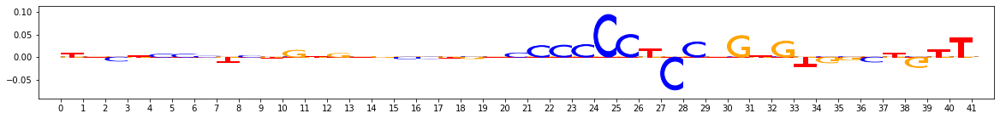

index 46659 example:1068,start:387,end:428,rc:False
Features: [ 0.01784013  0.02621401  0.01600999  0.03827241  0.02604824  0.02026016
  0.02038169  0.01730883  0.03474696  0.02766765  0.11492353  0.06721362
  0.11007962  0.12739824  0.08183907  0.11591719  0.11436565  0.08334831
  0.10914263  0.04855805  0.24072015  0.28747806  0.29250921  0.24840489
  0.23107606  0.2684056   0.26213798  0.30913782  0.29174662  0.30243382
  0.30743486  0.35477976  0.28256228  0.34856098  0.36248831  0.30140425
  0.24068792  0.34448816  0.27236309  0.3297739   0.00215682  0.04111049
  0.0081932   0.01997663  0.00568619  0.01250003 -0.0036207   0.02289141
  0.0122082   0.0127726   0.07091612  0.06630214  0.04641058  0.09364154
  0.08032763  0.06183998  0.05038366  0.0548602   0.04381135  0.05894893
  0.13940132  0.09320723  0.10920069  0.08887911  0.05968398  0.12775193
  0.17014148  0.05846661  0.10735831  0.11580342  0.06343061  0.06045079
  0.07021694  0.0842007   0.06880642  0.05889594  0.06844085  

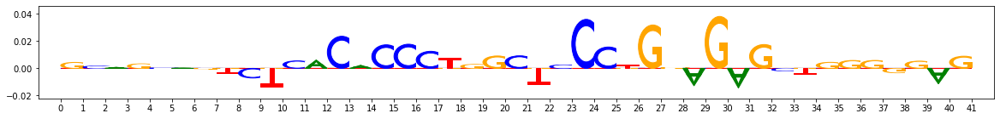

index 50861 example:1033,start:361,end:402,rc:True
Features: [0.02279118 0.03291605 0.03574709 0.02455669 0.02425603 0.02952275
 0.02489301 0.03951039 0.03640246 0.04430191 0.03924402 0.03471806
 0.04370934 0.03855427 0.03487684 0.05112221 0.03941507 0.05628147
 0.04783249 0.02793456 0.25082742 0.26909262 0.28291461 0.22701622
 0.21443461 0.24885458 0.26895236 0.29149063 0.25662031 0.27792541
 0.36978035 0.39732317 0.31986604 0.37369516 0.39343596 0.32497096
 0.30418544 0.37761455 0.33765052 0.37747551 0.01466038 0.03963263
 0.01581891 0.01605377 0.03165171 0.02731504 0.01737432 0.03359029
 0.05277247 0.02707574 0.13267364 0.10786262 0.09794589 0.13904573
 0.1362258  0.09400743 0.11375881 0.09686118 0.1127011  0.12086168
 0.14670577 0.09765599 0.09706388 0.07041642 0.09477276 0.13492075
 0.12371018 0.05119354 0.1121718  0.10934496 0.03535129 0.0301447
 0.03786099 0.02474836 0.0628016  0.0687983  0.04472285 0.0369643
 0.0390403  0.09170872 0.07885358 0.10166979 0.05939474 0.09092194
 0.

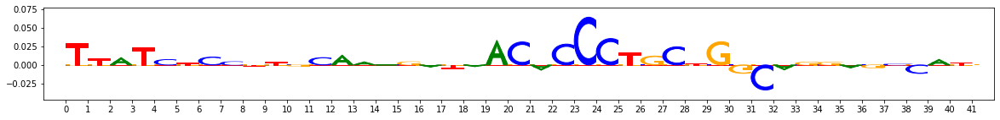

index 55035 example:579,start:374,end:415,rc:True
Features: [ 0.00540103  0.00897053  0.00253755  0.01579695  0.00951844  0.00865806
 -0.00443545  0.00497574  0.01649999  0.01526011  0.0836953   0.06708815
  0.07415783  0.09508798  0.08613845  0.08213261  0.08663468  0.05840123
  0.08478644  0.07049889  0.16741473  0.21603693  0.16011129  0.16066455
  0.12571676  0.17201406  0.16648792  0.2260323   0.20137427  0.18183944
  0.29039063  0.35311236  0.32213123  0.3300424   0.46289875  0.36337574
  0.31942024  0.42836753  0.31369907  0.39196169  0.00050924  0.03502962
  0.06012749  0.05768604  0.02410425  0.05165152  0.03389168  0.01553612
  0.03490001  0.00838642  0.07577564  0.06303662  0.06845162  0.10008869
  0.07316369  0.07073939  0.0713329   0.07553576  0.06454222  0.07223058
  0.035937    0.02949705  0.03331977  0.03646422  0.00246253  0.0343284
  0.04584746 -0.00311618  0.04656544  0.01137517  0.03525236  0.04070914
  0.03431287  0.07822144  0.04134905  0.05423979  0.02757414  0.0

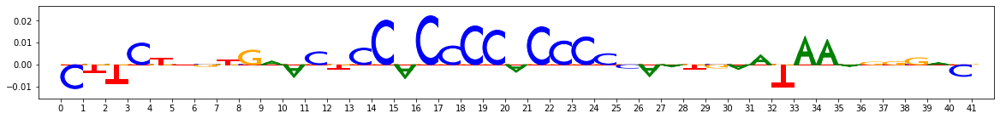

index 93620 example:437,start:568,end:609,rc:False
Features: [0.03434793 0.03726607 0.03814279 0.02273335 0.02839708 0.04365217
 0.03843501 0.03875122 0.04643482 0.05838903 0.04997454 0.0543909
 0.05559589 0.03956547 0.05695302 0.06136801 0.04266543 0.06420476
 0.04769947 0.06013444 0.12483214 0.16791486 0.13192858 0.11435829
 0.08544101 0.13308088 0.17245761 0.14365326 0.13432591 0.13642799
 0.45249044 0.56328208 0.4861363  0.48686224 0.50736438 0.53120124
 0.40184238 0.57058414 0.41254493 0.53740832 0.03127538 0.05188845
 0.04437636 0.05428518 0.0437245  0.06701181 0.0332253  0.07710907
 0.06324295 0.05402764 0.091842   0.07213242 0.0698477  0.10347686
 0.08256427 0.10116016 0.10583025 0.04890368 0.07968458 0.0901984
 0.04217065 0.03187788 0.03022512 0.09172346 0.05044464 0.08574257
 0.03192982 0.04050383 0.04602309 0.03325127 0.0402419  0.03547396
 0.03282042 0.04584192 0.08236014 0.09849724 0.03033933 0.03050443
 0.03508335 0.03824697 0.05874037 0.03368487 0.07305773 0.04224513
 0.

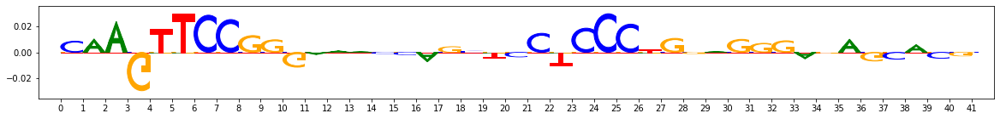

Sample false negative seqlets:
index 29101 example:994,start:552,end:593,rc:True
Features: [ 0.20125678  0.16838218  0.23144117  0.16225507  0.14020994  0.21989509
  0.20180278  0.19221145  0.26226902  0.200117    0.1149743   0.07870201
  0.09102793  0.12056654  0.09462723  0.09241287  0.08618903  0.11970497
  0.15649146  0.08408875  0.12904095  0.19707882  0.16781614  0.13051014
  0.1381541   0.13877794  0.21301637  0.15985027  0.16280735  0.17867023
  0.32360689  0.38265576  0.34782705  0.3463464   0.35649303  0.43689006
  0.27669645  0.40282795  0.29032872  0.39060528  0.01753982  0.05609741
  0.01165204  0.00817153  0.02563275  0.00432357 -0.0051768   0.03880399
  0.04202998  0.04327513  0.21900963  0.20400082  0.1957971   0.21666459
  0.19803041  0.21815204  0.20405907  0.16748169  0.18766717  0.22077741
  0.05994876  0.04795163  0.06055443  0.06487178  0.03191522  0.0956046
  0.0349242   0.05027655  0.04982594  0.03635795  0.08742994  0.07929411
  0.08599623  0.05315536  0.143456

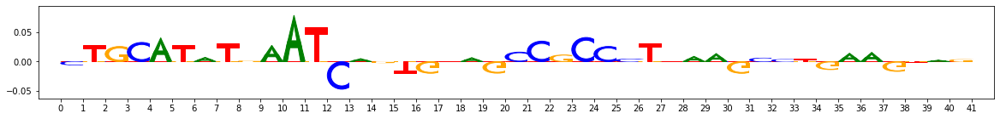

index 50737 example:839,start:409,end:450,rc:False
Features: [ 0.03445386  0.01864586  0.0232152   0.03115286  0.01531717  0.02762439
  0.0199119   0.02684454  0.04463047  0.05218192  0.02639822  0.03336249
  0.02752092  0.02616307  0.03142612  0.05746757  0.01839074  0.02052622
  0.02725016  0.03427719  0.14949367  0.17197972  0.12356457  0.14120988
  0.09910499  0.16140379  0.11715894  0.1818079   0.17565524  0.12817046
  0.52820264  0.61152453  0.53353422  0.50080592  0.51505656  0.55857659
  0.45372905  0.59207197  0.45978729  0.58842896  0.02732734  0.04773266
  0.05189147  0.04255199  0.06603247  0.04772889  0.04635822  0.05605112
  0.07299107  0.05109331  0.07295068  0.05512515  0.0601667   0.10318279
  0.0747464   0.03331509  0.05882121  0.04167764  0.05833145  0.08350207
  0.03784594  0.03312229  0.02029721  0.07082266  0.04249411  0.02933145
  0.02835833  0.02373373  0.0330131   0.03151149  0.0007412   0.00313214
 -0.00710964  0.02851384  0.0240958   0.0064239  -0.02716811  0

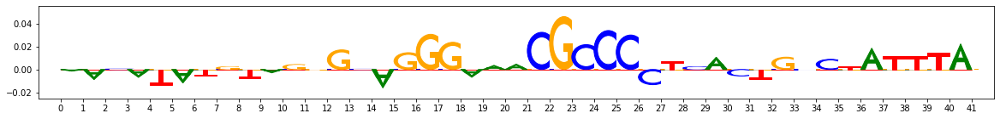

index 52462 example:284,start:389,end:430,rc:True
Features: [ 0.0028745   0.0281194   0.01332712  0.0292877   0.02390007  0.01837997
  0.02286777  0.00818487  0.02857324  0.03174977  0.04958046  0.06887191
  0.05964689  0.04101935  0.07418136  0.14330885  0.04925427  0.04382913
  0.03551898  0.07416444  0.18942481  0.25162589  0.18817231  0.18797211
  0.15267802  0.197295    0.20027003  0.23796328  0.2184858   0.19032641
  0.52517204  0.60601065  0.5294592   0.58702848  0.6105647   0.58963012
  0.45535159  0.6355091   0.49165962  0.60630651 -0.01656942  0.01925744
 -0.0038626  -0.00782347  0.01049117  0.00528254 -0.0155545   0.0920707
  0.0066896   0.00136646  0.1152358   0.08650998  0.09308945  0.13888915
  0.09857098  0.08209022  0.10765081  0.06712156  0.08662495  0.10777586
  0.06317794  0.02780798  0.03943063  0.06121096  0.02962704  0.04303506
  0.0301124   0.01051526  0.04470846  0.03808979  0.07163919  0.06234002
  0.06758648  0.07394409  0.07328896  0.08245165  0.04603162  0.0

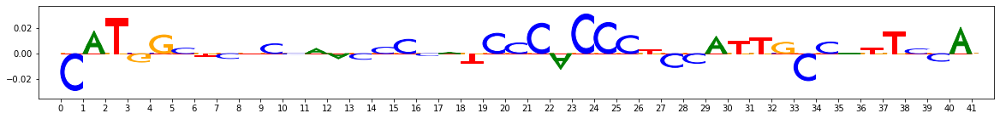

index 54162 example:40,start:714,end:755,rc:True
Features: [0.04412708 0.01958173 0.01609394 0.0335115  0.01810731 0.02269269
 0.03548095 0.01983451 0.03811713 0.05161298 0.05112522 0.07612301
 0.06148949 0.04137078 0.07307591 0.09192804 0.04186533 0.07051765
 0.04186097 0.08018074 0.15029596 0.15821885 0.12400727 0.1462279
 0.12008892 0.16157838 0.12877638 0.17774078 0.19367568 0.13354468
 0.43464565 0.43968292 0.49137899 0.41214842 0.401666   0.4599744
 0.41731531 0.51544736 0.41014149 0.47981509 0.05834574 0.04563897
 0.07522646 0.07701393 0.07166138 0.09290278 0.06650779 0.10600472
 0.1037216  0.07284183 0.0763715  0.06574741 0.05925546 0.08461204
 0.06438454 0.0593898  0.09856185 0.05419698 0.06925019 0.07623804
 0.1019196  0.05851477 0.06147539 0.05826077 0.06053487 0.09377874
 0.0426177  0.05006629 0.06375614 0.0526008  0.04289379 0.04396635
 0.03103018 0.14303882 0.09115091 0.09496168 0.02748033 0.04732647
 0.04205541 0.01046576 0.01173471 0.03335355 0.04213629 0.02858469
 0.00

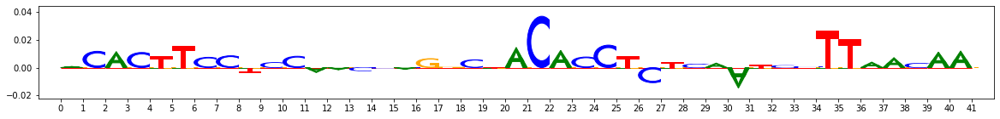

index 55862 example:912,start:610,end:651,rc:False
Features: [0.04555353 0.03968295 0.04616476 0.04813914 0.03771172 0.04966707
 0.06207526 0.03793878 0.06708409 0.05818093 0.07250469 0.08888493
 0.07180728 0.04441641 0.09134193 0.09344469 0.05607908 0.06094487
 0.06604758 0.12100621 0.17655764 0.18833642 0.14910545 0.15903629
 0.09470219 0.19532422 0.15994306 0.1910233  0.20448633 0.16018959
 0.53023522 0.60913285 0.58705138 0.5454178  0.52725207 0.61460445
 0.47809794 0.6423615  0.48750094 0.64437364 0.13025681 0.11866812
 0.11732512 0.14701121 0.04813    0.20576046 0.04753821 0.15026654
 0.09856859 0.13358582 0.09244438 0.06991032 0.08763502 0.10568296
 0.06663482 0.09143481 0.10592628 0.02592641 0.08987065 0.09690442
 0.06663323 0.07845844 0.05197623 0.0984493  0.09439975 0.1033569
 0.05590214 0.15475121 0.05577974 0.09938033 0.0643077  0.07505865
 0.05869633 0.0575897  0.10065249 0.07799372 0.04465539 0.07862765
 0.02615262 0.05609557 0.07916587 0.05653134 0.07946125 0.09089608
 0

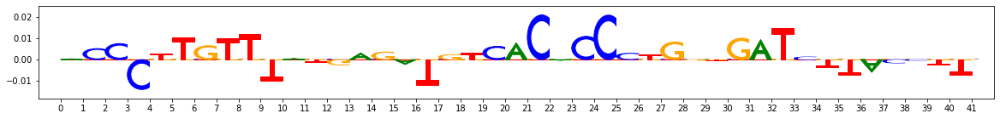

index 57562 example:770,start:712,end:753,rc:False
Features: [ 2.09726391e-02  4.76386058e-03  4.75961407e-03  2.14663784e-02
  1.65635973e-03  1.53913707e-02  4.45885669e-03  6.40272438e-03
  1.76324481e-02  2.98002029e-02  4.18543955e-02  5.55938815e-02
  2.84660855e-02  1.24281582e-02  5.70862977e-02  6.06879403e-02
  8.06099982e-03  4.17897506e-02  4.19229383e-02  8.37274462e-02
  1.36098764e-01  1.37543627e-01  1.09101147e-01  1.16372739e-01
  6.15119152e-02  1.51207665e-01  1.11090070e-01  1.50780290e-01
  1.50127716e-01  1.02597431e-01  6.96158551e-01  6.07022694e-01
  7.27305921e-01  6.22893640e-01  5.00880223e-01  5.15804043e-01
  6.91164656e-01  5.54912159e-01  7.52821787e-01  5.87437665e-01
  6.75567572e-02  6.47528495e-02  7.52454612e-02  6.87504034e-02
  6.62774849e-02  7.59172266e-02  7.70878600e-02  8.23674273e-02
  1.04837693e-01  7.71260470e-02  1.03148694e-01  7.51696820e-02
  7.60325762e-02  1.18836476e-01  6.61653679e-02  7.99128684e-02
  8.76735840e-02  2.21351910e

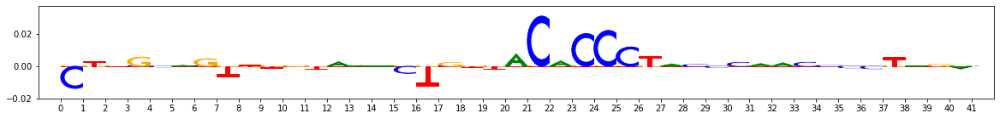

-------------------------------------------------------
PATTERNIDX 4 numseqlets 328


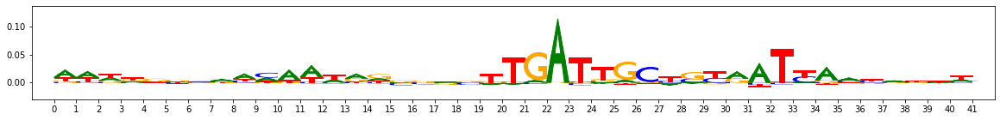

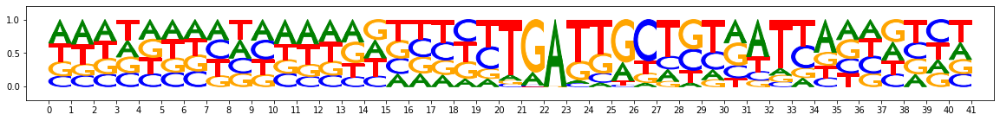

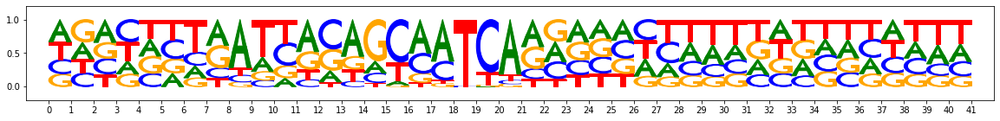

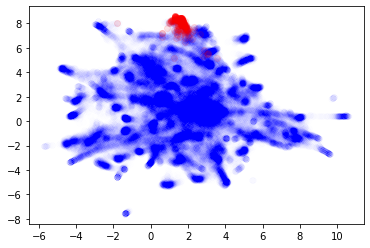

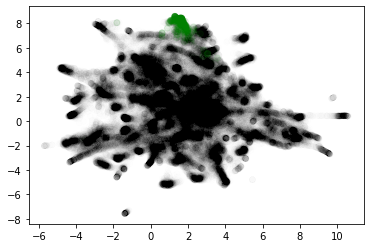

Chosen threshold: 0.9925775419266163 Precision: 0.4894067796610169 Recall: 0.7


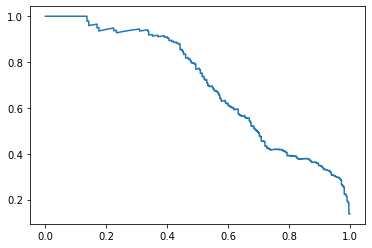

AuPRC: 0.7026232626763488
Reconstructed motif using threshold - numseqlets 457


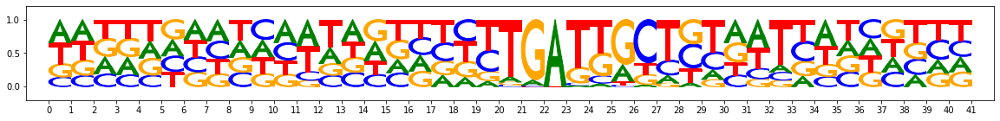

Reconstructed motif using argmax - numseqlets 1749


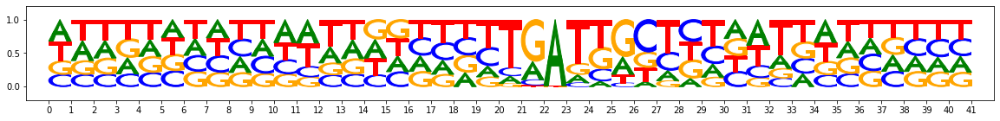

Sample false positive seqlets:
index 2 example:75,start:451,end:492,rc:True
Features: [0.07662232 0.0626149  0.03837422 0.07036192 0.07103159 0.04483931
 0.11635792 0.04359449 0.0411262  0.04708095 0.05751817 0.03763218
 0.05969197 0.06596639 0.0664265  0.06219369 0.05133245 0.0906516
 0.0741894  0.05235422 0.01150638 0.04894677 0.11202015 0.01658097
 0.02659343 0.00824314 0.09512658 0.04290042 0.02923789 0.03659503
 0.00354991 0.03160246 0.01988495 0.01753723 0.03531842 0.0488565
 0.02884009 0.03845828 0.00788405 0.03538915 0.25852675 0.26421371
 0.25185345 0.30028562 0.13058741 0.28971019 0.15550514 0.28204785
 0.25551814 0.24481523 0.02251724 0.0438129  0.01668129 0.01948356
 0.02614853 0.04899862 0.04271609 0.02815692 0.03079217 0.03360976
 0.01494142 0.01087173 0.02323066 0.08865238 0.04809074 0.0402321
 0.01623498 0.08796147 0.01141199 0.04085575 0.07423691 0.04776967
 0.07297124 0.099908   0.09819814 0.07945987 0.07052587 0.09278817
 0.05742314 0.11530371 0.10999562 0.08222887 0

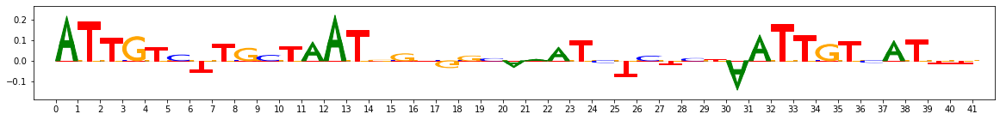

index 38422 example:288,start:477,end:518,rc:False
Features: [ 0.27397387  0.19868045  0.22436316  0.2051403   0.16268315  0.23591391
  0.22690321  0.20600532  0.28361235  0.24051508  0.04111985  0.00966826
  0.09155639  0.05177436  0.02417309  0.04394067  0.09981342  0.10673926
  0.04588371  0.04153665  0.07053382  0.10257383  0.09565748  0.06719305
  0.08585415  0.06677169  0.13538956  0.09166249  0.06692051  0.08665257
  0.06438978  0.10610074  0.08241244  0.07643884  0.09812043  0.15432478
  0.08014464  0.10449193  0.05253441  0.11408858  0.34475262  0.37356208
  0.31540759  0.41409383  0.1917189   0.30854563  0.2246567   0.30537917
  0.30559917  0.35448162  0.03600782  0.0539109   0.04532182  0.03711802
  0.03812236  0.11690163  0.04370203  0.03168523  0.03714645  0.04202226
  0.05425679  0.06031097  0.05709751  0.08911445  0.0867036   0.10216014
  0.04837844  0.1869384   0.08409886  0.08996726  0.1221126   0.13041497
  0.08788508  0.04144856  0.13148766  0.13377708  0.14363231  0

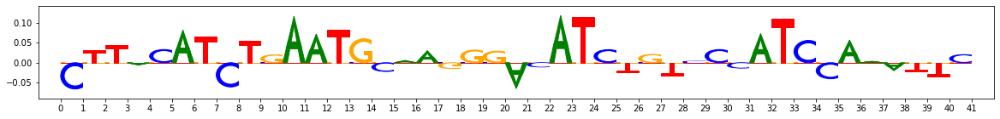

index 74867 example:829,start:478,end:519,rc:False
Features: [ 1.53268507e-01  1.15347668e-01  9.84250537e-02  9.45017097e-02
  8.51188788e-02  1.13225163e-01  1.09864042e-01  9.75286797e-02
  1.20941174e-01  1.48674177e-01  5.79185421e-02  5.50536683e-02
  7.37519299e-02  5.85332138e-02  4.63704209e-02  6.17954254e-02
  6.76072235e-02  9.63859026e-02  5.37879768e-02  5.61949333e-02
  3.42955335e-02  3.33343231e-02  9.94792474e-03  3.37770729e-02
  4.93049996e-02  2.52790815e-02  3.60022816e-02  3.02656105e-02
  2.67181071e-02  5.83845182e-02  2.61291090e-03  3.10022185e-02
  2.57988106e-02 -4.08179291e-04  5.64081480e-02  5.29549586e-02
  3.99391821e-02  4.04781640e-02  6.49399968e-03  5.88368738e-02
  4.99434399e-01  3.08767289e-01  4.11023271e-01  4.09477961e-01
  5.03415307e-01  3.56035312e-01  5.46180222e-01  3.94408670e-01
  4.34870623e-01  4.65295476e-01  7.40429164e-02  7.59175104e-02
  8.85085098e-02  5.99293617e-02  7.87668754e-02  5.71813354e-02
  9.39467199e-02  4.86813339e

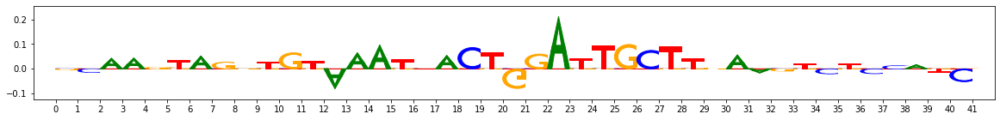

index 80765 example:1,start:477,end:518,rc:False
Features: [ 0.11327774  0.05536966  0.06893393  0.06098963  0.04683177  0.06835735
  0.0871065   0.06895532  0.08464973  0.1001301   0.00614131  0.02857034
  0.03318503  0.00210596  0.02260317  0.03060221  0.02662244  0.04609107
  0.00183546  0.03979326  0.03318399  0.04454246  0.06432387  0.04094874
  0.06406691  0.03162751  0.04976499  0.04909947  0.03434383  0.04975983
 -0.00213345  0.02879018  0.02756543 -0.00654252  0.02019304  0.05929489
  0.02302772  0.02406352 -0.00070243  0.03224378  0.61817586  0.59543705
  0.45637658  0.57782065  0.48678609  0.41821894  0.50404448  0.47044764
  0.53676506  0.63677971  0.03577475  0.04148795  0.06196385  0.03262215
  0.04792817  0.05245018  0.0406033   0.03842902  0.06920124  0.02701051
  0.03499815  0.06233686  0.02115279  0.07559242  0.08061317  0.0374363
  0.03633704  0.14890954  0.04196633  0.08511719  0.05935807  0.08077238
  0.0534112   0.05328644  0.0818198   0.08498749  0.06392544  0.05

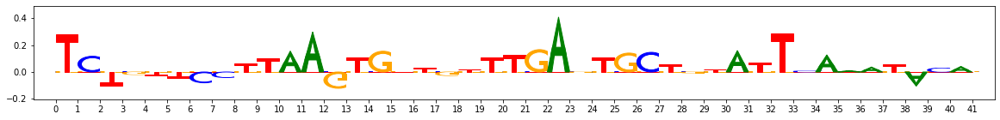

index 89071 example:820,start:547,end:588,rc:False
Features: [0.18037689 0.11774591 0.14019231 0.12955717 0.0810566  0.13418362
 0.14098265 0.12966086 0.1360804  0.14126198 0.05905503 0.04018279
 0.05070271 0.0661097  0.06432763 0.05413914 0.04295985 0.08099034
 0.06761844 0.0523884  0.07269629 0.07678358 0.08323226 0.06893218
 0.07274202 0.0632899  0.09357303 0.08761645 0.0750845  0.08860135
 0.02288726 0.05233189 0.05615538 0.02015942 0.0780813  0.08643414
 0.05732282 0.07122718 0.0327267  0.0831279  0.39048059 0.33451638
 0.3886548  0.37297861 0.37919522 0.32041059 0.41525097 0.36248537
 0.54085209 0.41733503 0.03697679 0.03327414 0.06017842 0.03444366
 0.04585145 0.02410465 0.04227629 0.02502672 0.07996712 0.04783913
 0.0666324  0.04824953 0.06889085 0.07073577 0.04087922 0.07768129
 0.07090384 0.06977964 0.05653356 0.06148992 0.03560728 0.06186762
 0.03556406 0.04095228 0.07372416 0.05061236 0.0159514  0.04005756
 0.03873384 0.11938867 0.09839123 0.0903355  0.11519512 0.15584091
 

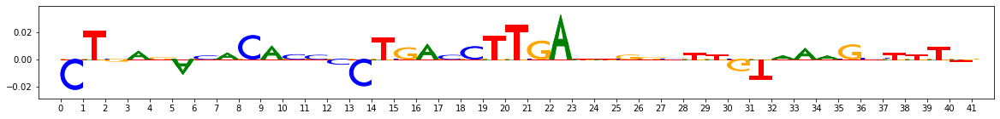

index 105425 example:1002,start:455,end:496,rc:False
Features: [ 0.12978907  0.05394358  0.09594953  0.07340066  0.05165653  0.07587752
  0.08111439  0.07506667  0.12441764  0.10476373  0.07934782  0.07449905
  0.07170002  0.07984346  0.08883887  0.08496972  0.06908821  0.03956635
  0.07697977  0.09105401  0.06983435  0.09574452  0.05787735  0.07871429
  0.07806145  0.070815    0.09275449  0.07634035  0.09664824  0.09533388
  0.05896824  0.07504564  0.07337983  0.04897764  0.07034149  0.14536553
  0.06914091  0.09574432  0.05789695  0.09705125  0.25101715  0.25161945
  0.31399309  0.24676351  0.21603381  0.33594876  0.23673253  0.24493992
  0.31598113  0.27114123 -0.0123479  -0.03384464 -0.01449025 -0.02894124
 -0.00667092 -0.02021892 -0.02180079 -0.01586556 -0.00265553 -0.02520991
  0.05672669  0.08382682  0.07149766  0.01449831  0.08496366  0.06287701
  0.07206951  0.09875674  0.05975485  0.10356216 -0.02750551 -0.02502539
  0.00396824  0.00843608  0.01090027  0.00501377 -0.01055998 

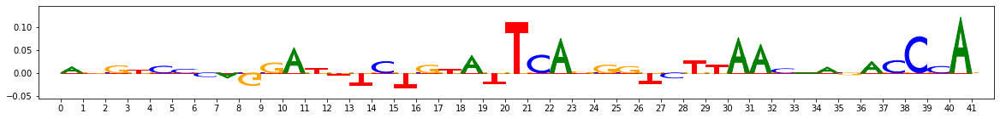

Sample false negative seqlets:
index 57637 example:59,start:469,end:510,rc:False
Features: [ 0.16277603  0.09715684  0.10955062  0.11327914  0.10148741  0.10748009
  0.1355351   0.09213137  0.13144696  0.14131767  0.03617797  0.03591239
  0.05333217  0.03631287  0.03948946  0.03844834  0.04290145  0.06911538
  0.03825194  0.04784302  0.04528732  0.06873414  0.07027695  0.06333278
  0.06389344  0.05036885  0.0726581   0.06736913  0.04561591  0.06184269
  0.00924057  0.04099384  0.02870779  0.00888387  0.01569589  0.07131959
  0.02827993  0.02417021  0.00835686  0.04394871  0.60776152  0.73068745
  0.4444567   0.61019102  0.45583699  0.41433077  0.45491265  0.47766519
  0.53573757  0.61706837  0.02978765  0.02494907  0.04129895  0.02868172
  0.03340864  0.03715263  0.02141547 -0.00084176  0.04816485  0.02756459
  0.02923837  0.05961205  0.00393745  0.06023525  0.09682427  0.0324591
  0.01596808  0.19191127  0.03251497  0.09875504  0.06285844  0.06191416
  0.04890481  0.03487465  0.060739

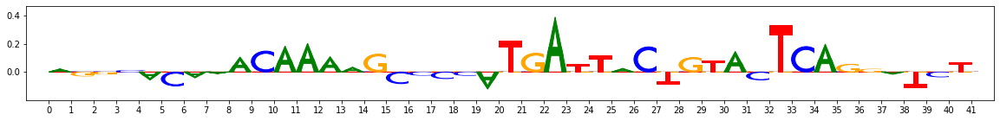

index 59262 example:429,start:484,end:525,rc:False
Features: [0.23360233 0.16603191 0.16624524 0.18609848 0.16393443 0.17890841
 0.21747101 0.16081782 0.18822769 0.20601863 0.08113799 0.07167625
 0.13083562 0.08158178 0.08439631 0.11127035 0.13747738 0.0976126
 0.07653565 0.11192164 0.04025277 0.05205552 0.06305328 0.03465172
 0.03275116 0.02728356 0.04199144 0.05646265 0.05042496 0.04182146
 0.02905952 0.05123036 0.04972991 0.02445768 0.03048248 0.06608461
 0.03609298 0.04364569 0.02416473 0.05354422 0.27367348 0.30166417
 0.36889777 0.26023423 0.25497018 0.41296959 0.28081373 0.31971265
 0.3634163  0.31032256 0.01733953 0.05858337 0.01031135 0.00725018
 0.02146928 0.04640467 0.01640044 0.06172326 0.02390169 0.01360586
 0.1430987  0.11216592 0.16008877 0.09223445 0.13414972 0.09870054
 0.13001988 0.11412578 0.11899331 0.10058147 0.06083313 0.10230019
 0.04833792 0.04880216 0.08668879 0.09609607 0.06805767 0.04156935
 0.03092391 0.20745918 0.22970659 0.1438447  0.20796494 0.07167406
 0

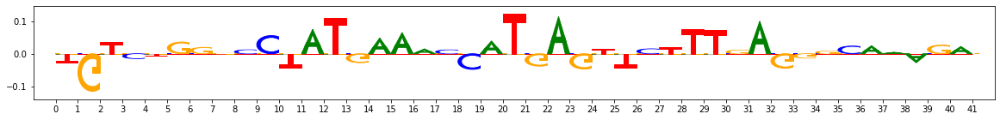

index 60912 example:321,start:464,end:505,rc:True
Features: [ 0.15862969  0.10158625  0.0952387   0.09747763  0.07752931  0.10496516
  0.1440881   0.09783258  0.09496598  0.10161646  0.06057     0.05280337
  0.06113746  0.04887822  0.04711732  0.05171959  0.05364596  0.06432428
  0.07951147  0.05842181  0.05303738  0.08810361  0.08274361  0.05656316
  0.08344982  0.04528386  0.07702992  0.06060674  0.0460804   0.07675839
  0.00930649  0.02797426  0.02964736  0.00184473  0.0195506   0.05810609
  0.0277027   0.02959088  0.00538986  0.03212103  0.46054697  0.34307928
  0.46692323  0.50493697  0.29083303  0.43129056  0.39384469  0.43384639
  0.50275083  0.41837229  0.03681875  0.04196639  0.05399049  0.04057276
  0.03385142  0.05701608  0.05460245  0.0268467   0.05505082  0.04623338
  0.0173254   0.01746981 -0.00952106  0.05096057  0.01837886  0.02069395
 -0.00106892  0.09538991 -0.00137982  0.04299988  0.1403454   0.11400291
  0.11797467  0.09165012  0.14007251  0.16802631  0.12808521  0.

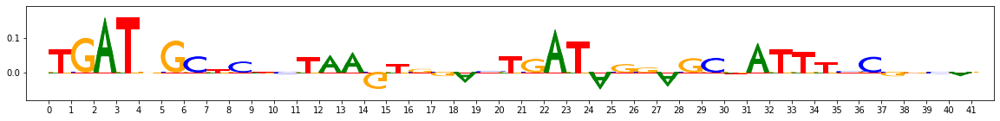

index 62537 example:321,start:522,end:563,rc:False
Features: [ 1.11377123e-01  5.86567586e-02  6.49675488e-02  4.77722819e-02
  3.73684805e-02  6.62466162e-02  7.93714198e-02  5.41447729e-02
  6.19340348e-02  6.50609494e-02 -1.14834476e-03  8.83727363e-03
  2.02345725e-04  2.57604394e-03  1.84012728e-02 -6.36319431e-03
  5.68542485e-03  5.19662937e-02 -8.06913522e-03  1.61759595e-02
  6.31727564e-02  8.42166593e-02  5.99639714e-02  6.70402446e-02
  6.74734841e-02  6.26303290e-02  1.29241459e-01  6.14271367e-02
  6.93372365e-02  7.62174968e-02  2.75169995e-02  5.92362108e-02
  2.84070622e-02  1.38007278e-02  5.17699420e-02  6.63790003e-02
  2.47931306e-02  4.64975031e-02  4.99798670e-03  6.20300793e-02
  4.47113866e-01  3.40831685e-01  3.57056746e-01  5.34152326e-01
  2.88064954e-01  2.79997835e-01  3.15401420e-01  3.25783721e-01
  3.78408951e-01  4.08745765e-01  6.77892299e-02  3.37729353e-02
  6.67613076e-02  3.00565041e-02  9.43440668e-02  1.71369450e-02
  2.20950351e-02  1.20801617e

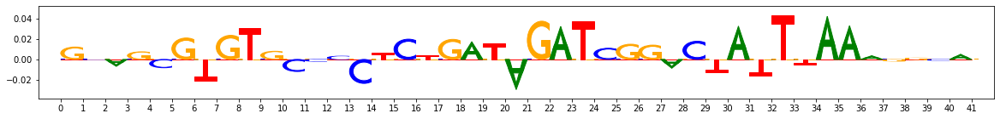

index 64162 example:400,start:457,end:498,rc:False
Features: [ 0.05631689  0.00213706 -0.00201329  0.02051769  0.00669541  0.01031014
  0.02089104 -0.00287818  0.0079194   0.05489114  0.01154083  0.01861532
  0.01841863  0.01020275  0.02492374  0.02788135  0.0193154   0.05327679
  0.00962694  0.02789865  0.02549975  0.05316577  0.02734378  0.03287429
  0.04043742  0.02600249  0.10439986  0.02890275  0.02687657  0.03645822
  0.01071016  0.04757797  0.04171112  0.00910856  0.02170202  0.05419218
  0.03677798  0.04148261  0.00775332  0.04997377  0.49609927  0.39440225
  0.38887324  0.45350764  0.40685617  0.38893102  0.42911989  0.4469264
  0.46074196  0.43414907  0.10503944  0.10207154  0.11222326  0.10172707
  0.09233371  0.1121993   0.11971788  0.07386508  0.0952394   0.10195309
  0.03516898  0.03548077  0.02750728  0.12009757  0.0876568   0.07156324
  0.02748168  0.10332133  0.04988902  0.05625386  0.07253005  0.04859894
  0.05370207  0.0324081   0.07298876  0.08270301  0.04884774  0.

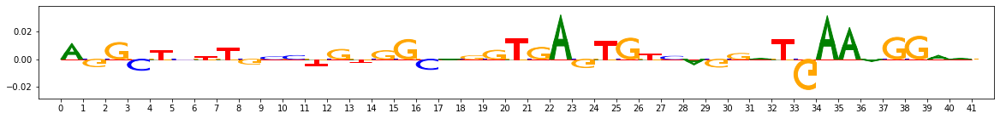

index 65787 example:965,start:631,end:672,rc:True
Features: [ 0.11858111  0.05973755  0.07131715  0.06701311  0.04238497  0.07123984
  0.07577791  0.05526646  0.07116342  0.1038552   0.10052433  0.10443015
  0.11283199  0.07400891  0.10228257  0.10495973  0.10149293  0.0738792
  0.09488218  0.11980308  0.00814476  0.02573983  0.01769352  0.00389104
  0.00695315 -0.0014231   0.05893313  0.01280343 -0.00495196  0.0040594
  0.00976385  0.04455093  0.0357718   0.00753249  0.02482989  0.06092219
  0.03397599  0.04389544  0.00683244  0.0390849   0.42330385  0.31945894
  0.36792019  0.34570709  0.452129    0.33299438  0.46550644  0.45934618
  0.41273243  0.45009664  0.05906504  0.0615539   0.06759003  0.04557004
  0.04797401  0.08636166  0.06431893  0.04078379  0.06197524  0.06412266
  0.01336727  0.01464928  0.02200113  0.06777083  0.06551952  0.07358337
  0.03046378  0.01619646  0.04159021  0.00884633  0.03986988  0.0633416
  0.05525829  0.04520397  0.08933252  0.06646732  0.05473005  0.056

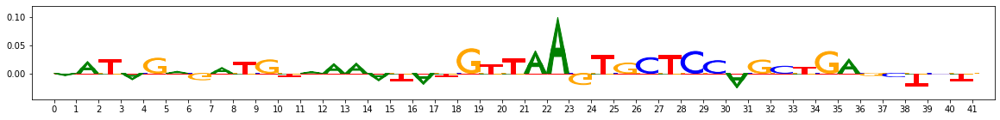

-------------------------------------------------------
PATTERNIDX 5 numseqlets 326


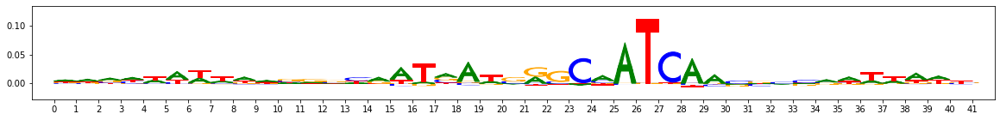

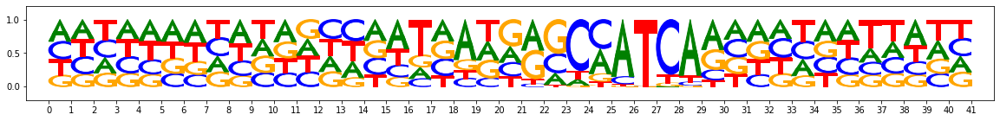

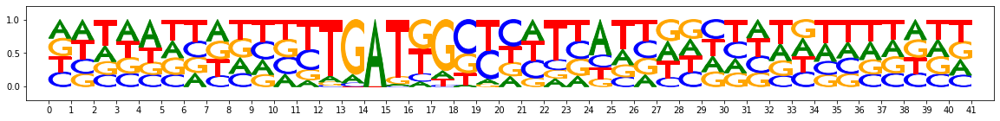

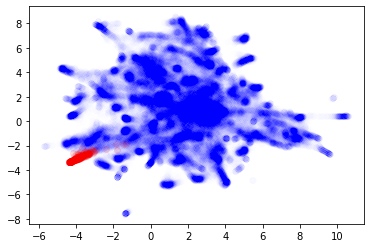

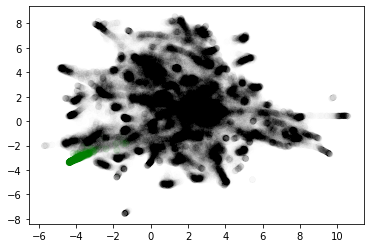

Chosen threshold: 0.9952465560779826 Precision: 0.6784660766961652 Recall: 0.6990881458966566


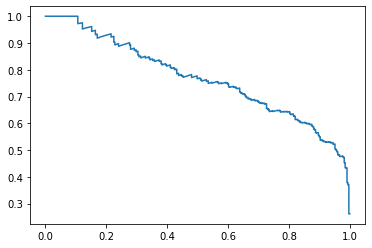

AuPRC: 0.7691530563202872
Reconstructed motif using threshold - numseqlets 336


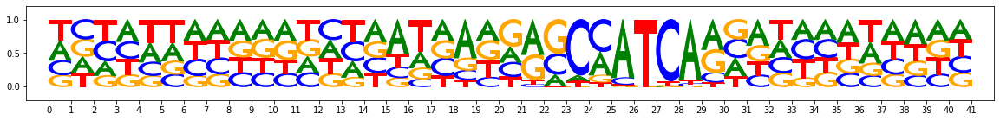

Reconstructed motif using argmax - numseqlets 1050


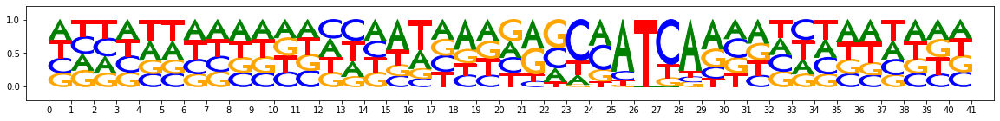

Sample false positive seqlets:
index 43 example:970,start:469,end:510,rc:False
Features: [0.0658388  0.03214909 0.06109366 0.06960647 0.0335946  0.06922958
 0.05843654 0.04682676 0.06919092 0.04901476 0.06166499 0.04597069
 0.04000802 0.05834561 0.04116775 0.06019576 0.06662798 0.06227209
 0.07237561 0.05480598 0.01448988 0.03929886 0.02220144 0.00318023
 0.05559305 0.00482976 0.04357154 0.00983967 0.02900717 0.02793243
 0.04483732 0.0529498  0.0528236  0.04685053 0.04083354 0.07984534
 0.04217945 0.04435882 0.03583192 0.05765958 0.04716077 0.06435703
 0.08274188 0.07217619 0.02782558 0.05913084 0.04729549 0.05280082
 0.06909109 0.06081835 0.36341965 0.37167158 0.3418825  0.34468136
 0.32741537 0.34475697 0.35819181 0.32281048 0.31480011 0.35943142
 0.03741812 0.00914357 0.05344789 0.08030882 0.00892213 0.04493204
 0.01105069 0.02247204 0.00777842 0.00102148 0.15713556 0.0931548
 0.14175826 0.09363814 0.17383657 0.15956267 0.11367543 0.16937915
 0.10103263 0.12182201 0.1272331  0.12275

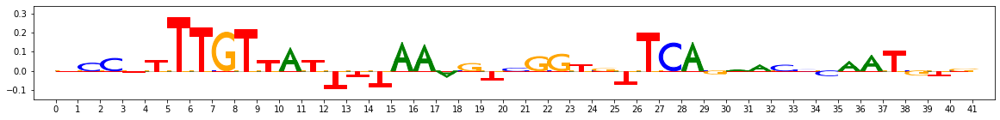

index 42172 example:460,start:419,end:460,rc:False
Features: [ 8.56818201e-02  7.75685044e-02  6.85228343e-02  9.50007532e-02
  6.51360341e-02  1.17556561e-01  8.26192897e-02  7.70357580e-02
  9.52535558e-02  6.98315734e-02  2.52872841e-02  3.60239921e-03
  4.13771145e-02  3.27652867e-02 -3.17041258e-04  5.02057346e-02
  4.94908938e-02  1.21565172e-01  2.95042701e-02  1.48204135e-02
  3.20182417e-02  3.55545659e-02  3.70902977e-02  3.88292092e-02
  6.14009523e-02  2.14844857e-02  3.12590154e-02  4.02441672e-02
  4.22983837e-02  4.93760235e-02  5.95683722e-02  6.28918801e-02
  4.89419059e-02  6.73883740e-02  6.02984712e-02  6.25567560e-02
  4.66515336e-02  6.56755894e-02  4.01001942e-02  7.89790332e-02
  7.17395460e-02  8.24455494e-02  8.97583204e-02  8.50860577e-02
  8.87067460e-02  5.53354713e-02  1.07209543e-01  8.02858629e-02
  1.07531677e-01  7.18598274e-02  3.41287264e-01  3.44622253e-01
  3.66441152e-01  3.30932245e-01  2.98543741e-01  3.35257834e-01
  3.87423988e-01  2.64621208e

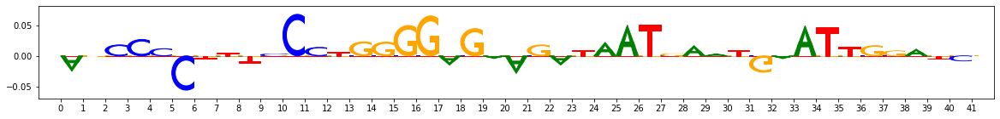

index 70627 example:905,start:446,end:487,rc:True
Features: [-0.0391093  -0.06014209 -0.04197152 -0.03097565 -0.05501685 -0.038898
 -0.02933167 -0.07313356 -0.05931417 -0.04509998  0.16517159  0.1932659
  0.17951861  0.2018622   0.21102981  0.16953853  0.2115531   0.10996979
  0.14736803  0.17381439  0.02668449  0.03528085  0.04282304  0.0007064
  0.03319971  0.00282606  0.01716925  0.02208361  0.01991619  0.02953027
  0.04029041  0.04605652  0.05572628  0.04745314  0.04184509  0.05362157
  0.04190921  0.04379227  0.04250176  0.05296698  0.04153652  0.07725827
  0.07433259  0.06405781  0.03668868  0.04811751  0.06751891  0.06796341
  0.06852603  0.05874071  0.34937416  0.4076349   0.32763493  0.27508543
  0.39632313  0.43247057  0.29760588  0.5524939   0.31686231  0.30602206
  0.10668099  0.07562686  0.18494493  0.02992697  0.07013717  0.05410868
  0.10827512  0.04727433  0.1205885   0.06542311  0.23725521  0.1705749
  0.23584137  0.10483022  0.18577802  0.21302248  0.25255706  0.21471

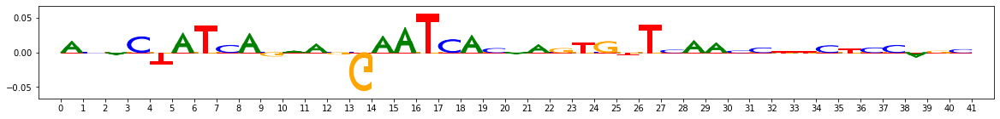

index 85076 example:911,start:529,end:570,rc:False
Features: [ 0.01868934 -0.00744663 -0.00168137  0.01485958  0.00296614  0.03477013
 -0.00074301 -0.01275258  0.00859041 -0.0022609  -0.01388448 -0.00271957
 -0.00411035 -0.01821975 -0.01537108 -0.00724173 -0.00115497  0.02907351
 -0.02150364  0.00251353  0.02429277  0.03401484  0.01671863  0.01581047
  0.07718971  0.01224137  0.02381891  0.01082981  0.03991982  0.02450125
  0.02127725  0.03187081  0.03439982  0.02702163  0.02224216  0.02379958
  0.0217644   0.02641468  0.01404978  0.02608031  0.08028098  0.07967229
  0.08952347  0.090343    0.05431886  0.05291341  0.08123085  0.06375716
  0.09271078  0.07876225  0.34853353  0.34677092  0.37624349  0.31642444
  0.326151    0.39046453  0.35341851  0.2853915   0.28820837  0.3578701
  0.04438448  0.0230895   0.02387316  0.07422338  0.03286096  0.03725358
  0.01383032  0.04114967  0.03879751  0.01326232  0.32452671  0.24425618
  0.31584074  0.18941778  0.30582056  0.29329044  0.29205765  0.

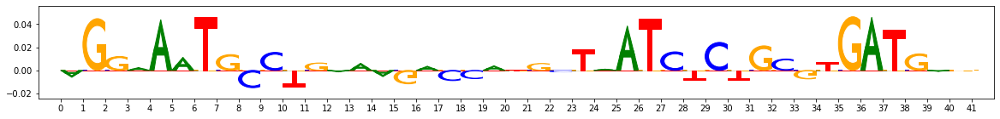

index 100521 example:8,start:512,end:553,rc:True
Features: [0.03806704 0.04667706 0.03157075 0.04017895 0.0424854  0.06103387
 0.05964246 0.02656032 0.04293726 0.03815417 0.10108442 0.12012974
 0.13723227 0.09462951 0.1260821  0.12092882 0.11390364 0.1156837
 0.07909358 0.10302373 0.05927353 0.11633933 0.06122012 0.05104993
 0.07152188 0.05023672 0.15736396 0.06854471 0.07795033 0.08522154
 0.09449401 0.12280924 0.14428266 0.12084877 0.13670391 0.12715406
 0.1045059  0.14544741 0.10834024 0.13425355 0.07511718 0.06308197
 0.05393619 0.08810308 0.03744193 0.05357766 0.06236003 0.08613372
 0.06910213 0.06947186 0.36402212 0.34251987 0.32022248 0.29096042
 0.35932407 0.29275725 0.32317078 0.34731303 0.34565123 0.33582345
 0.08300197 0.03635402 0.06074536 0.10381333 0.05094244 0.09682716
 0.04449978 0.03662426 0.05047587 0.0498721  0.34238449 0.25247513
 0.35500404 0.19118667 0.27836542 0.2756511  0.27509147 0.2756144
 0.29176278 0.0974358  0.06348243 0.10459503 0.08420212 0.09078123
 0.06

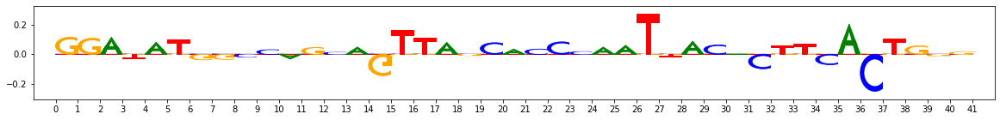

index 105440 example:1002,start:470,end:511,rc:False
Features: [ 0.01673635  0.00628095  0.00768069  0.03546913  0.00113527  0.04190952
  0.00296334  0.00274797  0.01669057  0.01168998  0.08530644  0.06601442
  0.08782647  0.08679931  0.08522769  0.11492115  0.10185681  0.05587917
  0.07140549  0.07751388  0.02543113  0.05425078  0.05239995  0.01052932
  0.0431651   0.01412322  0.07413849  0.02365847  0.0367995   0.02819552
  0.09064684  0.10133374  0.10533667  0.10309441  0.09862593  0.10794407
  0.07095515  0.12119933  0.07709446  0.12429715  0.00512212  0.01315621
  0.00627453  0.01086359  0.05486097 -0.02227158  0.05043887  0.02103451
  0.03473547  0.01671365  0.53834322  0.53464289  0.54394445  0.52231651
  0.49401631  0.49403541  0.57879592  0.44983691  0.41587862  0.56199475
  0.02678267 -0.00427531  0.04208046  0.07240182 -0.02419129  0.04687877
  0.00519595 -0.01075844 -0.00331978 -0.0291276   0.25394     0.18020174
  0.23059437  0.17342978  0.25372535  0.22295277  0.1765545  

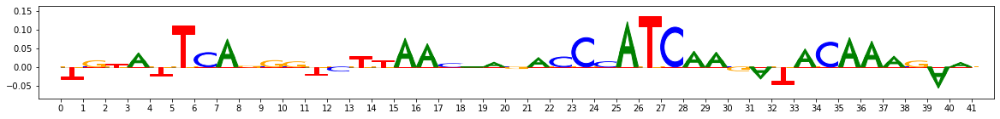

Sample false negative seqlets:
index 65837 example:369,start:483,end:524,rc:True
Features: [-0.02107611 -0.02652851 -0.02525235 -0.01877896 -0.01879138  0.00866656
 -0.02555198 -0.02510456 -0.01615933 -0.02476704  0.14788834  0.13106159
  0.17288714  0.15191658  0.13283101  0.16871856  0.19315881  0.12764307
  0.11777065  0.09371252  0.03283275  0.03607983  0.04444087  0.01147655
  0.0391308   0.01708634  0.01750893  0.02872779  0.04268367  0.03233963
  0.09980099  0.11216043  0.10076349  0.10437768  0.09741497  0.10003914
  0.07165847  0.11335437  0.07994205  0.10773073  0.03665591  0.03028398
  0.05138742  0.04517889  0.04533989  0.03628099  0.05413999  0.03907284
  0.04681847  0.03424289  0.62338104  0.72207845  0.58101229  0.5783868
  0.63001119  0.53265099  0.60314025  0.67134292  0.47000318  0.63790536
  0.08059603  0.0373197   0.10167998  0.05944541  0.01789925  0.00814192
  0.0667247   0.02355048  0.07425584  0.01505538  0.28801013  0.20258223
  0.29346818  0.18205083  0.222376

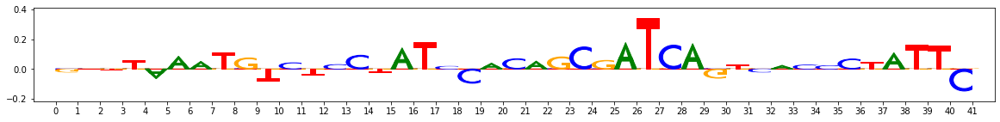

index 67412 example:573,start:482,end:523,rc:True
Features: [-0.02862534 -0.03343053 -0.0254675  -0.01894459 -0.02153595 -0.01500439
 -0.01791014 -0.03312335 -0.03170984 -0.0263106   0.11285113  0.11023806
  0.13101538  0.1366475   0.1158487   0.11336994  0.14245189  0.11658472
  0.08734409  0.08193383  0.03631282  0.07083417  0.06708999  0.00934846
  0.01867491  0.01972086  0.09300201  0.03870833  0.03437971  0.04693984
  0.06022345  0.077447    0.07269368  0.07814178  0.0435439   0.06873971
  0.02604279  0.06782332  0.05784002  0.0580614   0.03083459  0.05810312
  0.0443859   0.08429697  0.02441816  0.04621738  0.03701217  0.06233855
  0.03979937  0.03282394  0.40391445  0.46030289  0.35712802  0.36842654
  0.41625884  0.37107669  0.38107815  0.61355612  0.32901852  0.3678577
  0.0810247   0.05331413  0.11367686  0.06723236  0.05502846  0.05867749
  0.0683526   0.01683369  0.03511876  0.02400765  0.20949924  0.12556806
  0.18152984  0.0707402   0.16934863  0.1771763   0.1538108   0.1

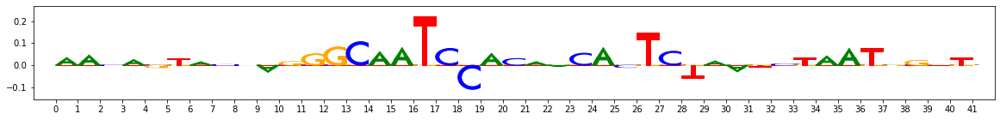

index 69037 example:302,start:440,end:481,rc:True
Features: [ 0.01385404  0.01743121  0.00330175  0.01370954  0.01307827  0.02905975
  0.01074778  0.00608953  0.01578802  0.00637398  0.13742005  0.17557534
  0.1510067   0.13471873  0.18242713  0.14357305  0.1652577   0.13848792
  0.10284783  0.15358447  0.03825231  0.04959923  0.04948429  0.02193789
  0.05754445  0.03318812  0.05064235  0.05900089  0.04649777  0.04651909
  0.09948358  0.13350887  0.11230117  0.10818383  0.1286753   0.12729331
  0.08982484  0.10558724  0.09257887  0.11573049  0.03788075  0.04007119
  0.06346282  0.05565532  0.0361003   0.05020354  0.06867437  0.06642481
  0.0955598   0.0619461   0.41706493  0.42434722  0.35146339  0.33084731
  0.51254036  0.39089743  0.31639665  0.38799153  0.45362622  0.35891962
  0.06008216  0.03806807  0.0744798   0.04519086  0.04074386  0.02948492
  0.06320789  0.02228006  0.08845913  0.02855654  0.16591987  0.1368712
  0.16836397  0.06717586  0.12066262  0.16694877  0.18258251  0.1

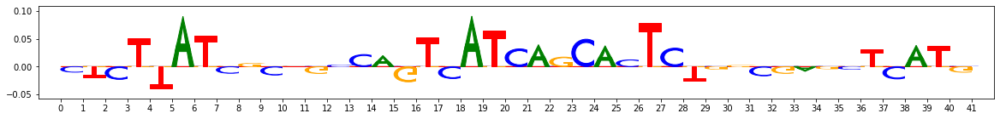

index 70687 example:896,start:599,end:640,rc:False
Features: [ 0.04004175  0.01518265  0.01859259  0.04886737  0.01802381  0.0300209
  0.03470481  0.01680389  0.01253028  0.03101877  0.16198939  0.1812559
  0.17506942  0.15392813  0.17455276  0.15625417  0.18364405  0.10519271
  0.1073127   0.14903113  0.04002648  0.05228078  0.05824493  0.02459114
  0.0513963   0.03736907  0.06752853  0.04345614  0.05325544  0.0559952
  0.02266881  0.04075694  0.04841494  0.04098169  0.03624284  0.0525918
  0.0321421   0.04216522  0.02713326  0.05190394  0.07447182  0.06748759
  0.12017401  0.09271042  0.08923583  0.09957897  0.1212563   0.1128586
  0.13923415  0.07494952  0.34566803  0.36425607  0.2981545   0.27430982
  0.39340385  0.26736097  0.29443917  0.43782765  0.27948053  0.30180748
  0.07140321  0.09250682  0.10721332  0.06987312  0.04729877  0.03856981
  0.11596375  0.0109638   0.06198354  0.02739213  0.22101341  0.16880705
  0.21772196  0.12113072  0.20138504  0.19769888  0.18356322  0.1945

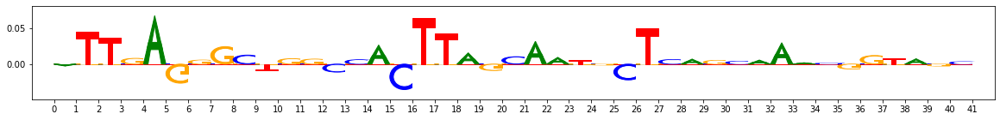

index 72312 example:877,start:439,end:480,rc:False
Features: [ 8.31715822e-03 -3.04810704e-03 -6.20947710e-03  1.99806487e-02
  2.17830626e-04  2.65823118e-02  5.52939896e-03 -5.11165518e-03
 -2.02946091e-03 -3.96777053e-03  8.65048324e-02  7.89053377e-02
  9.71633427e-02  6.91491417e-02  8.33075523e-02  1.12711639e-01
  1.08352296e-01  8.11758038e-02  7.10770392e-02  9.05271582e-02
  6.04957631e-03  1.34975189e-02  1.58768392e-02  3.42421211e-03
  1.36649051e-02 -4.94569382e-03  1.29736576e-02 -1.74786081e-03
  9.22019247e-03  4.99852260e-03  1.31638301e-01  1.43563161e-01
  1.29198122e-01  1.34777570e-01  1.20411514e-01  1.27919323e-01
  1.05114527e-01  1.35431892e-01  1.09923221e-01  1.50891299e-01
  5.34058566e-02  5.33052144e-02  5.84594509e-02  6.63562108e-02
  5.16681693e-02  6.76342583e-02  5.52157412e-02  1.50826075e-01
  5.94588738e-02  4.38701250e-02  6.46640631e-01  6.02583149e-01
  6.49836318e-01  7.65416592e-01  5.25046847e-01  4.69872349e-01
  6.29896044e-01  4.52529999e

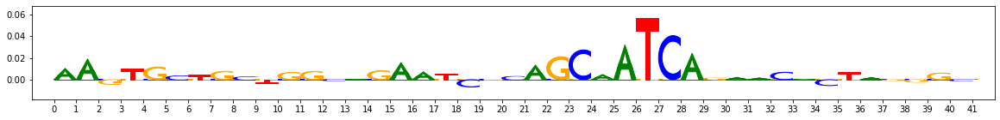

index 73937 example:558,start:408,end:449,rc:False
Features: [ 1.10028375e-02  1.08453321e-02  8.62745696e-03  3.19394349e-02
  1.48639000e-02  2.82662969e-02  1.44933855e-02  1.03727193e-02
  6.70241093e-03  7.61677945e-04 -1.49509121e-02 -1.14820680e-02
 -2.52888716e-02 -1.12187569e-02  7.69525381e-03  1.85661167e-02
  8.11758934e-03  4.06700303e-02 -3.45278804e-02  1.06111306e-02
 -1.57866021e-02 -7.48698653e-03 -1.76360176e-02 -2.54912459e-02
 -5.66674374e-03 -2.30024216e-02 -3.25358490e-03 -3.82598152e-03
 -8.28199952e-03 -7.00273528e-03  3.73570295e-02  4.71772368e-02
  5.07759434e-02  3.02025159e-02  3.78297915e-02  3.88616723e-02
  2.71714684e-02  4.46299515e-02  2.14854127e-02  6.09779204e-02
  4.64031025e-02  5.03945475e-02  7.26870667e-02  6.55446824e-02
  8.17043441e-02  8.08143407e-03  6.51805592e-02  3.31621713e-02
  9.09294233e-02  5.92000583e-02  4.53551998e-01  3.92476409e-01
  4.22669677e-01  4.04790948e-01  4.28143002e-01  2.66119304e-01
  4.02060880e-01  3.14373328e

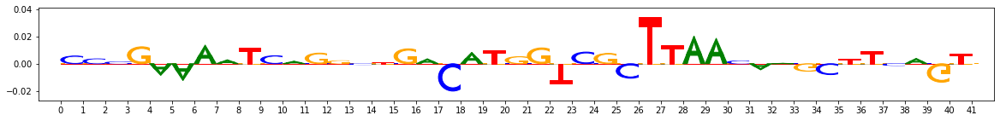

-------------------------------------------------------
PATTERNIDX 6 numseqlets 271


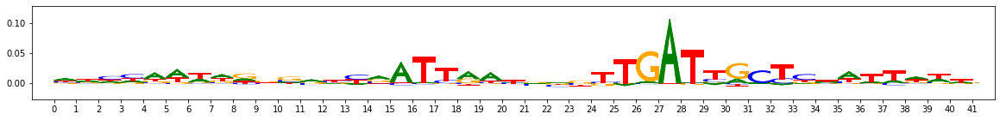

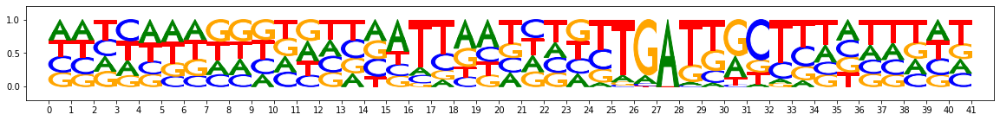

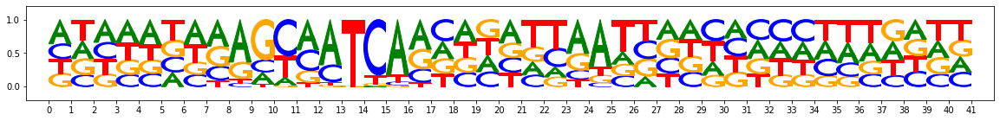

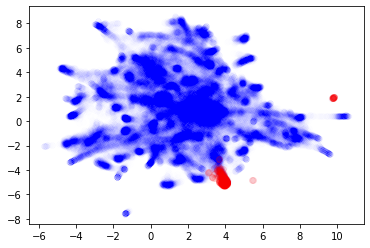

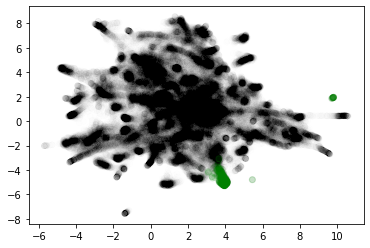

Chosen threshold: 0.9911547904003909 Precision: 0.3929273084479371 Recall: 0.6993006993006993


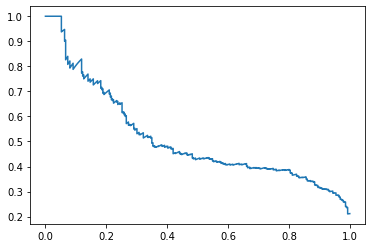

AuPRC: 0.5121734079387453
Reconstructed motif using threshold - numseqlets 487


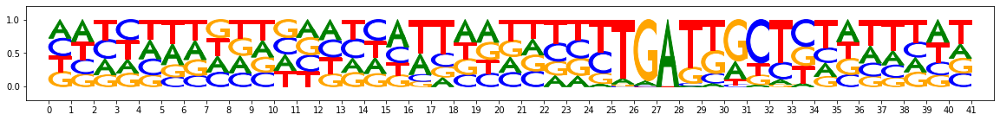

Reconstructed motif using argmax - numseqlets 1543


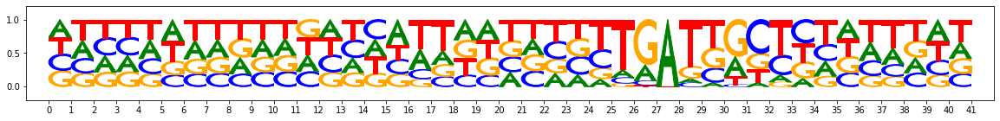

Sample false positive seqlets:
index 17 example:75,start:466,end:507,rc:True
Features: [-2.95641464e-02 -3.44384797e-02 -4.68920396e-02  1.08583170e-02
 -2.09660588e-02 -3.79942520e-02 -2.68303666e-02 -3.93151706e-02
 -4.71887113e-02 -2.94801270e-02  1.94408512e-01  1.93507256e-01
  2.34034218e-01  2.45133609e-01  2.07659252e-01  1.96573680e-01
  2.48260066e-01  1.50909906e-01  1.69918985e-01  1.37837625e-01
  1.19149950e-01  9.37674870e-02  1.29226242e-01  1.23855996e-01
  1.63377945e-01  1.12478771e-01  1.06069592e-01  1.04023767e-01
  1.30292968e-01  1.16224086e-01  1.92078834e-02  3.97424645e-02
  1.77774311e-02  1.69354146e-02  2.66225224e-02  1.42420144e-02
  1.37823462e-02  2.08738889e-02  9.84009916e-03  1.14575939e-02
  2.98392388e-02  3.86541533e-02  4.44847690e-02  4.42007775e-02
  5.85934364e-02  4.37658365e-02  4.61498625e-02  7.73107573e-02
  8.16679296e-02  6.50877228e-02  5.68026718e-02  1.38591203e-01
  6.16337173e-02  3.12390265e-02  1.25088691e-01  1.27239436e-01
  3

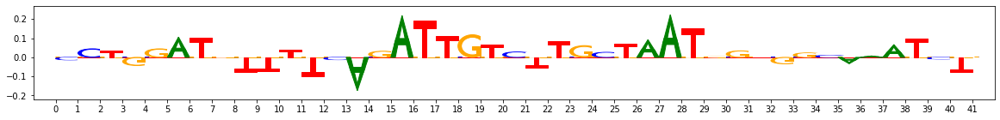

index 49266 example:921,start:413,end:454,rc:False
Features: [-1.60941711e-02 -5.94452523e-03 -9.91282691e-03  2.05724643e-02
 -6.80424878e-03 -2.89819870e-02 -2.06329648e-02 -2.10274550e-02
  7.95770423e-03  1.38520893e-02  4.84037477e-02  7.49972727e-02
  4.34380013e-02  3.96569023e-02  9.57274942e-02  5.33571258e-02
  4.88622849e-02  4.67980213e-02  3.01084439e-02  9.77170824e-02
  2.70628057e-01  3.21578696e-01  3.07287508e-01  2.68491814e-01
  3.08876901e-01  2.82936230e-01  3.27775451e-01  3.14114097e-01
  3.48176999e-01  3.37536703e-01  1.13135348e-01  1.29761136e-01
  1.23077010e-01  1.31936466e-01  2.15466983e-01  1.30211379e-01
  1.32950148e-01  1.46997489e-01  1.32023463e-01  1.32344351e-01
  7.31371072e-04  2.05694924e-02  1.83730315e-02  2.93180976e-03
 -2.13972842e-02  3.80978131e-02 -2.27009576e-04  6.68038053e-02
  3.56199121e-02  1.47106824e-02 -1.57046774e-02 -2.13422477e-02
 -3.29639602e-02 -3.83847641e-02 -1.47117577e-02 -1.62691971e-02
 -4.03877560e-02 -1.59405275e

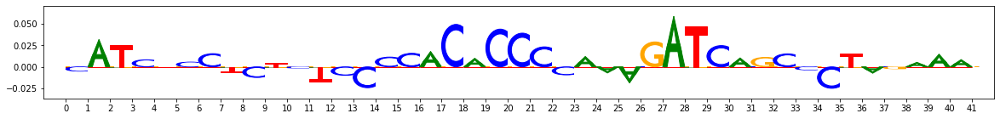

index 62982 example:794,start:414,end:455,rc:False
Features: [ 1.86617756e-02  3.07558338e-02  2.78285507e-02  3.97310685e-02
  2.72693952e-02  2.60911250e-02  6.48705533e-02  2.40289149e-02
  2.86721082e-02  3.37605064e-02 -1.19760560e-02 -3.08155957e-02
 -1.40979766e-02  9.21230522e-03 -3.33124080e-02 -2.29548689e-02
 -1.49752309e-02  4.58654221e-02  1.26240414e-02 -3.27163048e-02
  1.62696897e-01  1.95840129e-01  1.64163187e-01  1.58043625e-01
  2.25470448e-01  1.55104342e-01  1.79740436e-01  1.53934802e-01
  1.76254833e-01  1.90498791e-01  7.78841337e-02  8.52440509e-02
  6.59899809e-02  8.36826129e-02  9.06381221e-02  8.90376300e-02
  5.70414736e-02  1.04500632e-01  6.39468491e-02  8.71358692e-02
  9.66508669e-02  7.29567716e-02  4.36806858e-03  7.63630511e-02
  1.03222075e-02  4.16258541e-02 -3.81476319e-03  5.29844343e-02
  1.26422650e-02  7.39488181e-02  2.15231666e-02  2.18188846e-02
  1.48652459e-02  3.91623963e-02  8.42795667e-03  3.24077120e-02
  5.13321842e-02  1.93412544e

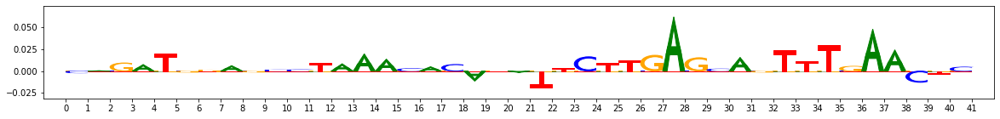

index 75975 example:88,start:600,end:641,rc:False
Features: [ 0.04969378  0.05622239  0.04756754  0.07530552  0.04258536  0.05179231
  0.04788524  0.04328577  0.07430012  0.08414997  0.0396548   0.021847
  0.02995861  0.03665993  0.02268476  0.03572868  0.03583157  0.0640084
  0.03541278  0.01886258  0.10612389  0.10801345  0.11418005  0.11507605
  0.15950485  0.10873562  0.14630824  0.09475341  0.13125999  0.1234057
  0.04988426  0.04019474  0.02053677  0.02270097  0.02659087  0.0297738
  0.02829242  0.0287783   0.01536775  0.04386692 -0.00204603  0.02989993
  0.01221926  0.01296105  0.03880629  0.0039097   0.00647072  0.03950297
  0.04800715  0.03160413  0.01289405  0.00192949  0.02536178  0.02233419
  0.00815769  0.02813331  0.01208961  0.01212202  0.02961176  0.01478192
  0.36930473  0.30605348  0.36735254  0.33404864  0.32987046  0.41727828
  0.41024211  0.29107991  0.43436833  0.34516785  0.02091001  0.04219311
  0.01390224  0.06562268  0.0578847   0.04068495  0.01919531  0.02745

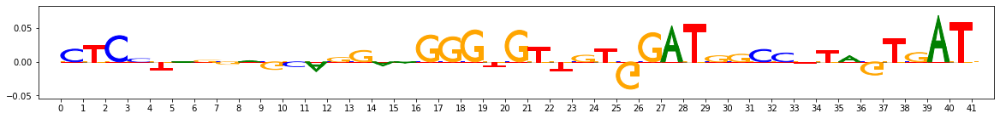

index 86247 example:167,start:562,end:603,rc:False
Features: [ 1.61934045e-01  1.40052439e-01  1.55853957e-01  1.67961862e-01
  1.54594684e-01  1.53363292e-01  2.10155037e-01  1.49096176e-01
  1.43164917e-01  1.34305427e-01  1.90398663e-01  1.50713836e-01
  2.43769057e-01  2.26491856e-01  1.50961731e-01  1.86999062e-01
  2.67620563e-01  1.69822972e-01  2.03508550e-01  1.28147977e-01
  8.12332811e-02  7.62658192e-02  1.68450799e-01  7.43362239e-02
  1.13479476e-01  8.32305655e-02  8.53861845e-02  8.81753613e-02
  8.99109421e-02  9.23431430e-02 -1.13211881e-04  1.44823688e-02
  2.97307621e-03  1.75035125e-03  2.24718712e-02  1.85490844e-02
  7.39958437e-04  5.71526176e-03  3.72957636e-03 -2.74651513e-03
 -4.77801376e-03  5.65101683e-02  3.61280787e-02  3.51784816e-02
  1.86610339e-02  1.84284298e-02 -6.59654208e-03  2.77293296e-02
  8.34654600e-02  6.65487353e-02  6.96265880e-03  9.00915617e-02
  6.47338958e-03 -1.49552280e-03  4.64205960e-02  7.34099176e-02
  4.42997841e-03  1.10009356e

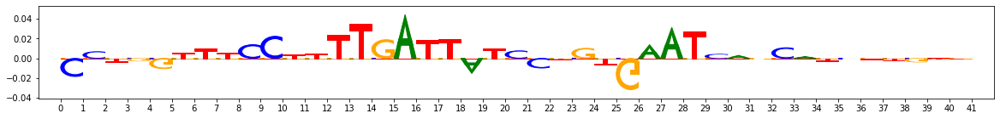

index 104963 example:537,start:517,end:558,rc:False
Features: [ 0.02472725  0.03605229  0.02814946  0.03151155  0.03452259  0.0149209
  0.03145147  0.03818072  0.04023254  0.04032404  0.0014656  -0.01117816
 -0.00385597 -0.00066969 -0.01282349 -0.00198596  0.00468027 -0.00173079
 -0.0019494  -0.00308015  0.10839554  0.11628812  0.15046903  0.10099686
  0.13319732  0.11679144  0.15811466  0.12753789  0.13207621  0.13755499
  0.04293025  0.05361207  0.04567354  0.05673537  0.06613316  0.0605832
  0.04474855  0.06661006  0.046733    0.05897193  0.03689422  0.05103847
  0.09876032  0.0557343   0.00613903  0.18802917 -0.00730734  0.06269073
  0.05377587  0.04381269 -0.04356148 -0.0463979  -0.04455164 -0.04999697
 -0.04062918 -0.04086135 -0.04245392 -0.03918902 -0.00235298 -0.03626814
  0.26826168  0.2091705   0.29184521  0.15247709  0.18996939  0.30950814
  0.32031183  0.24190916  0.29898337  0.32903892  0.01082792 -0.00550563
  0.01617043 -0.0022716  -0.02176776 -0.04281237  0.01622153 -0.

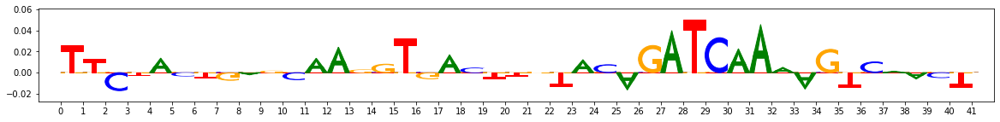

Sample false negative seqlets:
index 5504 example:843,start:488,end:529,rc:True
Features: [0.0234478  0.01105297 0.00958778 0.02511142 0.00948132 0.01138232
 0.01024908 0.00893666 0.02302429 0.06900299 0.03226588 0.02217105
 0.01466492 0.03893132 0.03723216 0.03500541 0.0117842  0.04157976
 0.03307171 0.01760084 0.11111827 0.1014272  0.12458242 0.09460282
 0.1094093  0.09644633 0.12434034 0.10555139 0.14217003 0.1195249
 0.02200225 0.03755873 0.03626885 0.03623086 0.05487906 0.04709159
 0.03559417 0.06210142 0.02789795 0.0424652  0.10402891 0.10930196
 0.12579382 0.08931595 0.1118518  0.10921752 0.10594801 0.1016766
 0.20467992 0.13171278 0.02237004 0.02200707 0.02026735 0.00557964
 0.02628735 0.03319036 0.04632913 0.02446266 0.05461478 0.01363498
 0.42712887 0.4869826  0.3598026  0.21962806 0.47831087 0.43912219
 0.41603555 0.45565231 0.46867216 0.38776836 0.0515678  0.03153286
 0.05300761 0.05949741 0.06674405 0.08663343 0.0516203  0.04549187
 0.03448726 0.13381077 0.12081305 0.08687

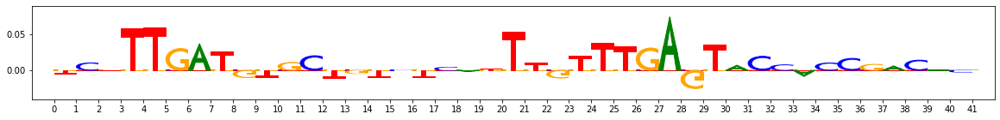

index 75312 example:672,start:473,end:514,rc:False
Features: [-3.60591171e-03 -1.00474957e-02 -1.67538453e-03  1.77258423e-02
 -4.25971856e-04 -1.33758123e-02  1.34812610e-02 -5.88810435e-03
  1.61008068e-03  1.41459852e-02  1.15386764e-01  1.05220089e-01
  1.42678384e-01  1.67608594e-01  1.25226153e-01  1.07684791e-01
  1.41317507e-01  1.17022436e-01  1.03734949e-01  6.69066754e-02
  1.46158588e-01  1.35294045e-01  1.61562066e-01  1.28530260e-01
  1.58146278e-01  1.43220806e-01  1.75572525e-01  1.36303713e-01
  1.68710349e-01  1.54812080e-01  2.31793652e-02  3.60860808e-02
  1.97547117e-02  3.21326125e-02  3.13830947e-02  3.40375783e-02
  1.20777202e-02  3.40880334e-02  1.88194392e-02  2.15226050e-02
  5.45036391e-02  7.94182130e-02  3.60108210e-02  6.55792443e-02
  3.84509676e-02  5.95054897e-02  1.56626935e-02  7.05251490e-02
  6.98885330e-02  6.24448298e-02  2.39986144e-02  9.87840425e-02
  8.92079439e-03  1.11634840e-02  8.56205785e-02  6.38622682e-02
  2.12017701e-02  1.94572810e

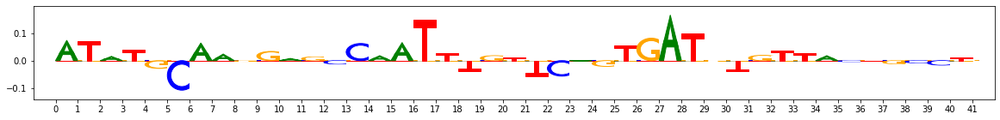

index 76737 example:15,start:427,end:468,rc:False
Features: [ 0.04220099  0.04486826  0.04948267  0.04115534  0.03503046  0.04346959
  0.08059204  0.04157538  0.07402147  0.12844748  0.02570274  0.02055069
  0.03749767  0.03017431  0.02522623  0.02685646  0.03145345  0.05432378
  0.02661012  0.0235694   0.14250799  0.18377496  0.14693556  0.12366237
  0.18421028  0.13609495  0.21054689  0.15552135  0.16254372  0.15583198
  0.02648961  0.04031489  0.03330301  0.03952258  0.03727614  0.05214448
  0.03914231  0.04842267  0.02956844  0.04327509  0.14487835  0.15158375
  0.07385066  0.13895216  0.04918626  0.1069982   0.04329368  0.13134858
  0.09516243  0.14215494  0.0088873   0.00821723  0.00076961  0.0021911
  0.00614628  0.07991749 -0.00194073  0.02013317  0.01284058  0.00826182
  0.46913414  0.47584243  0.37748664  0.28620632  0.4762239   0.49626211
  0.42956749  0.52151249  0.52208172  0.46500645  0.04027915  0.03963667
  0.02016049  0.04202577  0.07762568  0.05587335  0.0660612   0.0

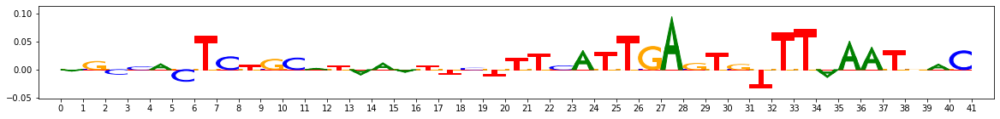

index 78162 example:375,start:481,end:522,rc:True
Features: [ 7.32537927e-02  6.68094316e-02  6.83463180e-02  6.83580755e-02
  5.85146695e-02  6.77393378e-02  8.49733465e-02  6.59328977e-02
  9.72363044e-02  8.42228912e-02  1.57147064e-01  1.52969220e-01
  1.59365905e-01  1.05890567e-01  1.46925326e-01  1.44804945e-01
  1.35851081e-01  8.67807425e-02  1.18808411e-01  1.58416205e-01
  1.55021400e-01  1.55095971e-01  1.54916056e-01  1.31634081e-01
  1.40943648e-01  1.55915868e-01  2.05276240e-01  1.58599875e-01
  1.56495047e-01  1.51425206e-01  3.81735423e-02  5.55914567e-02
  7.55919778e-02  3.73426656e-02  5.11684641e-02  6.63797462e-02
  5.42553429e-02  5.99096880e-02  5.69657864e-02  3.45727343e-02
 -1.76489794e-03  5.82855012e-02 -1.12808077e-02  8.95883401e-03
 -9.79901255e-03  3.55498841e-02 -2.69533501e-02  1.72077490e-02
  1.20031651e-02  2.95544752e-02 -1.43668892e-02 -2.77287356e-02
 -4.24281885e-02 -2.62931654e-02 -3.40738332e-02 -8.67202579e-03
 -2.71270838e-02 -1.04152912e-

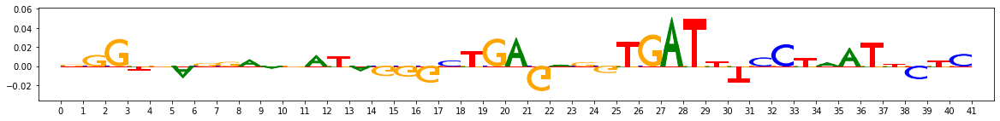

index 79587 example:463,start:613,end:654,rc:False
Features: [ 0.02866266  0.02798063  0.03603454  0.01432933  0.02290129  0.02042435
  0.03288517  0.02093371  0.04535913  0.09960162  0.0794134   0.09903901
  0.10409524  0.10702954  0.09877172  0.06919922  0.09279806  0.07612882
  0.05681353  0.0568044   0.09517352  0.07488501  0.06969353  0.06953446
  0.06462955  0.09412713  0.09341855  0.06593917  0.08233568  0.07656743
  0.0437331   0.05899253  0.04978441  0.03970316  0.03772087  0.08468774
  0.03399316  0.04886732  0.03487474  0.0498136   0.03700475  0.06539159
  0.01816945  0.01066686  0.02295215  0.06841714  0.00808361  0.06215827
  0.01882334  0.07323327  0.01233193  0.01583408 -0.0349221  -0.04433092
  0.06615333  0.00768129 -0.02960118  0.11135373  0.02587702 -0.02678922
  0.40783003  0.46828042  0.40290699  0.19968124  0.55915651  0.43330478
  0.45012359  0.43782482  0.47452821  0.42953053  0.02273587  0.01427113
  0.04276386  0.05081458  0.00623818 -0.01354243  0.03797571 -0

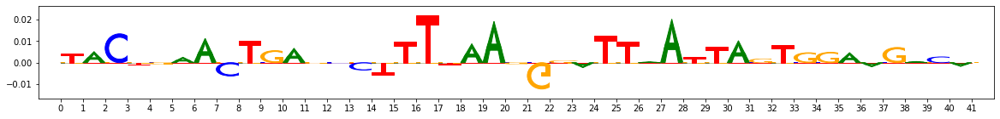

index 96368 example:751,start:490,end:531,rc:True
Features: [ 4.46942304e-02  4.06778593e-02  3.71251139e-02  5.98731050e-02
  4.15392764e-02  3.24161566e-02  6.65481718e-02  3.73741532e-02
  5.62744008e-02  5.72935465e-02  3.45700584e-02  2.16731577e-02
  3.88754299e-02  3.13291524e-02  1.81822486e-02  4.67432878e-02
  3.77712693e-02  6.95881994e-02  3.89016454e-02  2.98086492e-02
  1.27568065e-01  1.44598166e-01  1.35410467e-01  1.11049175e-01
  1.49699059e-01  1.21031494e-01  2.09985382e-01  1.35973775e-01
  1.30560459e-01  1.39106525e-01  2.42862224e-03  1.27239618e-02
  1.07632407e-03  1.83562557e-02  2.96860442e-02  6.34728179e-03
  1.84140799e-02  2.89523758e-02  8.06660274e-03  1.19974712e-02
  1.32194360e-01  1.08653191e-01  3.54972219e-02  1.25313293e-01
  2.16253603e-02  7.18165591e-02  2.99176187e-02  9.54964173e-02
  6.30175566e-02  1.32655918e-01 -1.92928219e-03 -1.26287035e-02
 -1.38481320e-02 -1.37131131e-02 -2.73902833e-02  2.28725857e-03
 -2.13735605e-02 -1.74107588e-

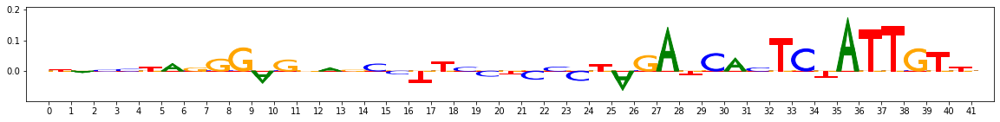

-------------------------------------------------------
PATTERNIDX 7 numseqlets 245


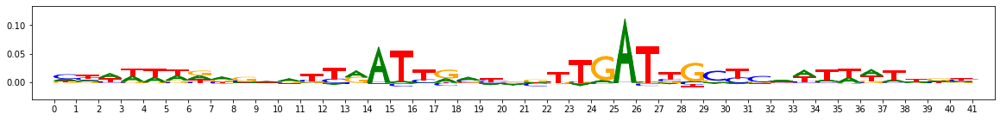

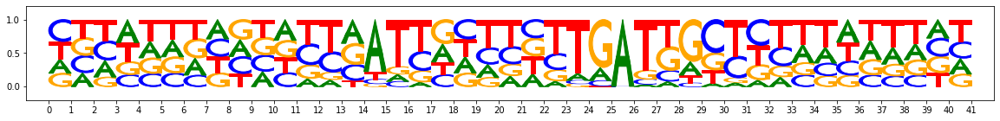

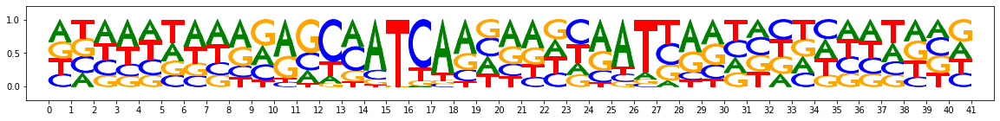

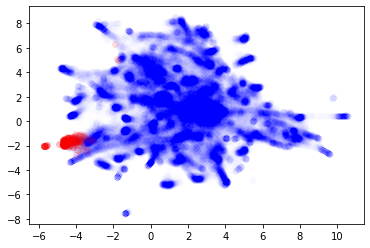

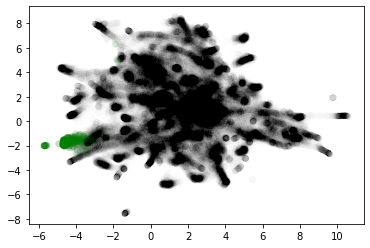

Chosen threshold: 0.9917298538966746 Precision: 0.4918918918918919 Recall: 0.7


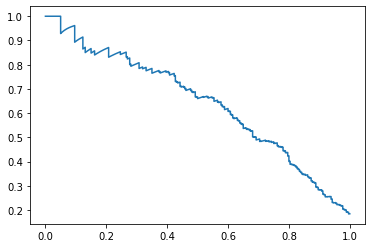

AuPRC: 0.6430370478085827
Reconstructed motif using threshold - numseqlets 349


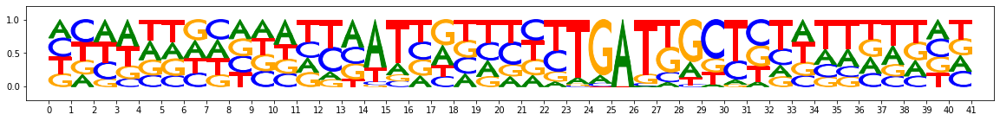

Reconstructed motif using argmax - numseqlets 1602


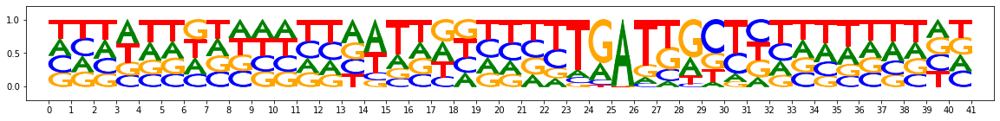

Sample false positive seqlets:
index 15 example:75,start:464,end:505,rc:True
Features: [ 1.28684915e-01  1.37925556e-01  1.22690004e-01  1.19592307e-01
  9.49659151e-02  1.58983011e-01  1.18738284e-01  1.16098331e-01
  1.27386658e-01  1.09231203e-01  4.10913958e-02  2.50411987e-02
  2.55006620e-02  3.68106623e-02  1.84467301e-02  3.38457080e-02
  2.92856434e-02  1.36133649e-01  4.25289922e-02  3.08396115e-02
  3.80618742e-02  5.29385835e-02  4.41784097e-02  3.90420390e-02
  2.78007138e-02  1.69994811e-02  7.97794133e-02  1.64252154e-02
  1.25099203e-02  6.67149178e-02 -1.55372378e-04  1.93819098e-03
  7.16651940e-03  4.15320103e-03  1.29640906e-02  8.83806838e-03
  2.29787009e-03  1.43217962e-02 -1.85230026e-03  2.21227574e-02
  1.04183115e-01  6.46971506e-02  1.27712345e-01  1.44665724e-01
  1.07116136e-01  7.27878733e-02  1.31205178e-01  7.13964963e-02
  1.56494223e-01  1.00602769e-01  2.34973082e-01  2.23859578e-01
  2.66353030e-01  2.22411997e-01  1.87787690e-01  2.14602886e-01
  3

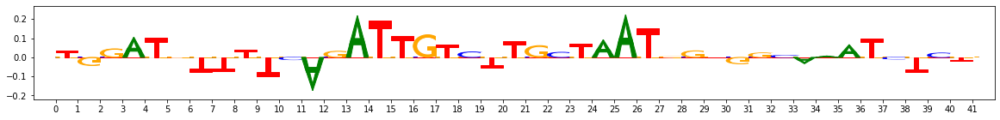

index 40526 example:762,start:502,end:543,rc:True
Features: [0.12674894 0.12212557 0.12937489 0.12230986 0.12846    0.16070174
 0.16050079 0.13005742 0.13841687 0.11152761 0.11100059 0.10048704
 0.13627665 0.10169555 0.09048853 0.1071272  0.13867496 0.20035071
 0.10708776 0.08974372 0.05136366 0.05162975 0.04446959 0.04864555
 0.04260807 0.03929769 0.06650063 0.04673647 0.0304082  0.05458134
 0.04304644 0.04878673 0.04296693 0.04464201 0.05238949 0.04621432
 0.03471357 0.04895909 0.02865809 0.06653817 0.09442581 0.12366043
 0.07471617 0.13020552 0.03855299 0.06853134 0.05725138 0.07209378
 0.06495465 0.08282448 0.2791814  0.28744891 0.27513538 0.24017298
 0.28468813 0.25524748 0.27569202 0.24672577 0.19658077 0.28006043
 0.07567132 0.0562509  0.06463163 0.05290794 0.06191779 0.05941732
 0.04497498 0.07604267 0.05076349 0.06071606 0.396895   0.35062967
 0.41153198 0.2112148  0.34774692 0.39885222 0.38150074 0.44515247
 0.40975186 0.21846736 0.1482946  0.22106231 0.19085596 0.14196652
 0

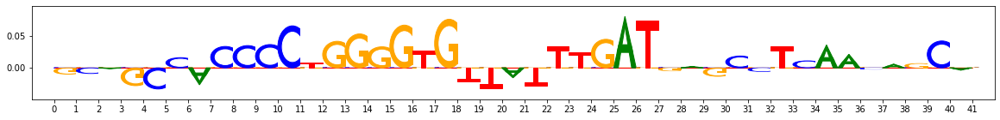

index 63659 example:853,start:524,end:565,rc:False
Features: [ 5.53580432e-02  5.85918234e-02  4.18970545e-02  6.35775267e-02
  4.98065103e-02  7.68404898e-02  6.37676213e-02  4.15142180e-02
  5.88902391e-02  5.48162700e-02  3.25480628e-02  2.29326707e-02
  2.97903047e-02  2.98852578e-02  2.96924765e-02  5.35465642e-02
  1.96685961e-02  1.07759967e-01  3.66781271e-02  3.85173581e-02
  9.60436730e-02  1.26535847e-01  8.75785889e-02  9.69480911e-02
  1.01420132e-01  9.95495934e-02  1.37296230e-01  1.18281008e-01
  9.69848267e-02  1.22591556e-01  7.61499733e-02  8.07706303e-02
  9.31191008e-02  9.33117328e-02  1.40754521e-01  1.03700020e-01
  1.06842265e-01  1.23789808e-01  8.29112168e-02  1.24089351e-01
  9.95314429e-02  1.21681502e-01  9.94695631e-02  1.64142622e-01
  4.82132366e-02  8.32165408e-02  9.08419074e-02  9.30958145e-02
  1.03742487e-01  9.61509609e-02  2.14956092e-01  2.13129122e-01
  2.59022918e-01  2.17232035e-01  1.79294431e-01  2.47975245e-01
  2.43692728e-01  1.53452935e

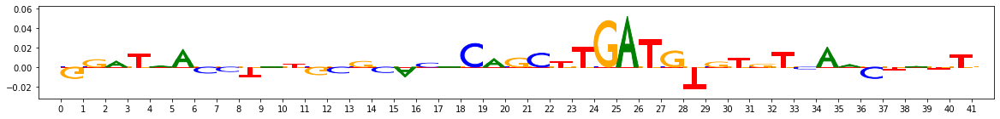

index 75856 example:653,start:474,end:515,rc:False
Features: [ 1.66267842e-01  1.51226014e-01  1.67651739e-01  1.47121500e-01
  1.19403986e-01  1.85114611e-01  1.77522735e-01  1.47396916e-01
  1.72303042e-01  1.32469052e-01  1.27743603e-01  1.23881863e-01
  1.32442866e-01  1.06574978e-01  8.66216078e-02  1.64714946e-01
  1.14588718e-01  1.43279036e-01  1.46493976e-01  1.30791103e-01
  2.81070662e-02  1.13182427e-02  8.38193109e-03  2.83945255e-02
  3.62664421e-02  5.27633764e-03  3.17701802e-02  6.00380325e-03
  4.51835194e-03  4.01826127e-02  2.41323921e-03  8.97416384e-03
  6.09473682e-03 -5.89320992e-03 -5.90485744e-03  2.25148913e-02
  4.57557656e-03  1.67599324e-04 -6.40007772e-03 -7.39502758e-04
  4.96638254e-02  5.57139027e-02  9.58043763e-02  9.02560049e-02
  5.05516746e-02  3.91497906e-02  7.10554020e-02  5.15583189e-02
  1.01738268e-01  6.02478752e-02  1.27911489e-01  1.42151379e-01
  1.80510102e-01  1.47364112e-01  1.29573409e-01  1.55272435e-01
  1.97785442e-01  9.48966662e

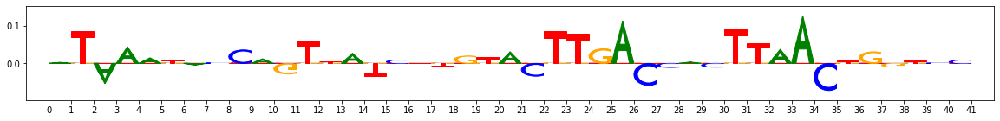

index 83023 example:576,start:527,end:568,rc:False
Features: [0.16475358 0.17801344 0.15558495 0.13339787 0.14677437 0.16455978
 0.17410026 0.15868146 0.18416223 0.15704929 0.10240607 0.07483123
 0.12003706 0.10793913 0.06029597 0.10114868 0.1244697  0.13442092
 0.10030205 0.05036507 0.02473971 0.04494213 0.02519374 0.02267333
 0.04764819 0.02713822 0.06990506 0.03300318 0.03140466 0.0712615
 0.03299926 0.05273661 0.0292338  0.0292558  0.06353325 0.06202363
 0.03601192 0.0468973  0.02791917 0.06634922 0.06335037 0.04638572
 0.08314932 0.07279084 0.02798906 0.12363763 0.06263976 0.05762284
 0.05247534 0.05466458 0.07312523 0.0811481  0.04323414 0.0495831
 0.09648503 0.02893931 0.10157755 0.103268   0.07357913 0.06559409
 0.03375283 0.04152834 0.02695819 0.07185992 0.04948028 0.02543647
 0.03103604 0.06527074 0.03233517 0.03378492 0.15615949 0.32263696
 0.10696413 0.0851795  0.22403522 0.23488538 0.14957323 0.0407786
 0.14970054 0.15302483 0.17143322 0.09576699 0.14992071 0.12717501
 0.1

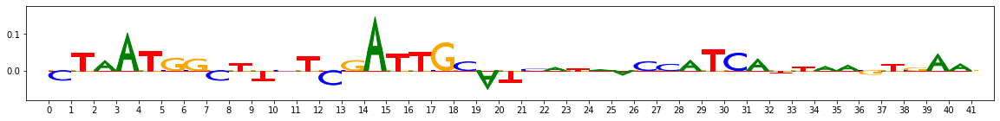

index 105005 example:45,start:479,end:520,rc:False
Features: [ 0.04370826  0.04102197  0.02616658  0.04365128  0.05957073  0.06019055
  0.03221749  0.01545625  0.03332068  0.03039542  0.00599793  0.009129
  0.02774719  0.00689095  0.00262822  0.02513056  0.03501285  0.08068632
 -0.00480117  0.01660618  0.01440985  0.03616439  0.00135918  0.00166147
  0.03028476  0.00562999  0.06842112  0.01410705  0.01794547  0.00573734
  0.02453339  0.03941565  0.03942187  0.03020187  0.03004248  0.03286714
  0.02939146  0.03300033  0.01618927  0.03946904  0.04156657  0.04527375
  0.08630645  0.07360284  0.04483712  0.07065867  0.07720877  0.07142201
  0.06053927  0.04419482  0.33713372  0.30848874  0.32216581  0.2864065
  0.29259782  0.35859846  0.32600594  0.25088023  0.30818368  0.34244149
  0.04000552 -0.0031286   0.02017569  0.11544664  0.00666206  0.04386684
  0.01071345  0.01014158  0.04628765 -0.00147955  0.36070906  0.30033022
  0.36283334  0.18412558  0.25251547  0.28305139  0.37836788  0.22

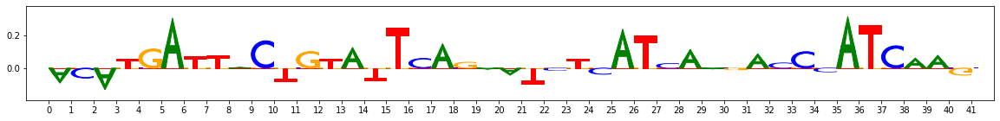

Sample false negative seqlets:
index 13683 example:333,start:502,end:543,rc:False
Features: [0.11080776 0.11729142 0.08708532 0.08308767 0.08800511 0.13488366
 0.11600148 0.08587584 0.11011561 0.08642194 0.12971176 0.09353755
 0.12689292 0.13182879 0.07971677 0.11109786 0.16333742 0.14394463
 0.0994444  0.05367437 0.05655348 0.07009398 0.02991339 0.03991148
 0.05531398 0.04397055 0.04747912 0.03888659 0.02887466 0.04563981
 0.03524771 0.04158772 0.0355566  0.02636194 0.01506895 0.03621305
 0.02071569 0.03096776 0.00954869 0.04323788 0.06678281 0.06195376
 0.08489111 0.09367827 0.04326088 0.04382312 0.08441543 0.04607081
 0.08726168 0.0679112  0.29892899 0.3203827  0.31371798 0.27435382
 0.31827284 0.29177188 0.30180432 0.31137258 0.22722292 0.33715537
 0.0579285  0.01956777 0.05998318 0.12714297 0.01417652 0.03334107
 0.05187366 0.03701692 0.05073223 0.02282801 0.59067253 0.47696574
 0.57599873 0.31411671 0.46021782 0.51041323 0.59591247 0.48800886
 0.71601322 0.23458997 0.17140867 0.2

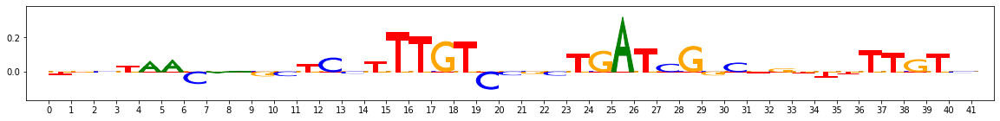

index 81962 example:457,start:461,end:502,rc:True
Features: [ 0.20452282  0.20148023  0.17245015  0.17042049  0.16489081  0.2261879
  0.22511806  0.17053687  0.20588424  0.16756206  0.09155248  0.06526642
  0.13421921  0.08612773  0.06261685  0.10989325  0.14317426  0.1375159
  0.1045568   0.09116511  0.02451229  0.06524607  0.0572972   0.02212188
  0.07071037  0.01855347  0.07870246  0.03383243  0.02982863  0.05313498
  0.00133534  0.01951767  0.02019216  0.01468665  0.01237255  0.02489859
  0.00560538  0.01108148  0.00240578  0.01758968  0.05913234  0.09317249
  0.07178424  0.07785669  0.06455066  0.03767541  0.07125705  0.06370676
  0.09086085  0.06498937  0.22773402  0.2474759   0.25960401  0.21469164
  0.21076888  0.2486886   0.26593432  0.19388502  0.17733439  0.2545251
  0.03535377  0.0088668   0.03447786  0.06891063 -0.00973742  0.04105243
  0.01349948  0.01961819  0.00441065  0.01117159  0.49583047  0.48628387
  0.43885373  0.24216542  0.48685594  0.46778825  0.47248258  0.412

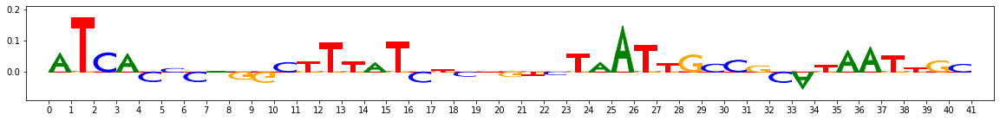

index 83262 example:437,start:510,end:551,rc:False
Features: [ 0.14297284  0.14821781  0.12431233  0.12072239  0.12244017  0.16380858
  0.16745656  0.12427359  0.15092985  0.12426798  0.10499494  0.08435614
  0.15337225  0.08923738  0.07935837  0.12124     0.14755349  0.15083807
  0.09273718  0.09577142  0.04431361  0.07109759  0.03663231  0.03559908
  0.06850623  0.03369011  0.05990105  0.04573698  0.01822905  0.04361048
 -0.00598801 -0.00263089 -0.01403638 -0.00780232  0.00077735 -0.00869926
 -0.0031811  -0.00668696 -0.01538996 -0.00821612  0.08439789  0.0992756
  0.14425026  0.12885362  0.10290596  0.07960264  0.13539823  0.08011411
  0.15224856  0.12180522  0.17596646  0.20588612  0.21838835  0.15901997
  0.18503793  0.26540249  0.2063182   0.16214823  0.14725671  0.20558898
  0.04313496  0.02496064  0.04549217  0.04798869  0.00835349  0.04805164
  0.03472995  0.03543073  0.06397108  0.02871078  0.47392502  0.54966039
  0.40987024  0.20425203  0.54702003  0.52831703  0.58998588  0.

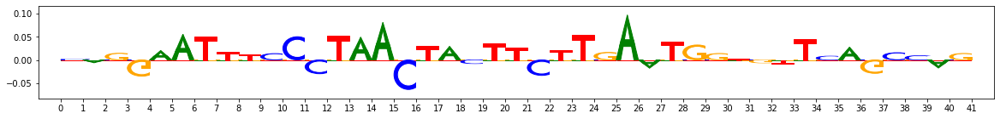

index 84562 example:181,start:326,end:367,rc:False
Features: [ 0.04522521  0.04803237  0.05426121  0.02315616  0.03421635  0.07641109
  0.04195781  0.04988156  0.04771829  0.04076219  0.05031102  0.05729113
  0.06226362  0.0502461   0.04997315  0.05865617  0.06863633  0.15112013
  0.03931539  0.06885673  0.02348509  0.00861995  0.00383431  0.02353309
  0.02459468  0.00982494  0.01409754  0.00290547  0.01078208  0.04895134
  0.00135542  0.01160292  0.01285863  0.00691626  0.0091424   0.00788688
 -0.00142238  0.00289757 -0.00334073  0.01109381  0.04541196  0.05040758
  0.08353386  0.08344069  0.03464959  0.03650382  0.07061916  0.0362564
  0.07755037  0.05648489  0.26684924  0.25505093  0.29749681  0.22530626
  0.25498294  0.24006893  0.31827362  0.20965588  0.25428038  0.29327935
  0.02868869  0.00776458  0.03073294  0.03623569  0.02278552  0.01953509
  0.01072509  0.01933341  0.01246963  0.00891728  0.6653249   0.54040611
  0.67583209  0.42085387  0.5173067   0.55599918  0.59777652  0.

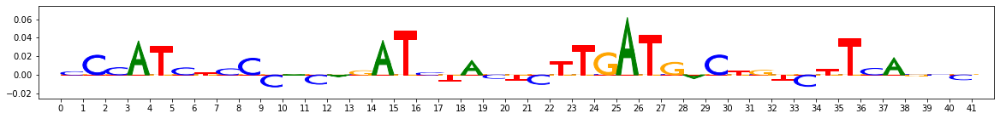

index 85862 example:556,start:388,end:429,rc:False
Features: [ 0.13732352  0.14760979  0.12400322  0.11210486  0.1154658   0.16996301
  0.14240143  0.12497968  0.14485583  0.11723691  0.06639896  0.04754616
  0.09850891  0.05580539  0.03924032  0.07676268  0.10359901  0.08248669
  0.06612878  0.08374911  0.02853025  0.03578145  0.02626799  0.01666462
  0.03516836  0.03438227  0.04548306  0.05225917  0.03518093  0.04054547
  0.0747609   0.06923657  0.07815015  0.08673244  0.13532455  0.09168819
  0.0930017   0.09529992  0.07551755  0.12649215  0.02613796  0.00735079
  0.02321726  0.01249445  0.0386266   0.01475911  0.06509761  0.05041685
  0.03682742  0.0144376   0.37236261  0.34754785  0.41043632  0.38750374
  0.33413733  0.32675591  0.42182971  0.2543814   0.27063467  0.3997577
 -0.0705848  -0.07590562 -0.07035464 -0.03801467 -0.08877473 -0.0780929
 -0.08178395 -0.07143298 -0.09654705 -0.08369029  0.30941755  0.41726607
  0.25289763  0.09987338  0.38229155  0.36565671  0.28938468  0.1

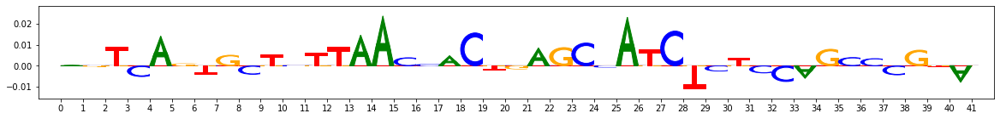

-------------------------------------------------------
PATTERNIDX 8 numseqlets 172


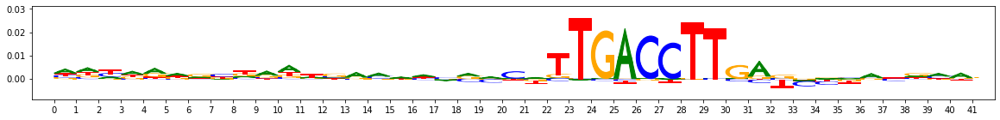

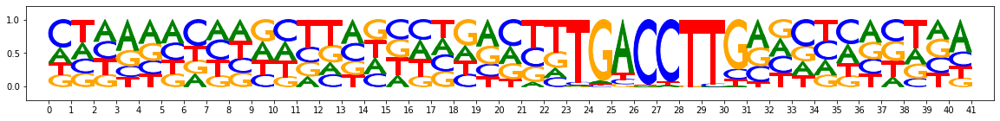

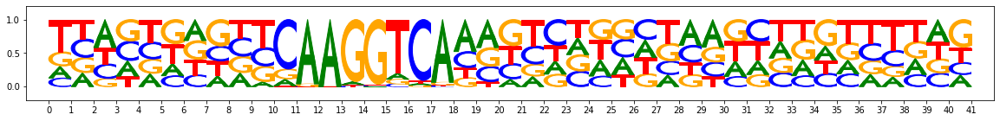

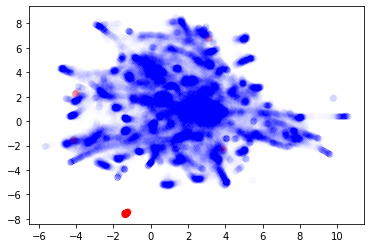

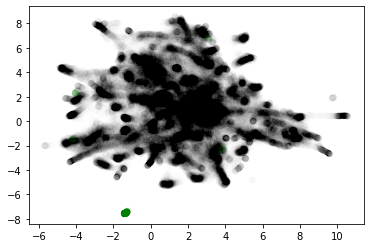

Chosen threshold: 0.9136132729887694 Precision: 0.9027027027027027 Recall: 0.9709302325581395


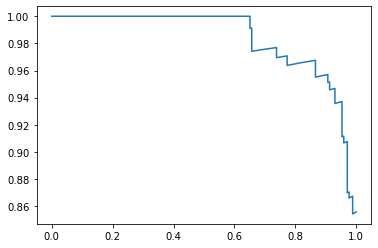

AuPRC: 0.9837098973106607
Reconstructed motif using threshold - numseqlets 185


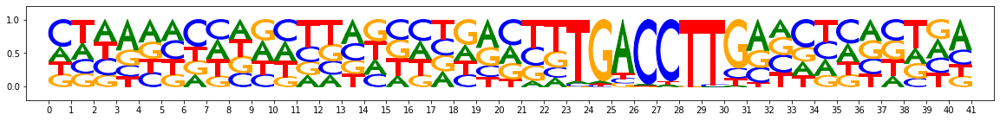

Reconstructed motif using argmax - numseqlets 323


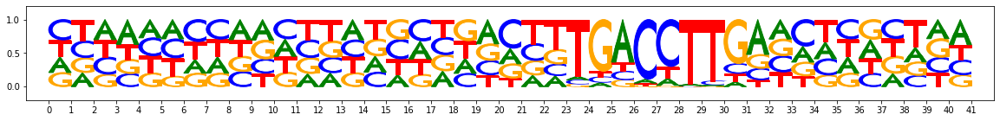

Sample false positive seqlets:
index 1101 example:325,start:516,end:557,rc:False
Features: [0.04505306 0.05842227 0.04010295 0.05941186 0.04524362 0.04252665
 0.05796775 0.02950861 0.04502018 0.02656721 0.20835994 0.21703102
 0.20294775 0.13930657 0.20301614 0.18697422 0.19221856 0.1419909
 0.17863837 0.22804503 0.08221766 0.0830945  0.06872902 0.07892132
 0.0752492  0.061536   0.10343428 0.0712863  0.07114747 0.0733835
 0.02704603 0.04712634 0.03087857 0.02534899 0.04983719 0.05279831
 0.03105533 0.04080776 0.02428043 0.04300918 0.07491893 0.07896645
 0.20775661 0.14709463 0.05662209 0.17043639 0.10545125 0.1271998
 0.13646481 0.08320901 0.06765252 0.07101557 0.06236612 0.05345766
 0.06428455 0.05964269 0.06161873 0.04590702 0.0538723  0.06325355
 0.15623481 0.12187189 0.12261015 0.07975919 0.06013977 0.16889979
 0.11109024 0.10728531 0.11480733 0.11314318 0.17612449 0.12489234
 0.18254118 0.10876422 0.15936466 0.1621027  0.18430304 0.24182708
 0.14334513 0.39962496 0.34820975 0.40054

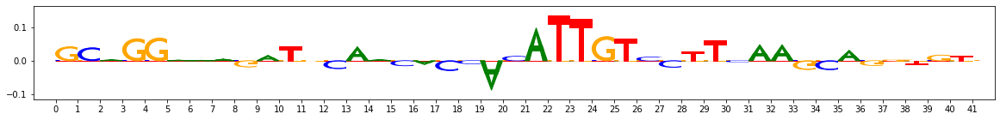

index 18323 example:1044,start:395,end:436,rc:True
Features: [ 0.00799009  0.00342462 -0.01022904  0.00935184 -0.00295633  0.012939
 -0.01112383 -0.01763991 -0.00664335 -0.0046009   0.04452861  0.08417636
  0.04851861  0.02849156  0.06634342  0.03928731  0.05332638  0.07367524
  0.02997619  0.09433573  0.11601452  0.1340108   0.13103488  0.11316102
  0.11504702  0.10495753  0.11583444  0.12761209  0.11521728  0.12804448
  0.0392213   0.05283569  0.04304174  0.04435287  0.08230694  0.04543183
  0.04309257  0.04722528  0.04226402  0.05166347  0.05511506  0.05944923
  0.13389367  0.10617535  0.04617337  0.0642854   0.08764259  0.05247719
  0.10189616  0.06404004  0.12361734  0.12490555  0.1316512   0.10643238
  0.13818286  0.13457686  0.13074344  0.1263674   0.09475782  0.11932183
  0.03539124  0.0117537   0.04158286  0.01371926  0.01345921  0.03065775
  0.04626926  0.00733444  0.0349867   0.01268849  0.37275644  0.26001386
  0.38708894  0.18248393  0.29400065  0.29710331  0.35345876  0.3

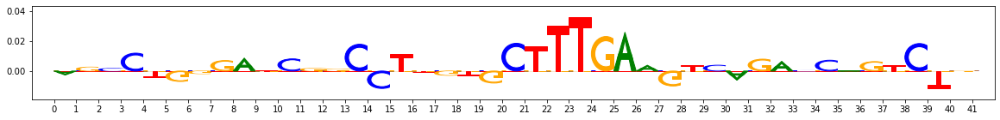

index 47616 example:93,start:711,end:752,rc:False
Features: [0.01630792 0.00987432 0.01186932 0.01533628 0.01459018 0.02267342
 0.02000201 0.00081134 0.01308793 0.01228175 0.06568191 0.02825193
 0.04424886 0.06351602 0.04023463 0.08167044 0.06304949 0.04994058
 0.06445768 0.03386321 0.10045398 0.12813218 0.11668398 0.0821552
 0.10477557 0.08792681 0.10173483 0.12538846 0.10831582 0.11302949
 0.04440123 0.06636433 0.03206312 0.0517134  0.0902407  0.05404512
 0.03469477 0.0531582  0.04207024 0.05622294 0.06952784 0.09023882
 0.12087839 0.07804549 0.07906515 0.09908854 0.0807283  0.07097168
 0.10487347 0.0880475  0.13040373 0.14778939 0.16447777 0.16294974
 0.13966816 0.14672946 0.19074148 0.16318366 0.11442025 0.16341818
 0.05291621 0.04754026 0.06445631 0.05231055 0.03975053 0.0525164
 0.06291833 0.04738393 0.04777519 0.03658693 0.20986827 0.15378829
 0.22336314 0.11685294 0.22092681 0.21100076 0.22835985 0.18369841
 0.1953422  0.34932298 0.32923572 0.29189431 0.32096444 0.09563318
 0.3

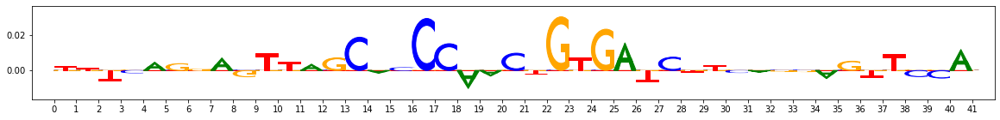

index 71790 example:486,start:544,end:585,rc:False
Features: [0.05955467 0.02256758 0.01715877 0.04101744 0.02634584 0.03858659
 0.0274718  0.02496097 0.02740667 0.03684367 0.04998739 0.04727666
 0.05860636 0.05128635 0.05664096 0.07132345 0.04532179 0.09810812
 0.05803218 0.0507333  0.18440718 0.19940217 0.20946759 0.17322145
 0.15624255 0.18162847 0.19067937 0.20822386 0.17881146 0.22178204
 0.13825055 0.19035237 0.15203251 0.15950194 0.19614073 0.18121132
 0.13651169 0.18768511 0.12713636 0.18010165 0.16809104 0.1681131
 0.20593733 0.21611222 0.14619813 0.17990469 0.18444827 0.15100067
 0.19320635 0.18235761 0.09809968 0.10850837 0.08501133 0.0967454
 0.08936812 0.13468215 0.11719881 0.06950345 0.0462679  0.10754742
 0.06076795 0.06409461 0.03137904 0.06159128 0.04518978 0.02949443
 0.03800179 0.07936514 0.0461007  0.04516723 0.15456545 0.10722883
 0.12555513 0.07989886 0.17607924 0.17766425 0.16001471 0.1662853
 0.12751743 0.3051047  0.24191204 0.23784791 0.25956886 0.15729878
 0.2

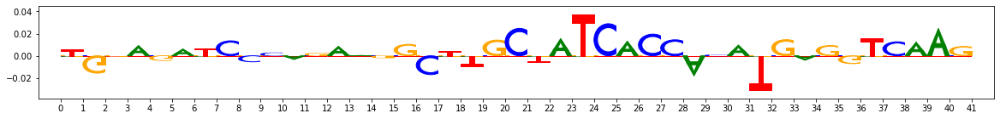

index 87906 example:220,start:414,end:455,rc:False
Features: [0.05935508 0.05899492 0.05690792 0.07856648 0.03926429 0.06027167
 0.06416233 0.05372372 0.07125776 0.05864967 0.01892258 0.00863271
 0.01550608 0.01727393 0.01483943 0.01187833 0.02082042 0.08462231
 0.01554522 0.01361913 0.04080397 0.03566708 0.03766373 0.04083897
 0.06519596 0.0294257  0.04097524 0.03340097 0.03943543 0.02808424
 0.02966163 0.03580197 0.03072548 0.03609537 0.04733402 0.03515709
 0.02483507 0.04535076 0.02916097 0.03836883 0.05050469 0.04841731
 0.13834679 0.06146833 0.03115158 0.25851832 0.02474307 0.08024048
 0.04538267 0.06129655 0.03411013 0.04198836 0.02603916 0.02734634
 0.0164042  0.03518595 0.02464343 0.02772056 0.03296184 0.03042964
 0.15874628 0.13414518 0.19762076 0.13951275 0.14260995 0.16702191
 0.19549962 0.17160677 0.17301865 0.17648462 0.02542591 0.01132854
 0.02933784 0.10313707 0.01513545 0.01404847 0.02078123 0.03514048
 0.03143133 0.3366699  0.41106491 0.15815859 0.28216516 0.12873854
 

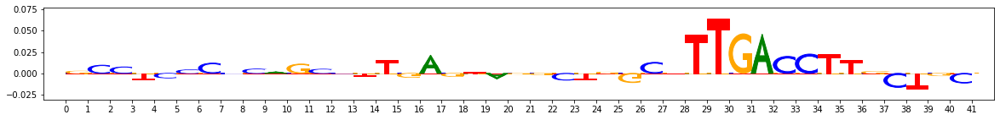

index 102717 example:357,start:346,end:387,rc:False
Features: [ 0.00147486 -0.00593087  0.00438496 -0.0072591  -0.00465493  0.00822908
 -0.01198959 -0.01497224  0.00169004 -0.00566213  0.06267702  0.06431657
  0.02920056  0.05630129  0.09471703  0.04916853  0.04206158  0.05279563
  0.04872861  0.07851582  0.06497197  0.07606256  0.07205126  0.04819563
  0.07630606  0.06352522  0.0639228   0.07351129  0.08669377  0.07772114
  0.04117188  0.04901745  0.02133444  0.03790269  0.06384101  0.03385667
  0.02881536  0.02980258  0.03294886  0.03355906  0.05762721  0.0727701
  0.0897163   0.05795352  0.05049369  0.06316851  0.08728779  0.05545073
  0.0878105   0.09649453  0.17535542  0.1460371   0.17449484  0.13421609
  0.20964526  0.17379975  0.1516475   0.11429794  0.19129995  0.15978499
  0.04152605  0.02915811  0.07966805  0.03254731  0.04356762  0.07484234
  0.0672679   0.03201544  0.07014422  0.0360661   0.13010566  0.12359517
  0.16777423  0.04502861  0.15162225  0.13195762  0.16314838  0

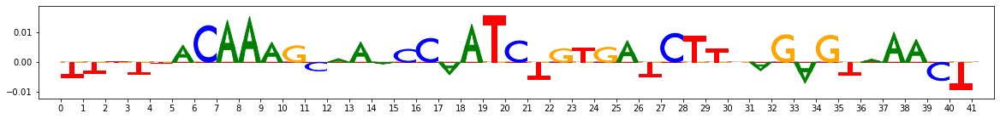

Sample false negative seqlets:
index 86887 example:1017,start:437,end:478,rc:False
Features: [ 7.80678930e-02  6.48616347e-02  7.32099142e-02  5.88342867e-02
  5.27343497e-02  6.94254478e-02  6.47536886e-02  6.10298698e-02
  1.05208543e-01  6.70000137e-02  1.93089068e-01  1.70716502e-01
  1.77630942e-01  1.23801708e-01  1.64594727e-01  1.57184902e-01
  1.77001586e-01  1.37767933e-01  1.64280168e-01  1.85531460e-01
  1.77999050e-02  1.69577384e-02  6.72507559e-03  9.35756536e-04
  6.02678278e-03 -6.64125277e-03  2.29811935e-02 -5.00828723e-04
  9.00145364e-03  2.04248355e-02  4.85971662e-02  6.62468600e-02
  4.69016536e-02  5.11190313e-02  2.62947332e-02  8.33194132e-02
  3.89820342e-02  5.09307156e-02  3.49306329e-02  4.32398508e-02
  7.91158093e-02  1.14141958e-01  1.77560539e-01  1.01175037e-01
  5.80219128e-02  1.55773934e-01  9.79098638e-02  9.03426359e-02
  1.16341191e-01  1.15056630e-01  8.42941424e-02  8.02962872e-02
  7.58758556e-02  7.29062940e-02  7.34315290e-02  8.80437576e-

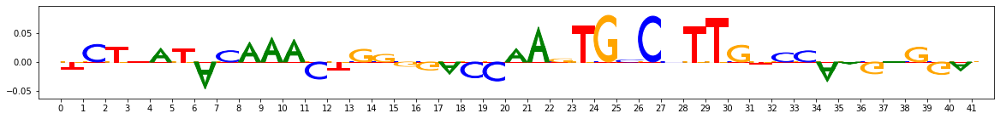

index 87737 example:273,start:539,end:580,rc:False
Features: [ 0.04632376  0.02288357  0.02292335  0.02745152  0.01995135  0.03881993
  0.02353515  0.01908167  0.03687927  0.04321184  0.11547145  0.15617609
  0.13701643  0.10034494  0.15867842  0.12458173  0.14310688  0.07804705
  0.07821313  0.14944298  0.03868296  0.03278187  0.02469639  0.02225101
  0.02612679  0.01342799  0.01587419  0.01356982  0.02755835  0.02437341
  0.04412723  0.06641913  0.06004134  0.04707949  0.0463255   0.06313201
  0.04933857  0.04955066  0.04071183  0.0592407   0.13153194  0.11591319
  0.22970223  0.15951479  0.12528439  0.17151543  0.17033977  0.17710802
  0.16849498  0.14244193  0.20921667  0.22595652  0.22217715  0.17711049
  0.2990171   0.17657996  0.208721    0.26187934  0.20746514  0.19947607
  0.11862247  0.10970019  0.17359052  0.04056424  0.14303112  0.08912187
  0.16024453  0.07070826  0.1411297   0.1112542   0.31160939  0.2557703
  0.2952254   0.15303975  0.31145653  0.34418461  0.32627393  0.

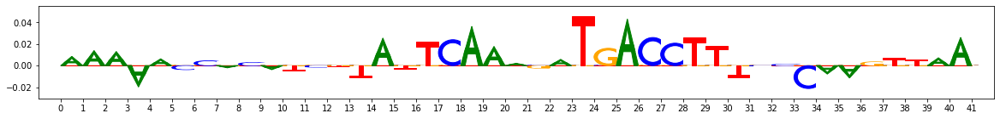

index 88587 example:918,start:561,end:602,rc:False
Features: [ 0.10270325  0.08785457  0.09683796  0.08240806  0.06221127  0.10119294
  0.10562625  0.08541126  0.12479848  0.08509975  0.11733736  0.08284803
  0.13307833  0.11350921  0.07906961  0.12216352  0.11818359  0.10963472
  0.14136595  0.09531155  0.03334332  0.02854831  0.03611414  0.02750594
  0.04385132  0.01169957  0.06057348  0.0086709   0.00599427  0.04660986
 -0.00716549 -0.00109405 -0.0247092   0.00171486  0.01289229  0.00582689
 -0.01535315 -0.01841151 -0.00915108 -0.01003943  0.07346159  0.09557878
  0.17012201  0.12945581  0.04711255  0.1421314   0.09016897  0.07777579
  0.09632922  0.10240452  0.1080566   0.10762758  0.10828899  0.11963564
  0.10649109  0.08931647  0.12562247  0.08797538  0.06514398  0.11453412
  0.08756731  0.07436075  0.12959728  0.06650476  0.05310788  0.11257661
  0.11707143  0.06958704  0.09137339  0.09211696  0.16468315  0.11192849
  0.16611608  0.08394418  0.16575115  0.17319748  0.16595871  0

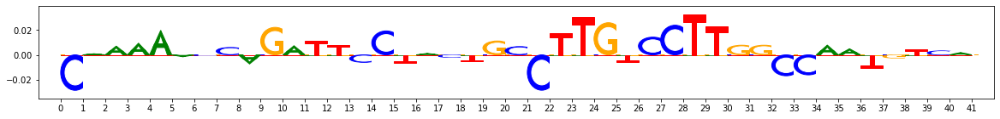

index 89437 example:124,start:172,end:213,rc:False
Features: [0.02968686 0.0242992  0.01501281 0.02039442 0.01609943 0.04100078
 0.01220708 0.01969178 0.03116435 0.0228113  0.00905235 0.00576063
 0.01847257 0.02373252 0.00711367 0.02998414 0.02146695 0.04639652
 0.01969941 0.02645081 0.04466742 0.04428014 0.05400055 0.03545303
 0.05928045 0.02638404 0.04847868 0.04108368 0.04154416 0.05695311
 0.04059851 0.04612989 0.02938095 0.04532391 0.05146167 0.04690416
 0.05334787 0.04738304 0.03700786 0.05456846 0.05910662 0.07460389
 0.1308278  0.09444156 0.05701668 0.11320627 0.09158957 0.12249058
 0.09183634 0.08214584 0.15098728 0.16205525 0.17966118 0.16252076
 0.15980422 0.20955196 0.19615745 0.123022   0.10039341 0.17599709
 0.08383634 0.05025463 0.12840353 0.08707194 0.04987184 0.09362692
 0.10668066 0.06257209 0.12418644 0.06914576 0.21695651 0.15699939
 0.19665386 0.1104902  0.22196164 0.2446292  0.29741311 0.20450465
 0.17964299 0.47111635 0.47359547 0.33814778 0.44554759 0.16059917
 

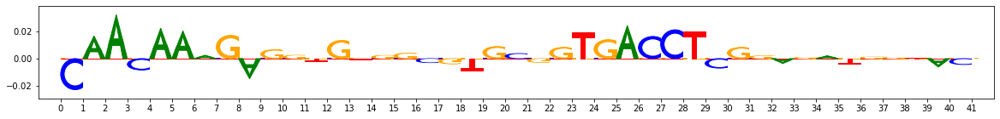

index 90287 example:196,start:200,end:241,rc:False
Features: [ 0.00303227  0.00898452  0.00829004  0.0045973   0.00572623  0.00761559
 -0.00471228 -0.00792212  0.00789882 -0.00110291  0.01662532  0.00741896
  0.01705973  0.01589207  0.01050158  0.02619665  0.0168499   0.02725637
  0.00149758  0.02325338  0.00497088  0.01725181 -0.001876   -0.00437606
  0.00533971 -0.00743753  0.003353   -0.00089058  0.01457082 -0.00351533
  0.0222133   0.03111555  0.01465697  0.0175299   0.02245366  0.02369966
  0.01717714  0.02523373  0.01256757  0.028632    0.005912    0.04517692
  0.16966731  0.06585208  0.00288927  0.23618216  0.03632438  0.0709265
  0.05483085  0.0491146   0.10810396  0.10618768  0.08164711  0.09501814
  0.10329601  0.09944446  0.10247644  0.08555765  0.07114857  0.11269002
  0.0816129   0.06197421  0.13087772  0.07366278  0.06131605  0.09613116
  0.1188801   0.0680073   0.0952865   0.09146312  0.11987144  0.08172243
  0.1460457   0.10577206  0.11533978  0.12247545  0.13336472  0.

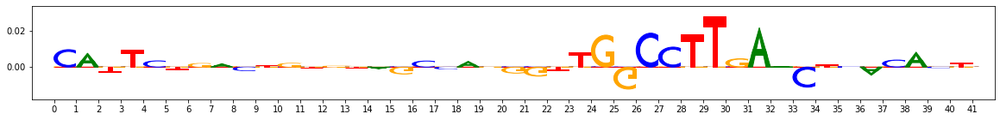

index 91137 example:425,start:304,end:345,rc:False
Features: [ 2.26036204e-04 -9.17306889e-03 -1.14479703e-03 -9.24908377e-03
 -6.16168651e-03  1.54651660e-02 -1.58050328e-02 -6.27544008e-03
 -2.43661199e-03 -4.04705584e-03 -2.30724223e-02 -2.70169394e-02
 -2.23749948e-02 -1.46070218e-02 -3.53944904e-02 -2.38766033e-02
  4.46964883e-04 -2.27264630e-03 -2.02798664e-02 -8.45799431e-03
  2.36331841e-02  2.26372574e-02  1.66839096e-02  1.30329214e-02
  4.40933716e-03  1.76631496e-02 -1.13810591e-02  2.24535479e-02
  3.50024405e-02  2.27929622e-02  3.85835968e-02  2.96960913e-02
  2.28729177e-02  3.99298993e-02  4.64877368e-02  2.33913819e-02
  2.40949714e-02  4.34427164e-02  3.55109919e-02  4.29429048e-02
  3.01586351e-02  3.49078984e-02  1.35723369e-01  6.72523058e-02
  3.06135798e-02  1.05348024e-01  6.09209178e-02  1.81724161e-02
  4.48500012e-02  4.07325935e-02  1.37174568e-01  1.23008222e-01
  1.58919386e-01  1.66767544e-01  1.39355710e-01  1.18562465e-01
  1.60571835e-01  9.33236473e

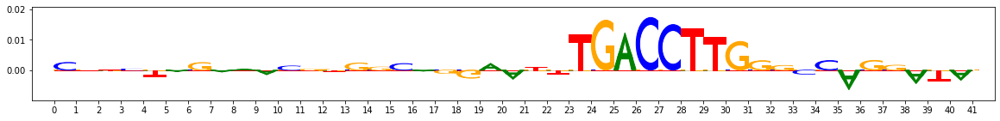

-------------------------------------------------------
PATTERNIDX 9 numseqlets 167


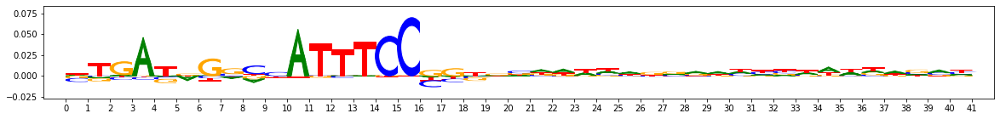

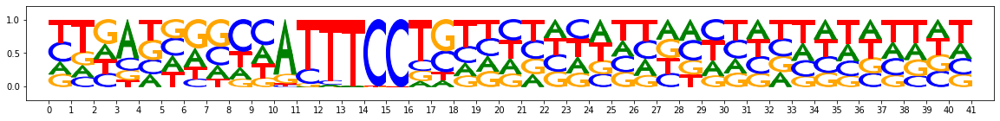

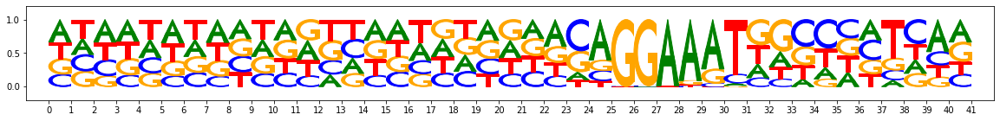

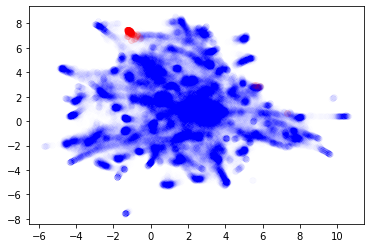

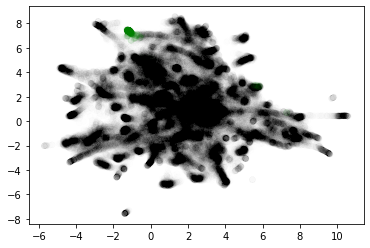

Chosen threshold: 0.9456309330940587 Precision: 0.9016393442622951 Recall: 0.9763313609467456


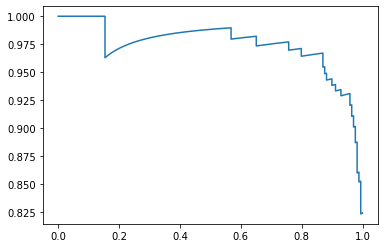

AuPRC: 0.9741844360861549
Reconstructed motif using threshold - numseqlets 181


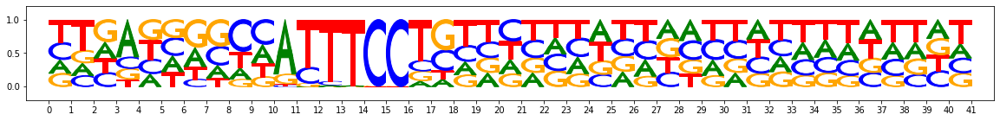

Reconstructed motif using argmax - numseqlets 351


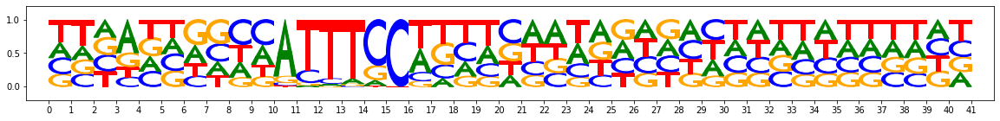

Sample false positive seqlets:
index 4403 example:716,start:505,end:546,rc:False
Features: [0.09534189 0.08008089 0.08196151 0.07537013 0.06840078 0.094095
 0.09794416 0.07160643 0.10458697 0.10933803 0.12425506 0.09096513
 0.14028014 0.13222346 0.09693366 0.14771875 0.1323719  0.08906046
 0.11314752 0.08279736 0.02315919 0.02320576 0.06340298 0.00298076
 0.03775391 0.00836419 0.02973238 0.02463944 0.03554258 0.01331993
 0.02102689 0.03127085 0.02600005 0.01315155 0.03665586 0.04811236
 0.02888644 0.03445349 0.01884073 0.04451984 0.09565274 0.13219741
 0.15114996 0.12056146 0.10494836 0.09348002 0.13189436 0.06882596
 0.20632471 0.12262174 0.0640321  0.06382349 0.05592302 0.05294459
 0.08560374 0.07205712 0.07006779 0.07950209 0.0615597  0.05135994
 0.05904584 0.07061932 0.04672439 0.05115141 0.08711649 0.04009693
 0.05694442 0.02889816 0.05372465 0.03427427 0.12760486 0.11199934
 0.10122187 0.05781116 0.15525814 0.13807714 0.09693215 0.12839876
 0.13162414 0.11333491 0.08328625 0.1160

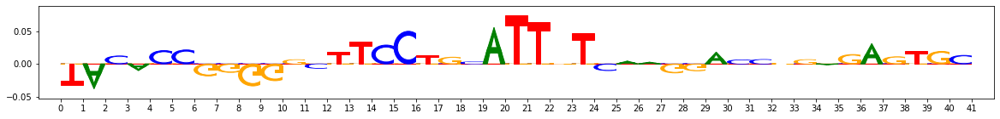

index 25463 example:794,start:541,end:582,rc:True
Features: [0.31662496 0.22467932 0.24366455 0.25202465 0.18136814 0.25853882
 0.29634451 0.23215505 0.2980436  0.2571597  0.10517657 0.10376637
 0.14365581 0.10717994 0.08924595 0.11271702 0.15250269 0.12579149
 0.13753088 0.13303069 0.07315388 0.09046935 0.1463575  0.07766988
 0.10409101 0.06425071 0.1068364  0.08677818 0.09974566 0.09895823
 0.03075258 0.06641842 0.0463375  0.02619645 0.04229522 0.10775115
 0.01547924 0.04183538 0.01975777 0.04163838 0.22041803 0.20543827
 0.19579194 0.22579045 0.14525236 0.20751156 0.19589521 0.18830944
 0.25809502 0.26199907 0.04415608 0.05926047 0.04851552 0.04274079
 0.06083037 0.06078978 0.04325894 0.05029147 0.06241871 0.04963818
 0.06053435 0.08151581 0.06979864 0.05913177 0.03233578 0.03640587
 0.07535147 0.06776912 0.0234198  0.04347632 0.03622402 0.08909918
 0.02870074 0.03625147 0.06110696 0.07345116 0.02053773 0.02961144
 0.03881567 0.08232468 0.06687051 0.10262756 0.09282884 0.16811439
 0

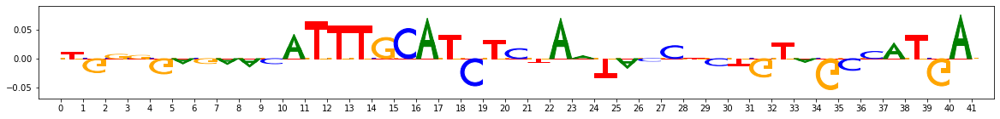

index 31936 example:476,start:571,end:612,rc:False
Features: [0.31313088 0.27511672 0.306548   0.27207413 0.21419667 0.3216142
 0.32586778 0.29203883 0.37970618 0.30103005 0.10622477 0.06667737
 0.10532808 0.10225841 0.06591561 0.11852412 0.13226096 0.16839107
 0.1315498  0.09091689 0.14896379 0.20492537 0.17514111 0.16099611
 0.21772658 0.15162123 0.20514089 0.18132104 0.19994642 0.20418687
 0.09054121 0.09931754 0.09842717 0.09432784 0.12973493 0.16671756
 0.08052508 0.12157052 0.08621434 0.11457017 0.01759385 0.05498091
 0.01286311 0.01049149 0.01999125 0.00128207 0.01746801 0.03349039
 0.05175241 0.06199158 0.03793454 0.04043278 0.05876173 0.04247856
 0.04288203 0.03996575 0.05767908 0.03201435 0.06283165 0.05646662
 0.03592609 0.06172442 0.04057338 0.04979062 0.0281914  0.01403403
 0.03509858 0.06232594 0.02357437 0.0164878  0.06364706 0.13075897
 0.05892759 0.15549183 0.09719494 0.09777544 0.05592223 0.05041945
 0.09144223 0.01522586 0.01561448 0.063301   0.04037759 0.17032899
 0

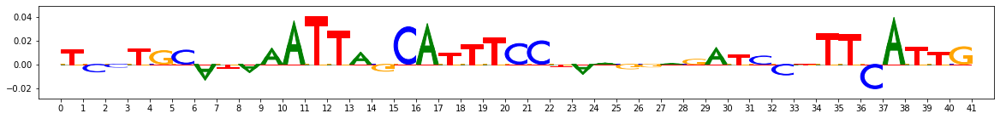

index 37411 example:813,start:609,end:650,rc:False
Features: [0.35880977 0.33714968 0.33258876 0.32413878 0.27470164 0.36507611
 0.39798022 0.32207345 0.36760619 0.32571265 0.15812359 0.13807198
 0.16977791 0.12190582 0.12394841 0.14454625 0.2093081  0.13133613
 0.16981174 0.16967886 0.04872863 0.05655293 0.06889183 0.04536882
 0.0580805  0.03949578 0.07468002 0.05425092 0.04295657 0.06242837
 0.02052739 0.0313461  0.02208244 0.02365063 0.03841832 0.05546606
 0.01856046 0.03343826 0.01729324 0.03091801 0.03844955 0.04583555
 0.05602414 0.05286341 0.01919127 0.0634314  0.0368994  0.06003094
 0.04206907 0.05487111 0.04960977 0.04465441 0.07207133 0.03623339
 0.0525639  0.0488768  0.04704236 0.03646583 0.08970287 0.03949276
 0.05597717 0.04441882 0.05578119 0.04922939 0.02144736 0.05832237
 0.05030362 0.05640767 0.03524902 0.06814652 0.04532687 0.11085745
 0.0580809  0.05030115 0.07102362 0.08500013 0.05480684 0.04052582
 0.0628319  0.07740465 0.08048755 0.08351509 0.07379563 0.17127997
 

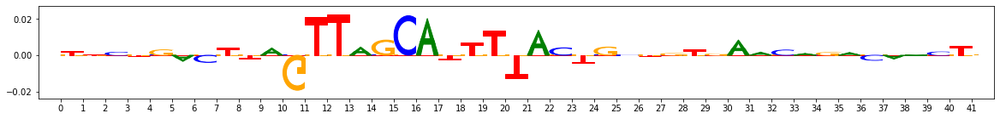

index 50852 example:1033,start:352,end:393,rc:True
Features: [0.05797469 0.04660017 0.07878596 0.04788574 0.04084834 0.0631289
 0.05125983 0.0589525  0.09085738 0.06816032 0.11719913 0.08658768
 0.13499145 0.14322362 0.08969028 0.12706771 0.14951123 0.1072091
 0.12094361 0.05800956 0.03766147 0.03275366 0.04527924 0.02594661
 0.05535242 0.03058922 0.04979257 0.04347715 0.03264127 0.06282828
 0.06048716 0.06698689 0.05778938 0.05156776 0.11093721 0.08990355
 0.07315946 0.08308108 0.05460172 0.09749638 0.01888219 0.04572489
 0.0279399  0.01503611 0.01542179 0.0343367  0.03413001 0.0241883
 0.02978341 0.04991271 0.05018595 0.0612294  0.0422122  0.04437916
 0.07105951 0.0627929  0.04617831 0.09273086 0.03019822 0.0356013
 0.06651699 0.04682028 0.05601157 0.06253013 0.02207758 0.03760416
 0.0631075  0.03465468 0.06606883 0.05077877 0.03863631 0.06971903
 0.05114671 0.06779978 0.06687701 0.05910332 0.05222529 0.04143627
 0.10005147 0.04711374 0.04385771 0.06406275 0.05806196 0.09472467
 0.04

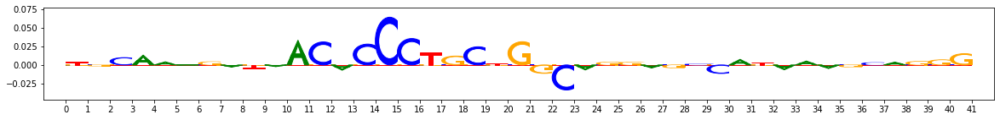

Sample false negative seqlets:
index 41227 example:636,start:577,end:618,rc:False
Features: [ 0.24302147  0.20055052  0.25813426  0.1744843   0.1613643   0.2508813
  0.23895127  0.23134367  0.28058761  0.2419674   0.12754957  0.0734345
  0.12605543  0.15325332  0.07406452  0.10313144  0.12330542  0.07967115
  0.17722641  0.06643137  0.02730838  0.03090337  0.06853037  0.03989067
  0.04424387  0.03387347  0.05806065  0.02881428  0.04368229  0.08096579
  0.0255742   0.0227217   0.00870975  0.01188131 -0.00404855  0.06541953
  0.00892456  0.01549557  0.00491893  0.00991242  0.11079913  0.11953023
  0.08372586  0.09681314  0.07282383  0.07651531  0.05682045  0.09030042
  0.09220789  0.12094913  0.00803038  0.01014634  0.01715318  0.01265211
  0.02485276  0.02337129  0.02299661  0.02223215  0.0200914   0.0131725
  0.05522639  0.06190552  0.05397789  0.07920263  0.07745964  0.0606291
  0.05220054  0.09713256  0.05260171  0.06285394  0.02937817  0.05216585
  0.01859694  0.05791451  0.06254638

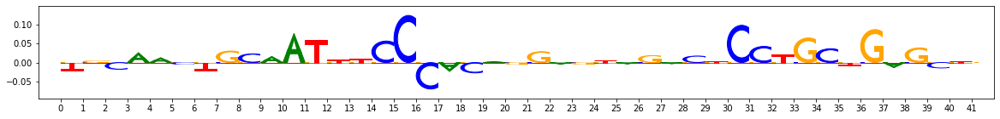

index 91962 example:255,start:475,end:516,rc:False
Features: [ 2.86180232e-01  2.24360423e-01  2.78697254e-01  1.96496799e-01
  1.78933655e-01  3.06968625e-01  2.75946477e-01  2.56510076e-01
  3.15413876e-01  2.48751980e-01  1.18662290e-01  9.99474631e-02
  1.42658003e-01  1.09569992e-01  8.76869595e-02  1.24418494e-01
  1.45212637e-01  1.32766581e-01  1.40058774e-01  1.21912706e-01
  7.30444187e-02  8.07590782e-02  1.10201337e-01  6.73845769e-02
  5.28405121e-02  7.50552675e-02  8.22982701e-02  8.07756148e-02
  7.89714513e-02  1.19037258e-01  1.16306973e-01  1.17974600e-01
  1.21373981e-01  1.15859178e-01  1.08314284e-01  1.54580127e-01
  9.41027768e-02  1.11442288e-01  1.00109815e-01  1.27737750e-01
  1.21504884e-01  1.47848794e-01  1.36181047e-01  1.73917154e-01
  1.01739649e-01  9.95760835e-02  1.18679283e-01  8.96500142e-02
  1.35448834e-01  1.40356041e-01  3.91758709e-01  3.70910638e-01
  4.15893140e-01  3.60975855e-01  3.69182571e-01  3.28287197e-01
  4.96199893e-01  3.07935297e

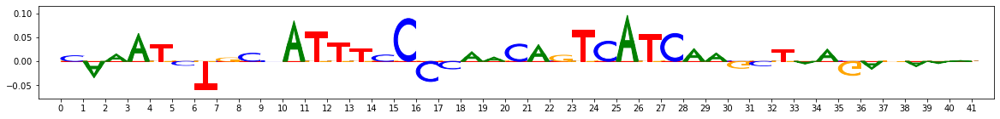

index 92787 example:655,start:584,end:625,rc:False
Features: [ 0.15281045  0.12251041  0.14003763  0.11526513  0.09987041  0.14862966
  0.14697208  0.13203587  0.18025028  0.15264536  0.12471051  0.08294359
  0.17025848  0.12718959  0.09173008  0.14024149  0.15562078  0.10724564
  0.12758294  0.07488509  0.06579266  0.06987931  0.12529644  0.06194019
  0.06254188  0.05759688  0.08034832  0.07039923  0.07542291  0.07488322
  0.07416639  0.09243113  0.07350603  0.08061735  0.0988944   0.11925253
  0.06538375  0.10120737  0.06280404  0.09778494  0.05264761  0.09095326
  0.07237371  0.05228135  0.06491659  0.06686872  0.05577038  0.06706478
  0.08373858  0.10108156  0.07003664  0.08316694  0.04751479  0.04970402
  0.08822936  0.06624085  0.04782505  0.10827602  0.06093352  0.10149095
  0.11505568  0.11896646  0.10187628  0.06125292  0.13773543  0.07563171
  0.1256891   0.07721616  0.12192923  0.07573735  0.05937084  0.08984734
  0.05542964  0.05131221  0.08159388  0.08308576  0.06400919  0

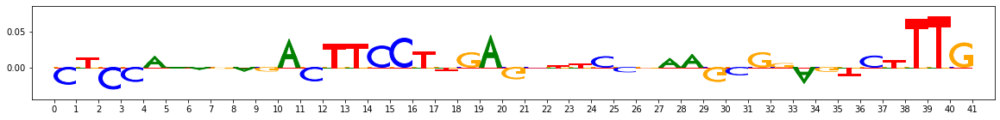

index 93612 example:437,start:560,end:601,rc:False
Features: [0.14787485 0.12066341 0.16223574 0.10785513 0.10680442 0.1574568
 0.15392875 0.14389472 0.17278743 0.14360334 0.14224745 0.08678191
 0.15935018 0.16085461 0.11146944 0.13356979 0.16510118 0.13719209
 0.15730298 0.10020387 0.01825759 0.01812077 0.09551059 0.02291162
 0.03815751 0.0079672  0.03308404 0.00674394 0.01558739 0.0199066
 0.03602685 0.01415876 0.00741891 0.00983569 0.01017196 0.04744486
 0.01146195 0.02253344 0.00682236 0.02453034 0.06681895 0.09307305
 0.05511374 0.04549512 0.03805632 0.06277222 0.03740212 0.03746728
 0.05694344 0.09281899 0.04362647 0.04326282 0.05062694 0.04420956
 0.04394227 0.06135737 0.06602818 0.03940548 0.05444289 0.05251312
 0.03641374 0.06678911 0.03401104 0.06110884 0.05948781 0.04786119
 0.02926333 0.14450161 0.03725826 0.06375351 0.04711305 0.08743256
 0.05233893 0.06661393 0.07252556 0.08030929 0.04466135 0.04993032
 0.06302665 0.05177685 0.04743558 0.05725426 0.05682002 0.10775213
 0.

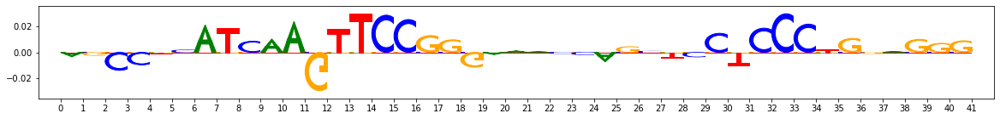

index 94437 example:962,start:440,end:481,rc:False
Features: [ 0.19176277  0.17705457  0.18782141  0.13241651  0.14105362  0.20048249
  0.21866288  0.18990832  0.22277843  0.16646327  0.09600899  0.06105461
  0.12053987  0.09340625  0.06610493  0.08548909  0.11623621  0.12379216
  0.1160524   0.09593354 -0.02677817 -0.03856034 -0.01412756 -0.03118526
 -0.03487698 -0.03705246 -0.01306153 -0.04688548 -0.036284   -0.03254996
 -0.0109194  -0.00188668  0.01828023 -0.02740107 -0.00513088  0.06684663
  0.0155125   0.00769843 -0.01067562  0.01704052  0.14420872  0.10972331
  0.12531763  0.14239221  0.02197847  0.19349044  0.04004131  0.12067816
  0.08957799  0.13040787  0.09153103  0.07134319  0.06879791  0.09859508
  0.05655875  0.06257545  0.11008585  0.05500344  0.09537087  0.11917073
  0.03151488  0.05279859  0.01372731  0.05693424  0.07457179  0.04226445
  0.00955925  0.14054128  0.01295481  0.07343117  0.04841009  0.08902905
  0.04838858  0.05415706  0.04182379  0.08032836  0.03140626  0

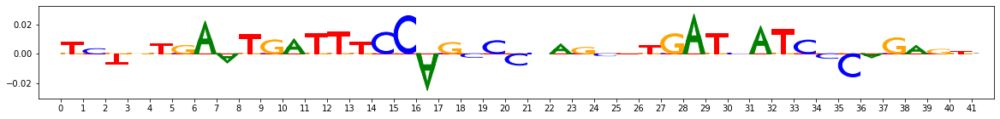

index 95262 example:326,start:354,end:395,rc:False
Features: [ 1.14362651e-01  1.02956386e-01  1.31675655e-01  8.57645709e-02
  8.36018495e-02  1.47190809e-01  1.20470405e-01  1.21319249e-01
  1.57571775e-01  1.15346333e-01  9.32321408e-02  5.84643227e-02
  1.10976202e-01  1.07643655e-01  5.78975893e-02  9.65583656e-02
  1.12426237e-01  1.78649905e-01  1.07787615e-01  5.40331229e-02
  5.65515054e-02  5.39577975e-02  9.74774114e-02  5.56710404e-02
  7.03013588e-02  4.05325937e-02  8.34693622e-02  4.92657943e-02
  5.19069911e-02  6.25584545e-02 -3.49471544e-03 -2.07255933e-03
 -1.76488510e-02  2.97433354e-04  4.83972592e-03  2.64581363e-02
  1.20352647e-03 -4.82834451e-04 -1.09986718e-02  8.79703380e-03
 -9.84815797e-03  3.72900264e-02 -1.46426877e-03 -9.65261273e-04
 -3.75157520e-03  6.82116966e-04 -1.39193553e-02 -5.20450759e-05
  7.08154271e-03  6.43768616e-03  9.51032376e-02  9.14427764e-02
  8.03093757e-02  7.61901057e-02  7.02729236e-02  1.03858645e-01
  9.17828822e-02  7.54868646e

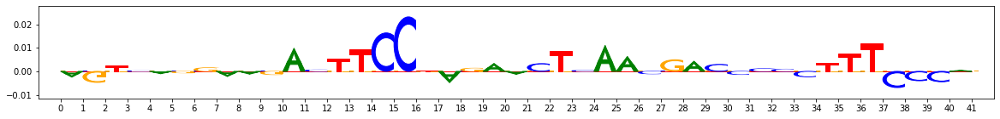

-------------------------------------------------------
PATTERNIDX 10 numseqlets 118


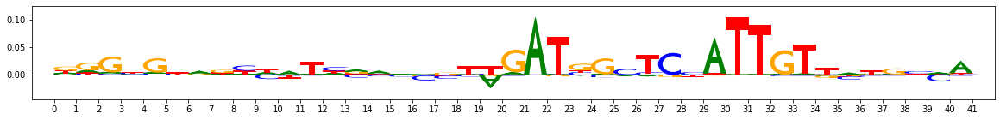

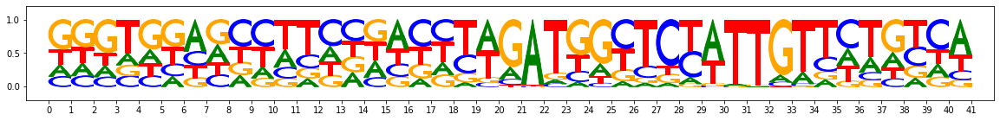

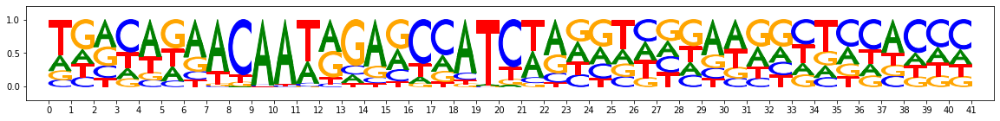

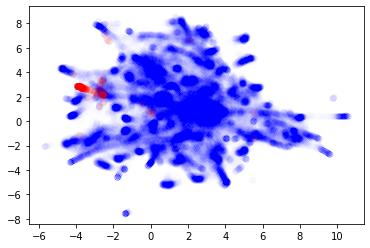

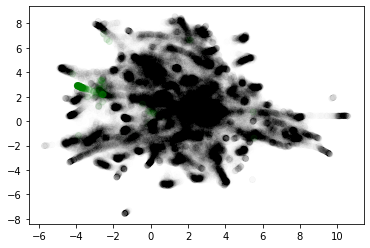

Chosen threshold: 0.9912357078194802 Precision: 0.9032258064516129 Recall: 0.8


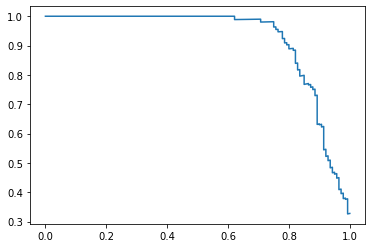

AuPRC: 0.921502062484804
Reconstructed motif using threshold - numseqlets 103


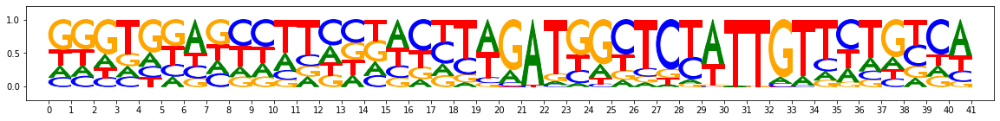

Reconstructed motif using argmax - numseqlets 802


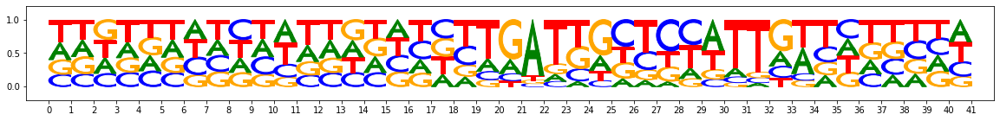

Sample false positive seqlets:
index 0 example:75,start:449,end:490,rc:True
Features: [ 1.75371143e-01  1.69762465e-01  2.11011795e-01  1.39709139e-01
  1.28760461e-01  1.92175981e-01  1.85597013e-01  1.83796673e-01
  2.79658883e-01  1.92037064e-01  1.30095693e-01  9.38943891e-02
  1.06319582e-01  1.18288019e-01  9.14530334e-02  1.67193556e-01
  8.77189246e-02  1.27706320e-01  1.59598579e-01  8.75384173e-02
  6.24540562e-02  9.52458302e-02  5.34893696e-02  5.18206119e-02
  8.14366890e-02  4.94931172e-02  1.19526023e-01  6.28238135e-02
  4.55641282e-02  6.84640841e-02  5.33254865e-02  6.33289462e-02
  6.61823980e-02  5.60699730e-02  4.94134273e-02  1.05186740e-01
  6.11240600e-02  7.39510951e-02  5.03257353e-02  6.14841114e-02
  1.32950026e-02  4.26986137e-02  2.11077767e-02 -1.64241941e-03
  4.22716486e-02  3.32258369e-02  1.33979045e-02  3.30842081e-02
  2.20715447e-02  4.95607430e-02  7.28763481e-03 -2.03412170e-03
  1.43294849e-02  1.77899282e-02 -1.20573411e-02  4.24841221e-02
  3.

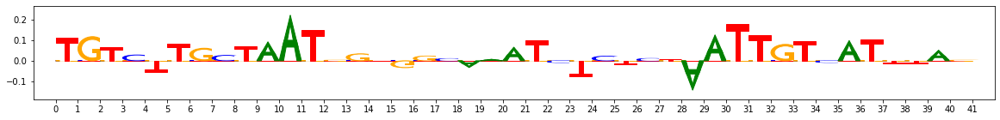

index 57961 example:34,start:482,end:523,rc:True
Features: [0.14550442 0.12728152 0.14088147 0.11333912 0.10241704 0.14203439
 0.14600228 0.12834387 0.16792018 0.12965971 0.11862844 0.20016249
 0.19580834 0.05692406 0.15381055 0.1379099  0.21529359 0.11578588
 0.08591517 0.24254604 0.04938183 0.04362868 0.04038358 0.04845021
 0.04733141 0.03766551 0.06833699 0.06287211 0.04730412 0.05973496
 0.04751436 0.07359747 0.05793414 0.05165133 0.07932094 0.08798141
 0.05658174 0.06467548 0.0514729  0.06868675 0.06300229 0.11326614
 0.07836046 0.08436747 0.05762702 0.05795347 0.07187628 0.07848105
 0.10484414 0.11022713 0.03289814 0.02644248 0.05038079 0.03101197
 0.04666938 0.02406073 0.03006124 0.00496551 0.05973721 0.00850012
 0.05347689 0.00885381 0.05956122 0.04760688 0.0214486  0.06007704
 0.05928725 0.01291327 0.05750259 0.06116731 0.053667   0.08433204
 0.05242996 0.07858422 0.06499563 0.05337139 0.06634641 0.11092308
 0.03569311 0.11273855 0.09303261 0.13261942 0.12145889 0.11724293
 0.

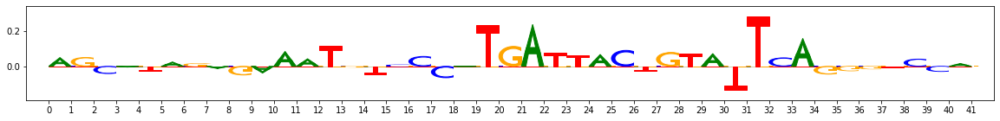

index 63536 example:486,start:518,end:559,rc:True
Features: [ 0.11268604  0.10812156  0.09533638  0.08309813  0.08395572  0.11094434
  0.11786647  0.09331937  0.12424521  0.08736604  0.18526382  0.26651582
  0.21055451  0.1034891   0.18765656  0.1980112   0.21550541  0.12422456
  0.15727647  0.30699288  0.00961835  0.0050317  -0.00040148  0.0034924
  0.01331175 -0.01361605  0.01666416  0.00488392  0.01115292  0.01223821
  0.05890344  0.06098432  0.06289664  0.04661059  0.05196133  0.07411143
  0.05758613  0.06632895  0.05286853  0.05810162  0.06458166  0.06420284
  0.10364754  0.09927434  0.05386488  0.05752355  0.08915271  0.06972222
  0.1021172   0.0822168   0.08750726  0.07942912  0.09466402  0.09590083
  0.07334209  0.07491892  0.11836768  0.03849953  0.07753369  0.08880171
  0.03006158  0.01858335  0.02308745  0.03713314  0.013598    0.03457302
  0.01111079  0.02071848  0.01854027  0.04833498  0.13682808  0.12806113
  0.09504382  0.10092654  0.1484854   0.12875946  0.1280265   0.1

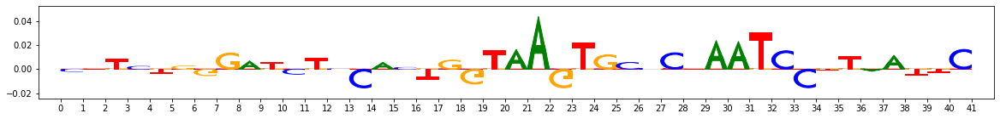

index 76306 example:739,start:356,end:397,rc:True
Features: [ 2.29753213e-02  3.16501643e-02  1.24794207e-02  3.24154193e-02
  2.17673153e-02  2.67386545e-02  2.61144784e-02  2.17440214e-02
  2.35722295e-02 -8.98605834e-04  1.85705056e-01  2.37196514e-01
  2.01204301e-01  1.42804948e-01  2.13309104e-01  2.00856112e-01
  2.08927362e-01  1.43305392e-01  1.65032971e-01  2.21284463e-01
  6.02460961e-02  5.18378922e-02  1.44069277e-01  6.56023809e-02
  5.20483465e-02  4.62061358e-02  7.19351696e-02  7.89524800e-02
  3.88154336e-02  6.74296597e-02  4.49372375e-02  5.06567443e-02
  6.35570387e-02  4.77437594e-02  5.28364717e-02  6.22557295e-02
  5.34299131e-02  6.12688040e-02  4.42571365e-02  6.41890912e-02
  1.74805909e-02  3.67324836e-02  3.16831755e-02  2.94045321e-02
  2.22473247e-02  2.74180245e-02  3.90865210e-02  5.64043624e-02
  6.12780199e-02  3.27044396e-02  1.17117564e-01  1.25686218e-01
  1.19431619e-01  1.19179698e-01  1.25565656e-01  1.09759646e-01
  1.23765670e-01  1.22311904e-

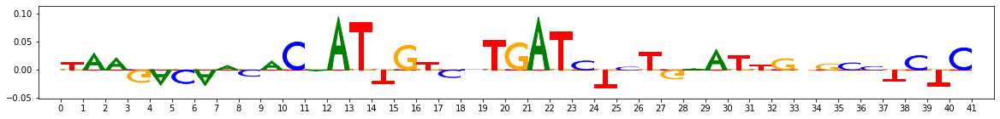

index 82655 example:438,start:577,end:618,rc:False
Features: [ 0.13859511  0.16563206  0.1536475   0.13951146  0.12734709  0.15168859
  0.18724465  0.13488334  0.15676494  0.12069711  0.3073361   0.35905766
  0.27296677  0.23521763  0.29074048  0.24761302  0.27529732  0.17122196
  0.31122909  0.34049608  0.05509642  0.05717148  0.06831424  0.05516433
  0.05613075  0.04515444  0.07566117  0.04258586  0.04024895  0.06854691
  0.01303107  0.01489737  0.02588678  0.01321274  0.01203999  0.0379939
  0.01597392  0.01751441  0.0106376   0.01551186  0.04467761  0.03325823
  0.05562549  0.04626794  0.03937339  0.04338726  0.05668872  0.1057572
  0.07622399  0.06052447  0.0564333   0.05111967  0.05979595  0.03474967
  0.04947158  0.05711356  0.03918953  0.04536459  0.05829292  0.0468192
  0.02760168  0.02783542  0.01696585  0.03370934 -0.00112019  0.02947249
  0.00919714  0.02998688  0.01149597  0.02349787  0.06669606  0.06837832
  0.11601544  0.06331298  0.06047117  0.11264004  0.09682273  0.15

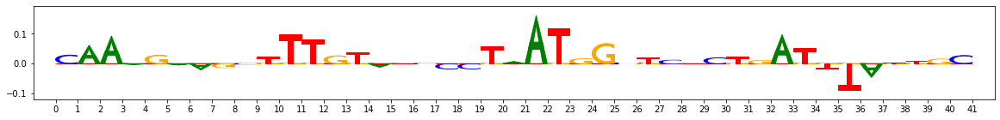

index 104247 example:385,start:558,end:599,rc:False
Features: [ 0.14911617  0.1266541   0.16927878  0.11243228  0.10251484  0.15642332
  0.1434361   0.1449132   0.19731704  0.11066203  0.15287534  0.20476504
  0.16712401  0.08592394  0.19107088  0.17197908  0.1814324   0.12375118
  0.11291078  0.22335311  0.09997187  0.10229997  0.07809062  0.07888916
  0.08152283  0.07419965  0.10335644  0.10658276  0.07665765  0.09018096
  0.04800056  0.06326261  0.05328335  0.05149706  0.07241183  0.08633169
  0.04395285  0.06480802  0.04872306  0.06407796  0.01132265  0.09397893
  0.07548191  0.01845388  0.04632031  0.04236895  0.07056769  0.05219298
  0.09762589  0.08195828  0.11930739  0.07181019  0.11147423  0.08287248
  0.13715166  0.05260005  0.09441752  0.09379735  0.14863229  0.07649208
  0.01174866  0.00115346  0.02928435 -0.00412209 -0.03191716  0.02391644
  0.02691001 -0.01769087 -0.01825803  0.01107219  0.05212662  0.0843956
  0.0751808   0.03721881  0.06443259  0.07334076  0.0390072   0

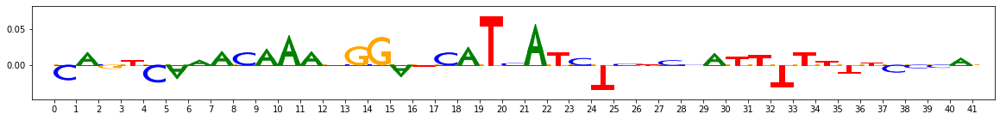

Sample false negative seqlets:
index 13601 example:168,start:490,end:531,rc:False
Features: [ 0.24812579  0.21286304  0.26713586  0.19133242  0.15893713  0.25452189
  0.2507026   0.22556212  0.29255246  0.22686305  0.13607446  0.16066908
  0.14964198  0.08995846  0.11660687  0.17421718  0.15708971  0.13380912
  0.15603741  0.169541    0.03326337  0.02351016  0.01037345  0.02862396
  0.05195501 -0.00182627  0.04731469 -0.00082318  0.02660571  0.02620411
  0.00489332  0.01334672  0.01084052 -0.00109073  0.00142853  0.05824112
  0.00459429  0.01374296 -0.0027863   0.0168575   0.05468851  0.09259294
  0.1183322   0.08461925  0.04916678  0.07619552  0.09108568  0.06926413
  0.11268937  0.09258059  0.09722696  0.08416689  0.0900102   0.08424442
  0.08523031  0.05440369  0.09958091  0.07566495  0.07685684  0.08755405
  0.08139447  0.06561004  0.05551164  0.03753383  0.01877689  0.06551439
  0.04007907  0.04310891  0.03515866  0.04878735  0.14898203  0.13081657
  0.1635525   0.1543633   0.1739

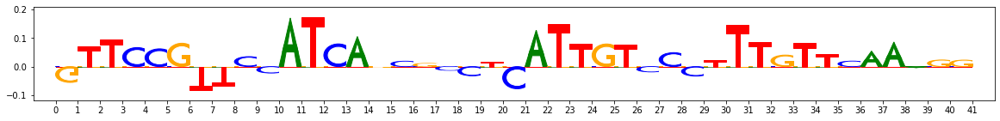

index 95512 example:961,start:478,end:519,rc:False
Features: [ 0.08503255  0.08851494  0.09020655  0.06729802  0.06026861  0.09808249
  0.10979239  0.08128919  0.11713935  0.07835007  0.14505114  0.22510704
  0.15881985  0.06529466  0.14577801  0.19359687  0.19740391  0.10588723
  0.11279226  0.24096746  0.06974691  0.07302335  0.04542124  0.07433755
  0.08926789  0.0579295   0.08616284  0.0579238   0.05558303  0.06537232
  0.03277317  0.04500106  0.04762077  0.03382031  0.04562136  0.06140454
  0.03543566  0.04807485  0.03444441  0.04649714  0.02718464  0.01932242
  0.04761533  0.02582913  0.04969531  0.03809529  0.05079494  0.04683573
  0.04399874  0.03368697  0.12348594  0.10014766  0.11939427  0.11604714
  0.09749973  0.07358721  0.12952901  0.08921832  0.08963789  0.10647668
  0.00183486 -0.01751785 -0.00290352  0.03708637 -0.02817237  0.00645676
 -0.01671434 -0.01401616 -0.01093671  0.00887931  0.07632553  0.083037
  0.091862    0.10738621  0.07449227  0.09804924  0.07546065  0.1

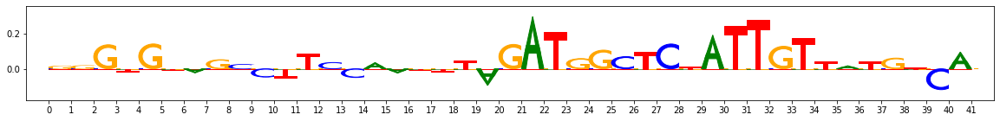

index 96212 example:220,start:476,end:517,rc:False
Features: [ 0.07977153  0.0863147   0.08080891  0.07371268  0.05925458  0.09241246
  0.10594576  0.07463585  0.09842755  0.07496933  0.1601575   0.22996569
  0.168213    0.07166311  0.15352658  0.19702834  0.20402662  0.09539113
  0.12008681  0.23626688  0.07132197  0.06974465  0.04679431  0.07911824
  0.10343536  0.06251004  0.07942276  0.05678592  0.05345876  0.07162851
  0.02742545  0.03365075  0.04632083  0.02896277  0.03594283  0.05347606
  0.03892013  0.04511905  0.0323018   0.04379832  0.02966453  0.02124228
  0.04323847  0.02338966  0.05585641  0.02872395  0.05469467  0.05548582
  0.03914358  0.03283682  0.13576811  0.11338947  0.13893341  0.12807633
  0.11425656  0.09033897  0.1512101   0.10743051  0.10624117  0.11372801
 -0.01783614 -0.02786977 -0.02541369  0.00424756 -0.03798423 -0.01824797
 -0.03689561 -0.01601864 -0.02526035 -0.005262    0.07883409  0.07964008
  0.08933117  0.10730254  0.06503078  0.09316644  0.06514819  0

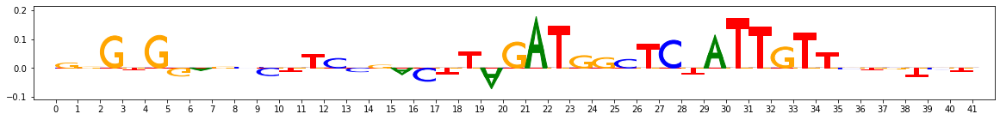

index 96912 example:191,start:571,end:612,rc:False
Features: [ 0.15046543  0.15054534  0.15912304  0.13369447  0.10983005  0.16341406
  0.18152056  0.14526785  0.17422773  0.13638189  0.18362219  0.23786526
  0.17637133  0.09186168  0.15370719  0.20549718  0.20064357  0.10188218
  0.15269435  0.2382506   0.07102447  0.07329723  0.03425583  0.08301296
  0.10769963  0.06407638  0.0897445   0.05031818  0.05697516  0.0773606
  0.0236456   0.03181248  0.04384855  0.02881605  0.03092425  0.06140799
  0.03070622  0.04343537  0.02824139  0.03889426  0.03002736  0.02578675
  0.04509078  0.0202407   0.05278014  0.03019608  0.05368298  0.05968969
  0.04091912  0.03634393  0.10200784  0.07906687  0.11494216  0.09729738
  0.08346377  0.05947141  0.12127095  0.08182014  0.08702667  0.08702718
 -0.00151599  0.00543816 -0.00625851  0.01691859 -0.01578705 -0.0029565
 -0.00777527 -0.00422544 -0.00817669  0.00741384  0.06549431  0.07142856
  0.08351679  0.09302503  0.06311436  0.07778332  0.0617544   0.1

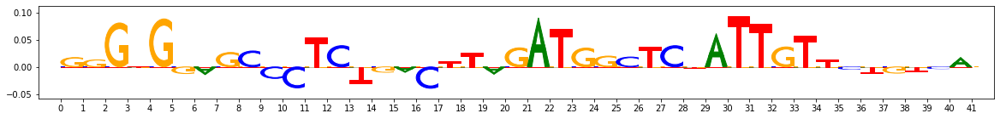

index 97612 example:658,start:519,end:560,rc:False
Features: [ 0.02600307  0.01561853  0.009858    0.03215777  0.01901543  0.0391531
  0.03277397  0.004479    0.01801724  0.01312677  0.052461    0.07162104
  0.06560321  0.02006697  0.04552063  0.12191623  0.06323705  0.08681828
  0.03895622  0.08034475  0.0901676   0.1154187   0.09381488  0.09533321
  0.11325647  0.07628881  0.11019587  0.09985365  0.082825    0.10684048
  0.03670291  0.05834855  0.04594217  0.04270049  0.06761988  0.04130705
  0.03588107  0.0584316   0.03487795  0.05810108  0.05879902  0.07175967
  0.12344595  0.11594892  0.06356328  0.07508193  0.10968164  0.06856343
  0.09827449  0.06550922  0.20500498  0.19697934  0.20338574  0.20548112
  0.18231933  0.17232921  0.2200813   0.14694519  0.12856069  0.19490618
  0.00393285 -0.01277172 -0.02903435  0.00071269 -0.03395083 -0.03235479
 -0.03300778 -0.00821034 -0.04058073 -0.02437259  0.31466998  0.23005328
  0.28336809  0.18629294  0.26262757  0.30800281  0.29412847  0.

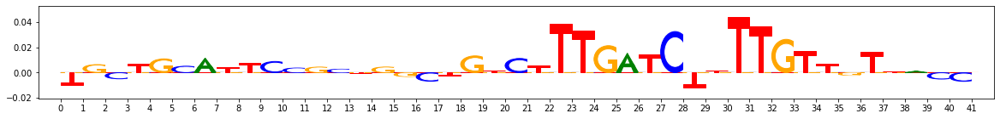

-------------------------------------------------------
PATTERNIDX 11 numseqlets 95


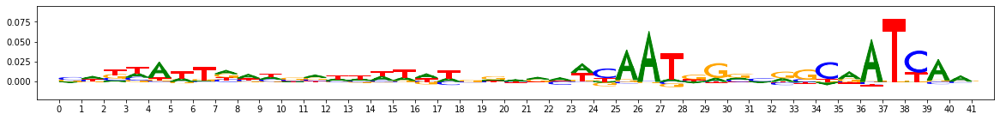

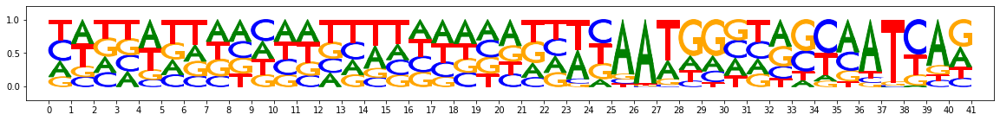

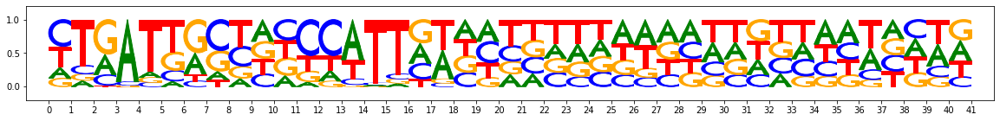

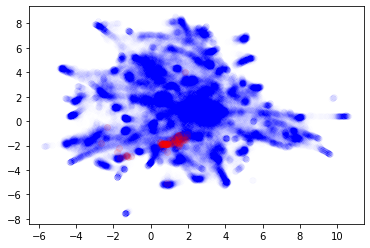

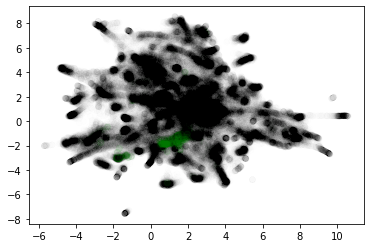

Chosen threshold: 0.9871334163581855 Precision: 0.33170731707317075 Recall: 0.6938775510204082


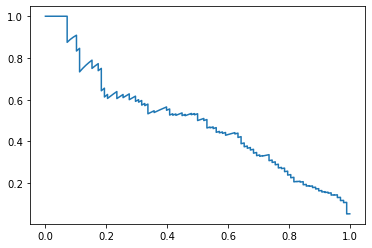

AuPRC: 0.4948895741653625
Reconstructed motif using threshold - numseqlets 199


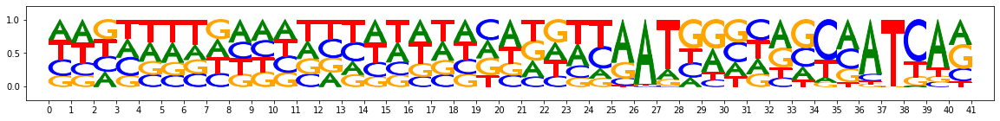

Reconstructed motif using argmax - numseqlets 1901


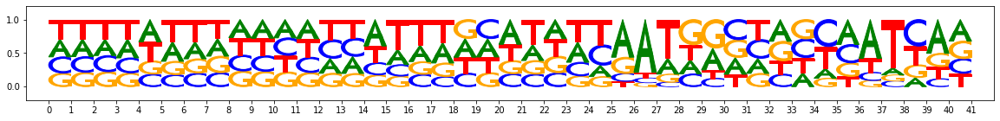

Sample false positive seqlets:
index 16 example:75,start:465,end:506,rc:True
Features: [ 0.10384435  0.10380396  0.08479672  0.09736828  0.08276532  0.12080072
  0.09730416  0.09108748  0.11441158  0.12731444  0.08569605  0.09406607
  0.1087747   0.0713512   0.0701801   0.08347287  0.13309412  0.09716878
  0.04507386  0.06889483  0.01030927  0.0249569  -0.00808512  0.00966162
  0.04757194  0.00517625  0.02321372  0.00083606  0.02617923  0.02251687
  0.06638301  0.07702875  0.06728328  0.04097718  0.04362147  0.07042143
  0.06037029  0.05992497  0.04368823  0.07862963  0.03618433  0.02283604
  0.02201189  0.02372904  0.09090495  0.01647599  0.05274378  0.04453786
  0.03080312  0.03940286  0.11412465  0.11601613  0.10877828  0.08902114
  0.14079879  0.10077449  0.10993071  0.12576095  0.10213633  0.08394526
  0.06125739  0.05348579  0.07495009  0.08590949  0.10514868  0.06481274
  0.06720523  0.0412057   0.08028242  0.03704715  0.26152874  0.36255808
  0.20130434  0.13648729  0.36406692 

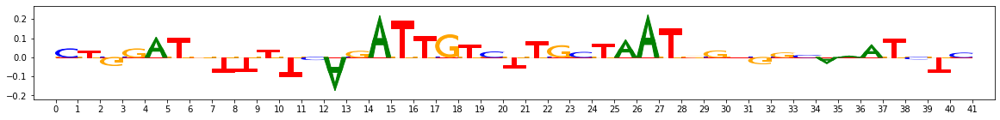

index 26067 example:460,start:376,end:417,rc:True
Features: [ 4.10472700e-02  3.39092124e-02  2.23973094e-02  5.76478540e-02
  3.13494803e-02  4.47488862e-02  3.00204019e-02  1.72991950e-02
  4.28570937e-02  8.29893541e-02  1.42378739e-01  2.02086039e-01
  1.72188423e-01  1.02033686e-01  1.91648737e-01  1.51184859e-01
  1.13301409e-01  8.11401287e-02  9.70941520e-02  1.63608457e-01
  5.07332325e-02  5.64030593e-02  5.76547424e-02  4.55542517e-02
  4.00581759e-02  4.47922256e-02  5.15489020e-02  5.25756591e-02
  5.49262276e-02  5.24271091e-02  7.57765129e-02  9.62236197e-02
  1.22046451e-01  7.55169269e-02  9.44757401e-02  9.44677674e-02
  1.01389591e-01  8.98063905e-02  1.00532193e-01  8.26835706e-02
  3.95394830e-02  3.77720038e-02  3.81386857e-02  4.71831499e-02
  8.12523774e-02  4.00579470e-02  5.62650824e-02  6.49029595e-02
  6.10745690e-02  5.41783885e-02  1.14362824e-01  1.35466470e-01
  1.31460478e-01  1.01707968e-01  1.48912555e-01  1.32571339e-01
  1.57425791e-01  1.55261318e-

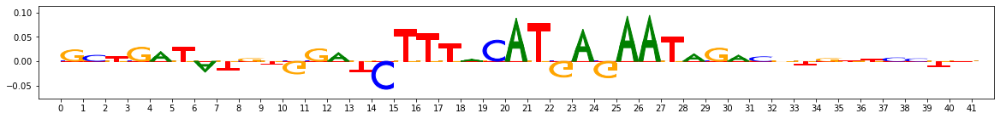

index 59883 example:424,start:491,end:532,rc:False
Features: [0.12220397 0.1486147  0.10592979 0.12381682 0.11433706 0.14373188
 0.15377759 0.11259232 0.14186538 0.14330047 0.05463699 0.02844456
 0.08084471 0.05978877 0.02486736 0.09377768 0.07314402 0.12103314
 0.04619117 0.03394759 0.06051185 0.0881023  0.03848439 0.0493516
 0.07784241 0.04847704 0.13901219 0.05433017 0.0520039  0.04960694
 0.0121926  0.04203695 0.02429066 0.02046783 0.03705193 0.03110421
 0.04345852 0.03084639 0.01283347 0.03509504 0.04249732 0.04431131
 0.01929438 0.05752514 0.09703719 0.02970586 0.05860968 0.10666095
 0.02389991 0.04083962 0.09199665 0.0866104  0.09688236 0.07337007
 0.06865718 0.14674193 0.08577938 0.06311745 0.05739621 0.10145676
 0.02800906 0.03620142 0.03192013 0.1707769  0.06691811 0.07998695
 0.02587404 0.05039129 0.08606476 0.02679608 0.20447148 0.29460304
 0.12417199 0.10183894 0.28443791 0.26356019 0.27745072 0.11415544
 0.14355547 0.04762388 0.03607073 0.05672339 0.07848574 0.05750812
 0

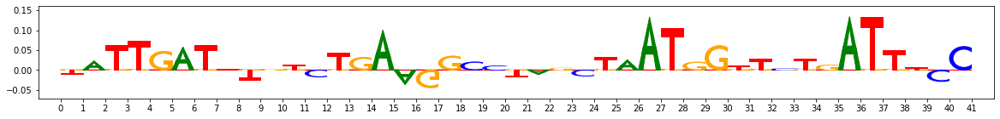

index 70079 example:945,start:517,end:558,rc:False
Features: [ 0.03716796  0.02989819  0.03380612  0.03110843  0.01969106  0.05413779
  0.02728597  0.03372695  0.03222343  0.06009922  0.05637406  0.06579181
  0.05233839  0.04875156  0.07547041  0.08154208  0.03389646  0.07684872
  0.04516466  0.08213192  0.01740086 -0.00165443  0.02091692  0.00768654
  0.05102301 -0.00119216  0.00843068 -0.00409304 -0.00285258  0.00626366
 -0.01289713 -0.00045958 -0.01465717 -0.01747412 -0.00844598 -0.01902462
 -0.01018912 -0.02051932 -0.02230754 -0.01861758  0.07372849  0.08325864
  0.09871075  0.0966387   0.12328669  0.05968292  0.10500717  0.10272819
  0.14123277  0.10090813  0.10802399  0.08037887  0.13816084  0.09105007
  0.1227844   0.09140084  0.15245914  0.06514773  0.1491136   0.11154478
  0.0115002   0.02447915  0.02935352  0.05052365  0.10112262  0.02523645
  0.01762373  0.0703228   0.03713654  0.01850012  0.18067621  0.15310625
  0.14572301  0.17149711  0.21396105  0.17045515  0.17185203  0

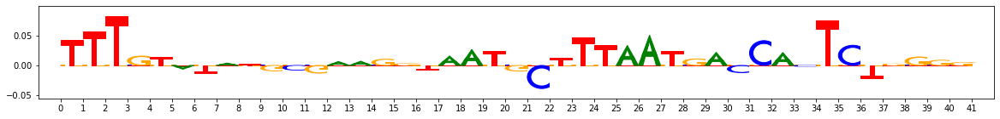

index 82236 example:1085,start:498,end:539,rc:False
Features: [ 0.04351106  0.05519164  0.03093895  0.03858707  0.03900178  0.06022135
  0.03530756  0.03640655  0.04619385  0.04629278  0.10116052  0.10073843
  0.10708569  0.11976686  0.09691791  0.0961708   0.13683526  0.097142
  0.07192687  0.0576355   0.04027737  0.03349948  0.03501489  0.04034788
  0.06476865  0.03267161  0.02479228  0.02319171  0.04665054  0.03757345
  0.03466301  0.04130566  0.02972395  0.01095559  0.02125584  0.03082289
  0.02303375  0.02825131  0.01275801  0.04118481 -0.02034125 -0.02429845
  0.00203566 -0.0256691   0.05686076 -0.00358668  0.04211516 -0.00880247
  0.00267755  0.00213891  0.10871824  0.13498843  0.10706571  0.076982
  0.16439872  0.11083275  0.11860882  0.17558149  0.08492793  0.11236617
  0.0545756   0.02259131  0.08668293  0.02491519  0.05610448  0.03113562
  0.09435913  0.00732446  0.08479528  0.02029186  0.27922497  0.28604932
  0.23946613  0.1716436   0.2829917   0.22943013  0.3116909   0.12

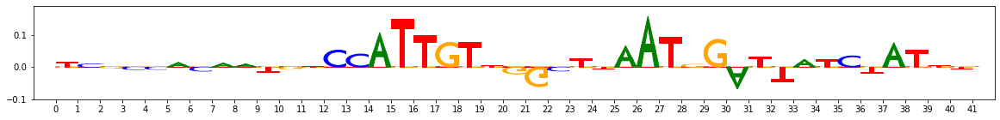

index 105429 example:1002,start:459,end:500,rc:False
Features: [-4.98099248e-02 -5.30938727e-02 -4.53901524e-02 -2.71074262e-02
 -4.08033466e-02 -5.12870383e-02 -4.94108971e-02 -4.47708834e-02
 -4.19925849e-02 -1.47214166e-02  6.35677357e-02  1.01376856e-01
  7.35445637e-02  9.89879589e-02  1.16005326e-01  8.32330590e-02
  8.63163884e-02  5.15007180e-02  2.51798770e-02  5.44372337e-02
  3.43677770e-02  2.39808941e-02  4.12413539e-02  7.05037506e-03
  4.87155539e-02  1.13349971e-02  4.16700152e-03  2.08107459e-02
  4.56339399e-02 -3.94949540e-05  1.10481999e-02  3.68690024e-02
  2.33427376e-02  1.34045533e-02  2.09253874e-02  1.50909210e-02
  1.40346146e-02  3.27525138e-02  9.82287494e-03  1.60064854e-02
  7.13810599e-03  2.25135986e-02  1.35198358e-02  1.97893738e-02
  3.11359123e-02  1.07510823e-02  1.16599300e-02  2.62966251e-02
  3.34564680e-02  2.23715920e-02  7.26676149e-02  9.83148043e-02
  5.93776341e-02  2.69274016e-02  1.66490149e-01  4.66088065e-02
  3.75001678e-02  2.3743495

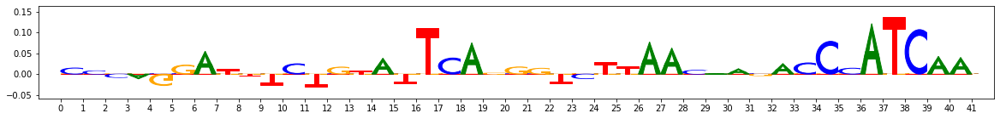

Sample false negative seqlets:
index 2345 example:837,start:484,end:525,rc:False
Features: [ 0.06501194  0.04031589  0.04493646  0.07417838  0.02880252  0.06725948
  0.0474774   0.04647017  0.05928184  0.10496951  0.00215975 -0.00326827
  0.0035715   0.02160541  0.01016425  0.02929424  0.00567692  0.03082865
  0.00955803  0.0038395   0.07335249  0.09604927  0.10311884  0.0822641
  0.12618424  0.07882551  0.09640243  0.10477922  0.10230303  0.10451561
  0.05588635  0.11117731  0.09141109  0.06281087  0.07915363  0.12214154
  0.0770164   0.10578363  0.04591325  0.10426041  0.08398066  0.07903906
  0.08687842  0.0642311   0.14064651  0.07879826  0.10132225  0.11388515
  0.12349128  0.09710831  0.04700943  0.07201722  0.07108195  0.06141761
  0.04641028  0.11896396  0.113844    0.05045224  0.03661755  0.08123509
  0.08210013  0.08284772  0.06606424  0.12550811  0.09502074  0.04846757
  0.07776886  0.10076937  0.09119764  0.05316129  0.08404111  0.06830258
  0.06289479  0.07290492  0.132230

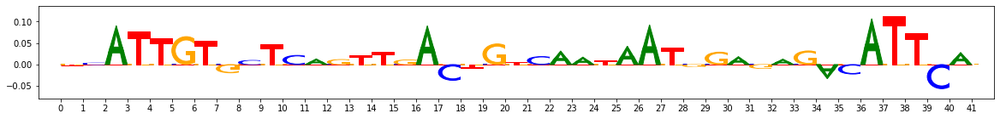

index 98712 example:712,start:495,end:536,rc:True
Features: [ 0.06610618  0.06417702  0.06248834  0.0555387   0.05508692  0.08518793
  0.06529457  0.04942078  0.07790495  0.09946679  0.0263727   0.01046114
  0.0111998   0.02014441  0.001666    0.04543835  0.01592471  0.01849477
  0.02086802  0.00998036  0.06685459  0.08484011  0.07379189  0.06649184
  0.06955316  0.06385633  0.07400069  0.07600443  0.0689177   0.06480497
  0.08125651  0.11904541  0.09668423  0.0950615   0.10202514  0.12107993
  0.0923261   0.12880862  0.07484857  0.1214436   0.01795654  0.01364058
  0.01326002  0.00703697  0.09320557  0.00735886  0.0274819   0.01724257
 -0.00617403  0.02385277  0.06949484  0.07585439  0.11087229  0.10066087
  0.06791336  0.10523952  0.16813071  0.06615641  0.05743896  0.11718764
  0.04124276  0.04787753  0.03026717  0.09228997  0.06246557  0.04670596
  0.04410592  0.05878247  0.04912128  0.02669093  0.15134864  0.13461988
  0.1277701   0.1071652   0.17869462  0.17706733  0.14452532  0.

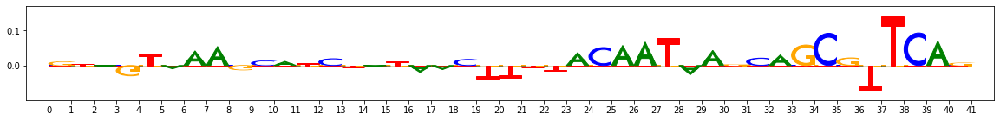

index 99187 example:43,start:585,end:626,rc:True
Features: [0.09908613 0.07585134 0.05761144 0.10649927 0.08576565 0.09390775
 0.11382625 0.07110456 0.09084727 0.0739653  0.07333629 0.0865048
 0.10849572 0.0486541  0.06972613 0.1005871  0.08856427 0.07610223
 0.05536651 0.1174034  0.04846396 0.05484122 0.04749321 0.03242967
 0.08277185 0.02714252 0.05925782 0.03880644 0.06139504 0.04515266
 0.0599766  0.07627934 0.08196769 0.06173169 0.07016835 0.06974154
 0.08300369 0.09330534 0.06828534 0.06798222 0.07468401 0.07139729
 0.10718609 0.10699346 0.07963632 0.08275095 0.08798439 0.06591678
 0.10279199 0.09110574 0.08884531 0.10908928 0.1115723  0.09513282
 0.09463158 0.11338553 0.16119553 0.10124182 0.07237523 0.11970994
 0.0726977  0.07776338 0.05511167 0.13602397 0.06157606 0.04951595
 0.07643392 0.06743204 0.06103957 0.0419321  0.24042924 0.23905226
 0.22932156 0.14006701 0.28829113 0.2953325  0.28532572 0.25483433
 0.20845782 0.1723674  0.12264224 0.17080913 0.17579286 0.10359315
 0.1

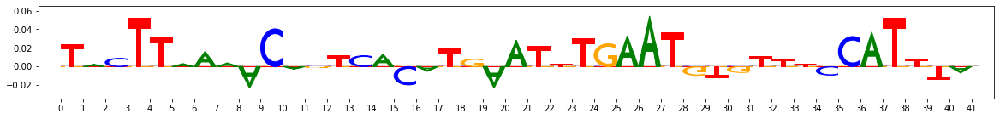

index 99662 example:493,start:449,end:490,rc:True
Features: [ 0.04048188  0.01005327  0.02227935  0.02143959  0.00939428  0.0379142
  0.02585024  0.0141597   0.02224565  0.12200982  0.04259165  0.04455967
  0.03497125  0.03191454  0.05544534  0.03019844  0.02647199  0.04067304
  0.03024602  0.049521    0.05771934  0.0989851   0.06529545  0.04399253
  0.08554346  0.05926331  0.10106149  0.06684876  0.07124337  0.05405256
  0.03943416  0.08435399  0.07145216  0.038287    0.05019506  0.08293425
  0.04987056  0.06765868  0.02938091  0.06513013  0.09889974  0.10001665
  0.07109239  0.09916458  0.12882778  0.08129671  0.10883869  0.12326271
  0.13279871  0.1015101   0.03471889  0.02637605  0.04642754  0.02561322
  0.04013849  0.06711775  0.05295475  0.03978693  0.04258221  0.04070853
  0.09988303  0.10046997  0.0961984   0.14580225  0.15522114  0.12962784
  0.10465571  0.0922349   0.13193165  0.0773448   0.08300071  0.06707071
  0.07319274  0.07765458  0.12337456  0.12298155  0.09486279  0.0

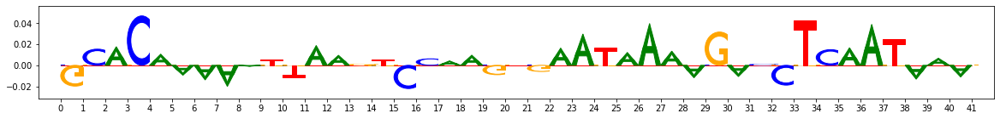

index 100137 example:448,start:567,end:608,rc:False
Features: [ 6.36206842e-02  5.35105997e-02  6.00706784e-02  5.70424286e-02
  4.03584088e-02  6.18983929e-02  5.38662555e-02  4.97880536e-02
  6.85520647e-02  1.20101974e-01  2.17991244e-02  1.41286608e-02
  1.37279250e-02  2.45041393e-02  2.33597238e-02  2.86159308e-02
  6.28379547e-03  1.83311846e-02  2.74817674e-02  1.17591097e-02
  5.15078234e-02  8.91115095e-02  5.83920943e-02  5.76214138e-02
  6.07301739e-02  4.84464805e-02  1.09227941e-01  5.70602597e-02
  6.63011664e-02  5.71389876e-02  7.58671287e-02  9.55864457e-02
  7.70738809e-02  8.17400136e-02  7.87472747e-02  1.08185778e-01
  6.80575118e-02  9.66039368e-02  6.61164229e-02  8.39756263e-02
  2.77232102e-02  7.61356972e-02  5.69861085e-02  4.95730355e-02
  6.08812405e-02  4.54766704e-02  3.91375853e-02  1.02131352e-01
  5.21533069e-02  3.85045644e-02  1.05862123e-02 -3.73003752e-03
  4.93111570e-03  7.81017746e-03  4.97920516e-03  2.00010448e-02
 -3.08353480e-03  1.07728771

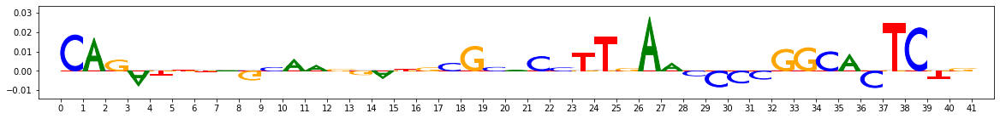

index 100612 example:442,start:475,end:516,rc:False
Features: [ 0.10651328  0.11850085  0.11205534  0.07978938  0.07209057  0.12123396
  0.10663931  0.09605938  0.12677969  0.09941249  0.0221739   0.01621084
  0.02219143  0.02004208  0.00958475  0.03264193  0.01875938  0.04775886
  0.02980215  0.01913464  0.03744234  0.04335302  0.02851907  0.03596022
  0.08005096  0.02715998  0.04308963  0.04011584  0.06060031  0.0470156
  0.01609785  0.01976656  0.00988683 -0.00099406 -0.00315877  0.02130505
  0.00878736  0.01352502 -0.00114852  0.01439453  0.02132277  0.01910147
  0.01845444  0.01087377  0.04067589  0.00390012  0.02830422  0.03097783
  0.02982816  0.02704116  0.04593203  0.02850816  0.04748727  0.03084205
  0.04086024  0.04221786  0.04147319  0.03494081  0.09783505  0.03611111
  0.04175971  0.03603487  0.05268623  0.1629054   0.06277767  0.08479499
  0.05578532  0.05460236  0.0560655   0.04053187  0.06004092  0.05753099
  0.06453098  0.09453022  0.13253585  0.03237521  0.07621217  0

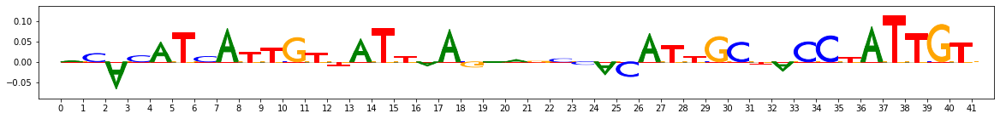

-------------------------------------------------------
PATTERNIDX 12 numseqlets 95


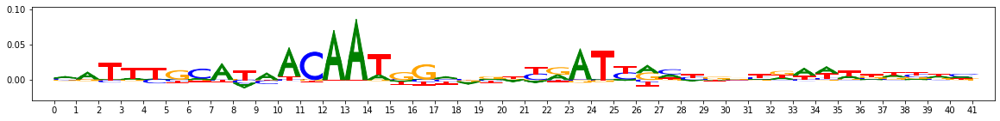

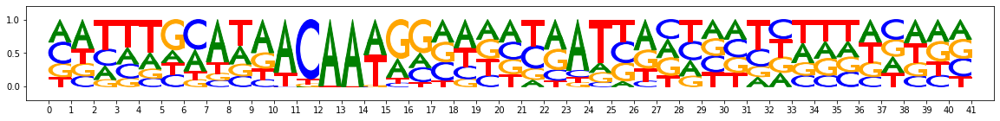

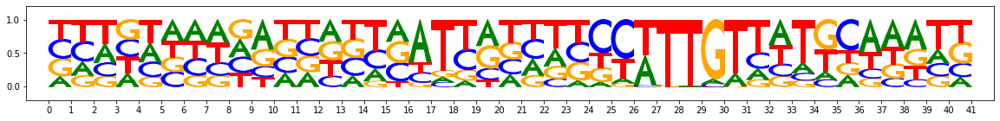

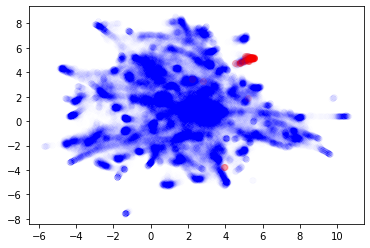

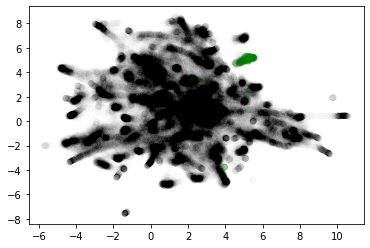

Chosen threshold: 0.9907286308179418 Precision: 0.21518987341772153 Recall: 0.6938775510204082


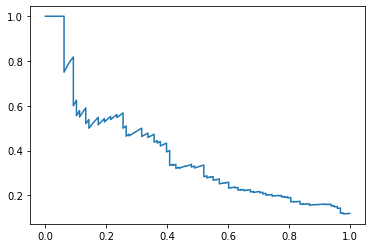

AuPRC: 0.38056812858175115
Reconstructed motif using threshold - numseqlets 312


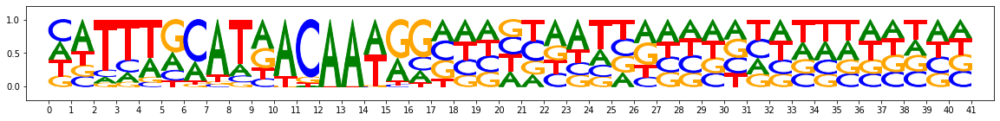

Reconstructed motif using argmax - numseqlets 1095


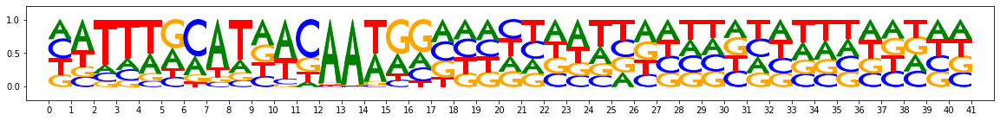

Sample false positive seqlets:
index 3 example:75,start:452,end:493,rc:True
Features: [ 0.1351285   0.14249102  0.14076444  0.1198483   0.09140702  0.13373896
  0.15235194  0.11930499  0.15648851  0.19361167  0.04882206  0.01597076
  0.02756732  0.04782511  0.01677176  0.03293506  0.02606602  0.05377512
  0.05733855  0.01645879  0.05197553  0.08768033  0.0865983   0.05048405
  0.10891954  0.04106521  0.09678408  0.07109936  0.05985293  0.0633991
  0.03789083  0.06012652  0.02916669  0.04090546  0.05181212  0.06453712
  0.0381681   0.04737787  0.02994795  0.04671273  0.07069864  0.07607155
  0.00562868  0.04011809  0.06155487 -0.00280187  0.06086561  0.190152
  0.06799217  0.05852085 -0.00838057 -0.01177643 -0.02178654  0.00173168
 -0.02445291  0.01586388 -0.01262347 -0.01052355 -0.00817859  0.03288379
  0.03762043  0.03652997  0.01629058  0.07948137  0.05418629  0.05770965
  0.01092618  0.04856394  0.03963074  0.0319507   0.01566164  0.02549245
  0.01809633  0.05806847  0.08485968  0.0

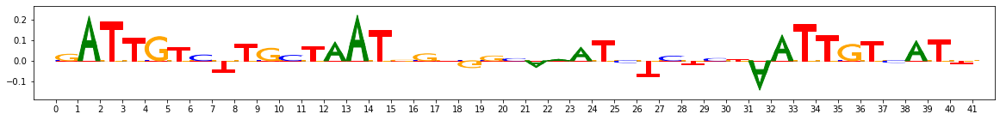

index 22895 example:882,start:429,end:470,rc:False
Features: [ 0.09033649  0.09760077  0.1043103   0.08443642  0.06244679  0.09694134
  0.10427489  0.08019663  0.1232728   0.20521622  0.03501931  0.008255
  0.01730887  0.04142627  0.02642472  0.07593724  0.00828861  0.07280331
  0.0411077   0.01832082  0.05513128  0.07194757  0.06234472  0.04210463
  0.06179081  0.03640431  0.15995305  0.04444796  0.05904485  0.05142577
  0.03835612  0.05882706  0.04766065  0.04572643  0.05289969  0.0823608
  0.04374666  0.05754185  0.03456709  0.04696384  0.07426577  0.11237202
  0.03838147  0.11420129  0.06684657  0.04631328  0.02751953  0.12487036
  0.05737546  0.08449648  0.03413694  0.02340339  0.0371966   0.05006349
  0.0090691   0.04634207  0.0888065   0.00799636  0.03030622  0.03221516
  0.10052392  0.07744304  0.05210906  0.10247132  0.135024    0.13146797
  0.04230037  0.09860755  0.07917322  0.06958214  0.04282208  0.04523931
  0.03386305  0.01935563  0.05261557  0.06593925  0.02824294  0.04

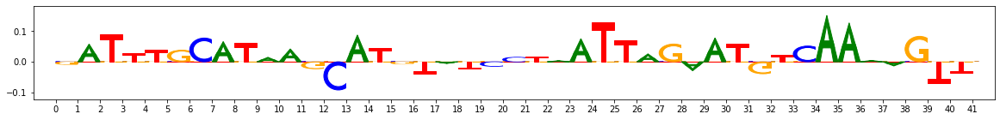

index 28954 example:61,start:548,end:589,rc:True
Features: [ 0.11072295  0.11219707  0.12865913  0.1000977   0.07971681  0.12708951
  0.11172203  0.11170732  0.16045117  0.12434587  0.10144516  0.05585177
  0.07156254  0.11120641  0.10640856  0.07300741  0.0683697   0.14034528
  0.1245778   0.07214157  0.02078794  0.0326366   0.06421922  0.02282497
  0.04427123  0.01149858  0.06599857  0.02421019  0.04497052  0.03327129
  0.01147171  0.01946466  0.03382553  0.02867323  0.04109911  0.05478428
  0.03597297  0.03511566  0.02192818  0.03545525 -0.009137    0.04538987
  0.00563361 -0.01239374 -0.00592005  0.00552633  0.01226738  0.07316683
  0.01884788  0.02520383  0.04344433  0.06752817  0.03948821  0.03641439
  0.03166273  0.0788184   0.05856629  0.04853177  0.05722927  0.05312197
  0.03456291  0.01314165  0.04770443  0.06135674  0.00741828  0.02516468
  0.01037881  0.02856446  0.0195315   0.00828762  0.07873393  0.09077138
  0.07362856  0.07742798  0.11866564  0.11918749  0.09452738  0.0

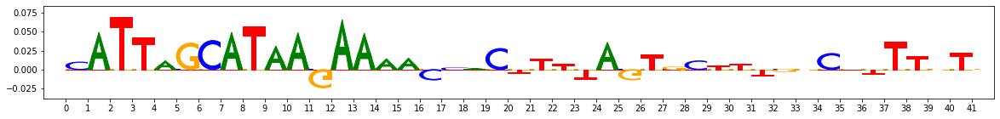

index 35729 example:221,start:275,end:316,rc:True
Features: [ 1.06753427e-01  1.31252618e-01  1.21073113e-01  1.13918359e-01
  1.18154380e-01  1.09448663e-01  1.26028833e-01  1.13444350e-01
  1.11939871e-01  1.01434453e-01  9.87182313e-02  3.56898686e-02
  6.42186849e-02  1.27533837e-01  8.95757306e-02  5.45263209e-02
  5.66994532e-02  9.47705188e-02  1.44840139e-01  3.37168090e-02
 -5.60845673e-03 -1.42339855e-02  3.59373090e-02 -7.63343685e-03
  1.13256886e-02 -7.65417513e-03  4.48768679e-03 -1.11860146e-02
 -9.55943074e-03 -4.66433420e-03  2.17601090e-02  3.27402907e-02
  1.99229964e-02  2.73478509e-02  3.55587483e-02  4.28261111e-02
  2.86574393e-02  2.55036000e-02  2.02555630e-02  2.57150568e-02
  1.08264538e-02  3.66929793e-02  2.18798270e-02  7.92588509e-03
  1.67689129e-02  1.26348317e-02  1.97774032e-02  6.68393712e-02
  3.58494584e-02  2.55499808e-02 -3.52506782e-03  1.49474223e-02
  7.54220868e-03 -4.81043778e-03 -5.91193266e-03  4.23332570e-02
  1.64206388e-02  1.21683419e-

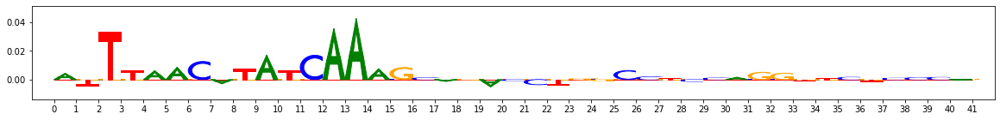

index 66614 example:563,start:458,end:499,rc:False
Features: [ 0.07195552  0.07417519  0.07199886  0.08422053  0.05545114  0.06613816
  0.08160406  0.06673149  0.07871489  0.20238281  0.05780864  0.03324753
  0.02118495  0.04766725  0.04014911  0.0498893   0.03766113  0.045765
  0.06198159  0.03871129  0.06465351  0.1066839   0.09116549  0.06957846
  0.12095586  0.05667326  0.10151233  0.07213054  0.09224914  0.11935264
  0.12380621  0.16077599  0.15439416  0.11911957  0.1292189   0.18767539
  0.12580634  0.14254583  0.11517321  0.15033667  0.0442563   0.0428119
  0.03028039  0.03214505  0.07635145  0.04428711  0.04601266  0.0771469
  0.06713642  0.02376416 -0.00764439 -0.01226699 -0.00166062  0.00465387
 -0.02386309  0.00719077  0.02957192 -0.00177996  0.00704222  0.00233764
  0.05162241  0.04646201  0.03962646  0.10851424  0.13019788  0.06114235
  0.03946865  0.03226697  0.07181251  0.03691697  0.0207527   0.01373855
  0.00736078  0.03897059  0.06451499  0.07373976  0.01280315  0.023

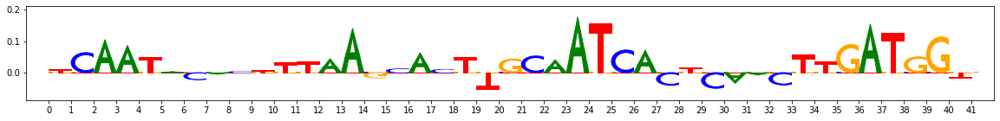

index 104364 example:885,start:147,end:188,rc:True
Features: [ 0.07209002  0.08845511  0.09093545  0.08977733  0.07804482  0.07896027
  0.09471325  0.07939927  0.08595248  0.09047858  0.18700949  0.08480107
  0.09727279  0.24309838  0.1838613   0.13049561  0.07333763  0.12837276
  0.26283416  0.0583889   0.04576588  0.04904548  0.07531366  0.04628306
  0.06228196  0.03807371  0.06566944  0.05442436  0.05151855  0.06726994
  0.02029781  0.03611259  0.02387287  0.02831094  0.02848373  0.0439566
  0.03090783  0.04438751  0.02325365  0.03088861  0.03157013  0.03893052
  0.01367743  0.0289309   0.00991441  0.02213477  0.00684776  0.02425494
  0.03353827  0.03123881 -0.01688922 -0.01265021  0.00119599  0.00609911
 -0.02125346  0.01041417  0.0204131  -0.02209562 -0.00511375  0.00767903
  0.03077133  0.01662546  0.039513    0.0551151   0.03162536  0.03753059
  0.03823904  0.02944117  0.04619299  0.04439475 -0.0187803  -0.00810929
 -0.01026107  0.03586835  0.00054977 -0.00827524 -0.00617748  0.

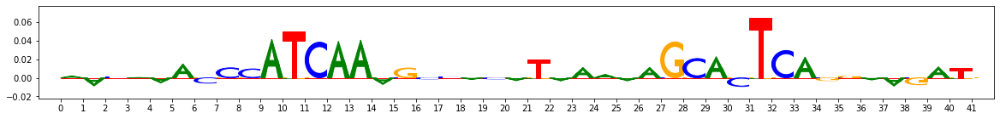

Sample false negative seqlets:
index 29870 example:154,start:568,end:609,rc:False
Features: [ 1.23120787e-01  1.24097876e-01  1.57109007e-01  1.06074002e-01
  7.86317910e-02  1.37175798e-01  1.17266737e-01  1.28524324e-01
  1.81772521e-01  1.49075129e-01  6.65130045e-02  3.41031799e-02
  6.13171553e-02  8.75977026e-02  5.79948090e-02  3.91411458e-02
  5.90396191e-02  9.57286103e-02  9.77881537e-02  3.85468867e-02
  9.17370376e-02  9.35338584e-02  1.32035220e-01  8.60898914e-02
  1.10577177e-01  8.11019781e-02  1.38828861e-01  8.11919139e-02
  1.13445104e-01  1.08841423e-01 -1.09278044e-02 -2.11163804e-02
 -2.84217059e-02 -3.03777751e-03 -1.19010247e-02  4.07515738e-03
 -1.45022503e-02 -1.41893786e-02 -1.27680800e-02 -3.11172974e-02
 -7.02522947e-03  4.48146274e-02 -9.11165023e-04  5.54266737e-04
 -9.02385390e-03  4.15935294e-03 -4.97238497e-03  6.29846315e-02
  2.21357714e-02  2.23021455e-02 -1.16224417e-02  1.87365017e-04
 -1.53951124e-02 -2.56667567e-02 -1.82858064e-02  1.71156338e-0

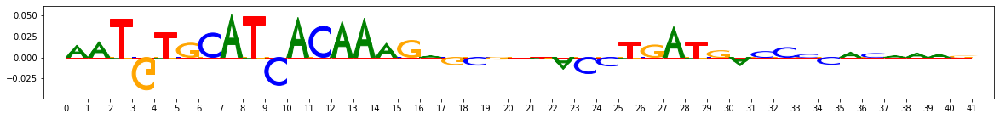

index 101087 example:144,start:466,end:507,rc:False
Features: [ 0.14972354  0.15659826  0.1585753   0.13085776  0.10414655  0.15201148
  0.15832413  0.13949337  0.17936844  0.25389032  0.02759738 -0.02708504
  0.01189487  0.06177572  0.00278666  0.00921834  0.01814316  0.06611985
  0.06015796 -0.02316244  0.12584737  0.13327933  0.17095254  0.12767127
  0.14645223  0.11791456  0.16100219  0.13379372  0.15120277  0.17055301
  0.02861508  0.04347993  0.01831076  0.03075282  0.04589929  0.06756734
  0.01653339  0.04552518  0.01138471  0.04626375  0.06782493  0.10709814
  0.04658717  0.08623161  0.08606424  0.04069129  0.02966242  0.06008254
  0.0468256   0.08081854 -0.00658781 -0.00308473 -0.00937522 -0.01259312
 -0.01665503  0.00988681 -0.0044913  -0.01236273  0.00398956 -0.00349903
  0.26402341  0.17154994  0.16226588  0.10457189  0.21351359  0.23190103
  0.17979225  0.1420367   0.20314481  0.19811222  0.04505275  0.06488869
  0.03546237  0.03512091  0.07405854  0.04462257  0.04692037  

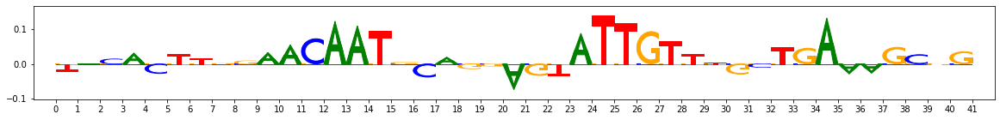

index 101562 example:875,start:541,end:582,rc:False
Features: [ 0.0860988   0.10843147  0.09690239  0.10379061  0.08915022  0.08063664
  0.11254655  0.08305257  0.10948974  0.20568281  0.11322072  0.05825611
  0.08224158  0.13599498  0.09924987  0.10943466  0.06657757  0.10755912
  0.1377779   0.05213628  0.0607069   0.07831369  0.09508311  0.07056232
  0.08943104  0.05815563  0.08759652  0.07037601  0.07135138  0.09008735
  0.1357725   0.16686074  0.12858154  0.13775104  0.13484933  0.15448537
  0.11630772  0.1329756   0.11818356  0.13416102  0.03390025  0.05644143
  0.02813078  0.01798857  0.07100175  0.03713615  0.03821701  0.07283408
  0.05618515  0.04180459 -0.04669554 -0.04213271 -0.0402387  -0.03787363
 -0.04590584 -0.02590839 -0.00871532 -0.04185333 -0.01760055 -0.03099045
  0.05876213  0.04783648  0.0473332   0.07821009  0.12691944  0.05492903
  0.04552094  0.0505863   0.07496923  0.04141567 -0.0024142   0.02490101
  0.00215814  0.03400216  0.06361861  0.05818974  0.03071714 -

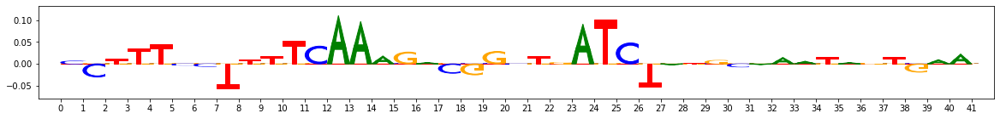

index 102037 example:452,start:590,end:631,rc:False
Features: [0.14922912 0.14145637 0.12096575 0.12649063 0.11139706 0.12334943
 0.13028589 0.1156844  0.12377592 0.17877612 0.10053723 0.04980823
 0.07667827 0.12936692 0.09032644 0.0888614  0.07056255 0.12210173
 0.13629674 0.0536265  0.03248453 0.03595714 0.0725909  0.0483892
 0.03318403 0.02733001 0.05540423 0.0430885  0.03538425 0.05755817
 0.06976613 0.09622898 0.07452999 0.04817105 0.06213601 0.1153843
 0.06026312 0.0767072  0.04584701 0.08788113 0.13428423 0.1346793
 0.18499165 0.17977124 0.16322277 0.14552078 0.17819414 0.22638668
 0.19955272 0.13581309 0.04303823 0.04837672 0.03549546 0.04727749
 0.03781217 0.05022243 0.05154646 0.02339551 0.04085334 0.03845696
 0.04035378 0.02731634 0.03797056 0.03235654 0.1309604  0.03508339
 0.02471117 0.02217031 0.0434291  0.01375681 0.10857169 0.08553116
 0.06969386 0.05668154 0.12149144 0.13239397 0.09089003 0.08687303
 0.06220316 0.12749323 0.08892414 0.11682389 0.13191029 0.0777404
 0.0

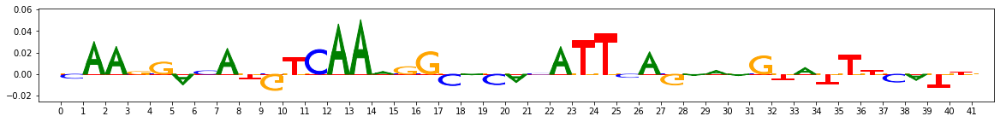

index 102512 example:940,start:400,end:441,rc:True
Features: [ 0.09829366  0.11175441  0.11782034  0.09984983  0.09624266  0.10087943
  0.12321845  0.1072952   0.10735311  0.19891033  0.11379252  0.05267281
  0.08461484  0.14496225  0.09919053  0.09730944  0.06857618  0.11413883
  0.14083266  0.04589752  0.051788    0.06776256  0.09285374  0.04877388
  0.07103554  0.04572902  0.08423558  0.06692001  0.06796423  0.10245242
  0.08534755  0.1066516   0.07468545  0.07891599  0.10437678  0.11031987
  0.06623128  0.09718382  0.07502807  0.09137139  0.04580724  0.05965269
  0.0319044   0.04596226  0.08347135  0.04341243  0.03848535  0.07235122
  0.0623536   0.04135091 -0.01880731 -0.00304441 -0.01363114 -0.00276624
 -0.0253147   0.01331665  0.05086023 -0.00903284 -0.00363801 -0.00176455
  0.04088701  0.02976001  0.02679809  0.05670238  0.10687949  0.03087369
  0.02169419  0.0284828   0.04244458  0.01570252  0.03350499  0.05945517
  0.0247456   0.01663804  0.09391622  0.08183816  0.04271156  0

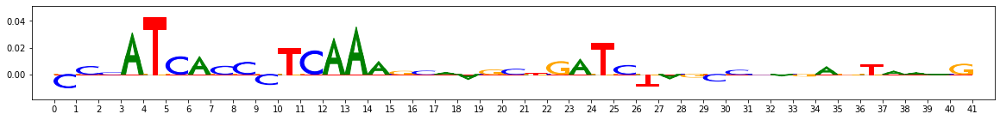

index 102987 example:442,start:578,end:619,rc:True
Features: [ 0.17600704  0.15143436  0.15425292  0.14869935  0.1094924   0.14458099
  0.17012851  0.13455724  0.17963432  0.2099945   0.05831585  0.02943843
  0.03351399  0.064187    0.05183294  0.04417802  0.01827605  0.05852163
  0.08061516  0.04712929  0.06173124  0.13453656  0.09948855  0.07298801
  0.12348422  0.06954356  0.16690843  0.08387705  0.0994784   0.10989239
  0.02984724  0.06535892  0.04213393  0.01404849  0.04495108  0.10229909
  0.05080385  0.05805556  0.02169068  0.06270957  0.10081511  0.11419959
  0.08881946  0.09943486  0.11826696  0.08129139  0.1084751   0.13972304
  0.15582203  0.11875027 -0.07422886 -0.0767453  -0.06049646 -0.05007115
 -0.08836141 -0.02193682 -0.03728867 -0.0818135  -0.05206462 -0.04877048
  0.0253908  -0.00217269  0.0135197   0.05230555  0.01452557  0.06301396
 -0.00714623  0.01598167  0.00958754  0.0121436   0.01254798  0.03639577
 -0.00381401  0.05217248  0.0901584   0.03570798  0.03959411  0

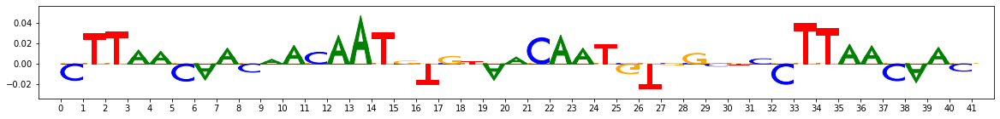

-------------------------------------------------------
PATTERNIDX 13 numseqlets 99


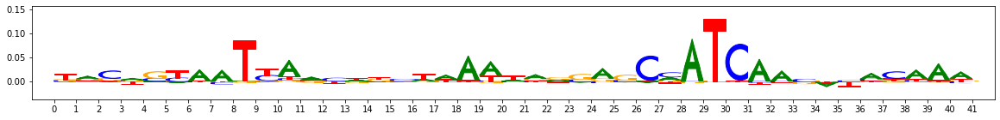

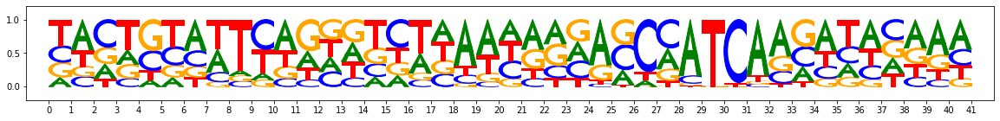

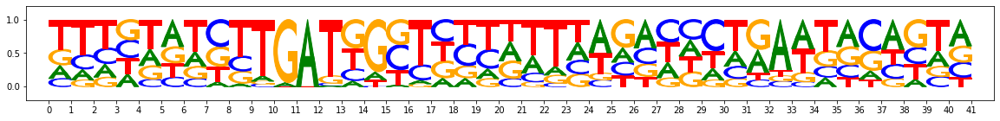

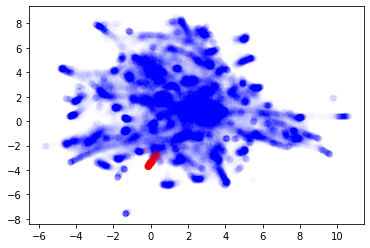

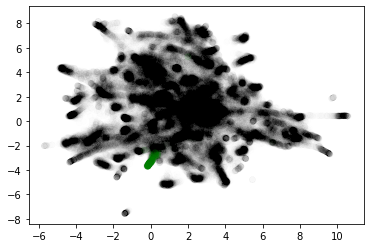

Chosen threshold: 0.9926176504637148 Precision: 0.32701421800947866 Recall: 0.696969696969697


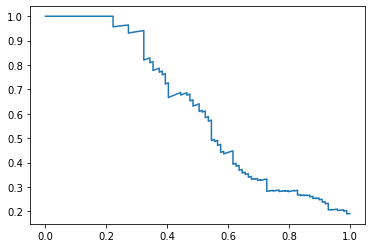

AuPRC: 0.6148827857428915
Reconstructed motif using threshold - numseqlets 209


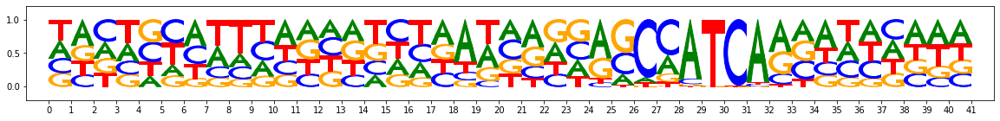

Reconstructed motif using argmax - numseqlets 907


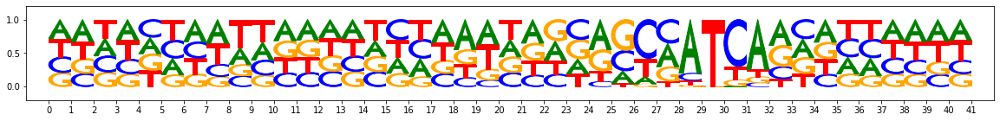

Sample false positive seqlets:
index 40 example:970,start:466,end:507,rc:False
Features: [ 1.99067255e-01  1.93818146e-01  2.04371874e-01  1.45832550e-01
  1.55808320e-01  2.18788817e-01  2.00366373e-01  1.88926758e-01
  2.24415997e-01  1.79569208e-01  6.21372675e-02  7.15329752e-02
  7.25041893e-02  4.90796589e-02  5.34988866e-02  5.52765856e-02
  7.75307451e-02  9.49457853e-02  7.79539098e-02  9.78432243e-02
 -1.50973642e-02 -1.17391216e-02 -1.64474165e-02 -1.24252834e-02
  1.03579966e-02 -1.69389819e-02 -1.50375993e-02 -9.05259727e-03
 -1.29260683e-02  4.14685555e-03  1.84280515e-02  3.42325601e-02
  2.34549860e-02  1.71233963e-02  2.71389272e-02  4.72495327e-02
  1.19578897e-02  2.22797985e-02  1.06998647e-02  2.74851774e-02
  9.12484063e-02  7.96467405e-02  1.53440959e-01  8.97622715e-02
  4.94840066e-02  1.91200890e-01  6.77568563e-02  9.61985795e-02
  9.04752718e-02  5.33913752e-02  1.02776048e-01  7.79714838e-02
  8.30526163e-02  6.32326777e-02  1.05878010e-01  6.57591437e-02
 

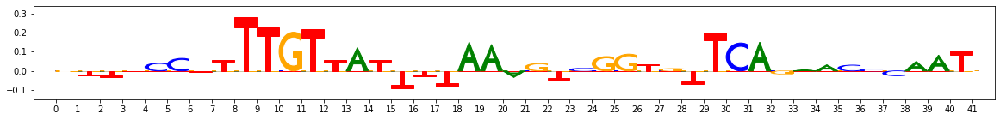

index 50904 example:157,start:546,end:587,rc:True
Features: [-1.01268730e-02 -9.50423186e-03 -3.03043484e-03  5.20899148e-03
  5.14927766e-03 -8.10756183e-03 -1.23453289e-02 -1.31778254e-02
  5.74790499e-03 -1.16957314e-02  7.26435565e-02  3.93547493e-02
  4.12637426e-02  6.42963726e-02  5.23535313e-02  8.15754501e-02
  5.75336065e-02  5.85237375e-02  6.63602766e-02  3.33284572e-02
  7.23751925e-03  2.58707317e-03  1.78186065e-02 -1.48329911e-02
  2.37204069e-03 -2.21309204e-02 -8.76745963e-03 -1.94890049e-03
 -1.04713755e-04 -1.20088078e-03  1.13047337e-02  3.91156586e-02
  2.17157455e-02  2.34893192e-02  4.59918894e-02  2.28600127e-02
  1.80339697e-02  3.33518420e-02  1.72762095e-02  2.26799470e-02
  1.38346376e-02  2.36649383e-02  6.32347548e-02  2.23785277e-02
  2.17507773e-03  1.03433506e-01  2.31599484e-02  4.44220598e-02
  6.14366508e-02  2.04468714e-02  8.72039773e-02  8.48209278e-02
  5.97166671e-02  7.33839163e-02  6.01017748e-02  6.79110716e-02
  8.07156897e-02  1.20978261e-

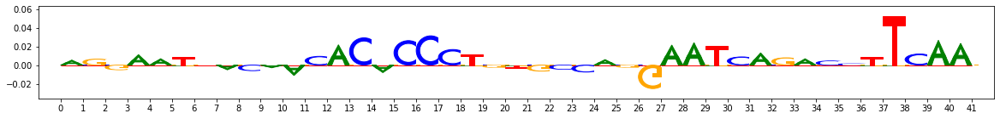

index 66590 example:102,start:498,end:539,rc:True
Features: [ 1.60670514e-03  2.15728714e-02  8.61504226e-03  1.15531778e-02
  1.81635480e-02  1.18046967e-02  1.23171162e-02  1.47787591e-04
  1.23389610e-02 -2.00136761e-02  1.03432073e-01  1.45541689e-01
  1.08923278e-01  7.77614436e-02  1.57705212e-01  1.22597388e-01
  1.14557240e-01  8.77289578e-02  7.73750002e-02  1.58039616e-01
  1.31583748e-02  1.65348132e-02  1.20791047e-02  8.29673886e-03
  4.34095398e-02  4.96666671e-03  2.73175494e-02  2.85524261e-02
  1.95558177e-02  1.85494206e-02  2.65551680e-02  3.98334249e-02
  2.96703663e-02  3.18140793e-02  4.08913300e-02  3.44237190e-02
  3.02516217e-02  3.59449616e-02  2.28262164e-02  3.11764235e-02
  5.39578324e-02  5.14366901e-02  9.92385378e-02  5.95888737e-02
  3.00359006e-02  1.36377340e-01  5.99831646e-02  7.98756882e-02
  8.16309968e-02  6.82839558e-02  1.82607246e-01  1.45739601e-01
  1.44988502e-01  1.13132307e-01  1.95018769e-01  1.37696876e-01
  1.03399304e-01  1.24169432e-

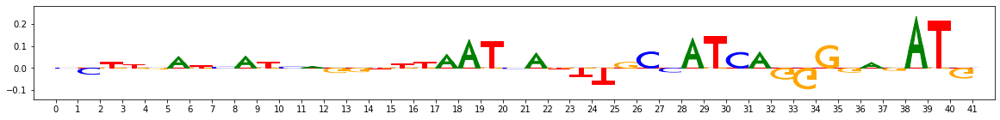

index 70609 example:2,start:591,end:632,rc:False
Features: [0.11942557 0.12369296 0.11804602 0.11549421 0.09810944 0.12668291
 0.13305359 0.11097633 0.1489003  0.1566773  0.13812269 0.10023598
 0.1489149  0.11606103 0.12120007 0.13042231 0.1463901  0.11605276
 0.11994492 0.12807919 0.04640406 0.04572413 0.05145336 0.03923113
 0.04368251 0.0357906  0.06633582 0.06192656 0.04130818 0.07332206
 0.02840909 0.03599773 0.03377211 0.05096454 0.07426804 0.04489682
 0.04972396 0.06046834 0.0417691  0.05559604 0.06065355 0.03592578
 0.04877517 0.01412476 0.02872901 0.07656704 0.07081827 0.03070693
 0.02328261 0.03199678 0.06264274 0.07143419 0.04418988 0.05716596
 0.04940712 0.04523287 0.05130251 0.07376444 0.05948233 0.07485829
 0.0531273  0.04407761 0.04362953 0.04212762 0.04489548 0.02149744
 0.02166303 0.04205106 0.01843655 0.01996942 0.05065729 0.08349873
 0.05155681 0.02650172 0.06112575 0.07498062 0.06508848 0.04098631
 0.07384896 0.20785959 0.23102717 0.11930757 0.156277   0.07808617
 0.

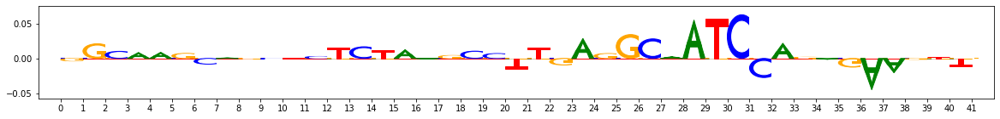

index 81430 example:24,start:468,end:509,rc:True
Features: [0.0565219  0.065611   0.04855237 0.06049142 0.05448501 0.05753607
 0.08261596 0.03761733 0.08244868 0.0520848  0.1107935  0.13030385
 0.15122911 0.11173475 0.14232908 0.17538468 0.14817905 0.13046249
 0.08542453 0.13328215 0.01936046 0.01806083 0.01962984 0.00715554
 0.0139805  0.00316697 0.02342188 0.01705312 0.01647297 0.01249281
 0.03852752 0.04701436 0.02260136 0.0263679  0.03234971 0.03574508
 0.01366829 0.02449114 0.01744395 0.04077163 0.10757527 0.10288974
 0.06864303 0.08587044 0.04855669 0.09954588 0.04457921 0.06905396
 0.07250141 0.12202742 0.13040206 0.12779123 0.08092574 0.0606236
 0.21590637 0.06689808 0.07429081 0.13794462 0.21499786 0.08836647
 0.10913563 0.085977   0.12355871 0.14374201 0.10125912 0.10748177
 0.09129003 0.12001954 0.07559243 0.09729257 0.04427487 0.08347553
 0.07143784 0.08920761 0.09285228 0.09617581 0.03838021 0.04497573
 0.13620233 0.2311038  0.23637709 0.09972785 0.18599863 0.06596672
 0.2

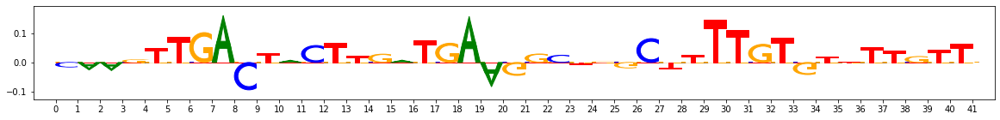

Sample false negative seqlets:
index 103062 example:909,start:475,end:516,rc:False
Features: [ 0.05027356  0.05896728  0.04891921  0.05924417  0.06310117  0.05291245
  0.06437977  0.04470807  0.05908861  0.04172635  0.14074877  0.15728136
  0.12799039  0.12837626  0.1682294   0.14121937  0.12530543  0.10607041
  0.11219858  0.12725156 -0.01521633 -0.03270292 -0.03219684 -0.02976408
 -0.00262886 -0.03164224 -0.0233195  -0.0255221  -0.02745179 -0.02222005
 -0.02358895 -0.02245579 -0.02044156 -0.02543587 -0.01755036 -0.02088908
 -0.01736572 -0.02532147 -0.01918245 -0.02142231  0.11930798  0.11592351
  0.16130674  0.10803079  0.1080522   0.16514824  0.10937694  0.12643685
  0.13460788  0.1096747   0.13999276  0.1354841   0.11314769  0.0759785
  0.22867643  0.05585883  0.08198475  0.17520469  0.24986915  0.0979521
  0.06000311  0.11549651  0.07511647  0.030717    0.12902804  0.04244825
  0.07977317  0.08881805  0.05847916  0.06091849  0.05703033  0.05270148
  0.09505004  0.06426209  0.05686

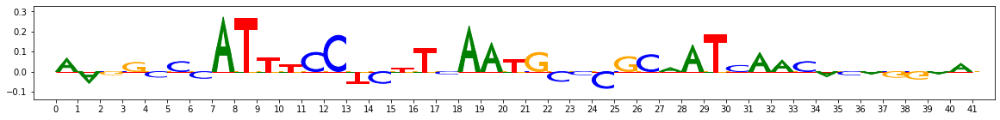

index 103537 example:36,start:572,end:613,rc:True
Features: [ 1.70302407e-03  1.36754921e-02  6.29337490e-03  1.49359900e-02
  1.47912784e-02  1.41798185e-02  1.63987483e-02  5.90556766e-03
  9.27349384e-03 -7.39468457e-03  4.75463335e-02  6.60584750e-02
  3.48392421e-02  4.00059588e-02  8.06404015e-02  7.05554026e-02
  4.66180582e-02  6.53552040e-02  2.18971946e-02  7.46461841e-02
  1.55980623e-02  3.21244331e-02  1.02673991e-02  1.35737814e-02
  5.31829383e-02  1.58732387e-02  3.34397203e-02  3.71899711e-02
  3.36250846e-02  2.82582314e-02  4.45226683e-02  4.59447342e-02
  1.80953690e-02  3.01669756e-02  4.50940737e-02  1.43402026e-02
  2.36476963e-02  2.92565014e-02  2.04175565e-02  3.29505302e-02
  5.94644488e-02  9.59847409e-02  6.16201065e-02  6.94087385e-02
  5.26022605e-02  7.63340685e-02  5.89197903e-02  5.56041305e-02
  8.66862166e-02  9.06189338e-02  1.52149245e-01  1.01129327e-01
  1.16572726e-01  7.87158621e-02  1.67600162e-01  8.58774520e-02
  8.75766997e-02  1.08693836e-

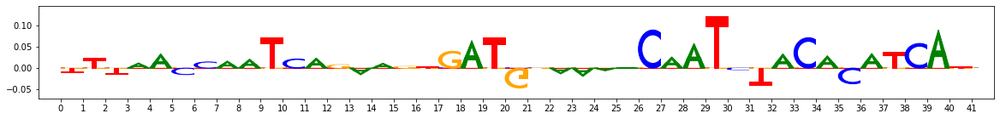

index 104012 example:168,start:418,end:459,rc:True
Features: [ 0.03482141  0.04107687  0.04751324  0.05450991  0.04486976  0.04544413
  0.05226982  0.03644264  0.04771311  0.03761012  0.05860413  0.06668214
  0.0610171   0.04818851  0.07511392  0.09540194  0.05290793  0.08177558
  0.02495954  0.05825822  0.00408015  0.00880153 -0.00070694  0.00166586
  0.01369773 -0.00427987  0.01467924  0.02281202  0.01044315  0.03571157
  0.04834803  0.08135798  0.05930706  0.07009374  0.06855381  0.08412584
  0.04584257  0.07525175  0.05188086  0.06512611  0.02328435  0.08384483
  0.03804729 -0.00047844  0.02554363  0.07455619  0.02290117  0.0489275
  0.0340469   0.05713867  0.10902757  0.09505744  0.06478821  0.05983633
  0.12397278  0.06600605  0.06929073  0.10974063  0.10925305  0.0684267
  0.08075343  0.13231071  0.08864512  0.07816666  0.11616789  0.07688627
  0.10389161  0.10529936  0.08901884  0.06658041  0.04202305  0.03578564
  0.0709478   0.07848455  0.06832571  0.09538817  0.02663423  0.0

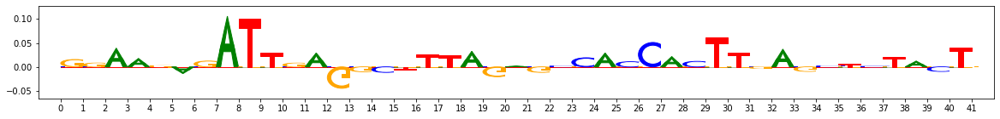

index 104487 example:1098,start:555,end:596,rc:True
Features: [ 0.0627439   0.05631548  0.05631965  0.05522695  0.04942498  0.06665251
  0.06775616  0.05311773  0.06476441  0.06441541  0.02710117 -0.00176736
  0.02113905  0.00632266 -0.00170737  0.05400501  0.03983546  0.04100322
  0.00754356  0.0158481   0.00177583  0.03354752  0.00561861  0.00926293
  0.03488742  0.00516717  0.07135169  0.01652084  0.00884298  0.01931114
  0.01727045  0.02699221  0.00949253  0.01251059  0.02644332  0.03018314
  0.00533056  0.02990979  0.00631351  0.02357876  0.09325209  0.05989393
  0.07648232  0.06532509  0.04482501  0.11311143  0.07662355  0.05085012
  0.05635479  0.05549135  0.11701089  0.10705639  0.09104577  0.12494034
  0.08431602  0.08866807  0.13385618  0.0867844   0.11649829  0.14426971
  0.02652191  0.06558564  0.00294488  0.08535062  0.06272133  0.04868755
  0.01211889  0.06605932  0.01096351  0.00432802  0.04555751  0.04412045
  0.03606931  0.04060425  0.051331    0.09979974  0.03029072  

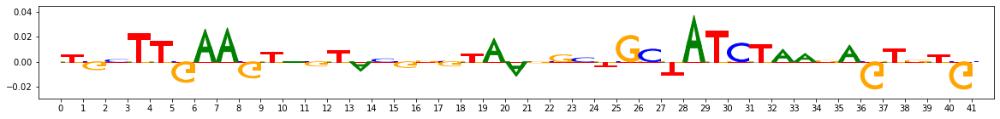

index 104962 example:537,start:516,end:557,rc:False
Features: [ 0.00231324  0.01930168  0.02490375  0.01807092  0.01767053  0.01173862
  0.01887097  0.01382126  0.01990204  0.01407546  0.08023784  0.07526544
  0.08998727  0.08720655  0.08486641  0.07167065  0.08974729  0.05498733
  0.0507858   0.04503045 -0.00147504  0.01519373  0.0242291   0.00308854
  0.02425351  0.00109476  0.02874688  0.00308964  0.01266514  0.01918848
  0.01148578  0.02435365  0.01823782  0.03681798  0.03111566  0.02141474
  0.01889009  0.02516887  0.02201247  0.01681664  0.01318346  0.01036976
  0.07545424  0.00769998  0.01066521  0.12966594  0.01050849  0.06296535
  0.03864024  0.00220854  0.099526    0.10781784  0.06804408  0.07202379
  0.1317779   0.0533477   0.06840839  0.13764563  0.11302988  0.09653112
  0.01726168  0.04386994  0.04132037 -0.02908422  0.04124978  0.0045813
  0.03096694  0.03324545  0.02684514  0.02472369  0.02589256  0.02238941
  0.05323819  0.04583619  0.02538044  0.03143756  0.03566238  0

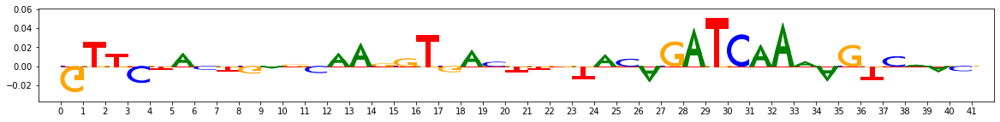

index 105437 example:1002,start:467,end:508,rc:False
Features: [ 7.07520747e-02  4.89436872e-02  7.08470372e-02  6.14342478e-02
  5.89119574e-02  5.92209340e-02  5.89774997e-02  5.42108247e-02
  8.80322276e-02  6.48124308e-02  7.48998213e-02  9.70551259e-02
  7.12185114e-02  5.12804176e-02  9.99113569e-02  8.16026723e-02
  7.42066996e-02  3.71254628e-02  4.51573870e-02  9.18918410e-02
 -1.78293043e-03  2.04427183e-02  3.15693372e-03 -8.16990360e-03
  3.08003545e-02 -3.64127697e-03  1.55723098e-02  5.12394549e-03
  2.00989822e-02  1.16557942e-02  2.14989662e-02  5.48916917e-02
  3.46242341e-02  3.17515067e-02  3.21976021e-02  6.62011575e-02
  1.44893583e-02  3.39950149e-02  2.80021460e-02  3.04195645e-02
  6.41147384e-02  9.04212697e-02  1.06146186e-01  3.84358487e-02
  5.15011089e-02  1.19869278e-01  7.19396022e-02  7.90329064e-02
  7.24756515e-02  9.30054072e-02  1.48924945e-01  1.23197974e-01
  9.62423409e-02  1.15520911e-01  1.46265436e-01  7.03691321e-02
  9.72768556e-02  1.3509127

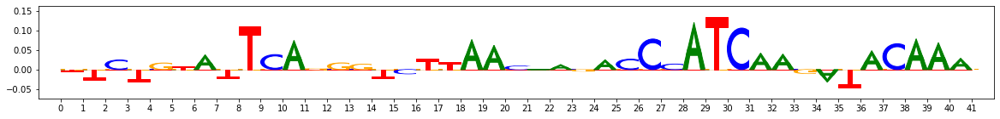

In [140]:
from matplotlib import pyplot as plt
from modisco.visualization import viz_sequence
from sklearn.metrics import (average_precision_score,
                             precision_recall_curve)

def plot_embedding(embedding, **kwargs):
    plt.scatter(*zip(*embedding),**kwargs)
    
def color_by_correctness(values):
    return ["black" if x==0 else "green" for x in values]

for pattern_idx in range(len(trimmed_patterns)):
    print("-------------------------------------------------------")
    print("PATTERNIDX", pattern_idx, "numseqlets", len(trimmed_patterns[pattern_idx].seqlets))
    viz_sequence.plot_weights(trimmed_patterns[pattern_idx]["Nanog_profile_wn_contrib_scores"].fwd)
    viz_sequence.plot_weights(trimmed_patterns[pattern_idx]["sequence"].fwd)
    viz_sequence.plot_weights(trimmed_patterns[pattern_idx]["sequence"].rev)
    plot_embedding(embedding[labels[:,pattern_idx]==0], alpha=0.003, color="blue")
    plot_embedding(embedding[labels[:,pattern_idx]==1], color="red", alpha=0.1)
    plt.show()
    plot_embedding(embedding[labels[:,pattern_idx]==0],
                   alpha=0.003,
                   c=color_by_correctness(
                      preds[labels[:,pattern_idx]==0]==(pattern_idx+1)))
    plot_embedding(embedding[labels[:,pattern_idx]==1],
                   alpha=0.1,
                   c=color_by_correctness(
                       preds[labels[:,pattern_idx]==1]==(pattern_idx+1)))
    plt.show()
    
    #plot the auPRC curve
    precision, recall, thresholds = precision_recall_curve(
                                        y_true=labels[:,pattern_idx],
                                        probas_pred=preds_proba[:,pattern_idx+1])
    RECALL_THRESHOLD = 0.7
    PREC_THRESHOLD = 0.9
    #Pick the max-recall threshold for which either recall <= 80% OR precision > 0.9
    thresh_prec, thresh_rec, thresh = max([x for x in zip(precision, recall, thresholds)
                                           if x[1] <= RECALL_THRESHOLD
                                              or x[0] >= PREC_THRESHOLD ],  key=lambda x: x[1])
    print("Chosen threshold:",thresh,"Precision:",thresh_prec,"Recall:",thresh_rec)
    
    plt.plot(recall, precision)
    plt.show()
    print("AuPRC:", average_precision_score(y_true=labels[:,pattern_idx],
                                            y_score=preds_proba[:,pattern_idx+1]))
    
    above_threshold_preds = preds_proba[:,pattern_idx+1] >= thresh
    argmax_preds = preds==pattern_idx+1
    
    reconstructed_motif_abovethresh = make_aggregated_seqlet(
        seqlets=[all_coordinates_seqlets[i] for i in np.nonzero(above_threshold_preds)[0]])
    reconstructed_motif_argmax = make_aggregated_seqlet(seqlets=[all_coordinates_seqlets[i] for i in
                                 np.nonzero(argmax_preds)[0]])
    
    print("Reconstructed motif using threshold - numseqlets",len(reconstructed_motif_abovethresh.seqlets))
    viz_sequence.plot_weights(reconstructed_motif_abovethresh["sequence"].fwd)
    print("Reconstructed motif using argmax - numseqlets",len(reconstructed_motif_argmax.seqlets))
    viz_sequence.plot_weights(reconstructed_motif_argmax["sequence"].fwd)
    
    #Visualize some false positives/false negatives at the default threshold
    false_positive_indices = np.nonzero((labels[:,pattern_idx]==0)*argmax_preds)[0]
    false_negative_indices = np.nonzero((labels[:,pattern_idx]==1)*argmax_preds)[0]
    false_positive_seqlets = [all_coordinates_seqlets[i] for i in false_positive_indices]
    false_negative_seqlets = [all_coordinates_seqlets[i] for i in false_negative_indices]
    
    NUM_TO_VIZ = 5
    print("Sample false positive seqlets:")
    for i in range(0, len(false_positive_seqlets),
                   max(int(len(false_positive_seqlets)/NUM_TO_VIZ),1)):
        print("index",false_positive_indices[i],
              str(false_positive_seqlets[i].coor))
        print("Features:", features_matrix[false_positive_indices[i]])
        modisco.visualization.viz_sequence.plot_weights(
            false_positive_seqlets[i]["Nanog_profile_wn_contrib_scores"].fwd)
    
    print("Sample false negative seqlets:")
    for i in range(0, len(false_negative_seqlets),
                   max(int(len(false_negative_seqlets)/NUM_TO_VIZ),1) ):
        print("index",false_negative_indices[i],
              str(false_negative_seqlets[i].coor))
        print("Features:", features_matrix[false_negative_indices[i]])
        modisco.visualization.viz_sequence.plot_weights(
            false_negative_seqlets[i]["Nanog_profile_wn_contrib_scores"].fwd)
        

Pattern number 0
Num seqlets: 750


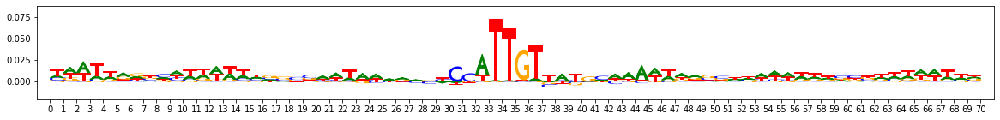

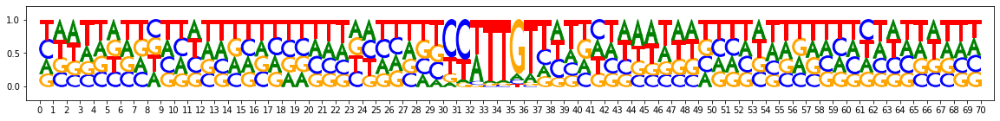

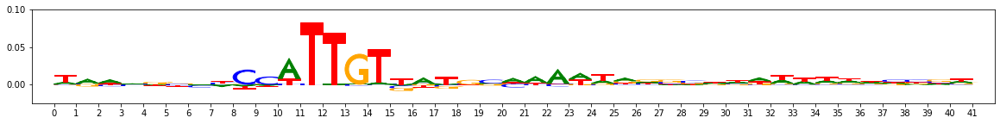

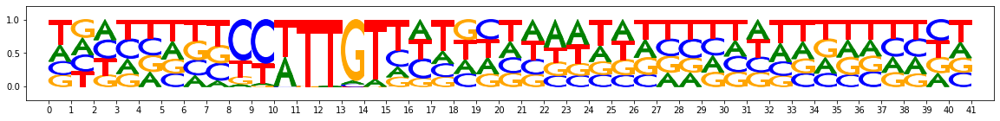

Exemplars


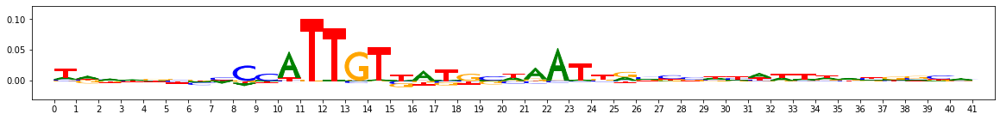

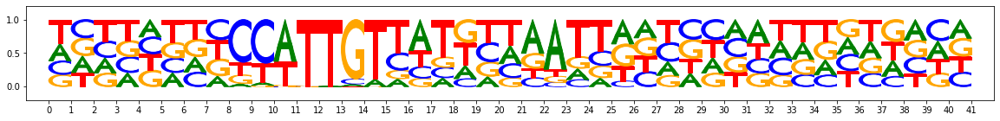

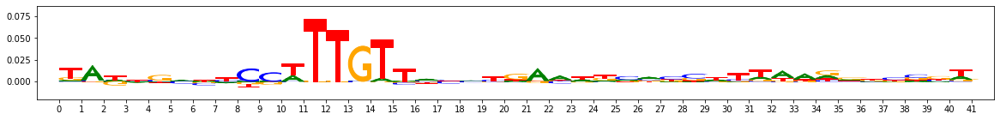

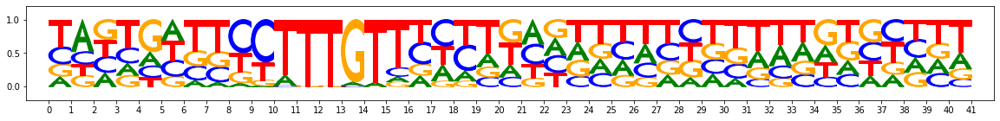

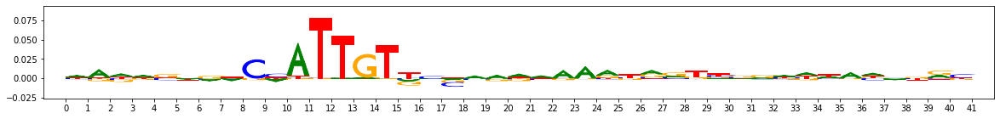

...

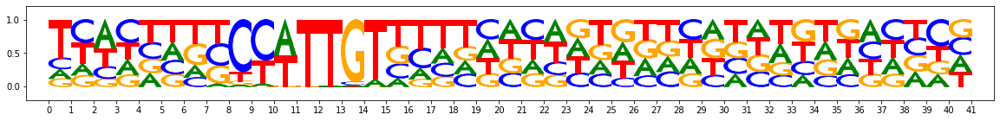

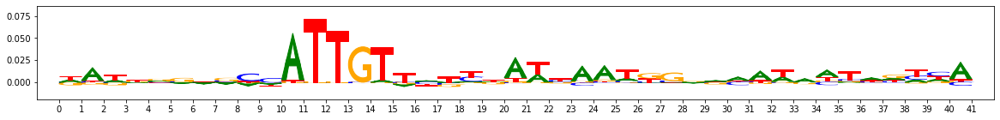

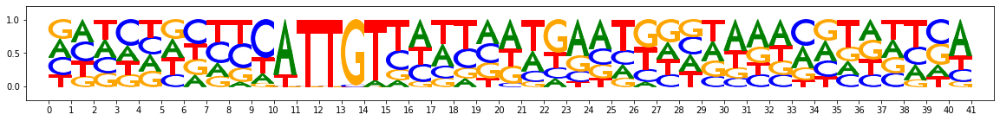

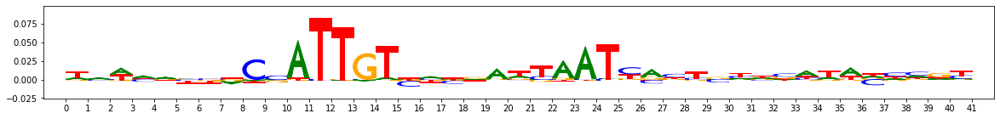

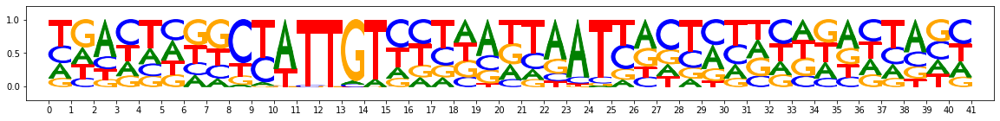

Pattern number 1
Num seqlets: 821


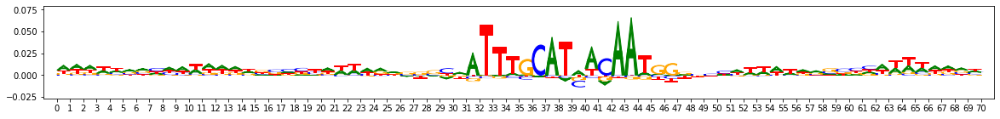

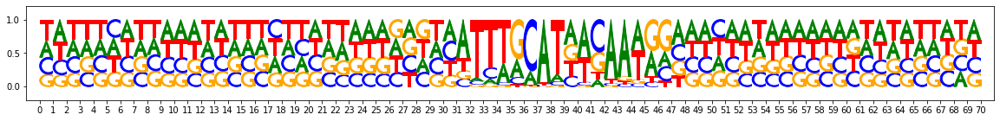

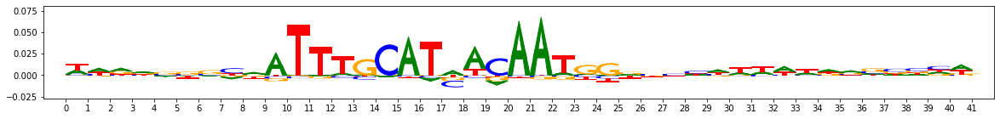

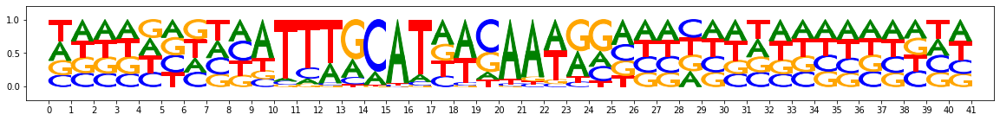

Exemplars


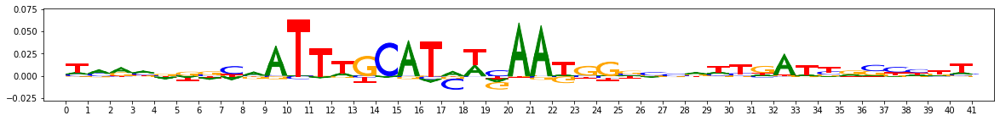

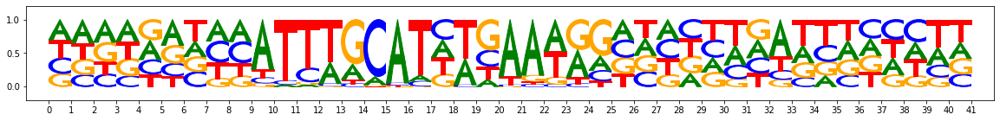

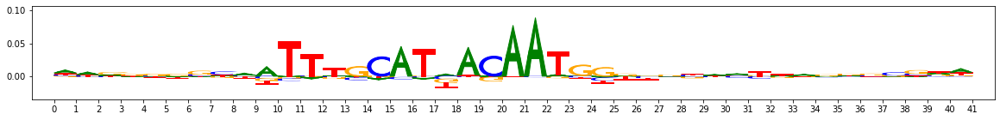

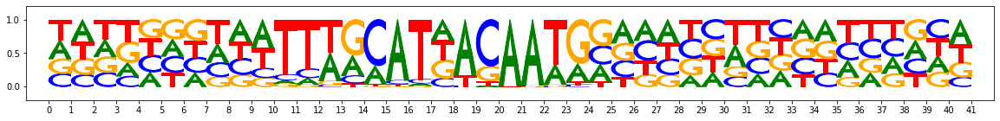

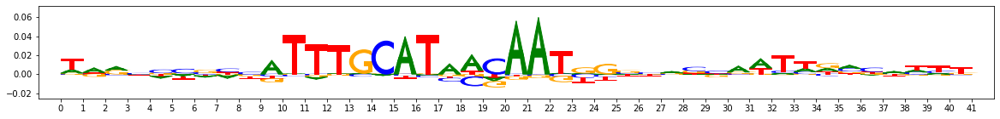

...

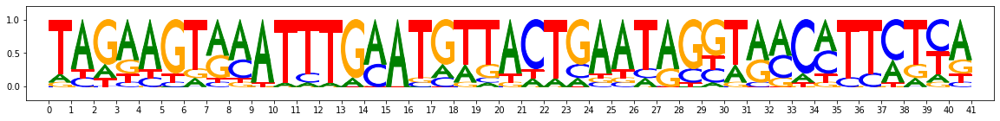

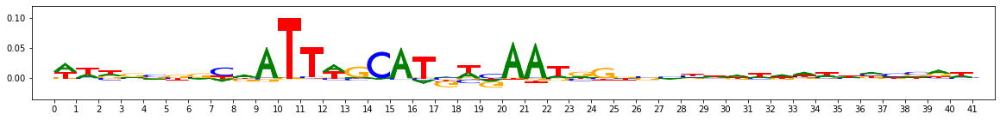

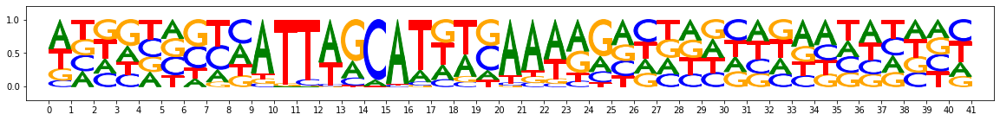

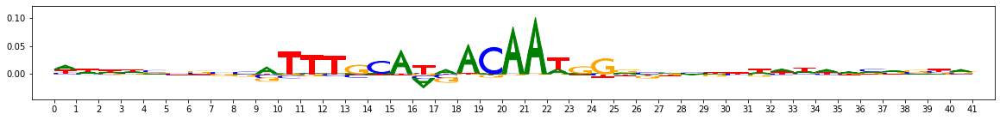

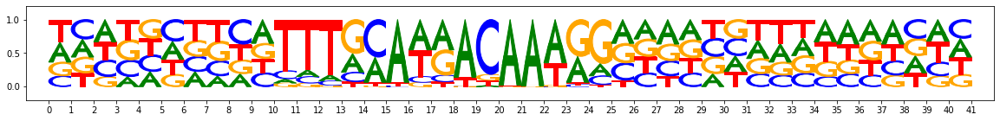

Pattern number 2
Num seqlets: 392


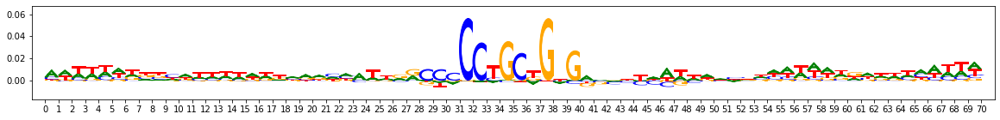

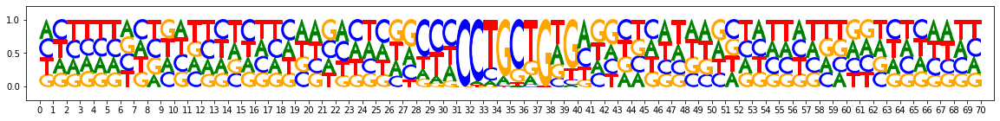

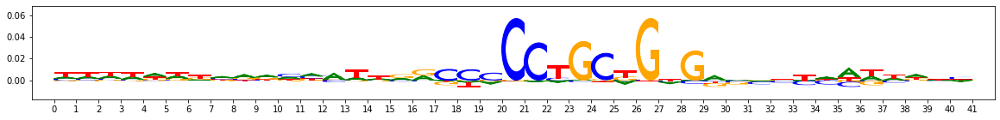

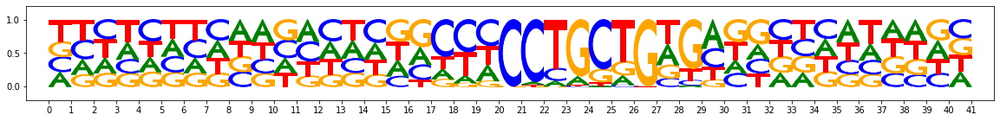

Exemplars


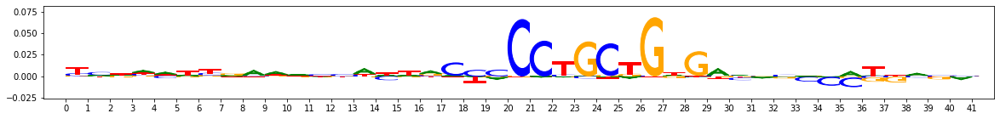

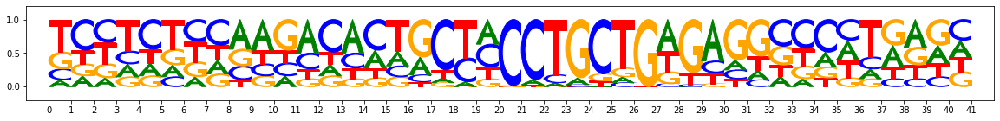

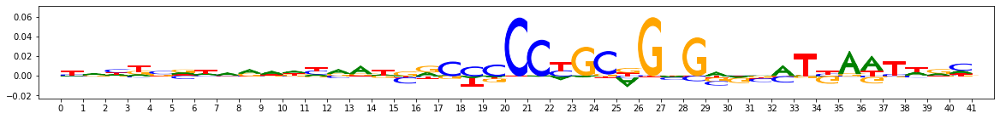

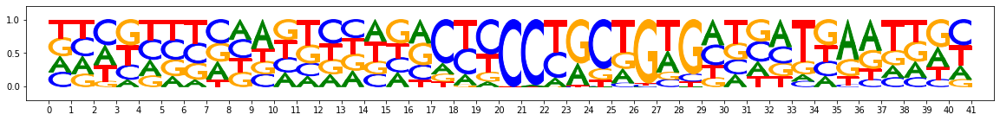

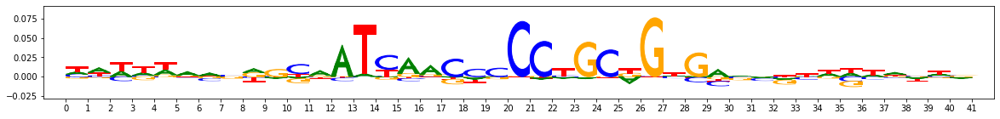

...

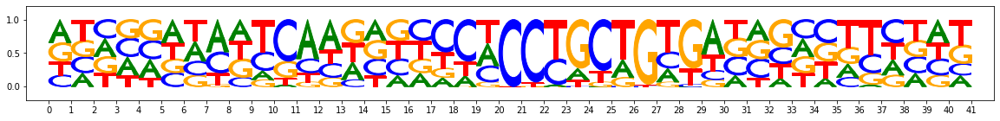

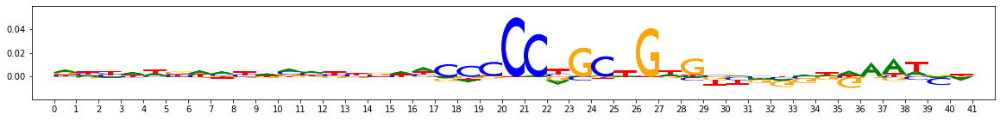

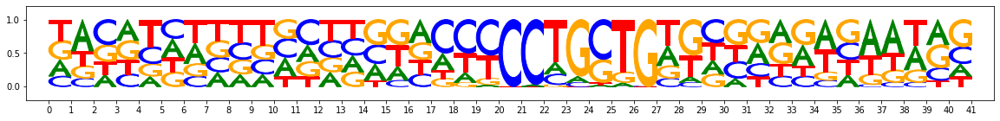

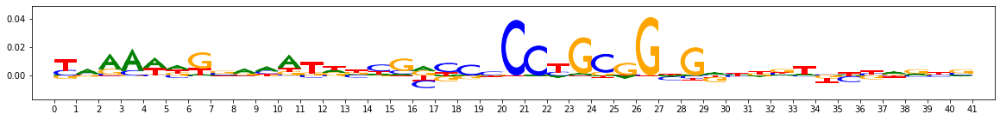

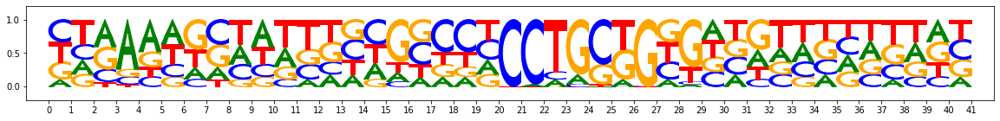

Pattern number 3
Num seqlets: 342


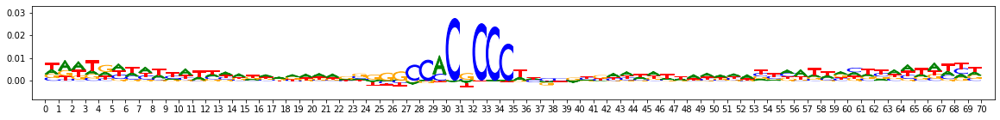

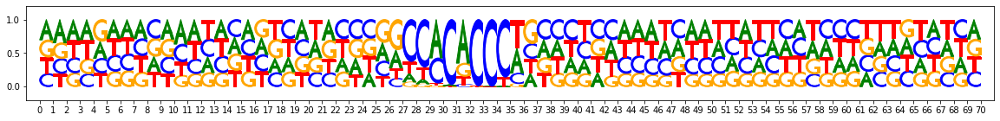

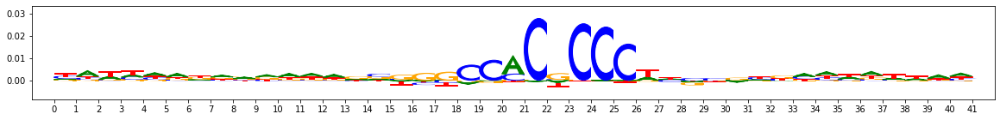

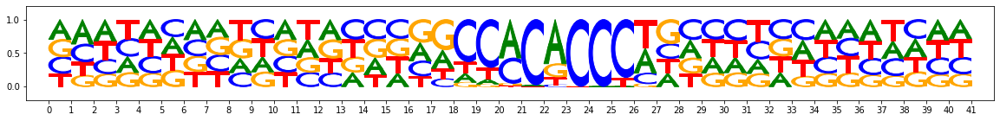

Exemplars


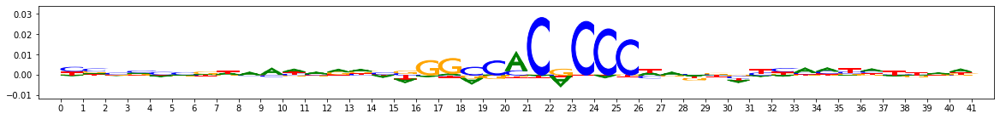

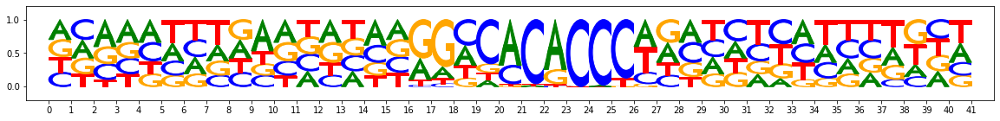

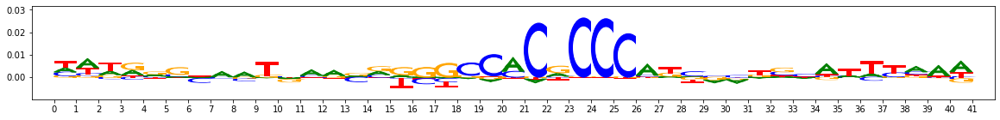

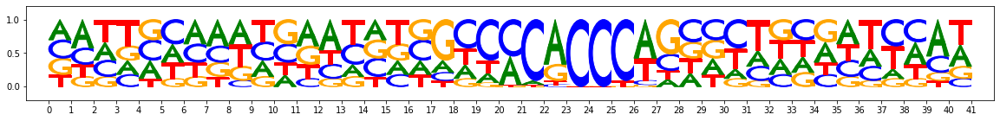

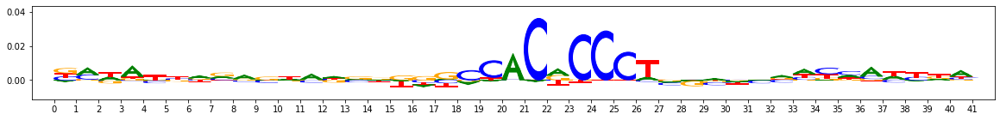

...

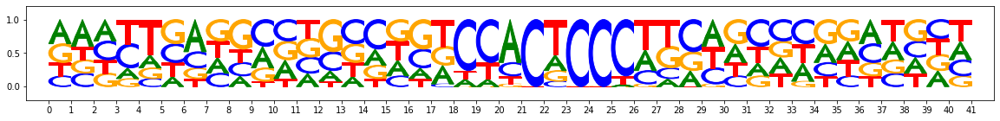

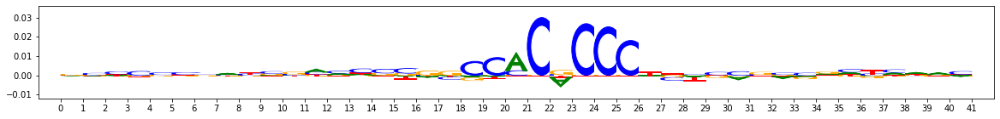

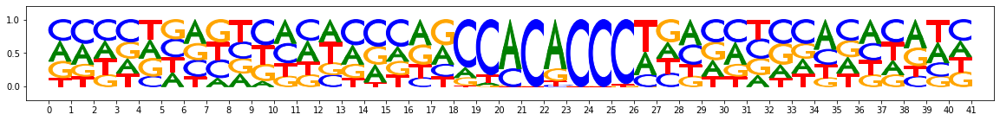

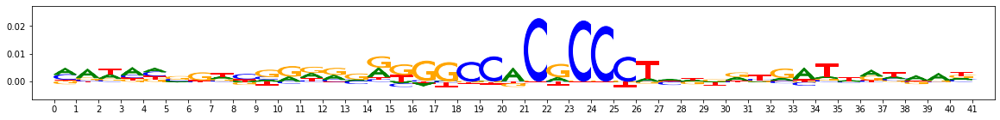

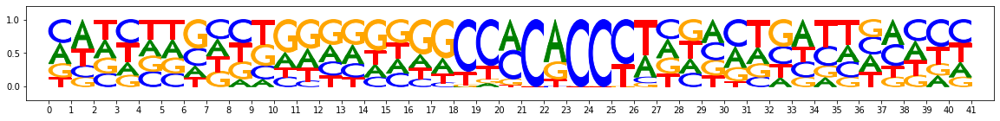

Pattern number 4
Num seqlets: 328


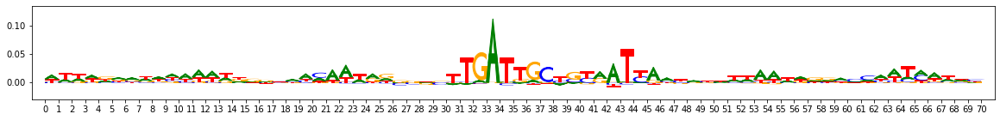

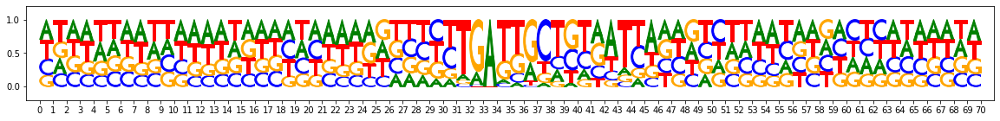

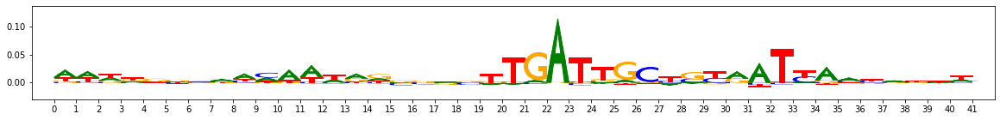

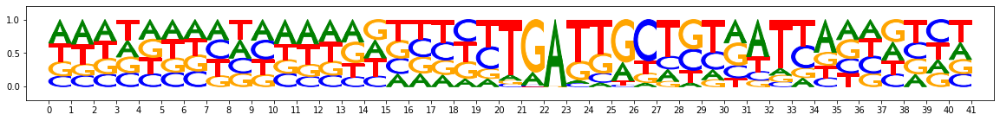

Exemplars


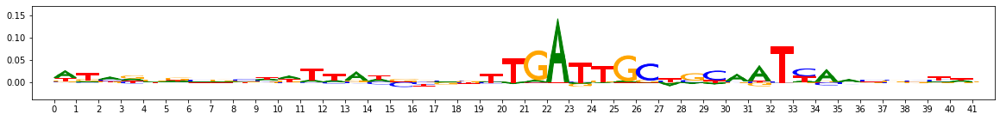

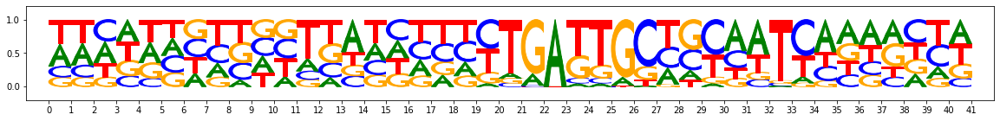

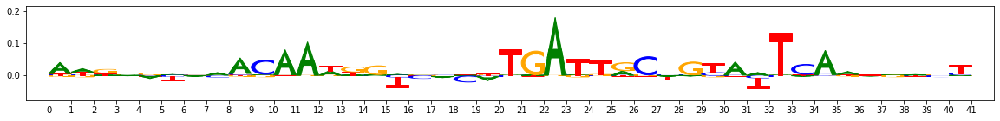

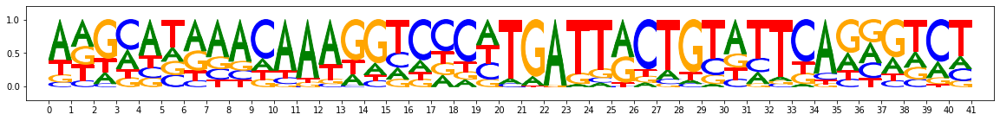

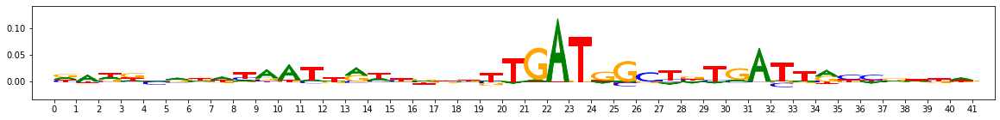

...

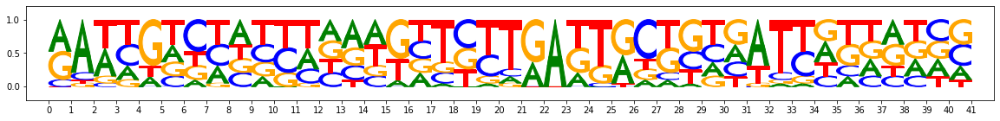

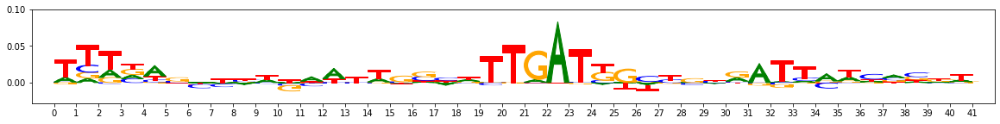

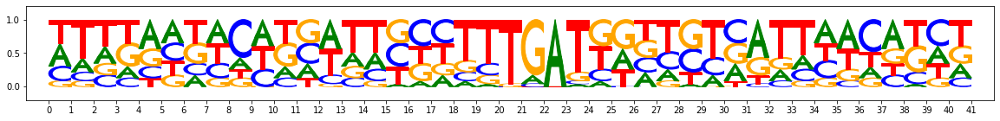

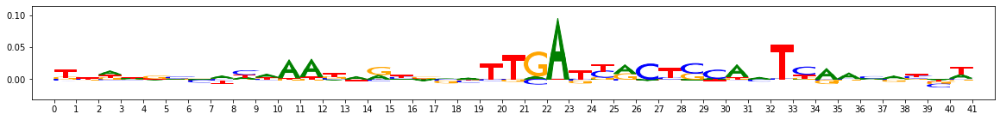

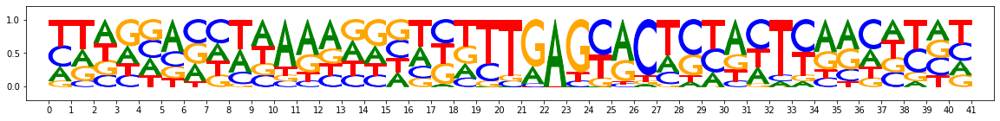

Pattern number 5
Num seqlets: 326


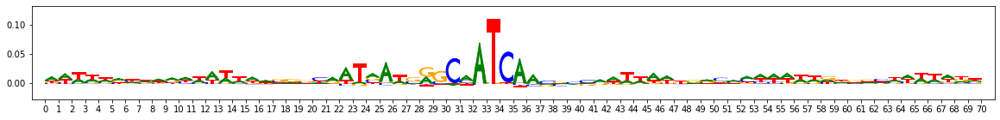

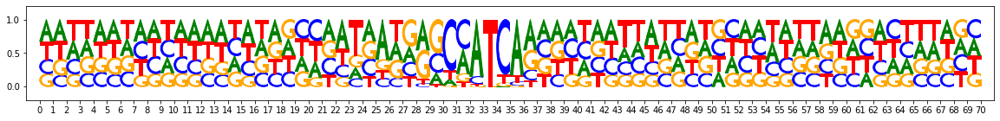

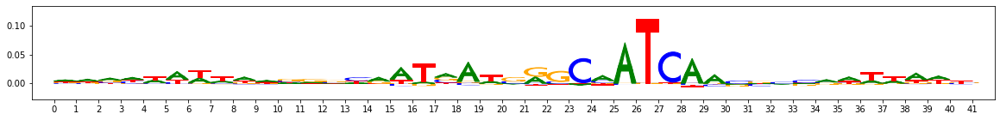

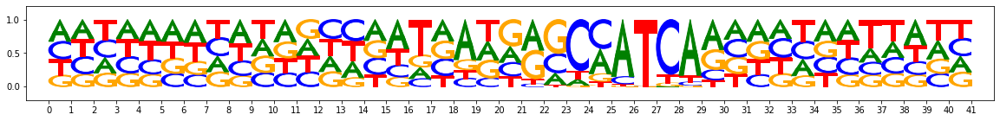

Exemplars


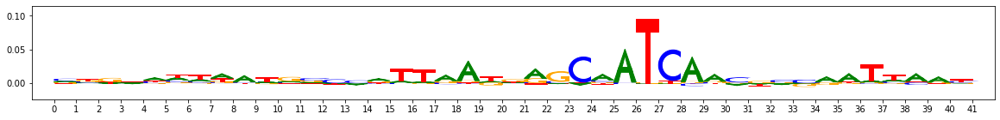

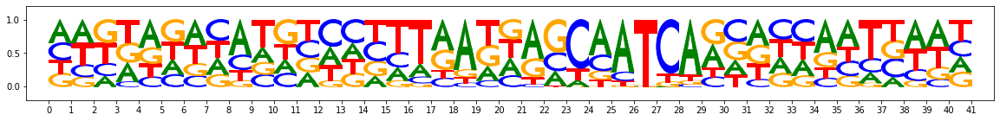

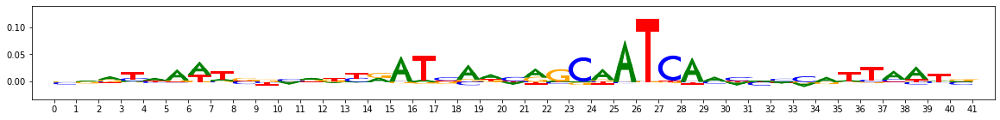

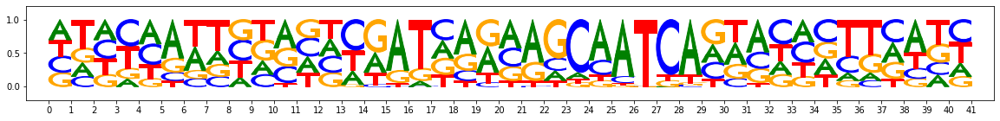

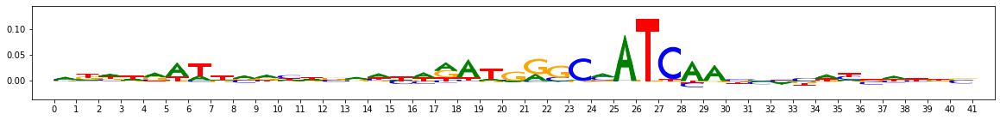

...

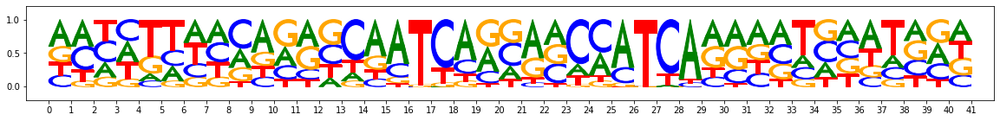

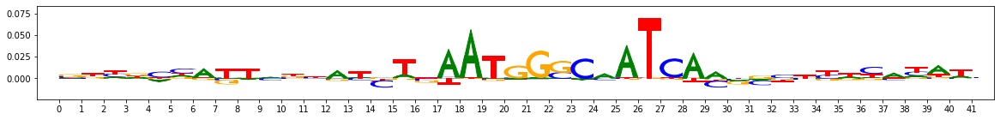

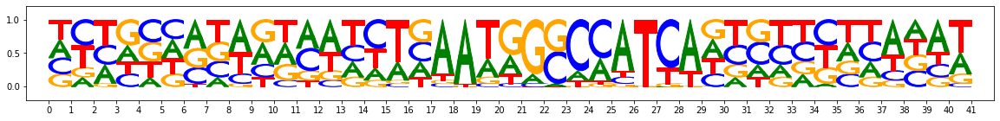

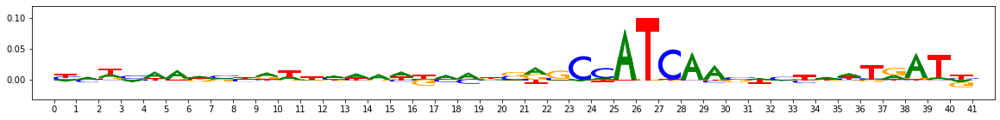

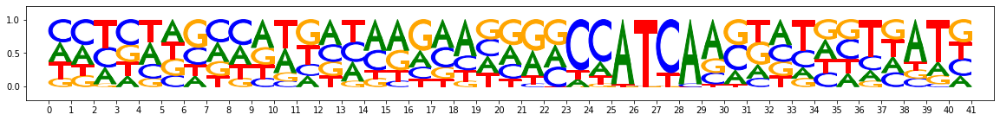

Pattern number 6
Num seqlets: 271


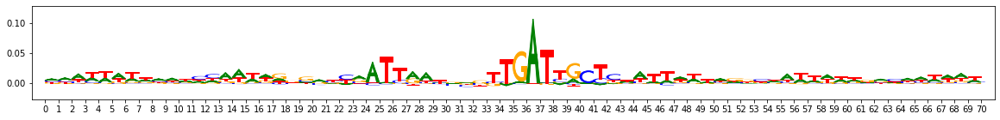

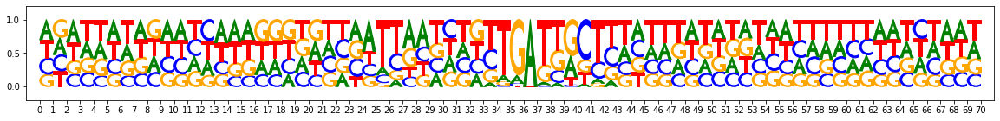

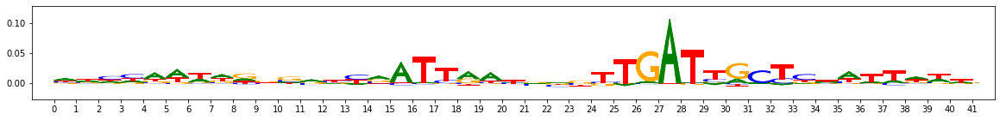

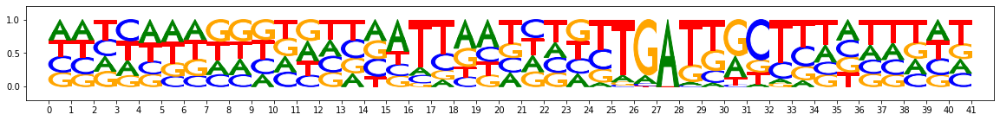

Exemplars


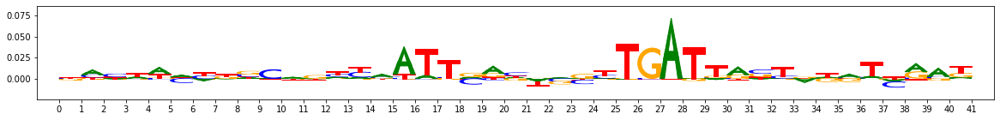

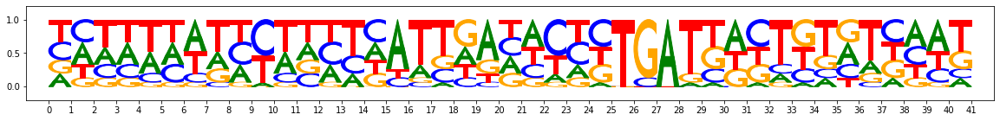

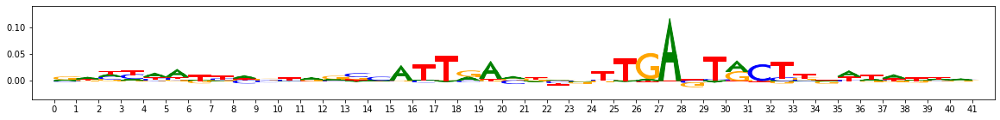

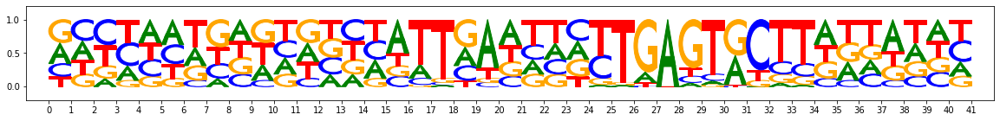

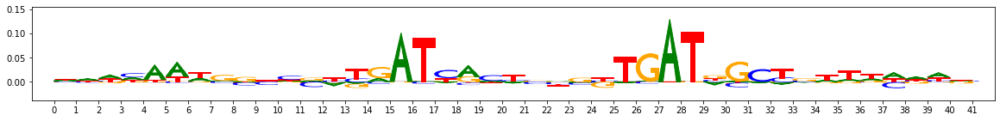

...

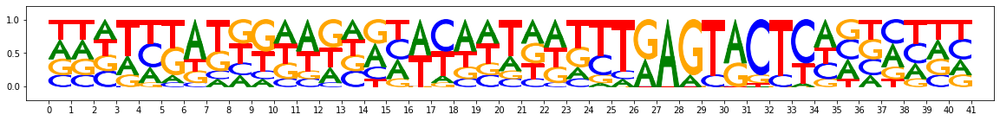

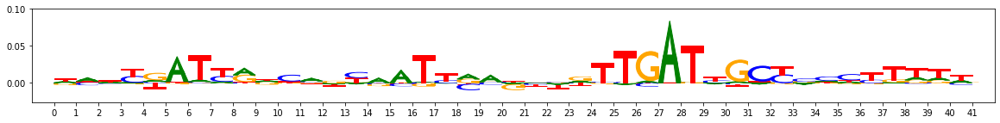

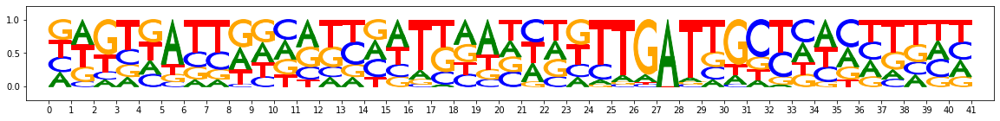

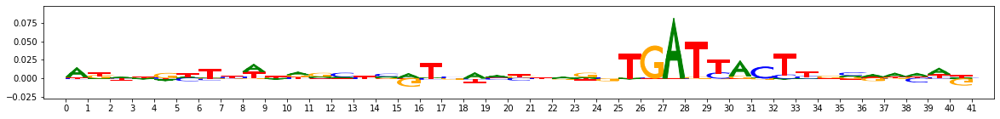

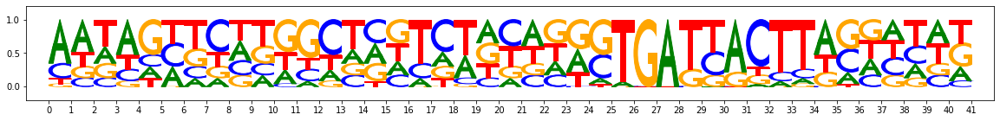

Pattern number 7
Num seqlets: 245


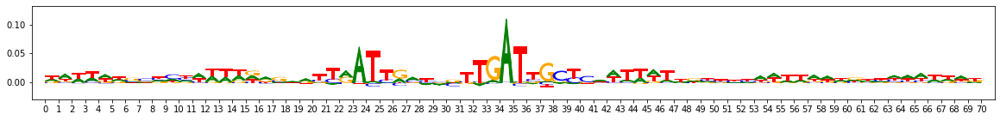

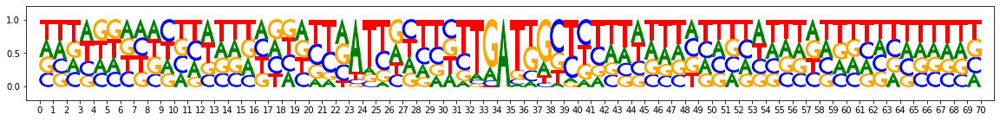

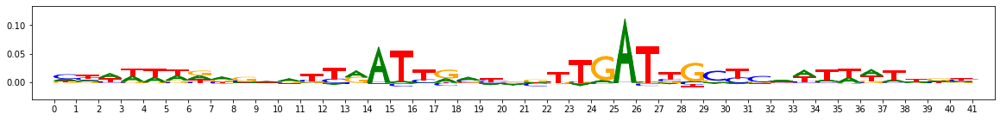

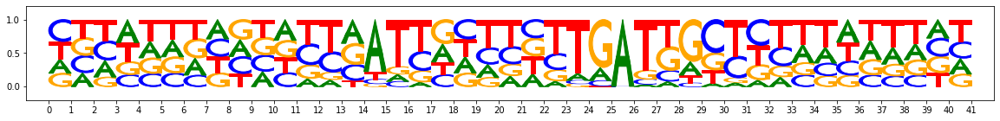

Exemplars


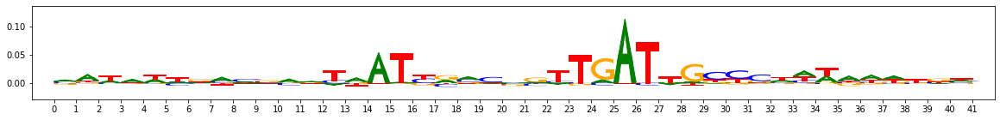

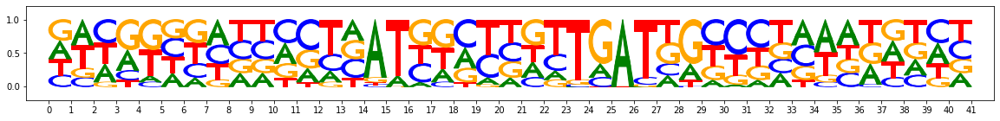

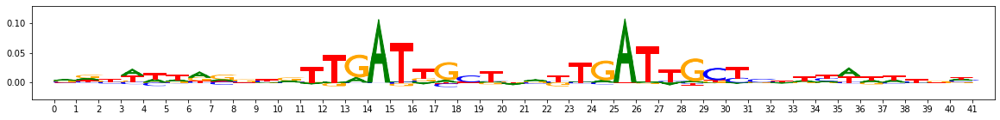

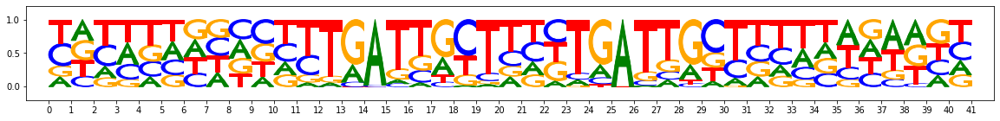

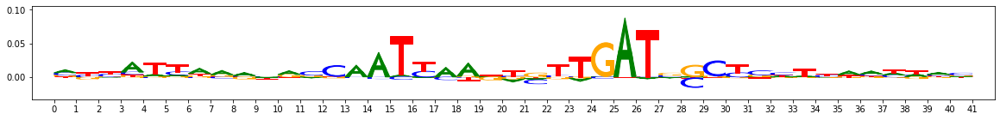

...

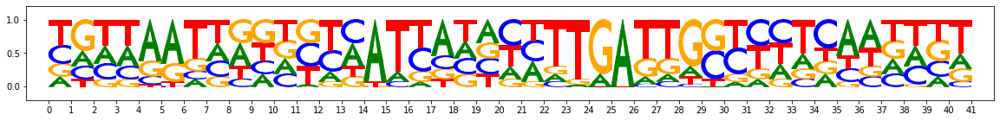

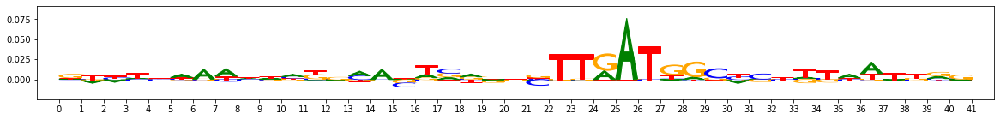

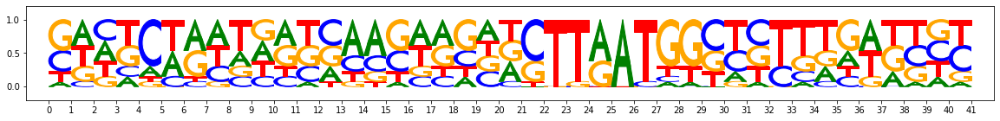

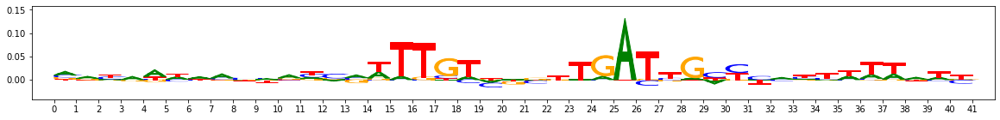

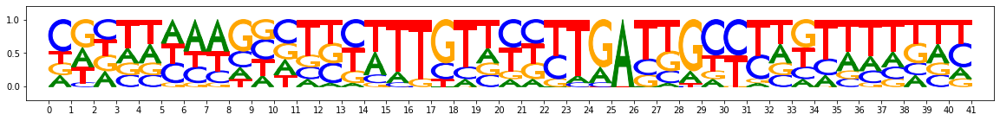

Pattern number 8
Num seqlets: 172


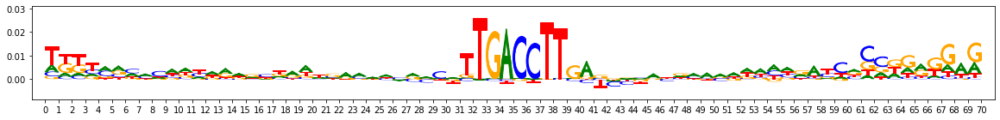

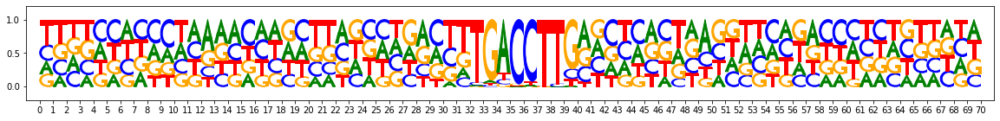

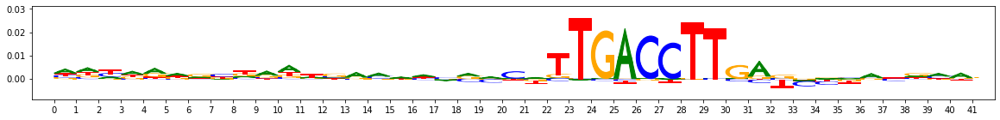

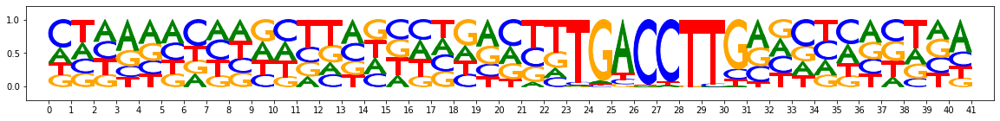

Exemplars


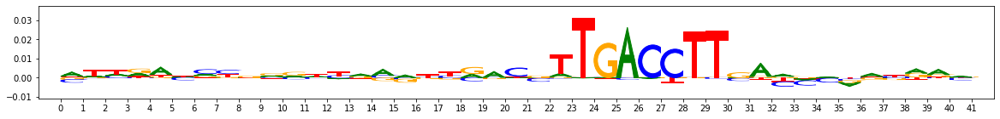

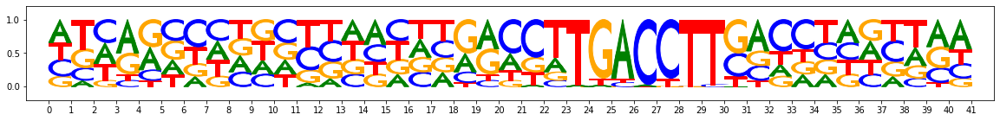

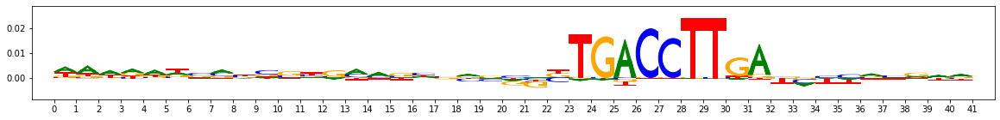

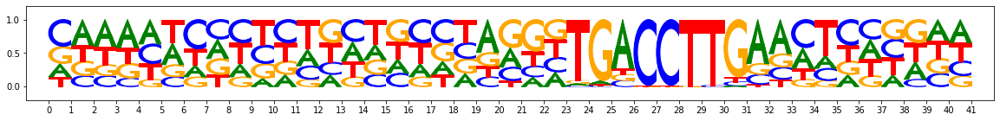

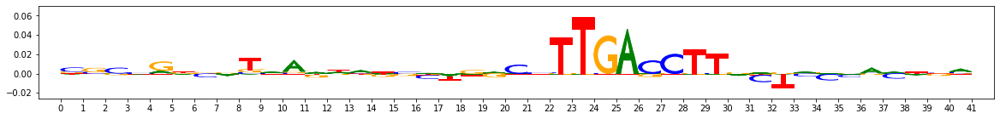

...

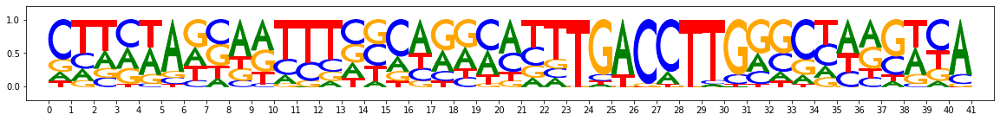

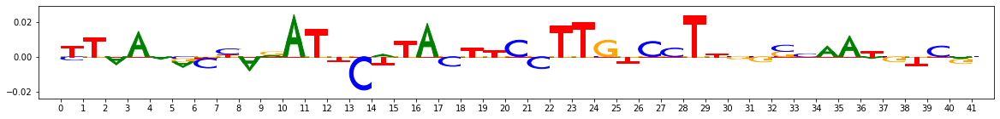

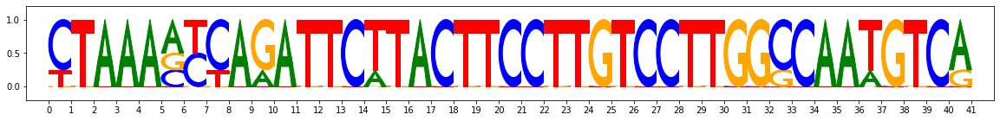

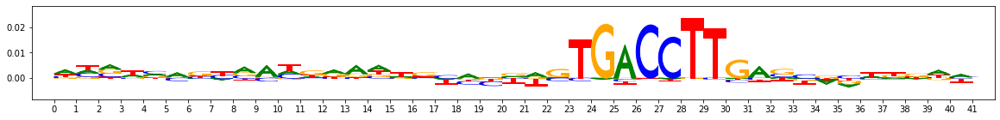

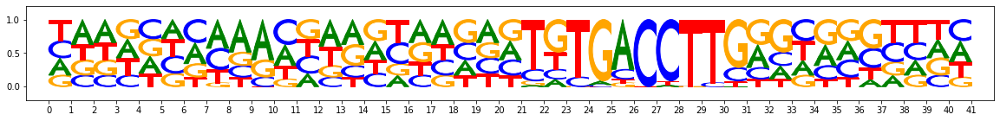

Pattern number 9
Num seqlets: 167


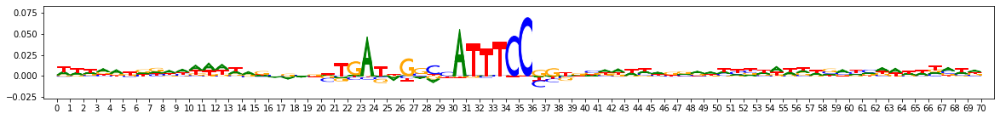

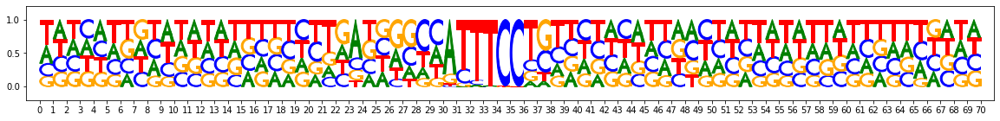

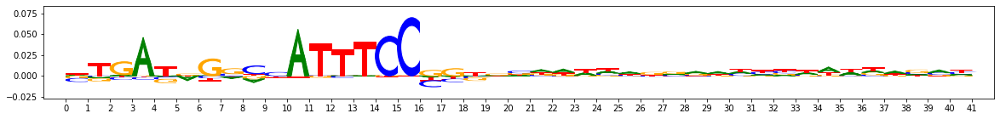

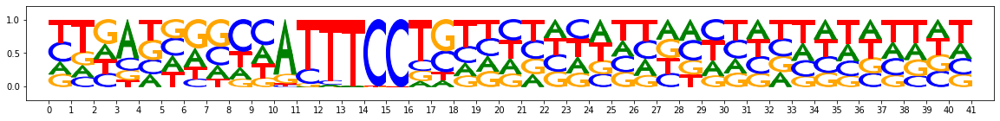

Exemplars


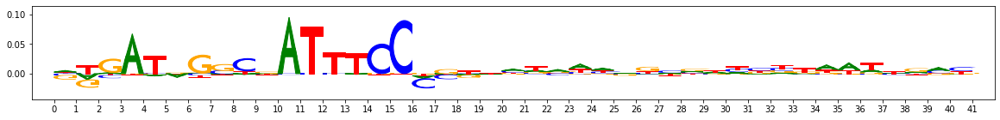

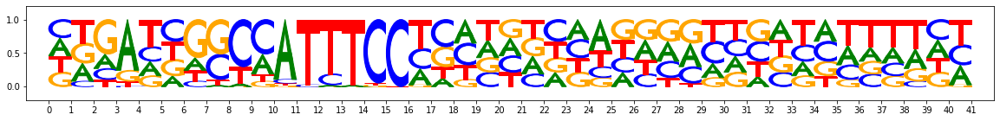

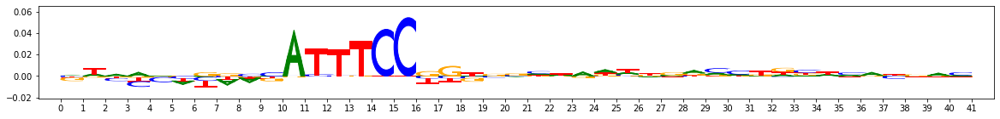

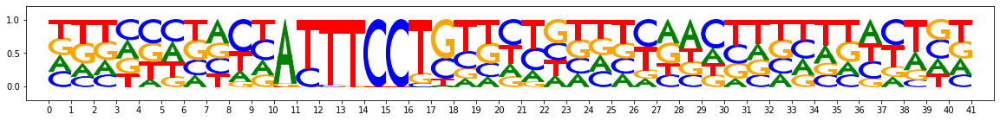

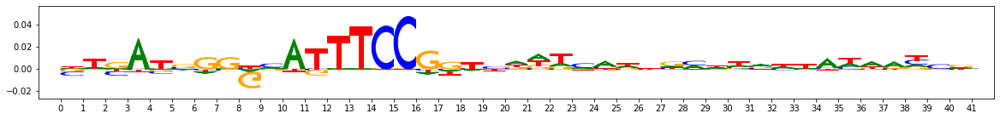

...

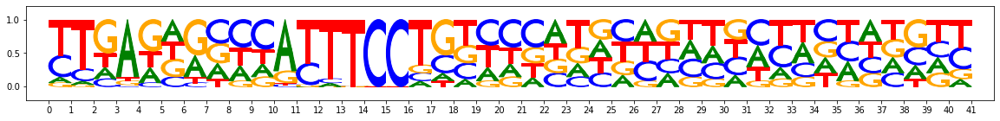

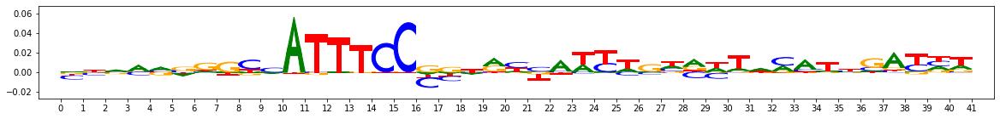

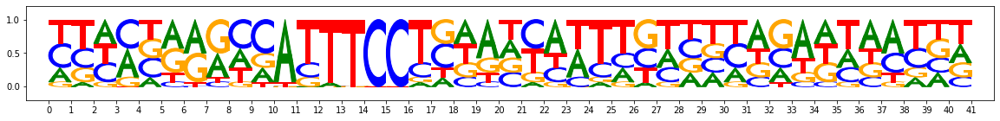

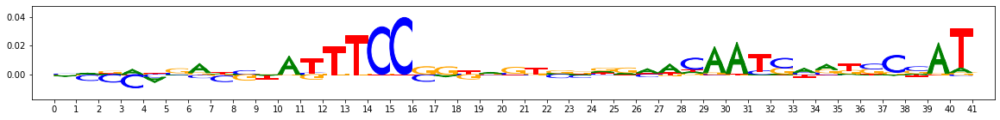

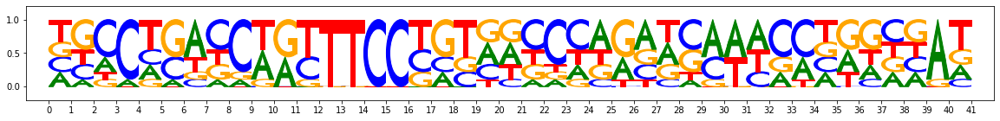

Pattern number 10
Num seqlets: 118


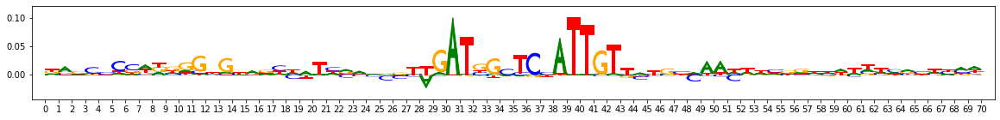

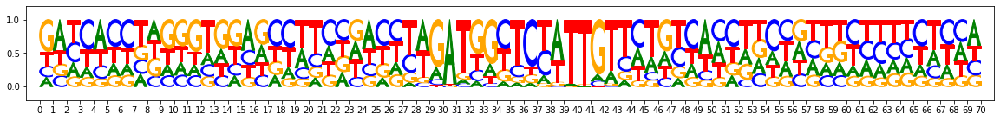

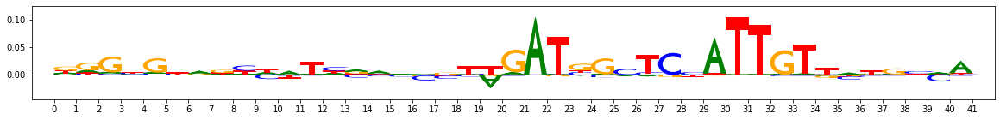

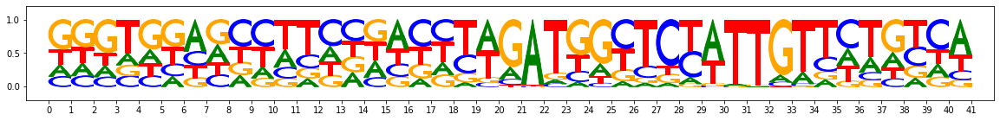

Exemplars


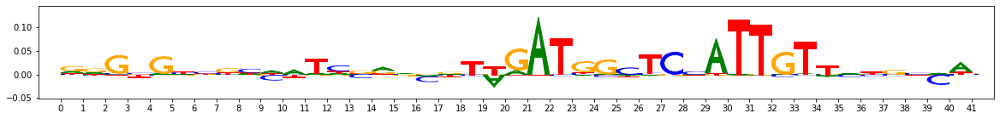

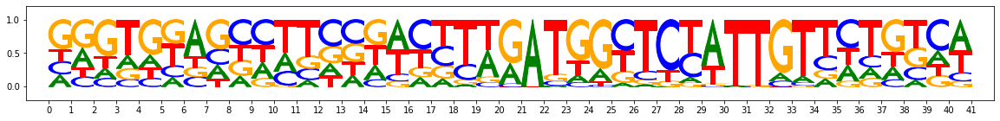

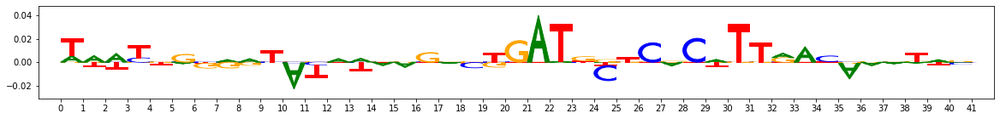

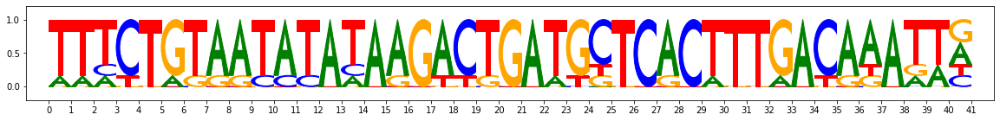

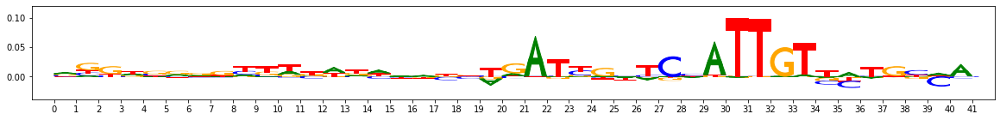

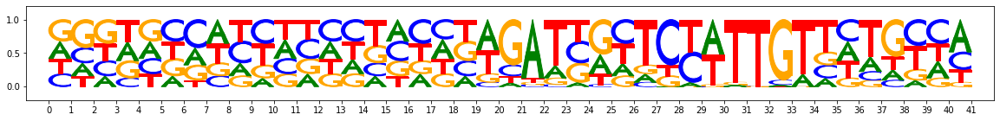

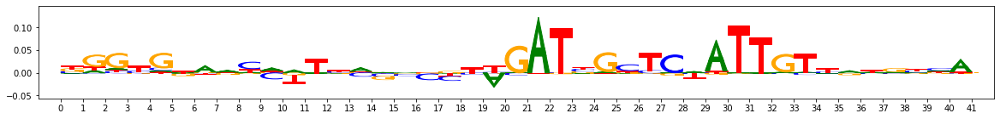

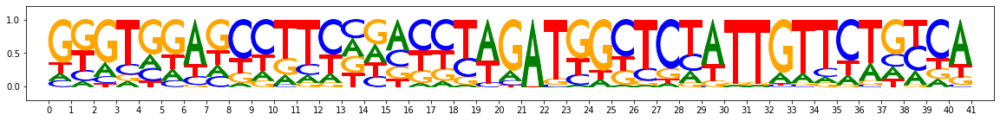

Pattern number 11
Num seqlets: 95


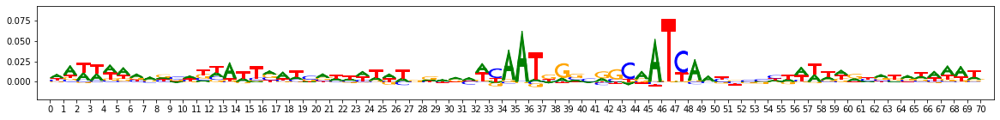

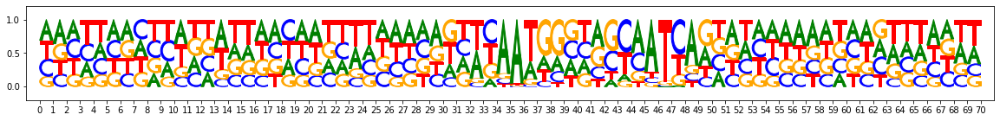

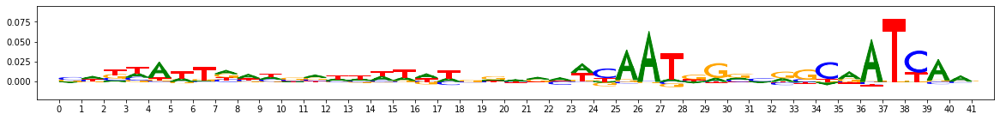

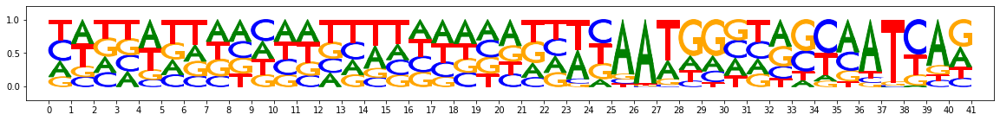

Exemplars


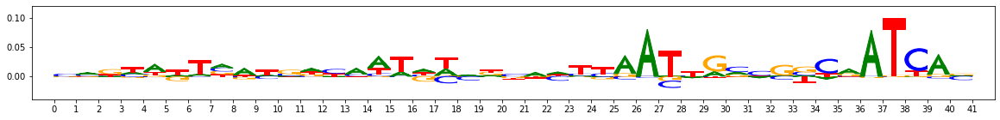

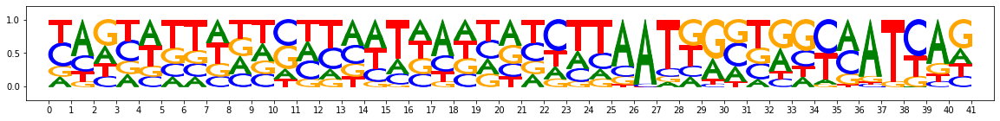

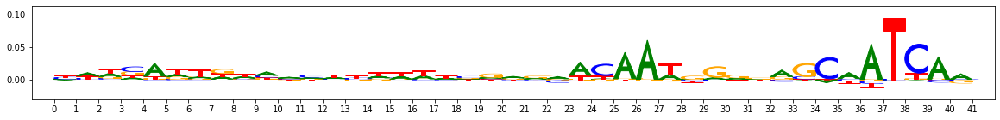

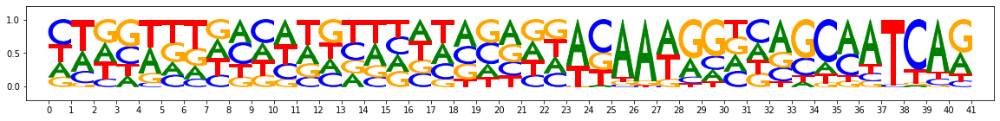

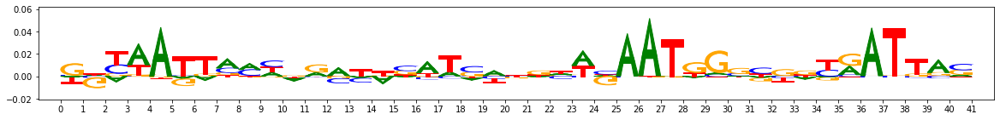

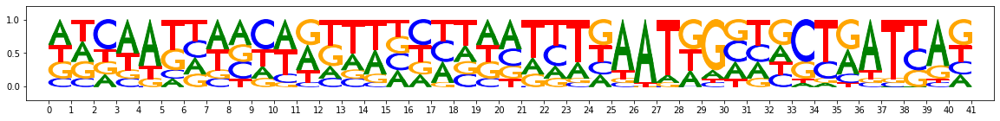

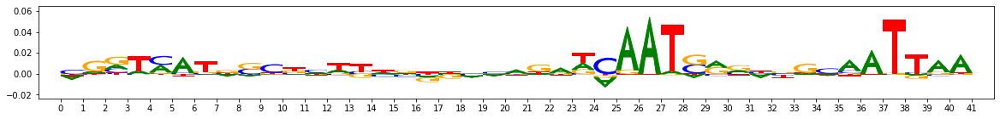

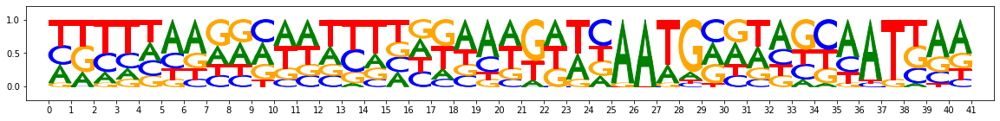

Pattern number 12
Num seqlets: 95


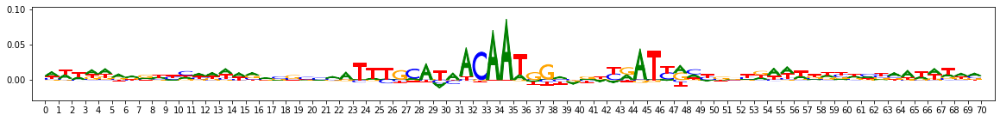

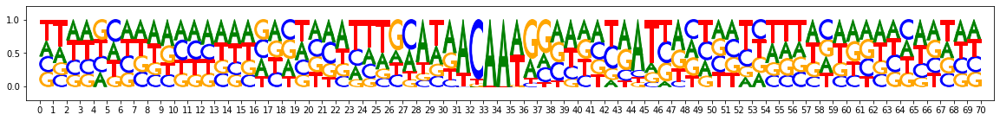

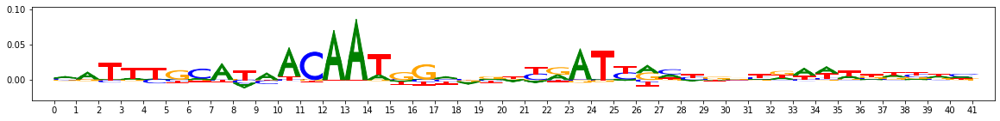

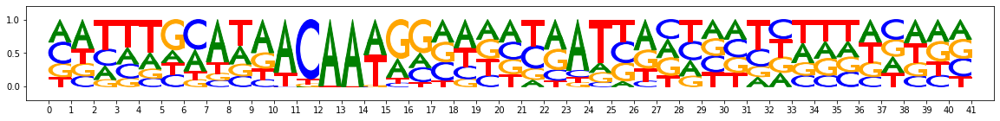

Exemplars


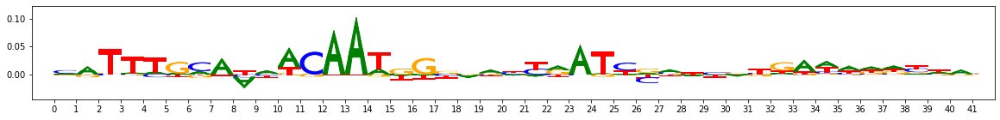

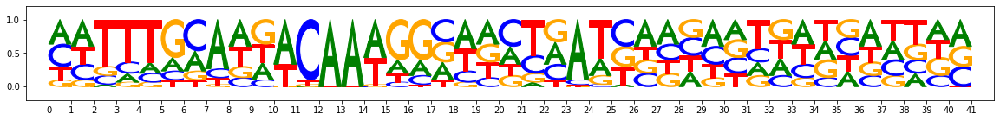

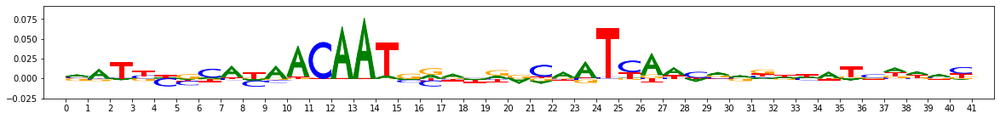

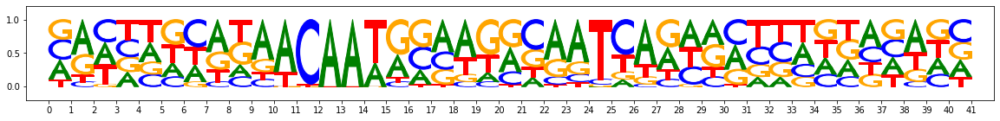

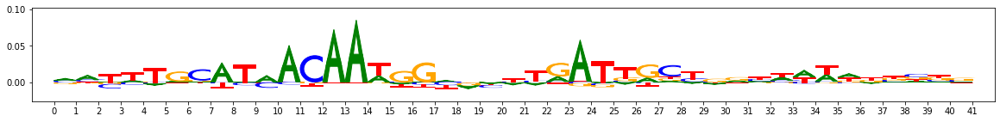

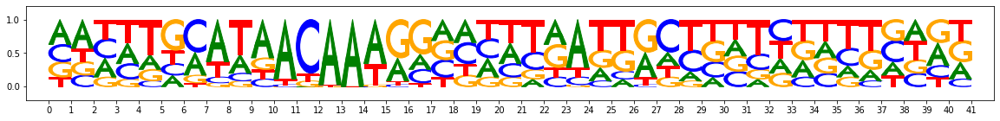

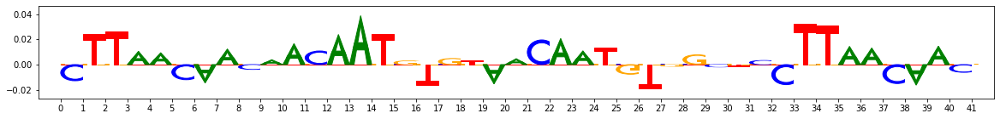

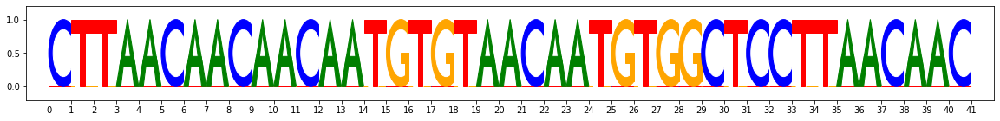

Pattern number 13
Num seqlets: 99


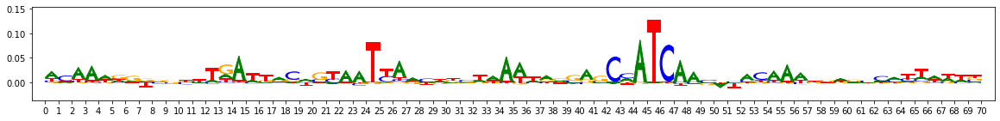

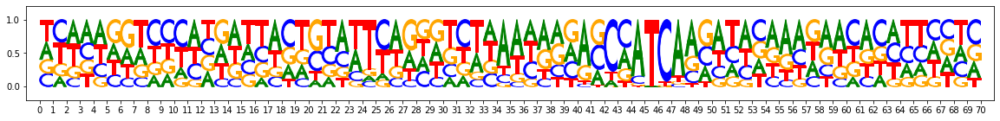

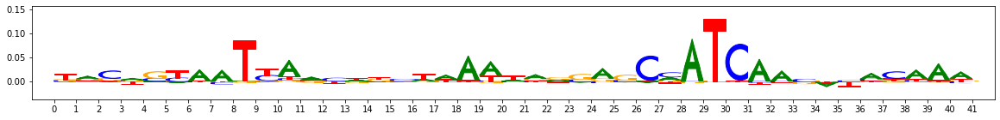

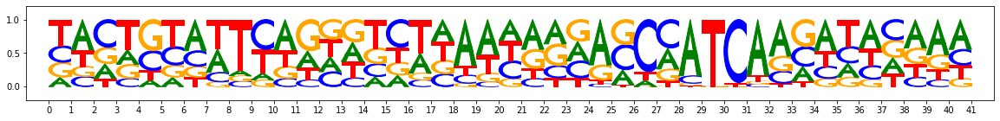

Exemplars


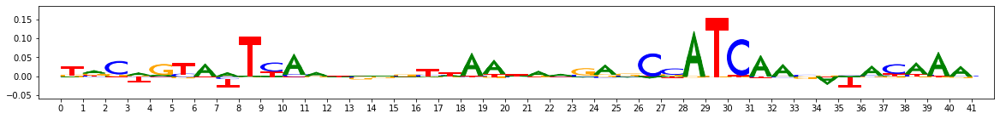

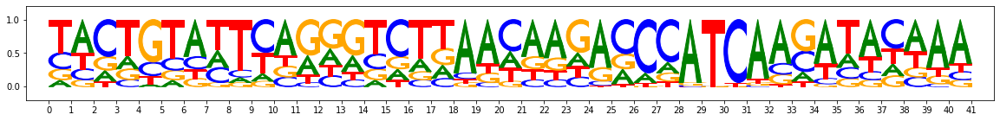

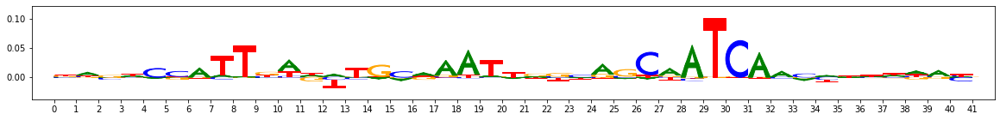

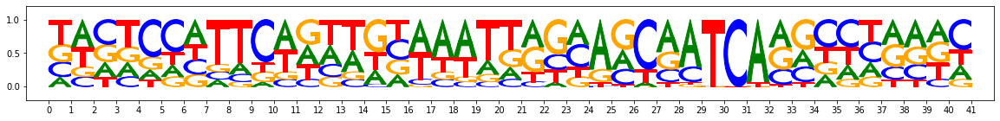

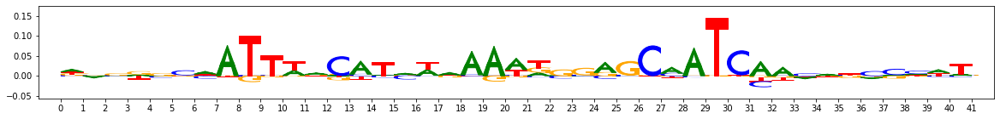

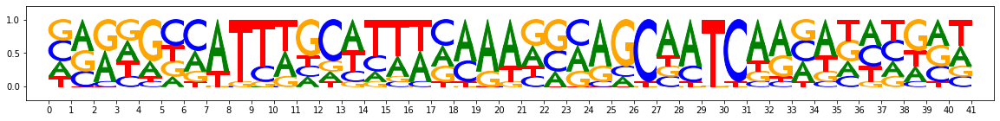

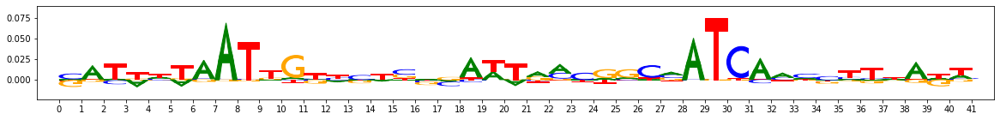

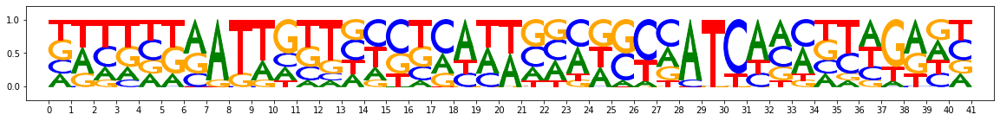

In [123]:
import modisco
from modisco.visualization import viz_sequence


for idx,(orig_pattern,pattern,exemplarmotifs) in enumerate(zip(patterns, trimmed_patterns, exemplarmotifs_foreach_pattern)):
    print("Pattern number",idx)
    print("Num seqlets:",len(pattern.seqlets))
    viz_sequence.plot_weights(orig_pattern["Nanog_profile_wn_contrib_scores"].fwd)
    viz_sequence.plot_weights(orig_pattern["sequence"].fwd)
    viz_sequence.plot_weights(pattern["Nanog_profile_wn_contrib_scores"].fwd)
    viz_sequence.plot_weights(pattern["sequence"].fwd)
    print("Exemplars")
    for exemplarmotif in exemplarmotifs:
        viz_sequence.plot_weights(exemplarmotif["Nanog_profile_wn_contrib_scores"].fwd)
        viz_sequence.plot_weights(exemplarmotif["sequence"].fwd)
